# FT-ICR analysis - PART 1

Created on 01 March 2020 for the Pentatrap experiment

@author: Menno Door<br>
@contact: door+fticr@mpi-k.de<br>
@license: MIT license

### Refenences :

used toolkit of Jonas Karthein for PI-ICR as template :) thank you!!<br>

For references reguarding the theory behind ft-icr detection and analysis methods, please check the references.md file.

### Introduction

This part of the analysis does the conversion of the raw data to penning trap eigenfrequency data. You will be able to group, filter and average data and then fit spectra and/or evaluate pnp phase data to determine these frequencies.

### Important remark:

This is more a visualization thing, especially for bigger data sets i would recommend to do this using a normal python script including some multiprocessing.

Please be patient with this one! Gathering information on paths in fhds structures may take a while, loading data too. So please look at the circle on the top right corner (jupyter notebook), if its filled, there is still something going on and you should just wait.

### Requirements:

The following code was written for Python 3.7/3.8. The required libraries are listed below with a rough description for their task in the code.

    fhds (inhouse data storage, https://git.mpi-hd.mpg.de/Pentatrap/fhds)
    h5py (data storage, easier to distribute)
    pandas (data organisation, calculation and visualization)
    numpy (calculation)
    matplotlib (plotting)
    scipy (chi square fitting)
    jupyter (Python notebook environment)
    ipywidgets (https://ipywidgets.readthedocs.io/en/latest/user_install.html)
    plotly (plotting, https://github.com/plotly/plotly.py#installation)
    qgrid (data visualization, https://github.com/quantopian/qgrid#installation)

### ToDo 

- check for phase correlation here with single phases, short and long phases and unwrap.

In [211]:
# standard libs
from datetime import datetime
from pathlib import Path
import os, json
from pprint import pprint

# math and data
import numpy as np
import scipy
import pandas as pd
import h5py
from uncertainties import ufloat

# visualization
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
%matplotlib inline
import matplotlib.pyplot as plt
import qgrid
import plotly.graph_objs as go
import plotly.offline as py
import plotly.express as px
py.init_notebook_mode()
plt.rcParams['figure.figsize'] = (10, 4)

%load_ext autoreload
%autoreload 2

# this package
from fhds import fhds, interface
from fticr_toolkit import *
from trap_control import fitaxialClass
from fticr_toolkit.fit_dip import fit_dip as fit_dip_alex
from fticr_toolkit.fit_dip import fit_double_dip as fit_double_alex
from fticr_toolkit.fit_dip import dip_func as dip_func_alex 

sim_eval = displacement.SimEval()


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
> loading simulation data... done.


### Step 1: Load raw data and inspect

The input_data filename should be either a folder following fhds rules (append ".fhds" to the folder name please) or a hdf5 file.

In [4]:
###   P A R A M E T E R   L I S T   ( this is especially used for batch processing using the papermill package )
measurement_folder = 'Z:\Measurements\CHAR_B1_Dip_12C6+_trap3'
input_file = 'pnp_dip_unwrap.fhds'
output_folder = "./part1_data/"
use_settings_file = False
settings = {
    "reuse_averages": False,
    "reuse_fitdata": False,
    "single_axial_fits": False,
    "fixed_phase_readout": False
}

In [19]:

data, meas_config, output_folder = data_conversion.load_data(measurement_folder=measurement_folder, 
                          input_data=input_file, 
                          output_folder="part1_data",
                          measurement_script = "b1_measurement_dip"
                         )

if use_settings_file:
    settings.update( data_conversion.load_settings(measurement_folder) )
print("settings", settings)

#pprint(meas_config)
data_root = data["meas_data"]

trap = meas_config["trap"]
pos = meas_config["start_position"]
print(trap, pos)


 >>> WARNING!!! output_folder already exists! files will maybe be overwritten! <<< 


 >>> I hope you are in PART1, loading raw measurement data now... <<< 

settings {'reuse_averages': False, 'reuse_fitdata': False, 'single_axial_fits': False, 'fixed_phase_readout': False}
3 position_1


In [20]:
####
# Chech the data structure, cycles and such
#
####

mcycles = list(data_root.keys())
print("root group names / MAIN CYCLES : ", mcycles )

shifts = list( data_root[mcycles[0]].keys() )
print("check out first group / shifts : ", shifts )


root group names / MAIN CYCLES :  ['cycle1', 'cycle2', 'cycle3', 'cycle4', 'cycle5', 'cycle6', 'cycle7', 'cycle8', 'cycle9']
check out first group / shifts :  ['shift_-0.005', 'shift_-0.02', 'shift_-0.04', 'shift_0.002', 'shift_0.005', 'shift_0.008', 'shift_0.015', 'shift_0.03', 'shift_0.05']


In [21]:
## get the keys of the data we are intereseted in...

#raw_data_keys = data_conversion.get_data_paths( data_root, attr_type = ("amplitude", "phase") ) # super slow in fhds since all meta json files have to be read
raw_data_keys = data_conversion.get_data_paths( data_root, name_includes= ("cidx", "idx") )
#pprint(raw_data_keys)

In [33]:
# Here you can check each spectrum individually, sorry for the simple drop down list of all specs, but everything else would be annoying to program here.

@interact
def spectrum_plot(key=raw_data_keys, center = widgets.FloatText(0), span = widgets.FloatText(100)):
    try:        
        spec = data_conversion.Spectrum(data_root[key])
        if center == 0:
            pos = spec.attrs["position"]
            trap = spec.attrs["trap"][-1]
            center = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_z"]
        spec.cut(center, span)
        
        print(data_root[key][:].size)
        fig=plt.figure(figsize=(20, 8))

        ax1 = plt.subplot(211)
        plt.plot(spec.freqs, spec.amps)
        plt.title(str(spec.attrs["time"])+"    cycle "+str(spec.attrs["cycle"])+"    "+spec.attrs["position"]+"    "+str(spec.attrs["trap"])+"    cidx "+str(spec.attrs["cidx"])+"    type "+str(spec.attrs["type"]))
        print(spec.attrs.keys())
        # share x only
        ax2 = plt.subplot(212, sharex=ax1)
        ax2.set_ylim(0, 2*np.pi)
        plt.plot(spec.freqs, spec.phases)
        plt.show()
    except:
        raise
        print("not spectrum data here...")

interactive(children=(Dropdown(description='key', options=('cycle1/shift_-0.005/dip_measurement/cycle1/positio…

### Step 2: Fit axial dip, all 10 averages

The **structure** is main cycle / subcycle (typ. 25) / position (typ. 2) / trap (typ. 2) / spectra (typ. 10). **If this changes you have to modify the loop!**

In [23]:
# refresher:
print("MAIN CYCLES : ", mcycles )
print("shifts : ", shifts )
print("POSITION : ", pos)
print("TRAP : ", trap)

MAIN CYCLES :  ['cycle1', 'cycle2', 'cycle3', 'cycle4', 'cycle5', 'cycle6', 'cycle7', 'cycle8', 'cycle9']
shifts :  ['shift_-0.005', 'shift_-0.02', 'shift_-0.04', 'shift_0.002', 'shift_0.005', 'shift_0.008', 'shift_0.015', 'shift_0.03', 'shift_0.05']
POSITION :  position_1
TRAP :  3


In [125]:
# fit settings

nu_z_guess = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_z"]
nu_m_guess = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_m"]
nu_p_guess = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_p"]

if trap==2:
    dip_span = 10
    fit_config = {
        "center" : nu_z_guess,
        "dip_center": nu_z_guess,
        "res_span" : 2000, 
        "span" : 5, 
        "q_guess" : 4200, 
        "dip_range" : 1, 
        "width_range" : [0.5,10]
    }                 
else:
    dip_span = 20
    fit_config = {
        "center" : nu_z_guess,
        "dip_center": nu_z_guess,
        "res_span" : 2000, 
        "span" : 5, 
        "q_guess" : 4200, 
        "dip_range" : 1, 
        "width_range" : [0.5,10]
    }
print(fit_config)
    
# DANIELS FIT
if trap==2:          
    fit_opt = { # not needed, fit is automatic
        "dip_center": nu_z_guess,
        "res_span": 4000,
        "dip_span": 20,
        'min_dip_width': 0.5
    #    "fit_method": 0,
    #    "A": 110
    }
if trap==3:          
    fit_opt = { # not needed, fit is automatic
    #    "dip_center": nu_z_guess,
        "res_span": 500,
        "dip_span": 100,
        "supress_dispersive": False, 
    #    'min_dip_width': 2.0
    #    "fit_method": 0,
    #    "A": 110
    }
    
print(fit_opt)

{'center': 501502.5, 'dip_center': 501502.5, 'res_span': 2000, 'span': 5, 'q_guess': 4200, 'dip_range': 1, 'width_range': [0.5, 10]}
{'res_span': 500, 'dip_span': 100, 'supress_dispersive': False}


In [126]:

def calc_nu_m(nu_rf, nu_z, nu_l, nu_r,  dnu_z, dnu_l, dnu_r):
    print(nu_rf, nu_z, nu_l, nu_r,  dnu_z, dnu_l, dnu_r)
    value = nu_rf + nu_z - nu_l - nu_r
    dvalue = np.sqrt(dnu_z**2 + dnu_l**2 + dnu_r**2)
    return value, dvalue


def calc_nu_p(nu_rf, nu_z, nu_l, nu_r,  dnu_z, dnu_l, dnu_r):
    print(nu_rf, nu_z, nu_l, nu_r,  dnu_z, dnu_l, dnu_r)
    value = nu_rf - nu_z + nu_l + nu_r
    dvalue = np.sqrt(dnu_z**2 + dnu_l**2 + dnu_r**2)
    return value, dvalue

cycle1 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [884427339530781.4, 5820.2862669232545, 124.71527099609375, -0.0016151974180076659, 501514.6666666667]
Start fiting resonator....
chi_reduziert =  0.8160810909807437
...End fiting resonator
{'A': 2296403679819228.0, 'dA': 1.1075146839125418e-10, 'Q': 14233.862010372544, 'dQ': 34.8387301630142, 'nu_res': 501508.6202015551, 'dnu_res': 0.2798894248914382, 'fit_err_chi**2_red': 0.8160810909807437}
resonator fit results:  [ 2.296403679819e+15  1.423386201037e+04  5.162131611826e+11
 -2.518035330134e-04  5.015086202016e+05] [1.107514683913e-10 3.483873016301e+01 4.186014139671e-08
 8.823615479271e-06 2.798894248914e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.664075705352168


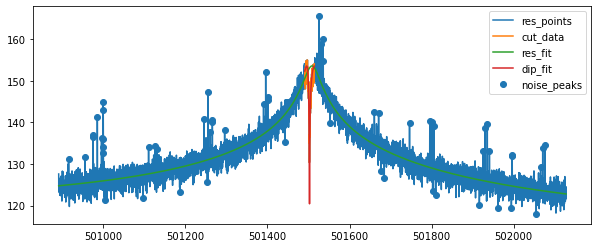

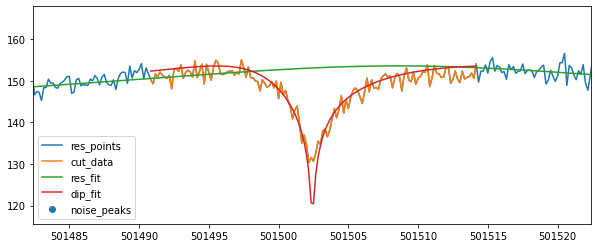

{'A': 2296403679819228.0, 'dA': 1.1075146839125418e-10, 'Q': 14233.862010372544, 'dQ': 34.8387301630142, 'nu_res': 501508.6202015551, 'dnu_res': 0.2798894248914382, 'nu_z': 501502.41808167525, 'dnu_z': 0.0224288978421745, 'dip_width': 5.103553801261954, 'ddip_width': 0.2085286772750369, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.664075705352168, 'fit_success': True}
cycle1 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [885835631503513.6, 5831.562015503876, 125.00176408508999, -0.0016063368493550122, 501514.3333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8026175290405098
...End fiting resonator
{'A': 2286087349012460.0, 'dA': 1.1264396224197823e-10, 'Q': 14200.820937825027, 'dQ': 35.34909142137632, 'nu_res': 501508.9876381872, 'dnu_res': 0.284253960410864, 'fit_err_chi**2_red': 0.8026175290405098}
resonator fit results:  [ 2.286087349012e+15  1.420082093783e+04  5.145434075654e+11
 -2.521277827987e-04  5.015089876382e+05] [1.126439622420e-10 3.534909142138e+01 4.193041641677e-08
 9.044033370685e-06 2.842539604109e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9818139373330455


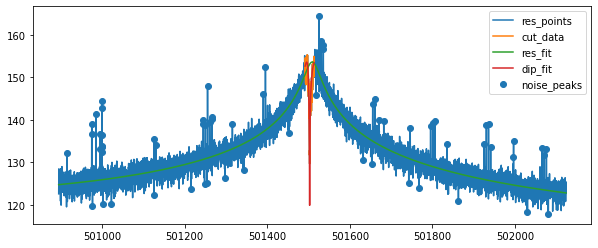

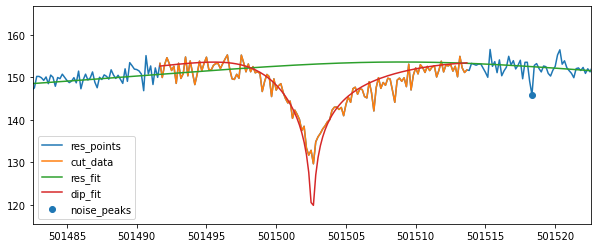

{'A': 2286087349012460.0, 'dA': 1.1264396224197823e-10, 'Q': 14200.820937825027, 'dQ': 35.34909142137632, 'nu_res': 501508.9876381872, 'dnu_res': 0.284253960410864, 'nu_z': 501502.5889973792, 'dnu_z': 0.025895064151321437, 'dip_width': 5.386262744409496, 'ddip_width': 0.2400707985205246, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.9818139373330455, 'fit_success': True}
cycle1 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 469.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



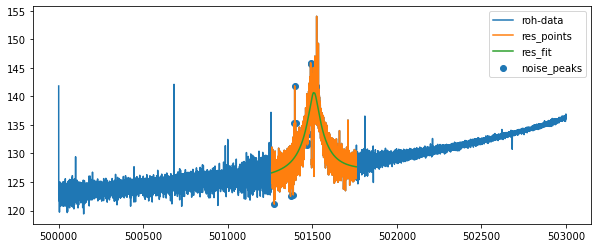

...End fiting resonator
{'A': 114052488010024.22, 'dA': 5.11205446705856e-09, 'off': 4098165613970.516, 'doff': 9.564689203027714e-08, 'Q': 10300.98682149441, 'dQ': 94.27314247344478, 'th': 0.0003372109075493374, 'dth': 4.30171261683448e-05, 'nu_res': 501509.4242127067, 'dnu_res': 0.5299631992532668, 'fit_err_chi**2_red': 2.9821464929352635}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


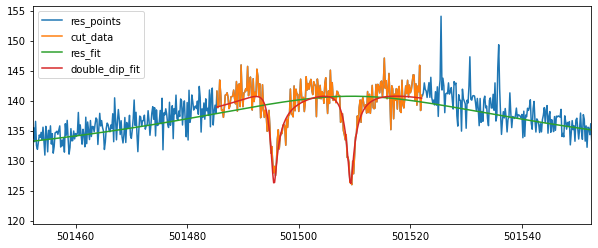

501495.5772628949 0.061509750123833494 501509.2842842716 0.062205887297391516
cycle1 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501507.1666666667 1220.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


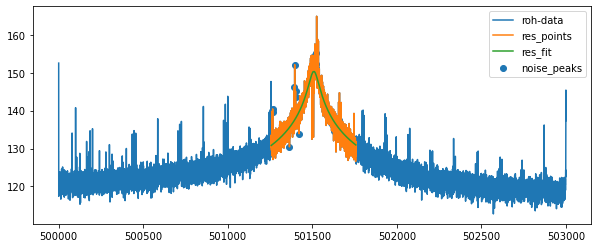

...End fiting resonator
{'A': 1093984263658181.2, 'dA': 2.2395635612833768e-10, 'off': 118.87276527006179, 'doff': 2.9781909972256676e-17, 'Q': 9430.485921657555, 'dQ': 47.51046065440788, 'th': 2.261466459120413e-20, 'dth': 5.194074449683828e-05, 'nu_res': 501508.9273125872, 'dnu_res': 0.5365129638945408, 'fit_err_chi**2_red': 3.132533922289676}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


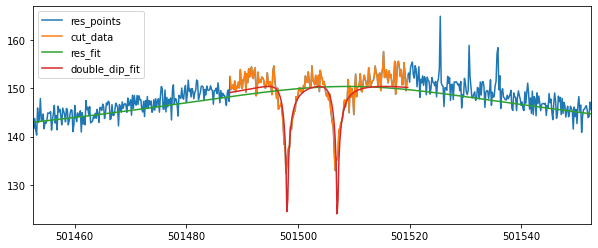

501498.07047646877 0.017080258112111866 501507.06862194906 0.016956903566618234
[501502.41808167525, 501502.5889973792]
503840.97 501502.5035395272 501495.5772628949 501509.2842842716 0.03425798893419975 0.061509750123833494 0.062205887297391516
53273922.2 501502.5035395272 501498.07047646877 501507.06862194906 0.03425798893419975 0.017080258112111866 0.016956903566618234
['cycle1', 'position_1', 3, -0.005, '20211217_175742.143078', 53775424.8355589, 0.041867428886423225, 2338.611992360675, 0.09395015476606712, 501502.5035395272, 0.03425798893419975, 5.386262744409496, 0.2400707985205246, True, 501508.9876381872, 0.284253960410864]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle1 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [864448644039211.8, 5709.8444022783015, 124.49604474721582, -0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8047635810126125
...End fiting resonator
{'A': 2407921657439591.5, 'dA': 1.1114672536661018e-10, 'Q': 14583.871455340646, 'dQ': 35.82947294057298, 'nu_res': 501508.353023772, 'dnu_res': 0.281327373048832, 'fit_err_chi**2_red': 0.8047635810126125}
resonator fit results:  [ 2.407921657440e+15  1.458387145534e+04  4.888948631504e+11
 -2.573165435713e-04  5.015083530238e+05] [1.111467253666e-10 3.582947294057e+01 4.630903150170e-08
 8.632581525126e-06 2.813273730488e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.0738465669287898
Fit is NOT GOOD !!!!!


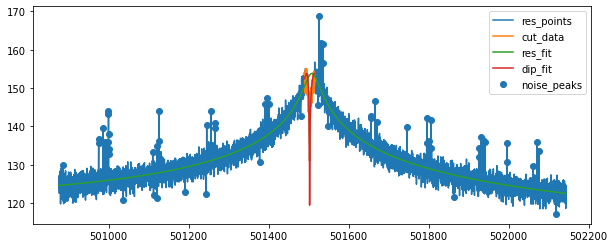

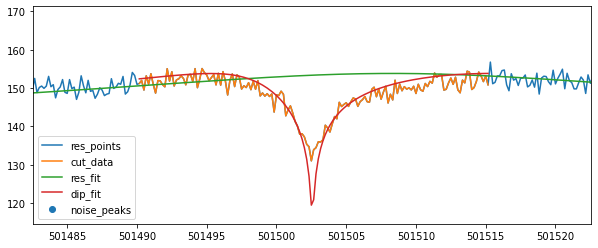

{'A': 2407921657439591.5, 'dA': 1.1114672536661018e-10, 'Q': 14583.871455340646, 'dQ': 35.82947294057298, 'nu_res': 501508.353023772, 'dnu_res': 0.281327373048832, 'nu_z': 501502.5701332353, 'dnu_z': 0.026153305542990838, 'dip_width': 5.529081716094426, 'ddip_width': 0.24853811476984322, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.0738465669287898, 'fit_success': True}
cycle1 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [884790200415587.8, 5820.282398455232, 124.81314486320062, -0.0016800541302735182, 501514.3333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8085839806198202
...End fiting resonator
{'A': 2202739833855699.5, 'dA': 1.0975173574545572e-10, 'Q': 13881.297023237372, 'dQ': 33.95222795165265, 'nu_res': 501508.9525860407, 'dnu_res': 0.286254652508618, 'fit_err_chi**2_red': 0.8085839806198202}
resonator fit results:  [ 2.202739833856e+15  1.388129702324e+04  4.731396788017e+11
 -2.567713105089e-04  5.015089525860e+05] [1.097517357455e-10 3.395222795165e+01 4.057618811382e-08
 8.790362116970e-06 2.862546525086e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.667092008067382


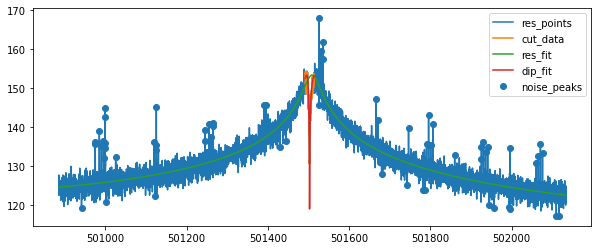

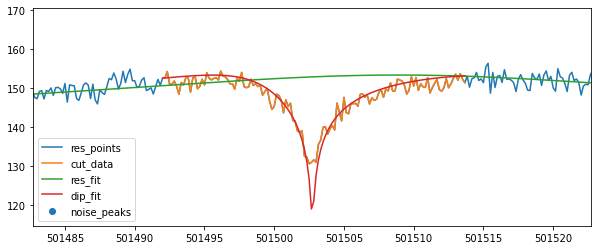

{'A': 2202739833855699.5, 'dA': 1.0975173574545572e-10, 'Q': 13881.297023237372, 'dQ': 33.95222795165265, 'nu_res': 501508.9525860407, 'dnu_res': 0.286254652508618, 'nu_z': 501502.7321134236, 'dnu_z': 0.02302454338492291, 'dip_width': 5.276991142500396, 'ddip_width': 0.2157517839424055, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.667092008067382, 'fit_success': True}
cycle1 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 453.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


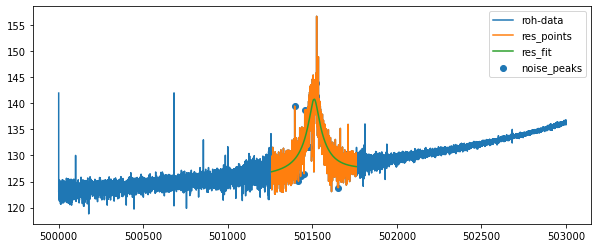

...End fiting resonator
{'A': 115542792794675.03, 'dA': 6.008452757517422e-09, 'off': 4478405362217.126, 'doff': 1.1332731572671162e-07, 'Q': 10880.533134477126, 'dQ': 105.87893394725262, 'th': 0.0003086940377817926, 'dth': 4.311671218408917e-05, 'nu_res': 501510.7190956778, 'dnu_res': 0.5226556717879492, 'fit_err_chi**2_red': 3.0879025877269948}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


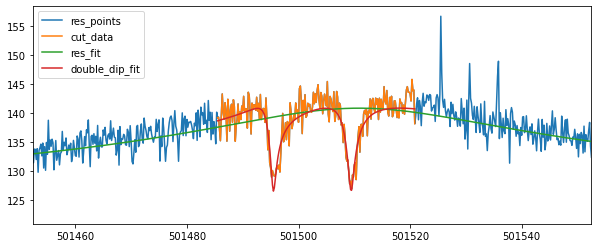

501495.5187315336 0.06296465219263468 501509.4315499191 0.06591159210676693
cycle1 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.1666666667 1246.666666666977
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


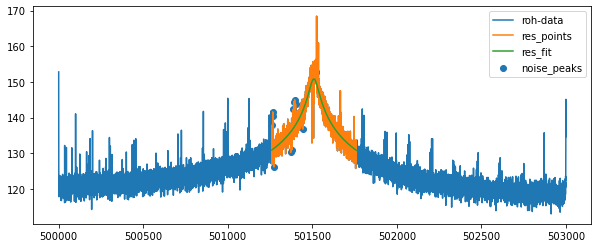

...End fiting resonator
{'A': 1223070503693600.2, 'dA': 2.2012092852696702e-10, 'off': 180.92952009942383, 'doff': 5.4920742678152215e-15, 'Q': 10008.65475942747, 'dQ': 49.4623705661447, 'th': 2.9960548569662746e-20, 'dth': 5.074767168173032e-05, 'nu_res': 501509.12999825436, 'dnu_res': 0.5065921507006741, 'fit_err_chi**2_red': 3.077493718231296}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


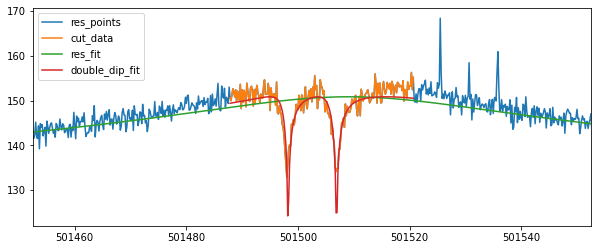

501498.23191954516 0.015523393280356162 501506.9151086993 0.016014926417224618
[501502.5701332353, 501502.7321134236]
503840.97 501502.6511233294 501495.5187315336 501509.4315499191 0.03484429636123009 0.06296465219263468 0.06591159210676693
53273922.2 501502.6511233294 501498.23191954516 501506.9151086993 0.03484429636123009 0.015523393280356162 0.016014926417224618
['cycle1', 'position_1', 3, -0.02, '20211217_173935.358528', 53775424.69590491, 0.04137122908489616, 2338.6708418766502, 0.09758591285988726, 501502.6511233294, 0.03484429636123009, 5.276991142500396, 0.2157517839424055, True, 501508.9525860407, 0.286254652508618]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle1 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [892287449579241.2, 5820.301740815, 124.79327975366448, -0.00162927

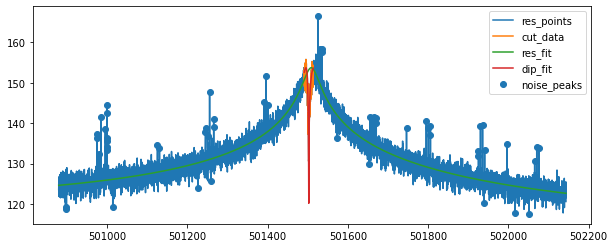

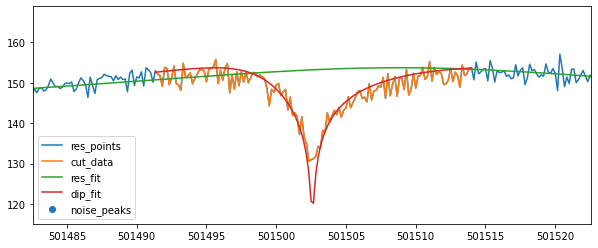

{'A': 2347623995775951.0, 'dA': 1.1086220533487256e-10, 'Q': 14389.281102851279, 'dQ': 35.28639855408096, 'nu_res': 501508.8306298454, 'dnu_res': 0.2802731695048736, 'nu_z': 501502.58729469817, 'dnu_z': 0.02570516205404471, 'dip_width': 5.29974908369407, 'ddip_width': 0.2392883053339171, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.066063133598067, 'fit_success': True}
cycle1 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [881710208054200.2, 5775.608445298795, 124.92363303380839, -0.001639269093328563, 501515.3333333333]
Start fiting resonator....
chi_reduziert =  0.8098678057082158
...End fiting resonator
{'A': 2301068743799894.5, 'dA': 1.1123743169835612e-10, 'Q': 14227.902069729951, 'dQ': 35.05961056232368, 'nu_res': 501508.7929431025, 'dnu_res': 0.2795328367756007, 'fit_err_chi**2_red': 0.8098678057082158}
resonator fit results:  [ 2.301068743800e+15  1.422790206973e+04  5.367860114355e+11
 -2.463124290176e-04  5.015087929431e+05] [

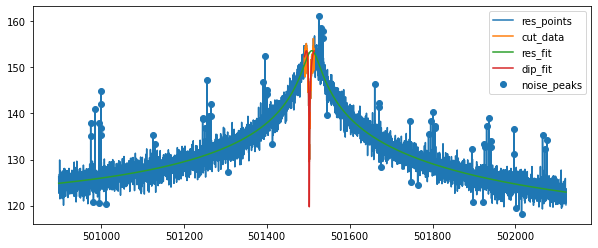

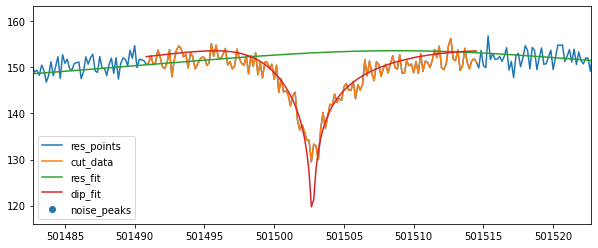

{'A': 2301068743799894.5, 'dA': 1.1123743169835612e-10, 'Q': 14227.902069729951, 'dQ': 35.05961056232368, 'nu_res': 501508.7929431025, 'dnu_res': 0.2795328367756007, 'nu_z': 501502.7353352521, 'dnu_z': 0.024871111259416705, 'dip_width': 5.201396595582012, 'ddip_width': 0.22772078844581375, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.9307653528709456, 'fit_success': True}
cycle1 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.0 460.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



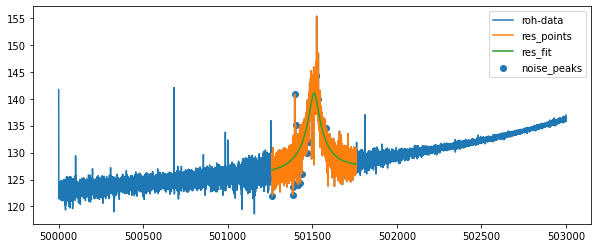

...End fiting resonator
{'A': 123770465397750.2, 'dA': 5.5323849102490215e-09, 'off': 4388451585614.8364, 'doff': 1.1053811479131062e-07, 'Q': 11145.063288351408, 'dQ': 102.6591096814245, 'th': 0.0003511577799917855, 'dth': 4.170878354194479e-05, 'nu_res': 501510.1668359714, 'dnu_res': 0.4928790054265762, 'fit_err_chi**2_red': 3.001527624951898}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


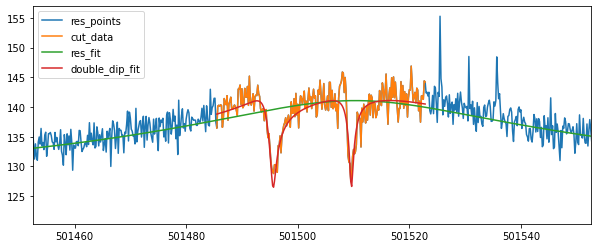

501495.609514635 0.06424023734623974 501509.6168457362 0.04974055918614476
cycle1 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.6666666667 1244.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


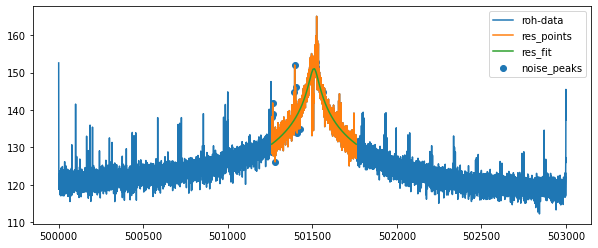

...End fiting resonator
{'A': 1278263833326049.8, 'dA': 2.232874492641454e-10, 'off': 45082.93873511685, 'doff': 1.139020259609624e-14, 'Q': 10253.177481203733, 'dQ': 51.29666936584776, 'th': 1.1877763572589332e-26, 'dth': 5.129471885582218e-05, 'nu_res': 501509.47305491386, 'dnu_res': 0.5050510960007799, 'fit_err_chi**2_red': 3.024794504877489}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


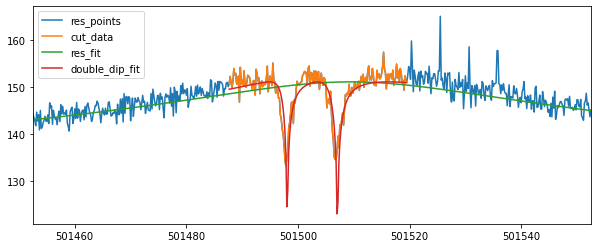

501498.06602604873 0.017250394365887163 501507.06984581414 0.017419686714613532
[501502.58729469817, 501502.7353352521]
503840.97 501502.6613149751 501495.609514635 501509.6168457362 0.035767688372370175 0.06424023734623974 0.04974055918614476
53273922.2 501502.6613149751 501498.06602604873 501507.06984581414 0.035767688372370175 0.017250394365887163 0.017419686714613532
['cycle1', 'position_1', 3, -0.04, '20211217_181548.991258', 53775424.67455689, 0.04336299254568231, 2338.404954603873, 0.08877082208673394, 501502.6613149751, 0.035767688372370175, 5.201396595582012, 0.22772078844581375, True, 501508.7929431025, 0.2795328367756007]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle1 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [905937122838703.0, 5900.170588235294, 124.98880699350535, -0

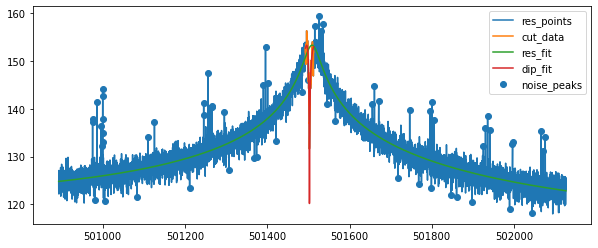

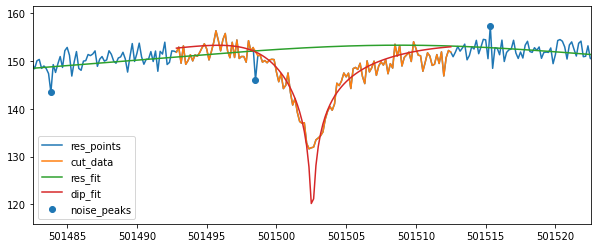

{'A': 2154835353044384.5, 'dA': 1.1027635201217082e-10, 'Q': 13714.402663978202, 'dQ': 33.74519554248132, 'nu_res': 501508.86232323793, 'dnu_res': 0.28615473239968986, 'nu_z': 501502.57432797004, 'dnu_z': 0.023397055701998806, 'dip_width': 4.811080844420665, 'ddip_width': 0.21447352172644243, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.8248926520511193, 'fit_success': True}
cycle1 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [848973444353232.4, 5614.001865669203, 124.66585540771484, -0.0015379381164704119, 501517.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8002475738203524
...End fiting resonator
{'A': 2414830935854010.5, 'dA': 1.1281349212285163e-10, 'Q': 14667.861637411526, 'dQ': 36.23944870359321, 'nu_res': 501509.24256737856, 'dnu_res': 0.2778322156879534, 'fit_err_chi**2_red': 0.8002475738203524}
resonator fit results:  [ 2.414830935854e+15  1.466786163741e+04  5.453111303088e+11
 -2.565961366310e-04  5.015092425674e+05] [1.128134921229e-10 3.623944870359e+01 4.429340026004e-08
 8.941650282925e-06 2.778322156880e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.28132958695382
Fit is NOT GOOD !!!!!


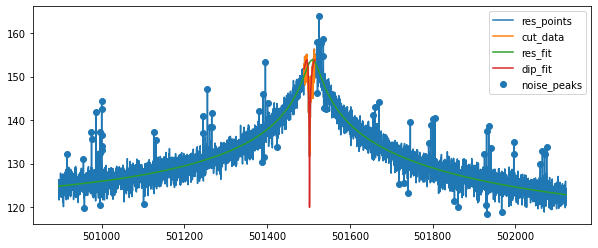

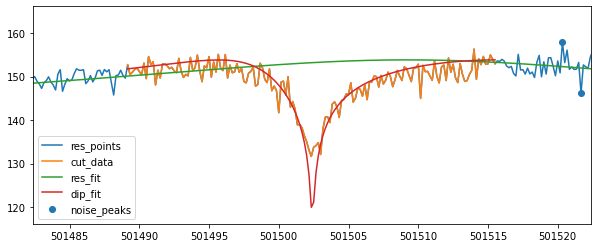

{'A': 2414830935854010.5, 'dA': 1.1281349212285163e-10, 'Q': 14667.861637411526, 'dQ': 36.23944870359321, 'nu_res': 501509.24256737856, 'dnu_res': 0.2778322156879534, 'nu_z': 501502.40529499843, 'dnu_z': 0.02730590918140723, 'dip_width': 5.325892882447185, 'ddip_width': 0.25161786213844184, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.28132958695382, 'fit_success': True}
cycle1 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.8333333333 464.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



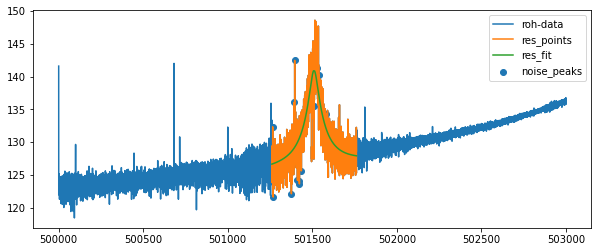

...End fiting resonator
{'A': 120086504893964.28, 'dA': 5.658236033588432e-09, 'off': 4368800335822.194, 'doff': 1.1078636655729211e-07, 'Q': 11018.393160742631, 'dQ': 102.8274526202747, 'th': 0.0004070267276184116, 'dth': 4.208607532174857e-05, 'nu_res': 501509.9270184722, 'dnu_res': 0.5021047583478089, 'fit_err_chi**2_red': 2.985018378655202}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


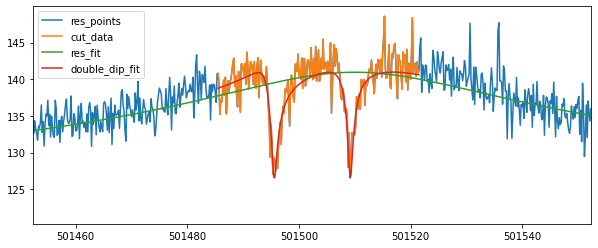

501495.583106401 0.06446659173992446 501509.22115452366 0.05904085071062525
cycle1 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.1666666667 1252.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



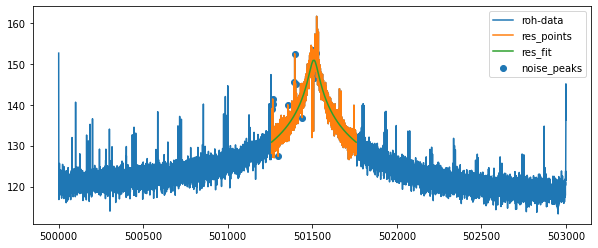

...End fiting resonator
{'A': 1242581249142816.5, 'dA': 2.1728435753444085e-10, 'off': 98481.83194227103, 'doff': 9.578303739071232e-09, 'Q': 10092.046118685592, 'dQ': 49.23045603011744, 'th': 4.038510371240758e-14, 'dth': 5.006646904175007e-05, 'nu_res': 501508.8024854641, 'dnu_res': 0.4974303757928293, 'fit_err_chi**2_red': 2.8320879994159376}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


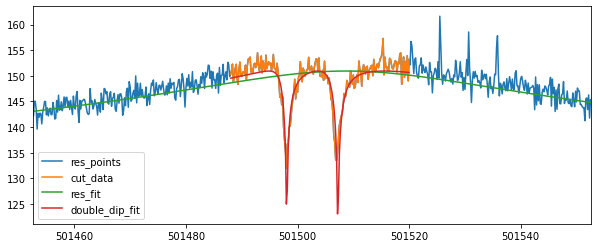

501498.0689652684 0.0145237753943698 501507.2323349615 0.014245986830302603
[501502.57432797004, 501502.40529499843]
503840.97 501502.48981148424 501495.583106401 501509.22115452366 0.0359587943589005 0.06446659173992446 0.05904085071062525
53273922.2 501502.48981148424 501498.0689652684 501507.2323349615 0.0359587943589005 0.0145237753943698 0.014245986830302603
['cycle1', 'position_1', 3, 0.002, '20211217_175139.892809', 53775425.01148875, 0.041314925683352634, 2338.655550559517, 0.09452406251818703, 501502.48981148424, 0.0359587943589005, 5.325892882447185, 0.25161786213844184, True, 501509.24256737856, 0.2778322156879534]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle1 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [905443931869007.8, 5820.255319147625, 124.73287200927734, -0.001714

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8112172530440395
...End fiting resonator
{'A': 2403504136800293.0, 'dA': 1.1076727480970682e-10, 'Q': 14525.598854603199, 'dQ': 35.744194374923474, 'nu_res': 501508.8277371362, 'dnu_res': 0.2766754517955764, 'fit_err_chi**2_red': 0.8112172530440395}
resonator fit results:  [ 2.403504136800e+15  1.452559885460e+04  5.362873302250e+11
 -2.588207131535e-04  5.015088277371e+05] [1.107672748097e-10 3.574419437492e+01 4.302041170465e-08
 8.895157695042e-06 2.766754517956e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7282793041651334


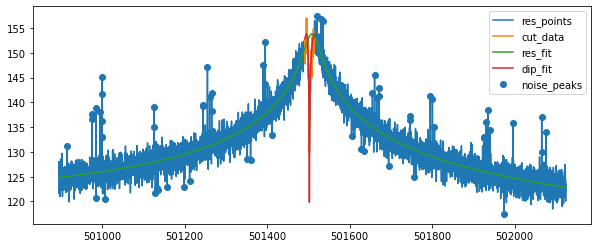

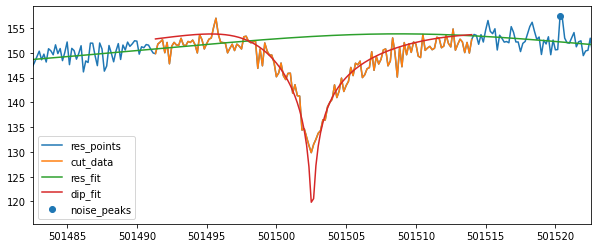

{'A': 2403504136800293.0, 'dA': 1.1076727480970682e-10, 'Q': 14525.598854603199, 'dQ': 35.744194374923474, 'nu_res': 501508.8277371362, 'dnu_res': 0.2766754517955764, 'nu_z': 501502.5758406154, 'dnu_z': 0.02440051252326345, 'dip_width': 5.691018464192467, 'ddip_width': 0.22656123781621393, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.7282793041651334, 'fit_success': True}
cycle1 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [902906527669428.9, 5865.672514619883, 124.59648895263672, -0.001702922629066565, 501515.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8134400438353165
...End fiting resonator
{'A': 2337686713736056.0, 'dA': 1.1088356339860905e-10, 'Q': 14370.040786336442, 'dQ': 35.1771572516694, 'nu_res': 501508.56254581653, 'dnu_res': 0.2786109931130317, 'fit_err_chi**2_red': 0.8134400438353165}
resonator fit results:  [ 2.337686713736e+15  1.437004078634e+04  5.154200521576e+11
 -2.415317944282e-04  5.015085625458e+05] [1.108835633986e-10 3.517715725167e+01 4.286068865321e-08
 8.800903926279e-06 2.786109931130e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8753211931335476


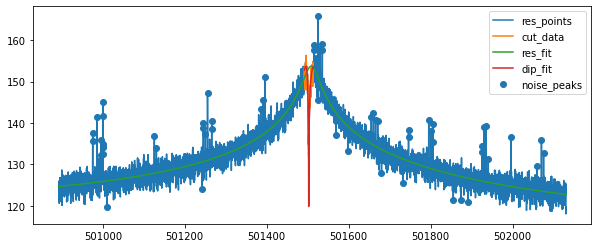

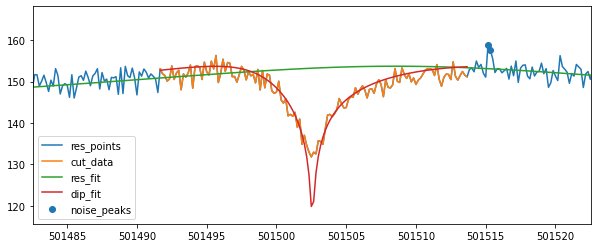

{'A': 2337686713736056.0, 'dA': 1.1088356339860905e-10, 'Q': 14370.040786336442, 'dQ': 35.1771572516694, 'nu_res': 501508.56254581653, 'dnu_res': 0.2786109931130317, 'nu_z': 501502.57224012556, 'dnu_z': 0.023970496756249297, 'dip_width': 5.180381642436933, 'ddip_width': 0.22422750010482345, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.8753211931335476, 'fit_success': True}
cycle1 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 444.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



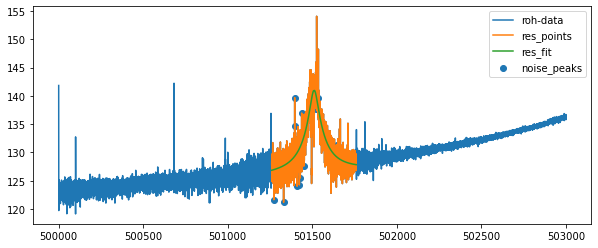

...End fiting resonator
{'A': 122248145562073.6, 'dA': 5.556896085673581e-09, 'off': 4423389671642.939, 'doff': 1.0946029168226348e-07, 'Q': 11067.373180429611, 'dQ': 102.39644856767964, 'th': 0.0003111764136844183, 'dth': 4.1726927537904223e-05, 'nu_res': 501510.6079736986, 'dnu_res': 0.49632916559264967, 'fit_err_chi**2_red': 2.9964057817047767}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


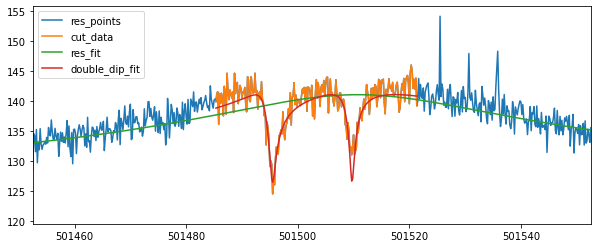

501495.4926922627 0.0650695322623651 501509.7263132943 0.05486730453006056
cycle1 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.1666666667 1244.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



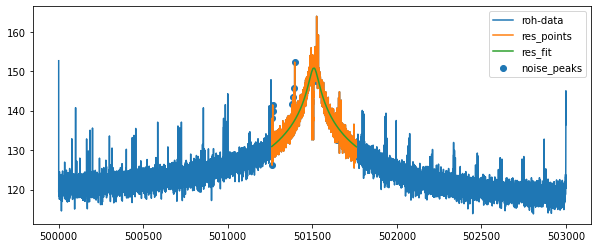

...End fiting resonator
{'A': 1215098769191813.2, 'dA': 2.2137547152457547e-10, 'off': 215.10079565392516, 'doff': 5.70211224817126e-17, 'Q': 9951.461519983286, 'dQ': 49.67854190066485, 'th': 4.567031856573353e-13, 'dth': 5.128172143969031e-05, 'nu_res': 501509.0470739359, 'dnu_res': 0.5136038323098865, 'fit_err_chi**2_red': 3.022444045473868}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


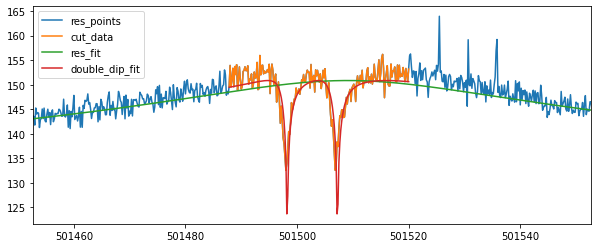

501498.23181502655 0.01754543650508833 501507.2396779832 0.01801025188196441
[501502.5758406154, 501502.57224012556]
503840.97 501502.57404037047 501495.4926922627 501509.7263132943 0.03420482021790634 0.0650695322623651 0.05486730453006056
53273922.2 501502.57404037047 501498.23181502655 501507.2396779832 0.03420482021790634 0.01754543650508833 0.01801025188196441
['cycle1', 'position_1', 3, 0.005, '20211217_182151.252046', 53775425.09745264, 0.04245210526163789, 2338.3250348134898, 0.09173022872192498, 501502.57404037047, 0.03420482021790634, 5.180381642436933, 0.22422750010482345, True, 501508.56254581653, 0.2786109931130317]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle1 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [901890881654989.1, 5877.138671876336, 124.88077417075628, -0.001

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8238770889788586
...End fiting resonator
{'A': 2245266880425038.8, 'dA': 1.1113675789836092e-10, 'Q': 14016.493011496417, 'dQ': 34.69990743388117, 'nu_res': 501508.437465283, 'dnu_res': 0.28583936309934227, 'fit_err_chi**2_red': 0.8238770889788586}
resonator fit results:  [ 2.245266880425e+15  1.401649301150e+04  5.169185532558e+11
 -2.471373571612e-04  5.015084374653e+05] [1.111367578984e-10 3.469990743388e+01 4.166966350774e-08
 8.800041258733e-06 2.858393630993e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.229108210099392
Fit is NOT GOOD !!!!!


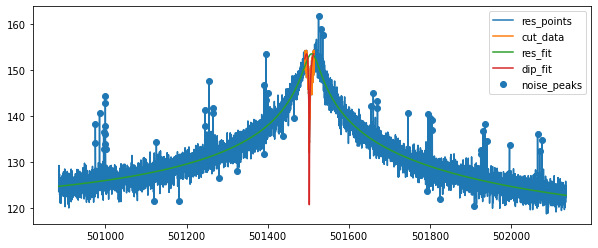

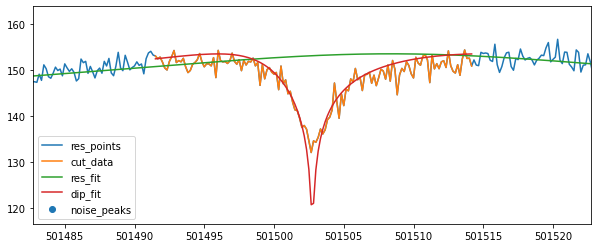

{'A': 2245266880425038.8, 'dA': 1.1113675789836092e-10, 'Q': 14016.493011496417, 'dQ': 34.69990743388117, 'nu_res': 501508.437465283, 'dnu_res': 0.28583936309934227, 'nu_z': 501502.74703314493, 'dnu_z': 0.025272977624519515, 'dip_width': 4.716788674376952, 'ddip_width': 0.2342796694773843, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 2.229108210099392, 'fit_success': True}
cycle1 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [887764325850560.2, 5775.598848369813, 124.42450714111328, -0.0016746075004342123, 501514.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.805044068409649
...End fiting resonator
{'A': 2341667145944427.0, 'dA': 1.1196983545772725e-10, 'Q': 14371.1452406754, 'dQ': 35.596360408595004, 'nu_res': 501508.86617561005, 'dnu_res': 0.28416322258382276, 'fit_err_chi**2_red': 0.805044068409649}
resonator fit results:  [ 2.341667145944e+15  1.437114524068e+04  5.123588219063e+11
 -2.334154820285e-04  5.015088661756e+05] [1.119698354577e-10 3.559636040860e+01 4.472428166867e-08
 8.720540869900e-06 2.841632225838e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.708623610179651


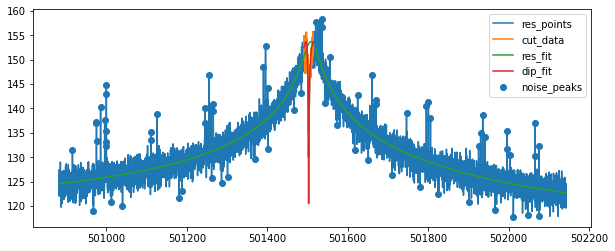

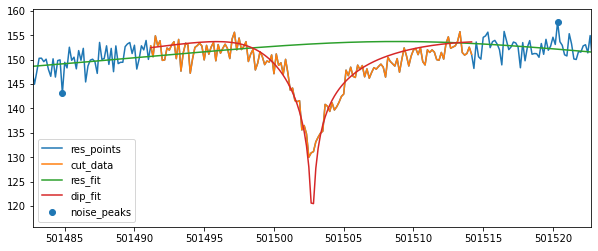

{'A': 2341667145944427.0, 'dA': 1.1196983545772725e-10, 'Q': 14371.1452406754, 'dQ': 35.596360408595004, 'nu_res': 501508.86617561005, 'dnu_res': 0.28416322258382276, 'nu_z': 501502.7504836382, 'dnu_z': 0.023158848783499268, 'dip_width': 5.107171980741919, 'ddip_width': 0.2170438077525529, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.708623610179651, 'fit_success': True}
cycle1 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501506.1666666667 437.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


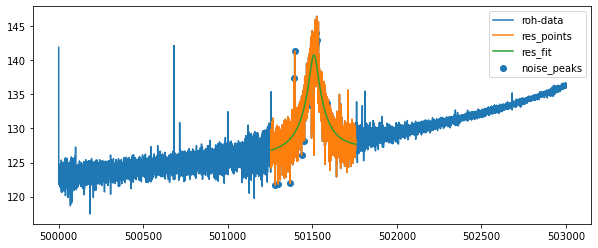

...End fiting resonator
{'A': 117646791862516.4, 'dA': 5.392552476625071e-09, 'off': 4291111921621.9688, 'doff': 1.0355720670934619e-07, 'Q': 10749.106555970975, 'dQ': 98.32354149481887, 'th': 0.000271768974331365, 'dth': 4.1774116851427524e-05, 'nu_res': 501509.3829248646, 'dnu_res': 0.5049373755748171, 'fit_err_chi**2_red': 2.9811966639237824}
Start fiting double dip....
Fit is NOT GOOD !!!!!


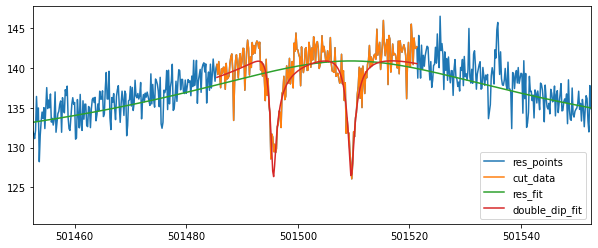

501495.62932265643 0.05281947896852663 501509.5692644164 0.05492003458451623
cycle1 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.6666666667 1229.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



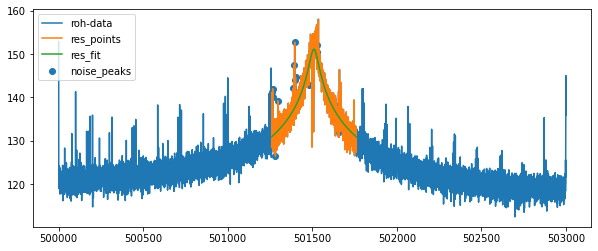

...End fiting resonator
{'A': 1293593699653622.8, 'dA': 2.208065626533584e-10, 'off': 82479.60340743787, 'doff': 1.0466275595050974e-08, 'Q': 10263.426706363798, 'dQ': 51.28824344931929, 'th': 9.1218086994709e-34, 'dth': 5.123154929890837e-05, 'nu_res': 501509.3082292308, 'dnu_res': 0.5041412028603893, 'fit_err_chi**2_red': 2.7831248357651894}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


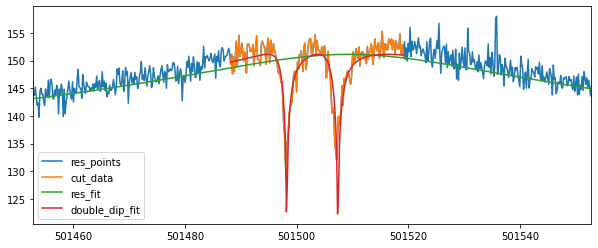

501498.22414370766 0.014384232232095208 501507.3973850401 0.014990824176985744
[501502.74703314493, 501502.7504836382]
503840.97 501502.7487583916 501495.62932265643 501509.5692644164 0.034279085095527996 0.05281947896852663 0.05492003458451623
53273922.2 501502.7487583916 501498.22414370766 501507.3973850401 0.034279085095527996 0.014384232232095208 0.014990824176985744
['cycle1', 'position_1', 3, 0.008, '20211217_180344.400753', 53775425.07277036, 0.04008349562349318, 2338.520171318727, 0.08355335560142114, 501502.7487583916, 0.034279085095527996, 5.107171980741919, 0.2170438077525529, True, 501508.86617561005, 0.28416322258382276]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle1 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [899667334161355.0, 5809.055984557291, 124.65653991699219, -

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8043273327461659
...End fiting resonator
{'A': 2385527274417001.0, 'dA': 1.0852476463911022e-10, 'Q': 14362.7105057239, 'dQ': 35.1609966602117, 'nu_res': 501509.12974184146, 'dnu_res': 0.28003897594505317, 'fit_err_chi**2_red': 0.8043273327461659}
resonator fit results:  [ 2.385527274417e+15  1.436271050572e+04  4.947559251766e+11
 -2.493762649312e-04  5.015091297418e+05] [1.085247646391e-10 3.516099666021e+01 4.222351420151e-08
 8.843316563294e-06 2.800389759451e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7612070764535062


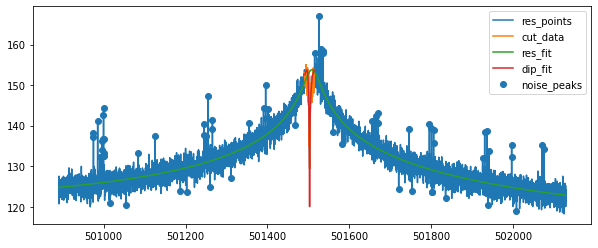

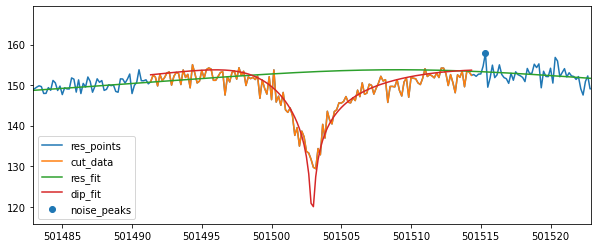

{'A': 2385527274417001.0, 'dA': 1.0852476463911022e-10, 'Q': 14362.7105057239, 'dQ': 35.1609966602117, 'nu_res': 501509.12974184146, 'dnu_res': 0.28003897594505317, 'nu_z': 501502.92334053566, 'dnu_z': 0.023195822391482983, 'dip_width': 5.224198282828366, 'ddip_width': 0.2198102037881354, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.7612070764535062, 'fit_success': True}
cycle1 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [882602982147302.0, 5731.586666666666, 124.64045715332031, -0.0016670760058449408, 501513.8333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8237636653928841
...End fiting resonator
{'A': 2282075341325757.5, 'dA': 1.104630625526148e-10, 'Q': 14098.913720475945, 'dQ': 34.86013055307832, 'nu_res': 501508.7034092169, 'dnu_res': 0.28575387879302033, 'fit_err_chi**2_red': 0.8237636653928841}
resonator fit results:  [ 2.282075341326e+15  1.409891372048e+04  4.832469553822e+11
 -2.440315275333e-04  5.015087034092e+05] [1.104630625526e-10 3.486013055308e+01 4.184877804488e-08
 8.896466691064e-06 2.857538787930e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8481674654150917


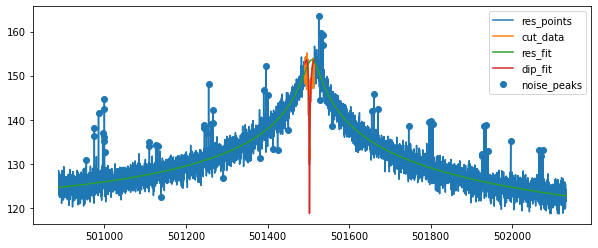

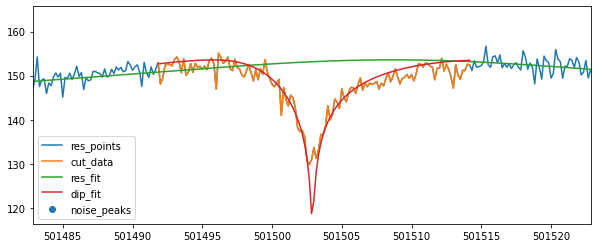

{'A': 2282075341325757.5, 'dA': 1.104630625526148e-10, 'Q': 14098.913720475945, 'dQ': 34.86013055307832, 'nu_res': 501508.7034092169, 'dnu_res': 0.28575387879302033, 'nu_z': 501502.88925691124, 'dnu_z': 0.02437510385228924, 'dip_width': 5.237423928760339, 'ddip_width': 0.2261127970716952, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 1.8481674654150917, 'fit_success': True}
cycle1 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501506.3333333333 430.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


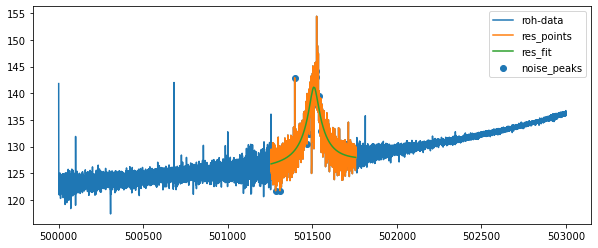

...End fiting resonator
{'A': 126679085793966.77, 'dA': 5.872940787188335e-09, 'off': 4468012904336.693, 'doff': 1.1947269303153927e-07, 'Q': 11387.900260950053, 'dQ': 109.26020425452542, 'th': 0.0003756876141952603, 'dth': 4.302477150488189e-05, 'nu_res': 501509.576513478, 'dnu_res': 0.5026518041213685, 'fit_err_chi**2_red': 3.115990938596814}
Start fiting double dip....
Fit is NOT GOOD !!!!!


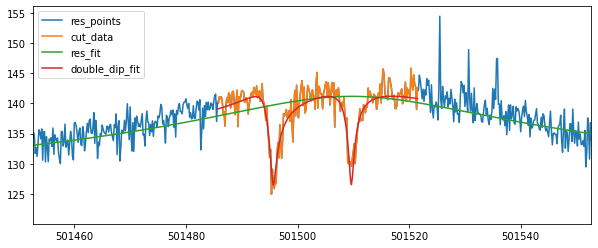

501495.6682053855 0.05686455571133428 501509.6407052596 0.05039116287051655
cycle1 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.6666666667 1241.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


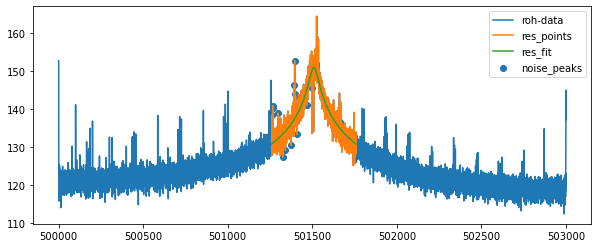

...End fiting resonator
{'A': 1290422587070429.8, 'dA': 2.1905840158616266e-10, 'off': 8798.522783020513, 'doff': 5.6336570946761685e-15, 'Q': 10267.732903885288, 'dQ': 50.73796480947089, 'th': 6.087882464634815e-14, 'dth': 5.065888586290529e-05, 'nu_res': 501509.0789084729, 'dnu_res': 0.4983871867458973, 'fit_err_chi**2_red': 2.9489305546791096}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


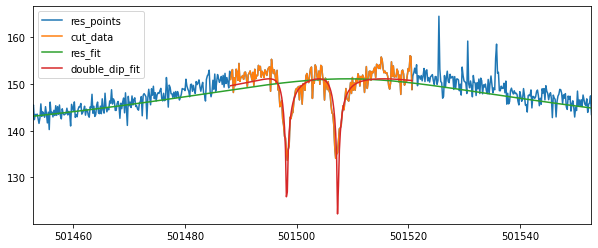

501498.24342184677 0.015770337544939405 501507.3874720017 0.014010596966862876
[501502.92334053566, 501502.88925691124]
503840.97 501502.9062987234 501495.6682053855 501509.6407052596 0.03364805884783116 0.05686455571133428 0.05039116287051655
53273922.2 501502.9062987234 501498.24342184677 501507.3874720017 0.03364805884783116 0.015770337544939405 0.014010596966862876
['cycle1', 'position_1', 3, 0.015, '20211217_180946.699680', 53775424.924595125, 0.03971387966286222, 2338.5673880783143, 0.08309656344228367, 501502.9062987234, 0.03364805884783116, 5.237423928760339, 0.2261127970716952, True, 501508.7034092169, 0.28575387879302033]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle1 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [882593178416921.6, 5842.895145628427, 124.50445221194276, -0.0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8136020407052602
...End fiting resonator
{'A': 2277019913531087.5, 'dA': 1.1390176425597404e-10, 'Q': 14189.104803523298, 'dQ': 35.61450169590178, 'nu_res': 501508.84433757496, 'dnu_res': 0.28414947857671224, 'fit_err_chi**2_red': 0.8136020407052602}
resonator fit results:  [ 2.277019913531e+15  1.418910480352e+04  5.474250691985e+11
 -2.515696350624e-04  5.015088443376e+05] [1.139017642560e-10 3.561450169590e+01 4.184660856703e-08
 9.088870489496e-06 2.841494785767e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7292970637443879


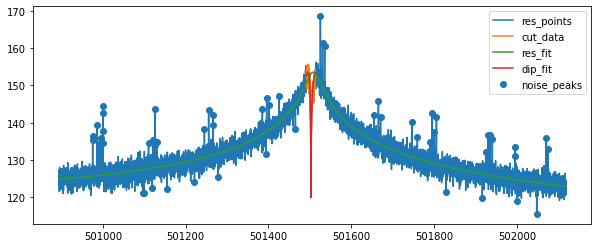

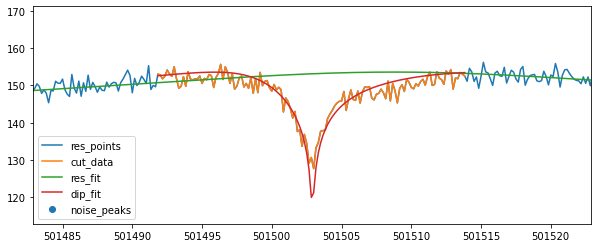

{'A': 2277019913531087.5, 'dA': 1.1390176425597404e-10, 'Q': 14189.104803523298, 'dQ': 35.61450169590178, 'nu_res': 501508.84433757496, 'dnu_res': 0.28414947857671224, 'nu_z': 501502.90490870166, 'dnu_z': 0.023892863351450116, 'dip_width': 5.139612252036503, 'ddip_width': 0.2179350788792724, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.7292970637443879, 'fit_success': True}
cycle1 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [902927953153276.1, 5900.141176470588, 124.31551361083984, -0.001580361792373717, 501512.0]
Start fiting resonator....
chi_reduziert =  0.8240954651918836
...End fiting resonator
{'A': 2119893907078769.8, 'dA': 1.1037510797251388e-10, 'Q': 13613.444770570408, 'dQ': 33.488275632227484, 'nu_res': 501509.1901605806, 'dnu_res': 0.2909730075015968, 'fit_err_chi**2_red': 0.8240954651918836}
resonator fit results:  [ 2.119893907079e+15  1.361344477057e+04  4.384186748299e+11
 -2.454502309456e-04  5.015091901606e+05] [1.10

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



Start fiting dip....
shape 2
chi_reduziert =  2.152480637073279
Fit is NOT GOOD !!!!!


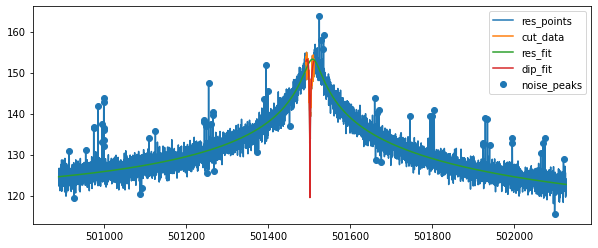

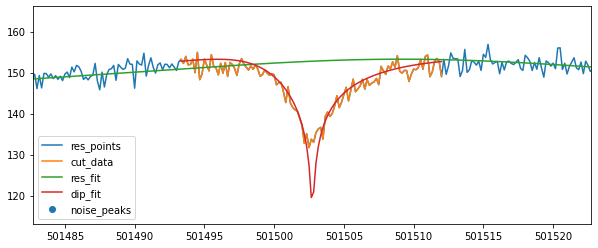

{'A': 2119893907078769.8, 'dA': 1.1037510797251388e-10, 'Q': 13613.444770570408, 'dQ': 33.488275632227484, 'nu_res': 501509.1901605806, 'dnu_res': 0.2909730075015968, 'nu_z': 501502.7382013087, 'dnu_z': 0.0246694503232218, 'dip_width': 4.911714506008107, 'ddip_width': 0.23625400290823986, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.152480637073279, 'fit_success': True}
cycle1 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.0 466.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



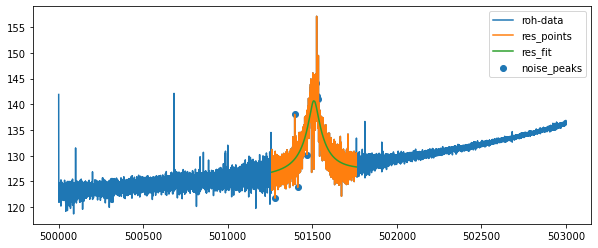

...End fiting resonator
{'A': 113457904639389.78, 'dA': 5.685999261079586e-09, 'off': 4375564697019.126, 'doff': 1.0527632537382875e-07, 'Q': 10578.049098473617, 'dQ': 101.16048033401826, 'th': 0.0003249097836683696, 'dth': 4.310564594680106e-05, 'nu_res': 501509.52295716887, 'dnu_res': 0.5295737472496463, 'fit_err_chi**2_red': 3.2104159470708225}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


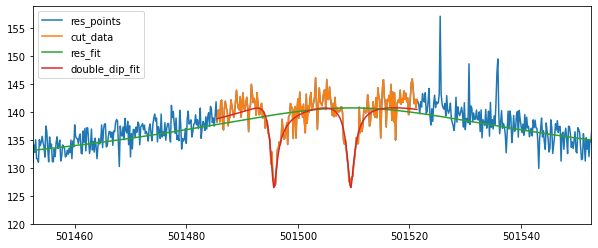

501495.71586917504 0.06227330065877601 501509.45608991716 0.06374821754659103
cycle1 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.3333333333 1256.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



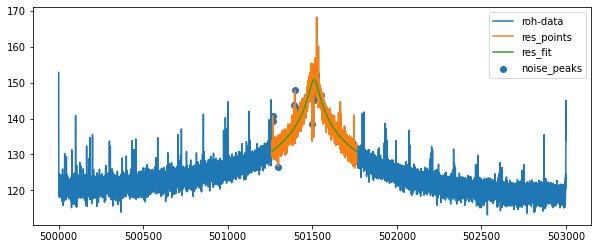

...End fiting resonator
{'A': 1228389019183850.8, 'dA': 2.1502813676364323e-10, 'off': 91423.53958820208, 'doff': 4.882600111863853e-09, 'Q': 9988.411583094266, 'dQ': 48.61726526726837, 'th': 1.5207988927046845e-16, 'dth': 4.99854960596097e-05, 'nu_res': 501509.67569614504, 'dnu_res': 0.49955977542629504, 'fit_err_chi**2_red': 2.967289774980869}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


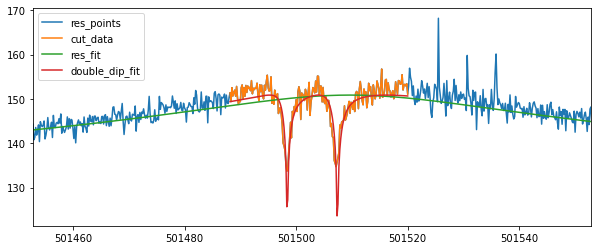

501498.4077919336 0.016573671909667957 501507.4029376105 0.01628441924461946
[501502.90490870166, 501502.7382013087]
503840.97 501502.82155500515 501495.71586917504 501509.45608991716 0.034343131749754216 0.06227330065877601 0.06374821754659103
53273922.2 501502.82155500515 501498.4077919336 501507.4029376105 0.034343131749754216 0.016573671909667957 0.01628441924461946
['cycle1', 'position_1', 3, 0.03, '20211217_174537.656355', 53775425.18917455, 0.04146467905440515, 2338.6195959129254, 0.09550523500670938, 501502.82155500515, 0.034343131749754216, 4.911714506008107, 0.23625400290823986, True, 501509.1901605806, 0.2909730075015968]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle1 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [906788235582207.6, 5935.098619329388, 124.48370361328125, -0.

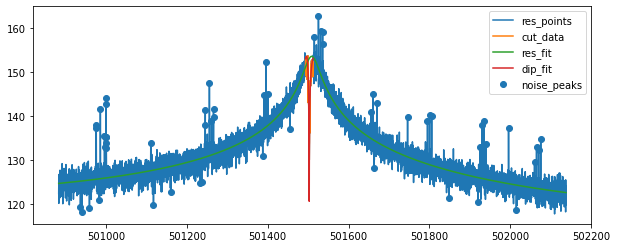

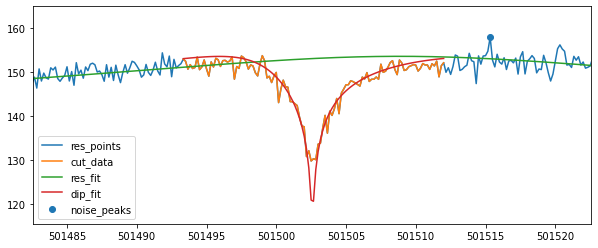

{'A': 2275272023382166.5, 'dA': 1.1175650786844932e-10, 'Q': 14189.122226897704, 'dQ': 34.93587016614894, 'nu_res': 501508.8878304599, 'dnu_res': 0.2811416163378335, 'nu_z': 501502.5851206056, 'dnu_z': 0.020629743814409175, 'dip_width': 4.901972966774833, 'ddip_width': 0.18813912450333034, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.3775579062254384, 'fit_success': True}
cycle1 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [876826857953620.0, 5753.5258126182225, 124.73003170511096, -0.001649257473119245, 501515.6666666667]
Start fiting resonator....
chi_reduziert =  0.8114821442273054
...End fiting resonator
{'A': 2368075407522969.0, 'dA': 1.0934398561607167e-10, 'Q': 14394.326703790848, 'dQ': 35.09439234047429, 'nu_res': 501508.7401551547, 'dnu_res': 0.27901970199054815, 'fit_err_chi**2_red': 0.8114821442273054}
resonator fit results:  [ 2.368075407523e+15  1.439432670379e+04  4.794943878798e+11
 -2.490377054248e-04  5.015087401552e+0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



Start fiting dip....
shape 2
chi_reduziert =  1.9030141519902168


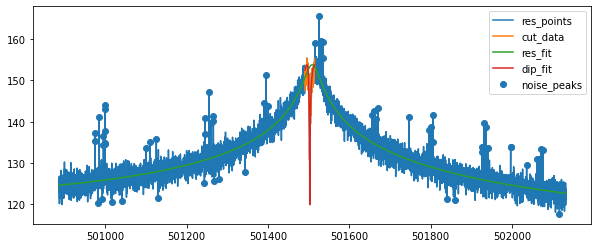

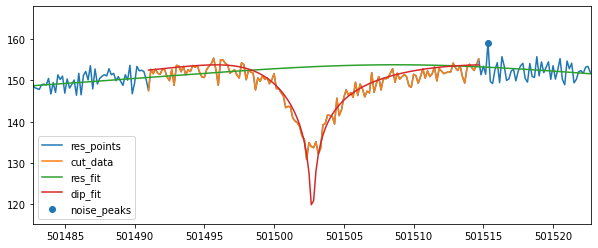

{'A': 2368075407522969.0, 'dA': 1.0934398561607167e-10, 'Q': 14394.326703790848, 'dQ': 35.09439234047429, 'nu_res': 501508.7401551547, 'dnu_res': 0.27901970199054815, 'nu_z': 501502.7413400089, 'dnu_z': 0.023501922566497396, 'dip_width': 5.1197246856917245, 'ddip_width': 0.22490393153791893, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.9030141519902168, 'fit_success': True}
cycle1 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501508.1666666667 436.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



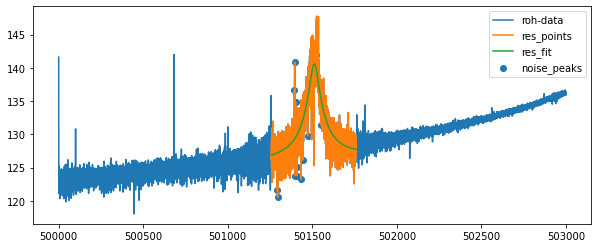

...End fiting resonator
{'A': 112225013650102.58, 'dA': 5.4211985755318815e-09, 'off': 4378464805328.2124, 'doff': 9.924288394190562e-08, 'Q': 10489.533555102209, 'dQ': 96.10126984792939, 'th': 0.00026682623333333514, 'dth': 4.129848373867009e-05, 'nu_res': 501510.9969250153, 'dnu_res': 0.5105118263687213, 'fit_err_chi**2_red': 2.7852549682623677}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


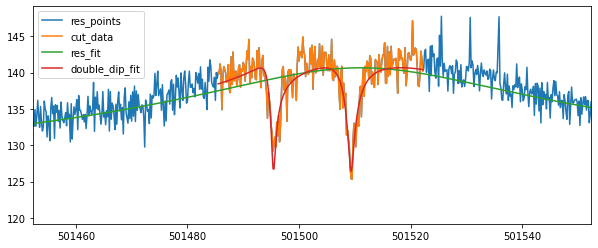

501495.4161960488 0.05523739571275763 501509.3287987761 0.06543006975244195
cycle1 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.0 1210.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



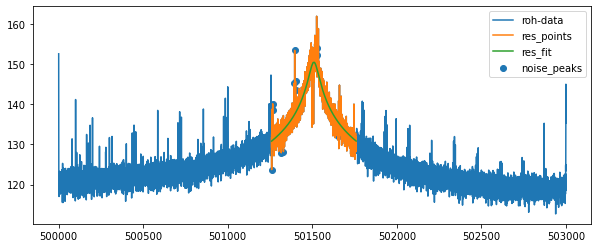

...End fiting resonator
{'A': 1130634635292244.2, 'dA': 2.211184012244174e-10, 'off': 236718.3173890666, 'doff': 6.626488786629908e-09, 'Q': 9615.876638309603, 'dQ': 47.63339611666254, 'th': 3.225916975707611e-19, 'dth': 5.100762344627298e-05, 'nu_res': 501509.25903256494, 'dnu_res': 0.521009136612039, 'fit_err_chi**2_red': 3.0342005268205754}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


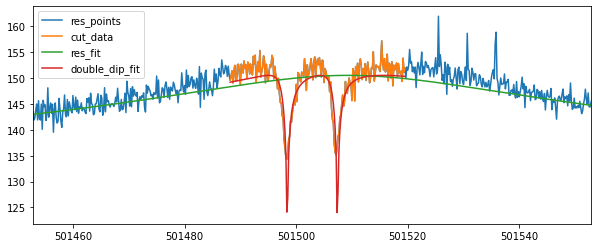

501498.4019675237 0.016954009461293308 501507.3969191161 0.016580596998314382
[501502.5851206056, 501502.7413400089]
503840.97 501502.6632303073 501495.4161960488 501509.3287987761 0.03127181948927489 0.05523739571275763 0.06543006975244195
53273922.2 501502.6632303073 501498.4019675237 501507.3969191161 0.03127181948927489 0.016954009461293308 0.016580596998314382
['cycle1', 'position_1', 3, 0.05, '20211217_173333.066652', 53775425.33565634, 0.03924641802513865, 2338.8882354823872, 0.09116024685742677, 501502.6632303073, 0.03127181948927489, 5.1197246856917245, 0.22490393153791893, True, 501508.7401551547, 0.27901970199054815]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [865645468350550.6, 5645.598499059447, 124.81578826904297, -0.001

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8155695547176053
...End fiting resonator
{'A': 2438025042069736.5, 'dA': 1.1184297777603369e-10, 'Q': 14630.078990902184, 'dQ': 36.375089308999826, 'nu_res': 501508.92154723906, 'dnu_res': 0.2812326626592361, 'fit_err_chi**2_red': 0.8155695547176053}
resonator fit results:  [ 2.438025042070e+15  1.463007899090e+04  5.445422624660e+11
 -2.652767734090e-04  5.015089215472e+05] [1.118429777760e-10 3.637508930900e+01 4.420831984439e-08
 8.952936087103e-06 2.812326626592e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8860684747042071


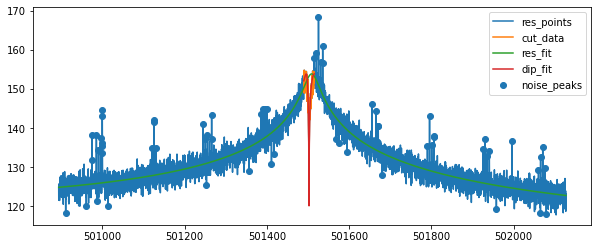

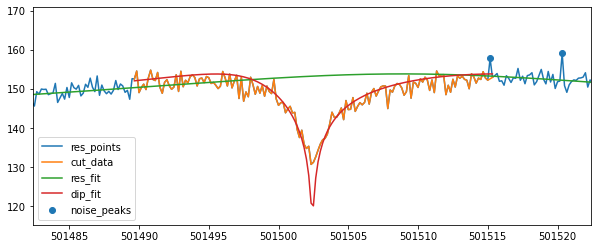

{'A': 2438025042069736.5, 'dA': 1.1184297777603369e-10, 'Q': 14630.078990902184, 'dQ': 36.375089308999826, 'nu_res': 501508.92154723906, 'dnu_res': 0.2812326626592361, 'nu_z': 501502.4225268003, 'dnu_z': 0.02499611238076379, 'dip_width': 5.402785586735833, 'ddip_width': 0.23096425976176382, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.8860684747042071, 'fit_success': True}
cycle2 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [909998201406393.6, 5854.245136189423, 124.65083312988281, -0.0018402704613096844, 501513.6666666667]
Start fiting resonator....
chi_reduziert =  0.816215678740794
...End fiting resonator
{'A': 2346000053326683.0, 'dA': 1.1035311089012968e-10, 'Q': 14309.376341005018, 'dQ': 35.287105014398975, 'nu_res': 501508.8557290796, 'dnu_res': 0.2822035702954688, 'fit_err_chi**2_red': 0.816215678740794}
resonator fit results:  [ 2.346000053327e+15  1.430937634101e+04  5.079136566655e+11
 -2.598605743945e-04  5.015088557291e+05] [1.10

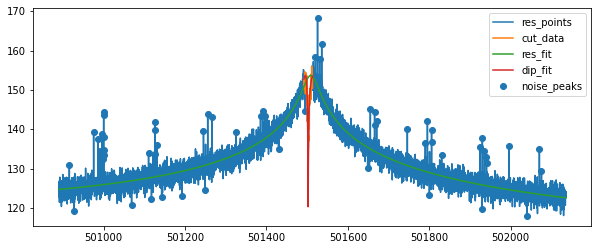

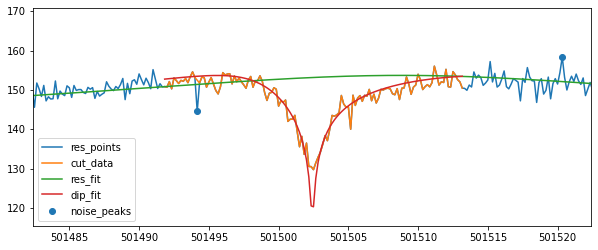

{'A': 2346000053326683.0, 'dA': 1.1035311089012968e-10, 'Q': 14309.376341005018, 'dQ': 35.287105014398975, 'nu_res': 501508.8557290796, 'dnu_res': 0.2822035702954688, 'nu_z': 501502.41815045255, 'dnu_z': 0.021149273522128958, 'dip_width': 5.151502730756845, 'ddip_width': 0.19927845514620357, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.4580221683314116, 'fit_success': True}
cycle2 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501512.6666666667 477.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


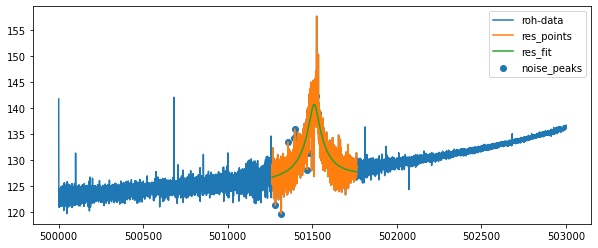

...End fiting resonator
{'A': 115283347593227.56, 'dA': 5.4596213735030565e-09, 'off': 4296352768768.265, 'doff': 1.0199307605291465e-07, 'Q': 10498.159870972564, 'dQ': 99.66329498971396, 'th': 0.00033467344039366794, 'dth': 4.35348718273546e-05, 'nu_res': 501510.55382205127, 'dnu_res': 0.5341731442712873, 'fit_err_chi**2_red': 3.263934537130074}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


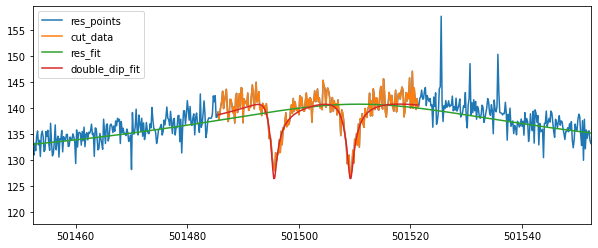

501495.56997015333 0.05666888402299487 501509.2437698684 0.06013549215279296
cycle2 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.6666666667 1209.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


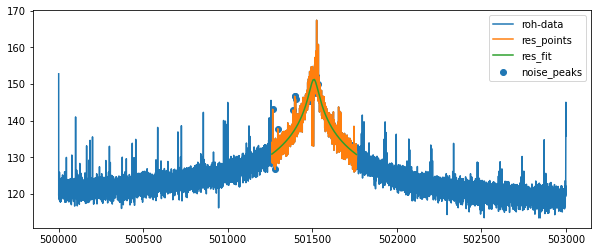

...End fiting resonator
{'A': 1334491184106566.5, 'dA': 2.2459649617439816e-10, 'off': 28.939873456489295, 'doff': 2.7467728259523746e-17, 'Q': 10535.784219045956, 'dQ': 52.54373506679735, 'th': 9.741365750440926e-38, 'dth': 5.103903815946048e-05, 'nu_res': 501509.1868214249, 'dnu_res': 0.4948197226670726, 'fit_err_chi**2_red': 3.052296021406593}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


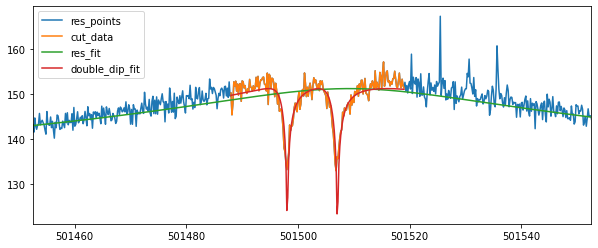

501498.0681907912 0.01499811488775171 501507.0694055265 0.01502702572471847
[501502.4225268003, 501502.41815045255]
503840.97 501502.4203386264 501495.56997015333 501509.2437698684 0.0327428985379364 0.05666888402299487 0.06013549215279296
53273922.2 501502.4203386264 501498.0681907912 501507.0694055265 0.0327428985379364 0.01499811488775171 0.01502702572471847
['cycle2', 'position_1', 3, -0.005, '20211217_191009.665372', 53775424.9172577, 0.039023740940396116, 2338.5765986047336, 0.08888046600651836, 501502.4203386264, 0.0327428985379364, 5.151502730756845, 0.19927845514620357, True, 501508.8557290796, 0.2822035702954688]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [896883517413155.9, 5809.054054055359, 124.46044736020961, -0.001535282

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8213236216573138
...End fiting resonator
{'A': 2380778648076579.5, 'dA': 1.1369688858073631e-10, 'Q': 14548.894416400046, 'dQ': 36.291574984264415, 'nu_res': 501508.9190308181, 'dnu_res': 0.2808048424537765, 'fit_err_chi**2_red': 0.8213236216573138}
resonator fit results:  [ 2.380778648077e+15  1.454889441640e+04  5.403191839396e+11
 -2.499972630074e-04  5.015089190308e+05] [1.136968885807e-10 3.629157498426e+01 4.443602607850e-08
 8.969731794571e-06 2.808048424538e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.2736519835252462
Fit is NOT GOOD !!!!!


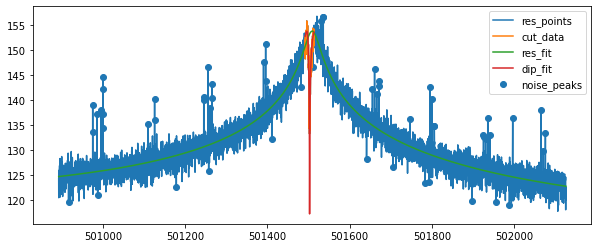

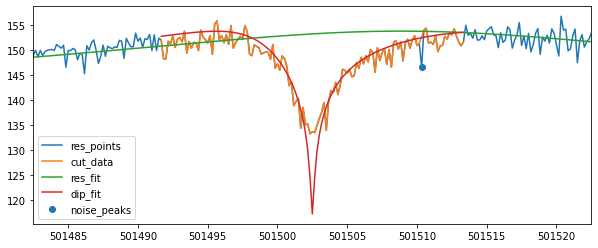

{'A': 2380778648076579.5, 'dA': 1.1369688858073631e-10, 'Q': 14548.894416400046, 'dQ': 36.291574984264415, 'nu_res': 501508.9190308181, 'dnu_res': 0.2808048424537765, 'nu_z': 501502.49897625536, 'dnu_z': 0.03372249304966147, 'dip_width': 5.307569867893101, 'ddip_width': 0.25288476368520574, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.2736519835252462, 'fit_success': True}
cycle2 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [893410133859930.4, 5865.639376218323, 124.47001941462469, -0.0015956655617283785, 501512.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.819835686111918
...End fiting resonator
{'A': 2174744940584362.2, 'dA': 1.123670700878165e-10, 'Q': 13866.586572006923, 'dQ': 34.34229913350988, 'nu_res': 501508.77763988485, 'dnu_res': 0.2880604513635018, 'fit_err_chi**2_red': 0.819835686111918}
resonator fit results:  [ 2.174744940584e+15  1.386658657201e+04  4.892629323020e+11
 -2.505432658702e-04  5.015087776399e+05] [1.123670700878e-10 3.434229913351e+01 4.097521487069e-08
 8.909458454669e-06 2.880604513635e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.857165871717538


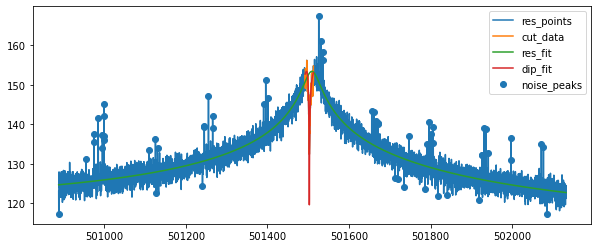

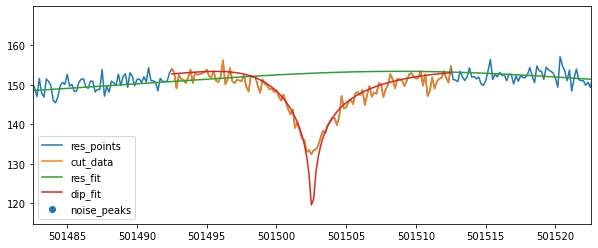

{'A': 2174744940584362.2, 'dA': 1.123670700878165e-10, 'Q': 13866.586572006923, 'dQ': 34.34229913350988, 'nu_res': 501508.77763988485, 'dnu_res': 0.2880604513635018, 'nu_z': 501502.5697706083, 'dnu_z': 0.023915533868125966, 'dip_width': 5.036457462836484, 'ddip_width': 0.22290355664586384, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.857165871717538, 'fit_success': True}
cycle2 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 446.6666666669771
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


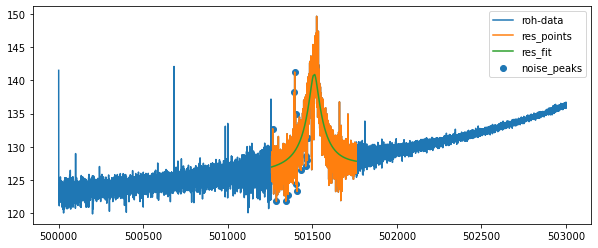

...End fiting resonator
{'A': 120391982726837.11, 'dA': 5.714489737892351e-09, 'off': 4518228545330.957, 'doff': 1.1121911492914915e-07, 'Q': 11136.400052525107, 'dQ': 102.81060564361145, 'th': 0.0002698774540459483, 'dth': 4.0912189224558674e-05, 'nu_res': 501510.76831844053, 'dnu_res': 0.48778615571029627, 'fit_err_chi**2_red': 2.9743408061572048}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


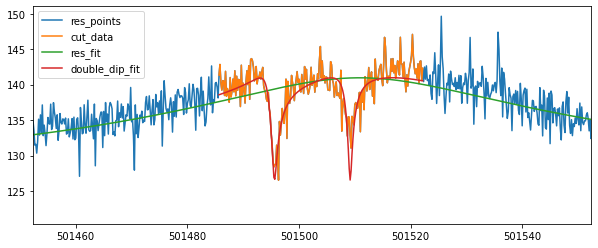

501495.6041983474 0.061620692404996326 501509.1734174155 0.05345735892311371
cycle2 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.6666666667 1250.666666666977
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



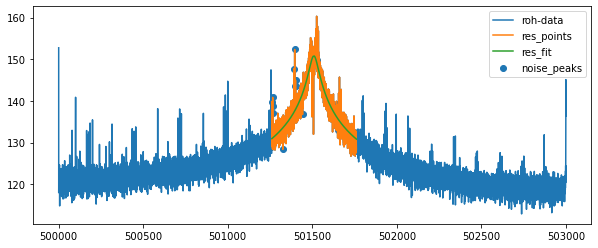

...End fiting resonator
{'A': 1204560245536075.5, 'dA': 2.1831441579049638e-10, 'off': 3071.27733550666, 'doff': 1.8362483735292125e-07, 'Q': 9881.2252012942, 'dQ': 48.88034547228422, 'th': 2.945026070094828e-10, 'dth': 5.08378766094944e-05, 'nu_res': 501509.0060270099, 'dnu_res': 0.5112240879254534, 'fit_err_chi**2_red': 2.9606165484474594}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


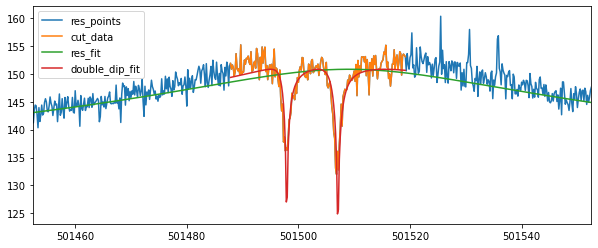

501497.91108799406 0.01567882213215951 501507.07877905015 0.015564004899161042
[501502.49897625536, 501502.5697706083]
503840.97 501502.5343734318 501495.6041983474 501509.1734174155 0.04134197984714745 0.061620692404996326 0.05345735892311371
53273922.2 501502.5343734318 501497.91108799406 501507.07877905015 0.04134197984714745 0.01567882213215951 0.015564004899161042
['cycle2', 'position_1', 3, -0.02, '20211217_183355.953195', 53775424.65549362, 0.04687454543390208, 2338.726757668832, 0.09145467868396741, 501502.5343734318, 0.04134197984714745, 5.036457462836484, 0.22290355664586384, True, 501508.77763988485, 0.2880604513635018]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [852435463139955.9, 5720.68821292649, 124.57891082763672, -0.00

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7951568306081871
...End fiting resonator
{'A': 2240815013912511.5, 'dA': 1.1293815933237741e-10, 'Q': 14093.200485536285, 'dQ': 34.995045289848164, 'nu_res': 501509.0272464974, 'dnu_res': 0.28447959133182943, 'fit_err_chi**2_red': 0.7951568306081871}
resonator fit results:  [ 2.240815013913e+15  1.409320048554e+04  5.083134627953e+11
 -2.585175042718e-04  5.015090272465e+05] [1.129381593324e-10 3.499504528985e+01 4.104076513124e-08
 9.091852916011e-06 2.844795913318e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.875278469968567


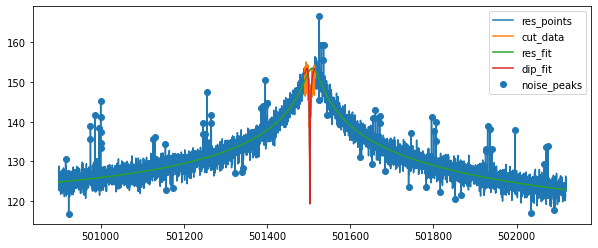

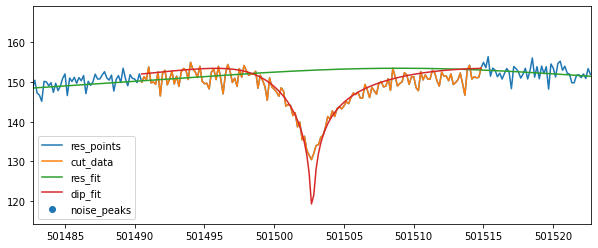

{'A': 2240815013912511.5, 'dA': 1.1293815933237741e-10, 'Q': 14093.200485536285, 'dQ': 34.995045289848164, 'nu_res': 501509.0272464974, 'dnu_res': 0.28447959133182943, 'nu_z': 501502.72970708157, 'dnu_z': 0.0247362132488771, 'dip_width': 5.145155813637646, 'ddip_width': 0.22690126217134893, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.875278469968567, 'fit_success': True}
cycle2 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [873893409703659.4, 5720.7015209112815, 124.74159118097168, -0.0016250126303557647, 501514.8333333333]
Start fiting resonator....
chi_reduziert =  0.8144645299474822
...End fiting resonator
{'A': 2381265204114880.0, 'dA': 1.0963554737068971e-10, 'Q': 14476.09000668897, 'dQ': 35.20014462575292, 'nu_res': 501508.52235704364, 'dnu_res': 0.2790304631002603, 'fit_err_chi**2_red': 0.8144645299474822}
resonator fit results:  [ 2.381265204115e+15  1.447609000669e+04  4.755311209897e+11
 -2.453239983944e-04  5.015085223570e+

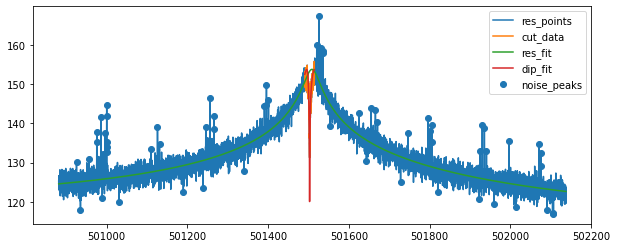

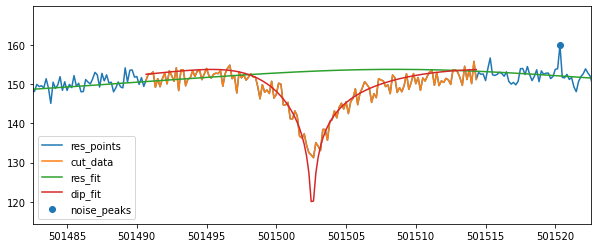

{'A': 2381265204114880.0, 'dA': 1.0963554737068971e-10, 'Q': 14476.09000668897, 'dQ': 35.20014462575292, 'nu_res': 501508.52235704364, 'dnu_res': 0.2790304631002603, 'nu_z': 501502.58160765475, 'dnu_z': 0.02487043566434553, 'dip_width': 5.467842334356906, 'ddip_width': 0.23857092599188479, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.9995807452133134, 'fit_success': True}
cycle2 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501506.3333333333 428.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



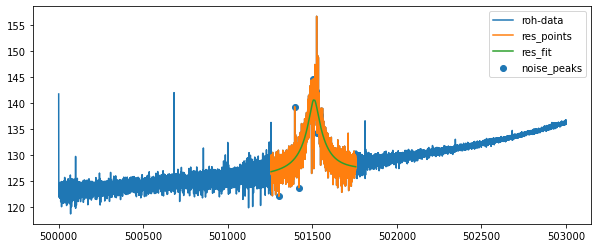

...End fiting resonator
{'A': 112880850796379.66, 'dA': 5.477717469758333e-09, 'off': 4382435521869.388, 'doff': 1.0052052262534593e-07, 'Q': 10495.495619064885, 'dQ': 97.65050976343917, 'th': 0.00028930309911370247, 'dth': 4.2002576603560175e-05, 'nu_res': 501510.0138750776, 'dnu_res': 0.5187252216064413, 'fit_err_chi**2_red': 3.0612276067148767}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


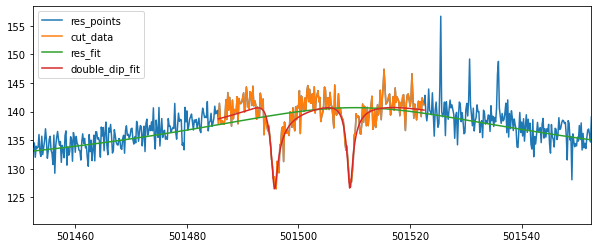

501495.72924239904 0.06223853073549462 501509.23743485287 0.05594053322256507
cycle2 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.5 1240.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


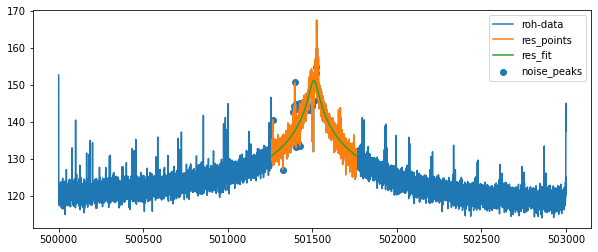

...End fiting resonator
{'A': 1328422510476560.0, 'dA': 2.1913646816851185e-10, 'off': 17170807.496967092, 'doff': 9.282536272533791e-09, 'Q': 10501.072436289847, 'dQ': 51.18814701976016, 'th': 1.0871723051918084e-34, 'dth': 4.9900784125952774e-05, 'nu_res': 501509.2494822013, 'dnu_res': 0.48469488487832385, 'fit_err_chi**2_red': 2.873911457241726}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


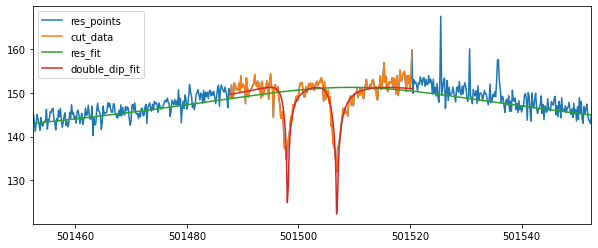

501498.0651963402 0.015425177741738273 501506.89840504667 0.015289958556738915
[501502.72970708157, 501502.58160765475]
503840.97 501502.65565736813 501495.72924239904 501509.23743485287 0.035077326238302044 0.06223853073549462 0.05594053322256507
53273922.2 501502.65565736813 501498.0651963402 501506.89840504667 0.035077326238302044 0.015425177741738273 0.015289958556738915
['cycle2', 'position_1', 3, -0.04, '20211217_183958.229372', 53775424.507944025, 0.04125697222360464, 2338.65898011619, 0.0907380668813607, 501502.65565736813, 0.035077326238302044, 5.467842334356906, 0.23857092599188479, True, 501508.52235704364, 0.2790304631002603]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [905796272448305.4, 5820.272727271416, 124.8234558105468

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8150771891140284
...End fiting resonator
{'A': 2348631982587422.5, 'dA': 1.1076515654775085e-10, 'Q': 14327.533013895063, 'dQ': 35.41266490773074, 'nu_res': 501509.3654379322, 'dnu_res': 0.2819381558745377, 'fit_err_chi**2_red': 0.8150771891140284}
resonator fit results:  [ 2.348631982587e+15  1.432753301390e+04  5.340109163675e+11
 -2.730115985573e-04  5.015093654379e+05] [1.107651565478e-10 3.541266490773e+01 4.234115938794e-08
 8.887022600454e-06 2.819381558745e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8456937219643341


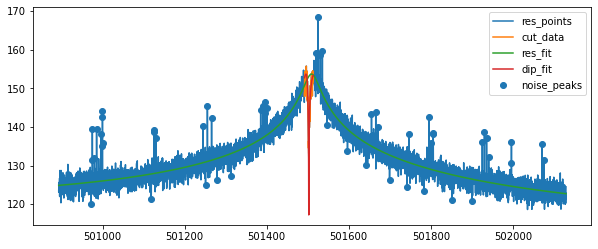

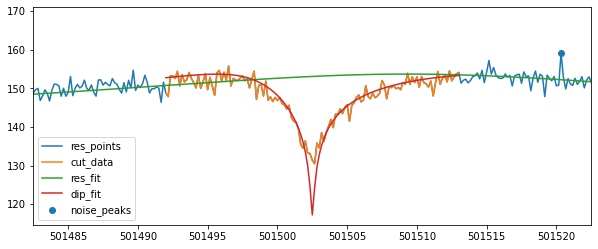

{'A': 2348631982587422.5, 'dA': 1.1076515654775085e-10, 'Q': 14327.533013895063, 'dQ': 35.41266490773074, 'nu_res': 501509.3654379322, 'dnu_res': 0.2819381558745377, 'nu_z': 501502.50279447663, 'dnu_z': 0.030196121825219545, 'dip_width': 5.340424287318743, 'ddip_width': 0.22800805255266549, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.8456937219643341, 'fit_success': True}
cycle2 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [944115233155547.2, 5935.076923076923, 125.03589103124084, -0.0018979728404905614, 501514.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8172661729115455
...End fiting resonator
{'A': 2282798429229581.0, 'dA': 1.1213009044827588e-10, 'Q': 14105.277956660566, 'dQ': 35.365067323702576, 'nu_res': 501508.847333762, 'dnu_res': 0.28644229152438666, 'fit_err_chi**2_red': 0.8172661729115455}
resonator fit results:  [ 2.282798429230e+15  1.410527795666e+04  5.465954787013e+11
 -2.733883816324e-04  5.015088473338e+05] [1.121300904483e-10 3.536506732370e+01 4.096967491241e-08
 9.071902264093e-06 2.864422915244e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6366635278906756


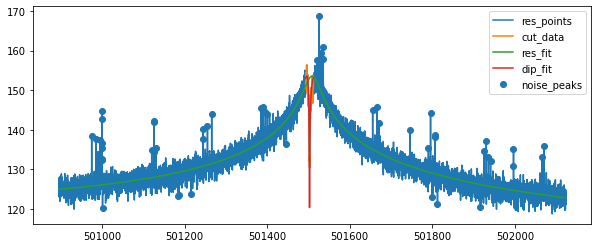

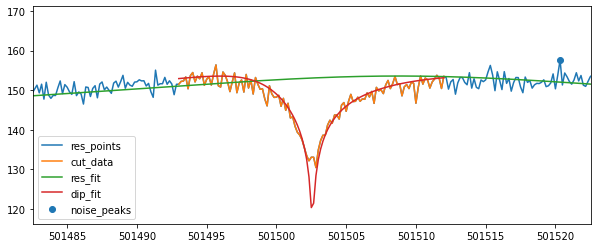

{'A': 2282798429229581.0, 'dA': 1.1213009044827588e-10, 'Q': 14105.277956660566, 'dQ': 35.365067323702576, 'nu_res': 501508.847333762, 'dnu_res': 0.28644229152438666, 'nu_z': 501502.5733377053, 'dnu_z': 0.02222500717819924, 'dip_width': 4.782546320818428, 'ddip_width': 0.20464141850532344, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.6366635278906756, 'fit_success': True}
cycle2 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501508.3333333333 457.3333333330229
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



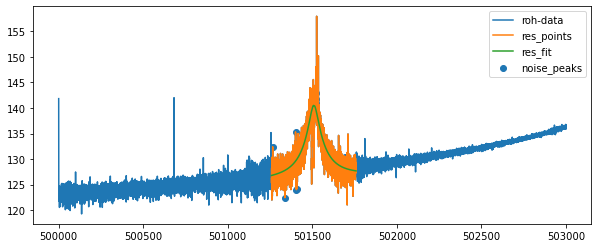

...End fiting resonator
{'A': 109286036045192.62, 'dA': 5.47989342147751e-09, 'off': 4271525753004.8135, 'doff': 9.891708612405347e-08, 'Q': 10303.482876668597, 'dQ': 96.24440333696123, 'th': 0.00028167301352237053, 'dth': 4.2491222504741205e-05, 'nu_res': 501509.06489641126, 'dnu_res': 0.5300841082525976, 'fit_err_chi**2_red': 3.1162643226653257}
Start fiting double dip....
Fit is NOT GOOD !!!!!


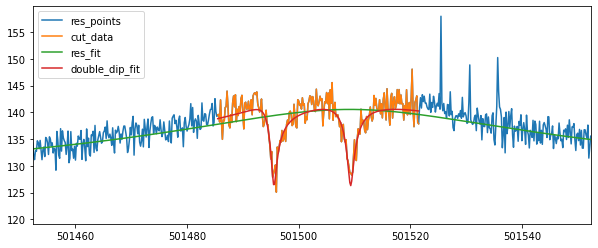

501495.5794788913 0.05926562305369637 501509.31413972704 0.06283832938771589
cycle2 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.1666666667 1225.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



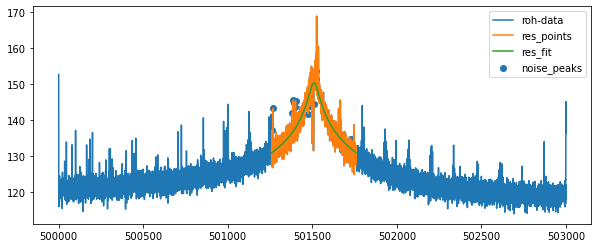

...End fiting resonator
{'A': 1097106317039204.0, 'dA': 2.258621881101881e-10, 'off': 191.22048994015495, 'doff': 7.554534488563179e-17, 'Q': 9419.122679116937, 'dQ': 48.10462887991108, 'th': 1.0899289463433825e-14, 'dth': 5.2663537696822194e-05, 'nu_res': 501509.759871951, 'dnu_res': 0.5443627852963363, 'fit_err_chi**2_red': 3.2295394156215504}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


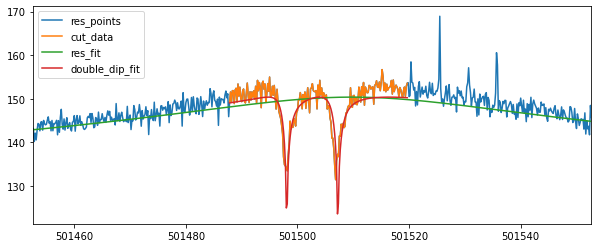

501498.07759656006 0.018354963178690193 501507.23740937584 0.018085145193255048
[501502.50279447663, 501502.5733377053]
503840.97 501502.53806609096 501495.5794788913 501509.31413972704 0.03749342232118199 0.05926562305369637 0.06283832938771589
53273922.2 501502.53806609096 501498.07759656006 501507.23740937584 0.03749342232118199 0.018354963178690193 0.018085145193255048
['cycle2', 'position_1', 3, 0.002, '20211217_190407.342415', 53775424.97693985, 0.04549432785860999, 2338.6144474726752, 0.09416382762789761, 501502.53806609096, 0.03749342232118199, 4.782546320818428, 0.20464141850532344, True, 501508.847333762, 0.28644229152438666]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [850003062536718.1, 5593.105947957811, 124.737331515427, -

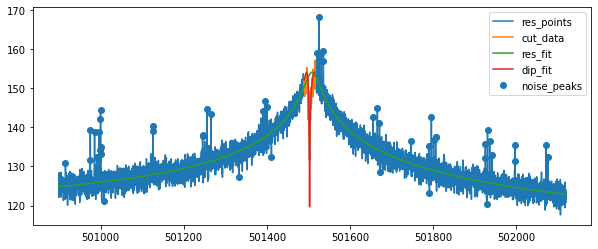

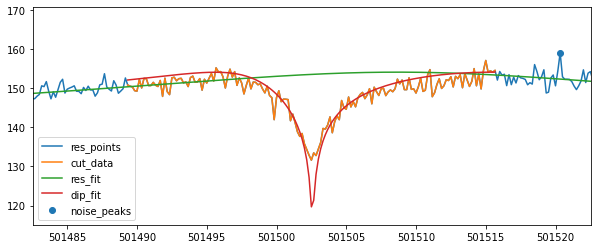

{'A': 2614999151131920.5, 'dA': 1.1372818781213147e-10, 'Q': 15251.286635474364, 'dQ': 38.07951265850456, 'nu_res': 501508.73023085226, 'dnu_res': 0.27435102437891945, 'nu_z': 501502.56742801756, 'dnu_z': 0.025823619632798934, 'dip_width': 5.558473508378048, 'ddip_width': 0.2430939664796498, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.0358657727380822, 'fit_success': True}
cycle2 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [902381236644809.1, 5731.588571428571, 124.71986389160156, -0.0017511274824299713, 501514.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8269573804114931
...End fiting resonator
{'A': 2337772858230272.5, 'dA': 1.0932405510499061e-10, 'Q': 14127.541603059704, 'dQ': 35.27482871364957, 'nu_res': 501508.7980108424, 'dnu_res': 0.28791609808041263, 'fit_err_chi**2_red': 0.8269573804114931}
resonator fit results:  [ 2.337772858230e+15  1.412754160306e+04  5.273170351596e+11
 -2.582902107712e-04  5.015087980108e+05] [1.093240551050e-10 3.527482871365e+01 4.134434997858e-08
 8.926332144049e-06 2.879160980804e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.1944520291794127
Fit is NOT GOOD !!!!!


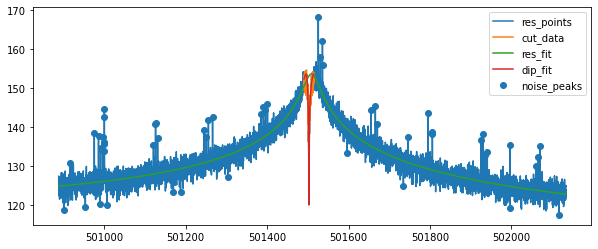

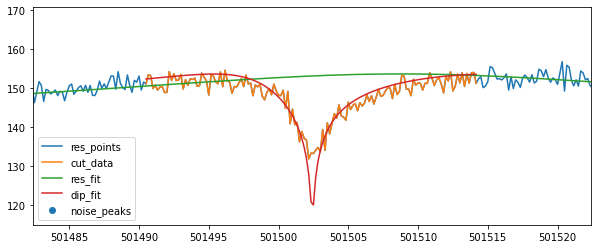

{'A': 2337772858230272.5, 'dA': 1.0932405510499061e-10, 'Q': 14127.541603059704, 'dQ': 35.27482871364957, 'nu_res': 501508.7980108424, 'dnu_res': 0.28791609808041263, 'nu_z': 501502.423134804, 'dnu_z': 0.027014699202902278, 'dip_width': 5.340664749127002, 'ddip_width': 0.24952289913273243, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.1944520291794127, 'fit_success': True}
cycle2 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 449.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



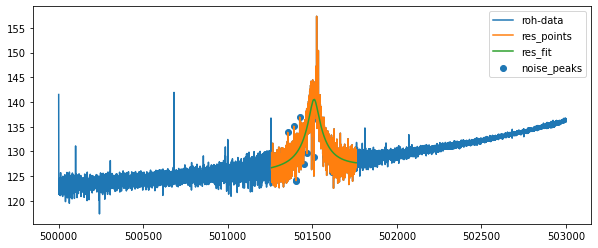

...End fiting resonator
{'A': 109332767665139.62, 'dA': 5.872978004524512e-09, 'off': 4262637664382.4644, 'doff': 1.0738113219153463e-07, 'Q': 10466.211081914595, 'dQ': 101.65390579577263, 'th': 0.0003083085905401515, 'dth': 4.3848464733904454e-05, 'nu_res': 501510.1962140883, 'dnu_res': 0.5425033063750245, 'fit_err_chi**2_red': 3.268510402199837}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


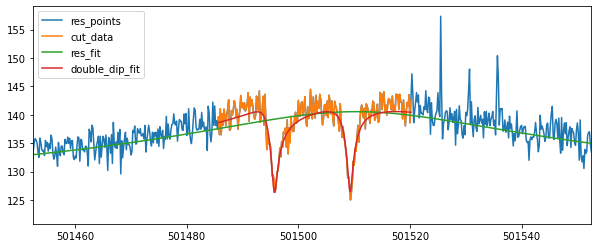

501495.7168707294 0.05783615007559178 501509.2725480422 0.05451302658564259
cycle2 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.3333333333 1245.333333333023
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



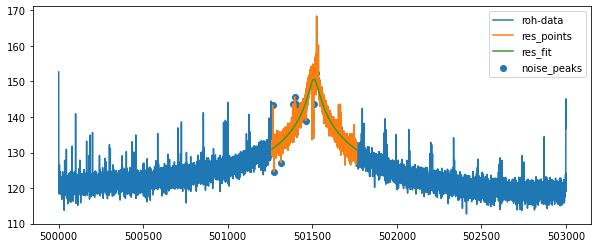

...End fiting resonator
{'A': 1174700676901460.5, 'dA': 2.2485076261552259e-10, 'off': 29.022657114875983, 'doff': 5.4876118460714306e-15, 'Q': 9808.181123117532, 'dQ': 49.42801323550914, 'th': 1.7300288418348862e-12, 'dth': 5.181532903590013e-05, 'nu_res': 501509.52167057357, 'dnu_res': 0.5232721501960287, 'fit_err_chi**2_red': 3.131469222135416}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


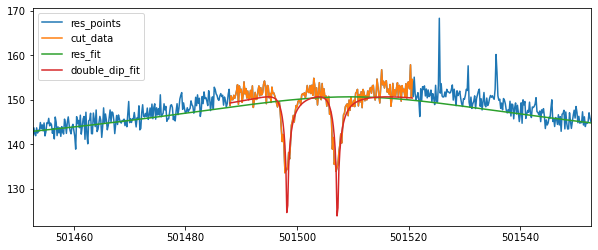

501498.24114748905 0.016256228308794914 501507.24022672273 0.01619315237822073
[501502.56742801756, 501502.423134804]
503840.97 501502.49528141075 501495.7168707294 501509.2725480422 0.037371825001767944 0.05783615007559178 0.05451302658564259
53273922.2 501502.49528141075 501498.24114748905 501507.24022672273 0.037371825001767944 0.016256228308794914 0.01619315237822073
['cycle2', 'position_1', 3, 0.005, '20211217_185805.012611', 53775425.1860928, 0.0438535796342181, 2338.4758626391413, 0.08782564333414312, 501502.49528141075, 0.037371825001767944, 5.340664749127002, 0.24952289913273243, True, 501508.7980108424, 0.28791609808041263]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [878260021248521.5, 5786.703846152551, 124.5909194946289, -0

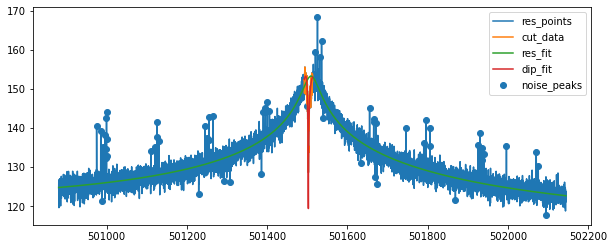

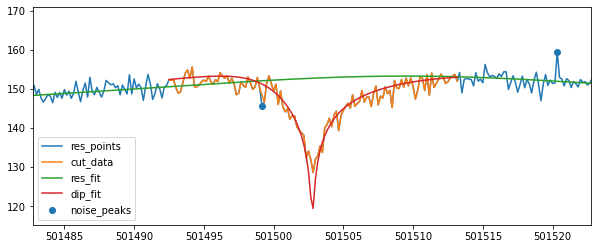

{'A': 2159995371238013.8, 'dA': 1.1146312299281151e-10, 'Q': 13780.04631097914, 'dQ': 34.03310065163345, 'nu_res': 501509.5326823991, 'dnu_res': 0.28606697589205593, 'nu_z': 501502.77729019854, 'dnu_z': 0.0238365975240731, 'dip_width': 4.828100414088874, 'ddip_width': 0.20421858760595954, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.6303154648139402, 'fit_success': True}
cycle2 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [894046028332634.4, 5699.034090909091, 124.5337142944336, -0.0016538216317839288, 501515.0]
Start fiting resonator....
chi_reduziert =  0.8031727025397861
...End fiting resonator
{'A': 2525539994251418.0, 'dA': 1.0901805350410852e-10, 'Q': 14758.795754043262, 'dQ': 36.39672862034554, 'nu_res': 501509.0816552441, 'dnu_res': 0.2756206470895227, 'fit_err_chi**2_red': 0.8031727025397861}
resonator fit results:  [ 2.525539994251e+15  1.475879575404e+04  5.347168496629e+11
 -2.501754913831e-04  5.015090816552e+05] [1.09018

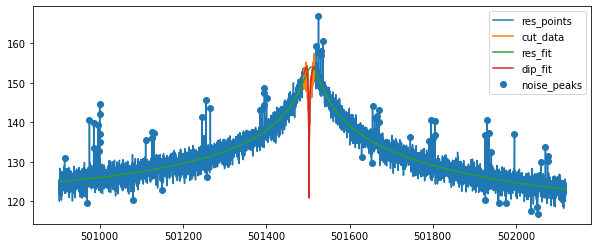

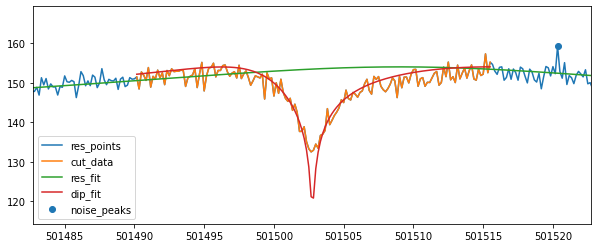

{'A': 2525539994251418.0, 'dA': 1.0901805350410852e-10, 'Q': 14758.795754043262, 'dQ': 36.39672862034554, 'nu_res': 501509.0816552441, 'dnu_res': 0.2756206470895227, 'nu_z': 501502.7522461956, 'dnu_z': 0.023385589028585622, 'dip_width': 4.899048389075553, 'ddip_width': 0.22057457930106694, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.919832306799571, 'fit_success': True}
cycle2 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 452.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



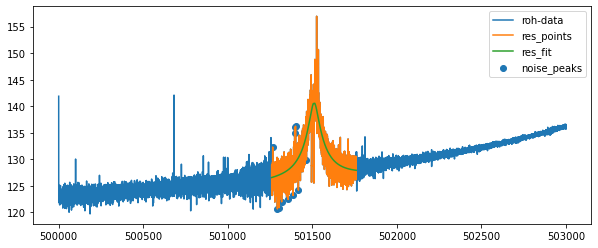

...End fiting resonator
{'A': 112151704480267.78, 'dA': 5.649269105742529e-09, 'off': 4295595826534.766, 'doff': 1.0383052590551731e-07, 'Q': 10432.329007383445, 'dQ': 100.75032888009733, 'th': 0.00042956573217084015, 'dth': 4.3969348101124286e-05, 'nu_res': 501510.39850066684, 'dnu_res': 0.5433834596171161, 'fit_err_chi**2_red': 3.227724465164495}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


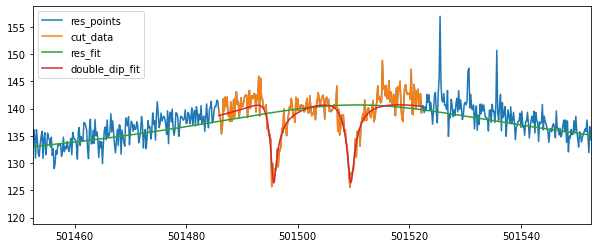

501495.7046959876 0.059893231589873024 501509.51103525696 0.0638785361727411
cycle2 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.0 1244.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


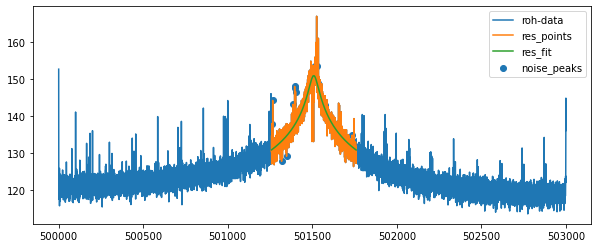

...End fiting resonator
{'A': 1236782455336139.5, 'dA': 2.2144285396052898e-10, 'off': 1236.8704209312855, 'doff': 5.59223114357849e-15, 'Q': 9997.44210591807, 'dQ': 50.36884864182584, 'th': 1.7715470625993667e-13, 'dth': 5.1740931415848694e-05, 'nu_res': 501508.4304011793, 'dnu_res': 0.5168397536115643, 'fit_err_chi**2_red': 3.0352956323265428}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


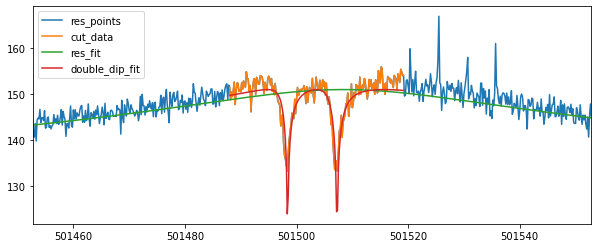

501498.39738208946 0.01580451246000645 501507.2473184584 0.016413791225697513
[501502.77729019854, 501502.7522461956]
503840.97 501502.7647681971 501495.7046959876 501509.51103525696 0.03339265122356343 0.059893231589873024 0.0638785361727411
53273922.2 501502.7647681971 501498.39738208946 501507.2473184584 0.03339265122356343 0.01580451246000645 0.016413791225697513
['cycle2', 'position_1', 3, 0.008, '20211217_191611.918994', 53775425.079932354, 0.040426035079362356, 2338.5190369525226, 0.09371625114988814, 501502.7647681971, 0.03339265122356343, 4.899048389075553, 0.22057457930106694, True, 501509.0816552441, 0.2756206470895227]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [890281602775138.9, 5842.85436893336, 124.97209721441122, -0.00

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8140253737926947
...End fiting resonator
{'A': 2308754983025110.0, 'dA': 1.1467340075194502e-10, 'Q': 14371.557123993633, 'dQ': 35.90628857526996, 'nu_res': 501508.6397864456, 'dnu_res': 0.280913929868963, 'fit_err_chi**2_red': 0.8140253737926947}
resonator fit results:  [ 2.308754983025e+15  1.437155712399e+04  5.778124550495e+11
 -2.487553043786e-04  5.015086397864e+05] [1.146734007519e-10 3.590628857527e+01 4.394226650483e-08
 8.837417497499e-06 2.809139298690e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8870164070503237


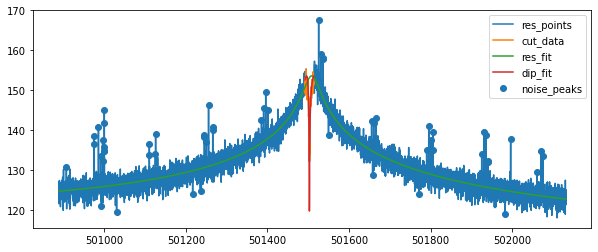

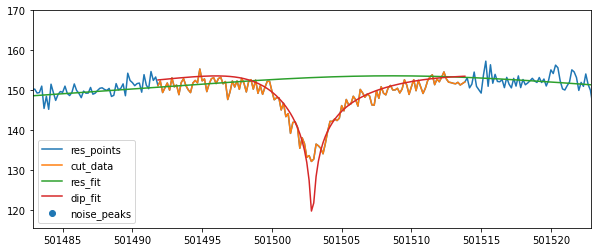

{'A': 2308754983025110.0, 'dA': 1.1467340075194502e-10, 'Q': 14371.557123993633, 'dQ': 35.90628857526996, 'nu_res': 501508.6397864456, 'dnu_res': 0.280913929868963, 'nu_z': 501502.89752243424, 'dnu_z': 0.024963134866348134, 'dip_width': 5.013206028605696, 'ddip_width': 0.2239194992607801, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.8870164070503237, 'fit_success': True}
cycle2 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [873519655384680.9, 5731.588571428571, 124.47000122070312, -0.0016818961011157547, 501514.0]
Start fiting resonator....
chi_reduziert =  0.8181969900336236
...End fiting resonator
{'A': 2320952937943669.0, 'dA': 1.0835917639856415e-10, 'Q': 14223.870349887848, 'dQ': 34.488221022558946, 'nu_res': 501508.6868790608, 'dnu_res': 0.2798015885894959, 'fit_err_chi**2_red': 0.8181969900336236}
resonator fit results:  [ 2.320952937944e+15  1.422387034989e+04  4.918976291229e+11
 -2.517877152329e-04  5.015086868791e+05] [1.083

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



Start fiting dip....
shape 2
chi_reduziert =  1.9719354384126717


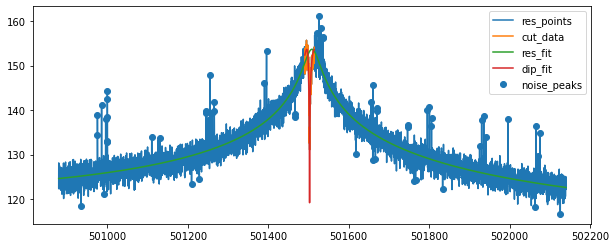

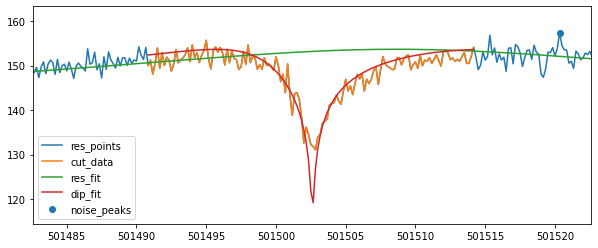

{'A': 2320952937943669.0, 'dA': 1.0835917639856415e-10, 'Q': 14223.870349887848, 'dQ': 34.488221022558946, 'nu_res': 501508.6868790608, 'dnu_res': 0.2798015885894959, 'nu_z': 501502.6049275727, 'dnu_z': 0.024536098230421674, 'dip_width': 5.079238315239667, 'ddip_width': 0.22664840815900536, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.9719354384126717, 'fit_success': True}
cycle2 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 450.6666666669771
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



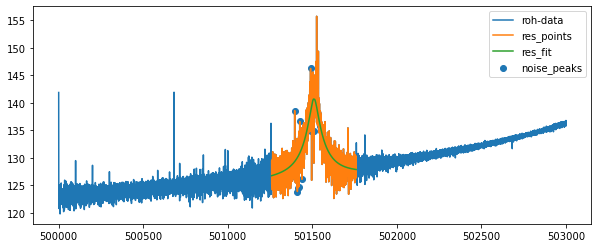

...End fiting resonator
{'A': 114151873506054.0, 'dA': 5.595559563969882e-09, 'off': 4371753724449.6445, 'doff': 1.044399179911286e-07, 'Q': 10648.369944123906, 'dQ': 99.56789937745576, 'th': 0.0003554701207511362, 'dth': 4.21107223336432e-05, 'nu_res': 501509.64970702113, 'dnu_res': 0.5150710075441407, 'fit_err_chi**2_red': 3.0878918848245203}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


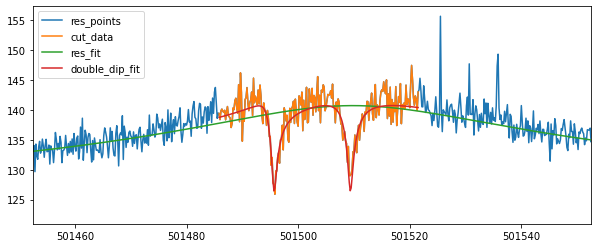

501495.70855261205 0.06067006321123376 501509.3758019584 0.06190312965545992
cycle2 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.5 1245.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



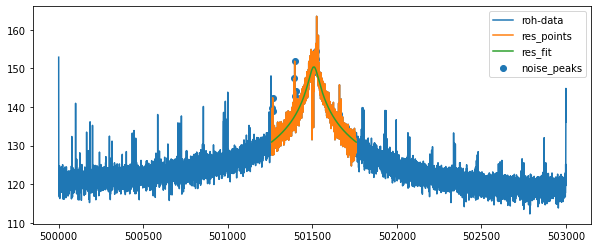

...End fiting resonator
{'A': 1101687381386979.4, 'dA': 2.2078454287364305e-10, 'off': 466.56809296357096, 'doff': 1.4862303530907043e-16, 'Q': 9411.370988127479, 'dQ': 47.25472573827979, 'th': 5.952944694003832e-14, 'dth': 5.1778775413043804e-05, 'nu_res': 501508.91844445706, 'dnu_res': 0.5354718371971539, 'fit_err_chi**2_red': 3.09070960288487}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


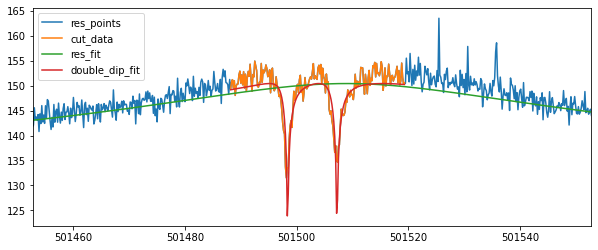

501498.3949169872 0.015206097874449022 501507.23610854923 0.015791266654192233
[501502.89752243424, 501502.6049275727]
503840.97 501502.7512250035 501495.70855261205 501509.3758019584 0.035002545889240504 0.06067006321123376 0.06190312965545992
53273922.2 501502.7512250035 501498.3949169872 501507.23610854923 0.035002545889240504 0.015206097874449022 0.015791266654192233
['cycle2', 'position_1', 3, 0.015, '20211217_182753.591779', 53775425.07980054, 0.041300941076923586, 2338.6368704330525, 0.09347744246567816, 501502.7512250035, 0.035002545889240504, 5.079238315239667, 0.22664840815900536, True, 501508.6868790608, 0.2798015885894959]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [917253900227293.8, 5877.126953126336, 124.5576400756836, -0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8107538320808823
...End fiting resonator
{'A': 2256735961606036.0, 'dA': 1.1232283938727163e-10, 'Q': 14074.72042136976, 'dQ': 35.08689781155488, 'nu_res': 501508.4132078498, 'dnu_res': 0.28438000629958404, 'fit_err_chi**2_red': 0.8107538320808823}
resonator fit results:  [ 2.256735961606e+15  1.407472042137e+04  5.368174419951e+11
 -2.565576657822e-04  5.015084132078e+05] [1.123228393873e-10 3.508689781155e+01 4.034415393537e-08
 9.117204890757e-06 2.843800062996e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6684732900109576


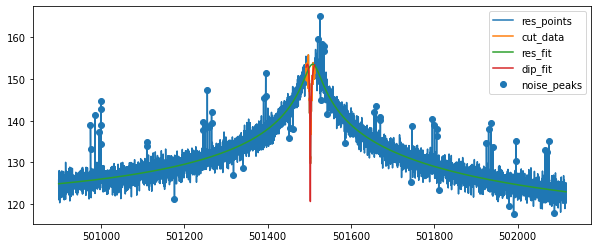

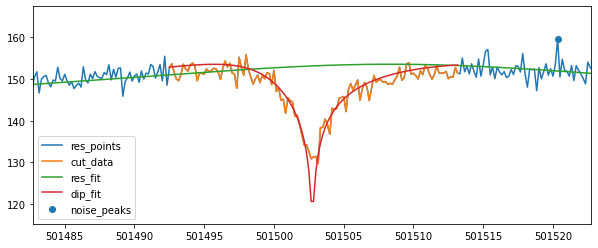

{'A': 2256735961606036.0, 'dA': 1.1232283938727163e-10, 'Q': 14074.72042136976, 'dQ': 35.08689781155488, 'nu_res': 501508.4132078498, 'dnu_res': 0.28438000629958404, 'nu_z': 501502.7492089899, 'dnu_z': 0.022846677273179638, 'dip_width': 5.000848678065045, 'ddip_width': 0.21009396035656963, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.6684732900109576, 'fit_success': True}
cycle2 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [858581915794909.8, 5666.838041431262, 124.78450012207031, -0.0017830265829133802, 501515.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8074890691017711
...End fiting resonator
{'A': 2367161228589772.5, 'dA': 1.0834340590622238e-10, 'Q': 14342.296869777063, 'dQ': 34.885452835542225, 'nu_res': 501509.20074679435, 'dnu_res': 0.27846844908849144, 'fit_err_chi**2_red': 0.8074890691017711}
resonator fit results:  [ 2.367161228590e+15  1.434229686978e+04  5.461296047306e+11
 -2.741479978935e-04  5.015092007468e+05] [1.083434059062e-10 3.488545283554e+01 4.340487704016e-08
 8.448044401307e-06 2.784684490885e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6309011957232624


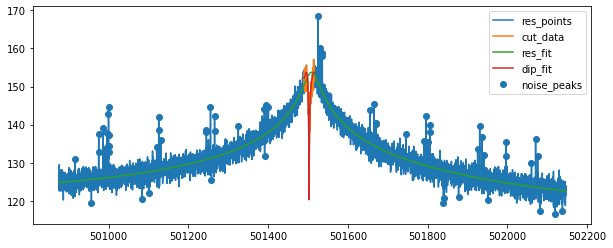

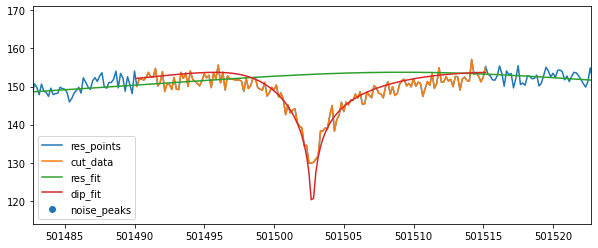

{'A': 2367161228589772.5, 'dA': 1.0834340590622238e-10, 'Q': 14342.296869777063, 'dQ': 34.885452835542225, 'nu_res': 501509.20074679435, 'dnu_res': 0.27846844908849144, 'nu_z': 501502.7464848212, 'dnu_z': 0.02327173383558823, 'dip_width': 5.403539232384286, 'ddip_width': 0.2138495904674251, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.6309011957232624, 'fit_success': True}
cycle2 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.0 458.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


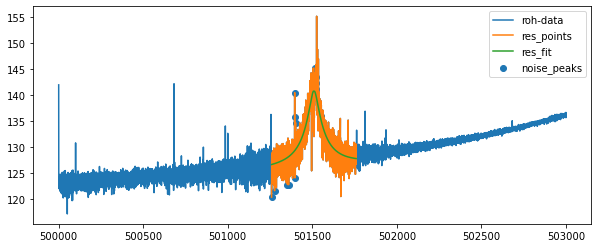

...End fiting resonator
{'A': 118026243836563.34, 'dA': 5.150085489623093e-09, 'off': 4287269117124.8525, 'doff': 9.8308932710431e-08, 'Q': 10636.385166465117, 'dQ': 95.2064535291915, 'th': 0.00035976677684943057, 'dth': 4.1176810128742546e-05, 'nu_res': 501509.6624492906, 'dnu_res': 0.499955456982322, 'fit_err_chi**2_red': 2.910344926195038}
Start fiting double dip....
Fit is NOT GOOD !!!!!


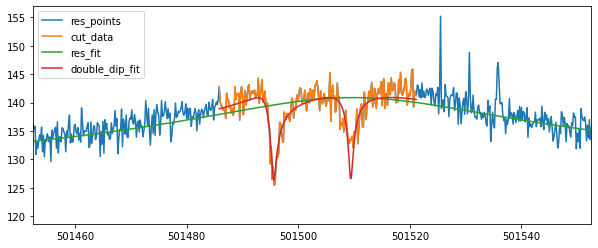

501495.6232330082 0.059363858234633894 501509.41913099604 0.053749742389260294
cycle2 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.8333333333 1246.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


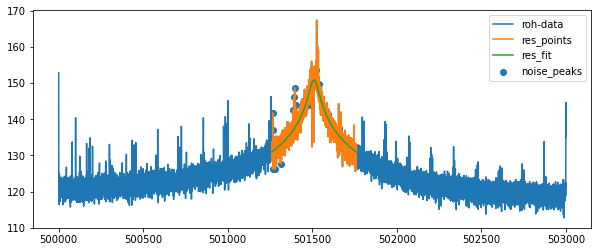

...End fiting resonator
{'A': 1233529173899679.0, 'dA': 2.1609138408479206e-10, 'off': 119792.60376116494, 'doff': 1.0787466340659787e-08, 'Q': 9920.731669000925, 'dQ': 49.36702866299952, 'th': 1.078886816401009e-34, 'dth': 5.1128662368361354e-05, 'nu_res': 501509.7284538291, 'dnu_res': 0.5129778629607782, 'fit_err_chi**2_red': 3.057209081738054}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


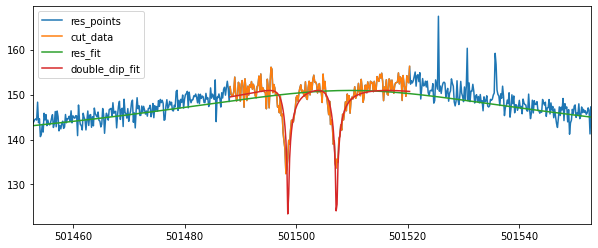

501498.5612014984 0.01587231125391865 501507.2419484523 0.016743443836433256
[501502.7492089899, 501502.7464848212]
503840.97 501502.74784690555 501495.6232330082 501509.41913099604 0.03261202628079533 0.059363858234633894 0.053749742389260294
53273922.2 501502.74784690555 501498.5612014984 501507.2419484523 0.03261202628079533 0.01587231125391865 0.016743443836433256
['cycle2', 'position_1', 3, 0.03, '20211217_185202.729665', 53775425.25530305, 0.0399476837148833, 2338.675482901337, 0.08646760508741318, 501502.74784690555, 0.03261202628079533, 5.403539232384286, 0.2138495904674251, True, 501509.20074679435, 0.27846844908849144]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle2 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [887416279461768.5, 5753.520076480555, 124.78329467773438, -0.0017

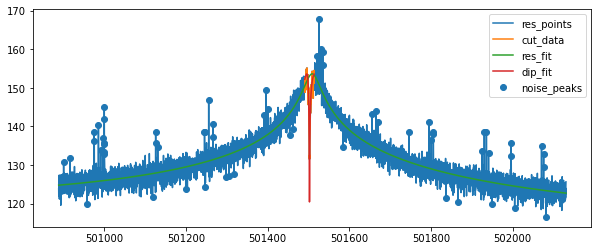

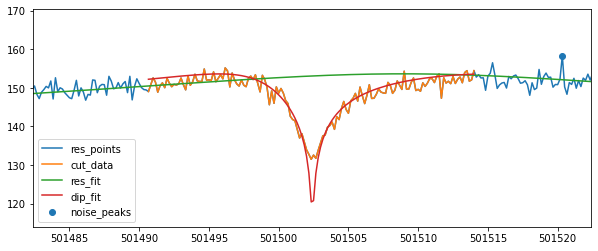

{'A': 2302557144379360.5, 'dA': 1.1176926114987612e-10, 'Q': 14214.402572556097, 'dQ': 35.29894382183961, 'nu_res': 501508.98050308146, 'dnu_res': 0.2838935373741731, 'nu_z': 501502.4132394944, 'dnu_z': 0.02227030128084021, 'dip_width': 5.0356281324094345, 'ddip_width': 0.20542710018334126, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.5884958654780819, 'fit_success': True}
cycle2 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [860496753034806.4, 5656.184210525078, 124.71454880344061, -0.0015916585552933312, 501515.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8173997262037024
...End fiting resonator
{'A': 2356786305305522.0, 'dA': 1.0889774253256635e-10, 'Q': 14291.521194317616, 'dQ': 35.02581615663555, 'nu_res': 501508.6831325881, 'dnu_res': 0.28059211219969016, 'fit_err_chi**2_red': 0.8173997262037024}
resonator fit results:  [ 2.356786305306e+15  1.429152119432e+04  5.505438205823e+11
 -2.518089375829e-04  5.015086831326e+05] [1.088977425326e-10 3.502581615664e+01 4.279631531274e-08
 8.580723624099e-06 2.805921121997e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.0490426416564476
Fit is NOT GOOD !!!!!


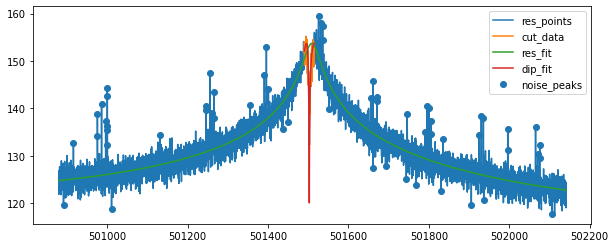

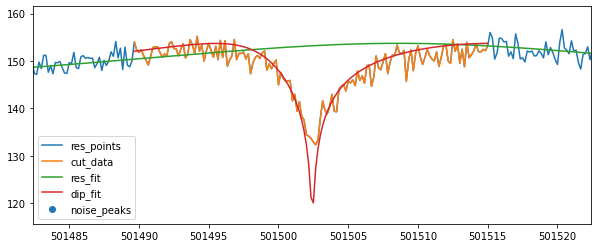

{'A': 2356786305305522.0, 'dA': 1.0889774253256635e-10, 'Q': 14291.521194317616, 'dQ': 35.02581615663555, 'nu_res': 501508.6831325881, 'dnu_res': 0.28059211219969016, 'nu_z': 501502.426542587, 'dnu_z': 0.02574822401195958, 'dip_width': 5.20532499951813, 'ddip_width': 0.23451179168023137, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.0490426416564476, 'fit_success': True}
cycle2 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501507.1666666667 434.6666666669771
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


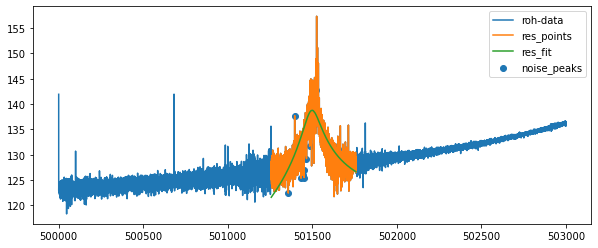

...End fiting resonator
{'A': 75290177309265.89, 'dA': 1.7358943678026403e-09, 'off': 127.02884577873775, 'doff': 1.0127529200422465e-13, 'Q': 5392.531594473314, 'dQ': 41.46259688588089, 'th': 0.0018511262440337897, 'dth': 7.948608005880287e-05, 'nu_res': 501495.9125050846, 'dnu_res': 1.148209565163689, 'fit_err_chi**2_red': 7.132408640892476}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


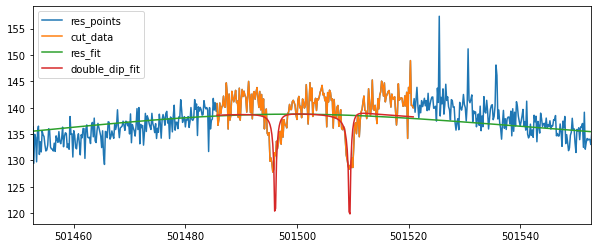

501496.0814763693 0.022463457563722738 501509.42097677494 0.022104407553317343
cycle2 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.8333333333 1254.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



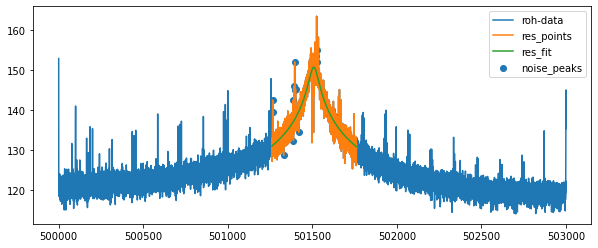

...End fiting resonator
{'A': 1169787837300898.8, 'dA': 2.1865874552303025e-10, 'off': 287335.7739727282, 'doff': 7.341206628178044e-09, 'Q': 9703.908990642052, 'dQ': 48.33219874112654, 'th': 1.8317856175094772e-35, 'dth': 5.124441906951666e-05, 'nu_res': 501508.5104056066, 'dnu_res': 0.5206849275788679, 'fit_err_chi**2_red': 3.0199903687204372}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


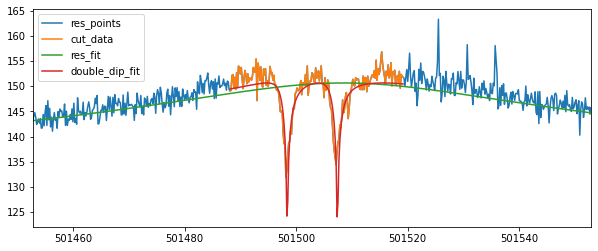

501498.402240604 0.016604605717856435 501507.4019190449 0.016578349514582997
[501502.4132394944, 501502.426542587]
503840.97 501502.41989104066 501496.0814763693 501509.42097677494 0.034043169049156476 0.022463457563722738 0.022104407553317343
53273922.2 501502.41989104066 501498.402240604 501507.4019190449 0.034043169049156476 0.016604605717856435 0.016578349514582997
['cycle2', 'position_1', 3, 0.05, '20211217_184600.467669', 53775425.584268615, 0.04134600298193999, 2337.8874378963956, 0.0463912612235297, 501502.41989104066, 0.034043169049156476, 5.20532499951813, 0.23451179168023137, True, 501508.6831325881, 0.28059211219969016]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [904195093670637.9, 5764.538314176245, 125.0234316940647, -0.

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8052880658019351
...End fiting resonator
{'A': 2433078282949401.0, 'dA': 1.1214572652230485e-10, 'Q': 14656.16595001676, 'dQ': 36.31921260698924, 'nu_res': 501508.64213630423, 'dnu_res': 0.2778326090785828, 'fit_err_chi**2_red': 0.8052880658019351}
resonator fit results:  [ 2.433078282949e+15  1.465616595002e+04  5.516968372624e+11
 -2.596237914614e-04  5.015086421363e+05] [1.121457265223e-10 3.631921260699e+01 4.409038571876e-08
 8.942025987338e-06 2.778326090786e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.97471011922459


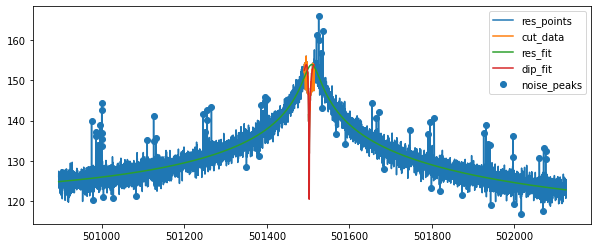

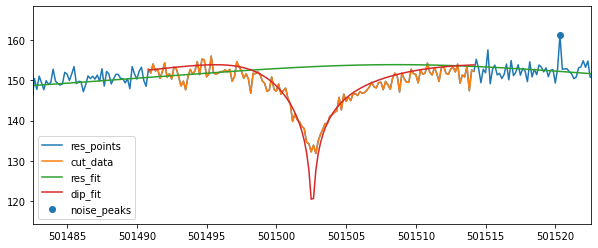

{'A': 2433078282949401.0, 'dA': 1.1214572652230485e-10, 'Q': 14656.16595001676, 'dQ': 36.31921260698924, 'nu_res': 501508.64213630423, 'dnu_res': 0.2778326090785828, 'nu_z': 501502.58109568263, 'dnu_z': 0.025263157097752002, 'dip_width': 5.275868097842308, 'ddip_width': 0.23416324831955238, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.97471011922459, 'fit_success': True}
cycle3 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [899041406071607.9, 5842.906796117826, 124.64921569824219, -0.0016915157476554787, 501516.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8136615004405005
...End fiting resonator
{'A': 2263792232632977.0, 'dA': 1.1323287190121067e-10, 'Q': 14171.386125257884, 'dQ': 35.254139939460934, 'nu_res': 501508.5829157519, 'dnu_res': 0.2837010652033788, 'fit_err_chi**2_red': 0.8136615004405005}
resonator fit results:  [ 2.263792232633e+15  1.417138612526e+04  5.433739111742e+11
 -2.388737277014e-04  5.015085829158e+05] [1.132328719012e-10 3.525413993946e+01 4.180634111689e-08
 8.976726614690e-06 2.837010652034e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7802633870253173


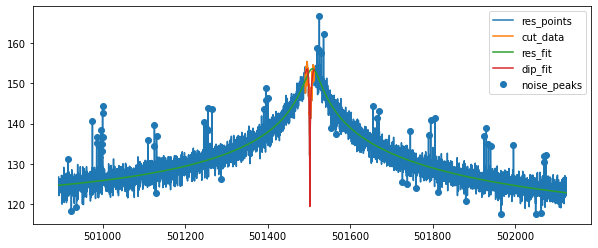

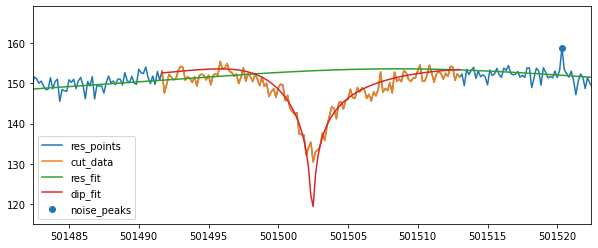

{'A': 2263792232632977.0, 'dA': 1.1323287190121067e-10, 'Q': 14171.386125257884, 'dQ': 35.254139939460934, 'nu_res': 501508.5829157519, 'dnu_res': 0.2837010652033788, 'nu_z': 501502.4398285237, 'dnu_z': 0.023729738500959625, 'dip_width': 4.801311425408444, 'ddip_width': 0.21191790085472587, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.7802633870253173, 'fit_success': True}
cycle3 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501511.8333333333 466.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



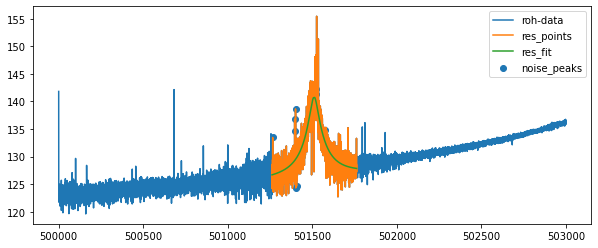

...End fiting resonator
{'A': 116249113979527.58, 'dA': 5.454047598984616e-09, 'off': 4306722730211.9023, 'doff': 1.0293712039016183e-07, 'Q': 10603.195451136258, 'dQ': 99.47315344779011, 'th': 0.0003751456256112159, 'dth': 4.28897131354926e-05, 'nu_res': 501510.40529039624, 'dnu_res': 0.523122776306796, 'fit_err_chi**2_red': 3.085422009896075}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


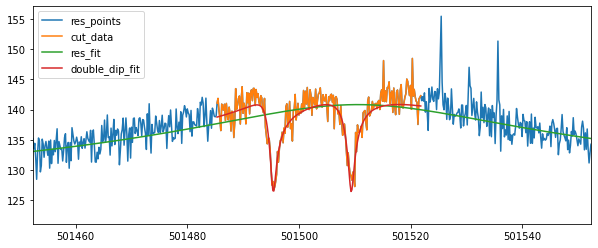

501495.4213222425 0.059337415406676794 501509.3871166029 0.060458970056194904
cycle3 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.3333333333 1238.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



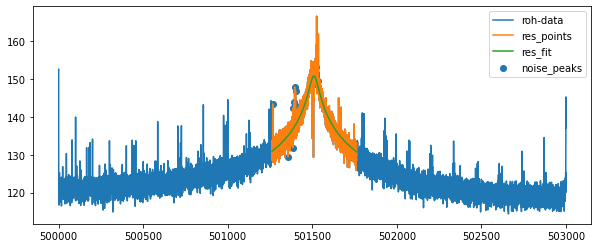

...End fiting resonator
{'A': 1229586096253914.5, 'dA': 2.2495874510796094e-10, 'off': 65561.95973747209, 'doff': 6.45147714238396e-09, 'Q': 10018.06451628471, 'dQ': 50.774662511003726, 'th': 3.36714617602592e-10, 'dth': 5.2037324126641275e-05, 'nu_res': 501509.44808125886, 'dnu_res': 0.5191842287227992, 'fit_err_chi**2_red': 3.0933946039080835}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


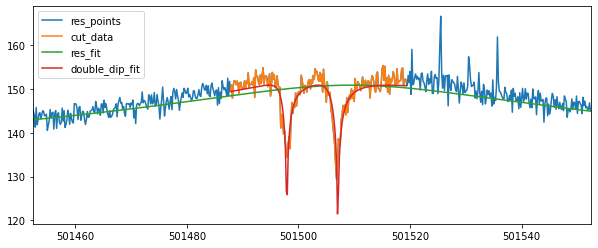

501497.91887900606 0.015809383757971193 501507.0588890116 0.014644656755616763
[501502.58109568263, 501502.4398285237]
503840.97 501502.5104621032 501495.4213222425 501509.3871166029 0.0346601730501973 0.059337415406676794 0.060458970056194904
53273922.2 501502.5104621032 501497.91887900606 501507.0588890116 0.0346601730501973 0.015809383757971193 0.014644656755616763
['cycle3', 'position_1', 3, -0.005, '20211217_194623.564157', 53775424.66730591, 0.04081335788888558, 2338.6720232577645, 0.09152892178579414, 501502.5104621032, 0.0346601730501973, 4.801311425408444, 0.21191790085472587, True, 501508.5829157519, 0.2837010652033788]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [910096164405383.8, 5809.0424710437765, 124.90788384979392, -0.0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8118305338199846
...End fiting resonator
{'A': 2555998607418449.5, 'dA': 1.1147506014731356e-10, 'Q': 15001.669739772142, 'dQ': 37.08226283778637, 'nu_res': 501508.0275547872, 'dnu_res': 0.27531135585354344, 'fit_err_chi**2_red': 0.8118305338199846}
resonator fit results:  [ 2.555998607418e+15  1.500166973977e+04  5.068332452014e+11
 -2.600778131240e-04  5.015080275548e+05] [1.114750601473e-10 3.708226283779e+01 4.696818895337e-08
 8.898333177089e-06 2.753113558535e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7932134984478456


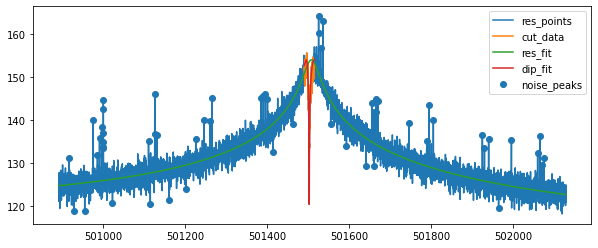

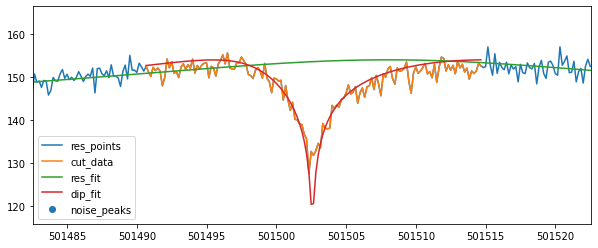

{'A': 2555998607418449.5, 'dA': 1.1147506014731356e-10, 'Q': 15001.669739772142, 'dQ': 37.08226283778637, 'nu_res': 501508.0275547872, 'dnu_res': 0.27531135585354344, 'nu_z': 501502.5813414856, 'dnu_z': 0.023410244268772546, 'dip_width': 5.345122347125145, 'ddip_width': 0.22525901858697092, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.7932134984478456, 'fit_success': True}
cycle3 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [941231083947202.5, 5688.25141777188, 124.90220642089844, -0.0014615462837743694, 501514.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8080437102851687
...End fiting resonator
{'A': 2609963542269119.0, 'dA': 9.936685942883937e-11, 'Q': 14528.984786278263, 'dQ': 34.846905275081355, 'nu_res': 501508.57385760685, 'dnu_res': 0.2755444769305623, 'fit_err_chi**2_red': 0.8080437102851687}
resonator fit results:  [ 2.609963542269e+15  1.452898478628e+04  4.963461992608e+11
 -2.333253181894e-04  5.015085738576e+05] [9.936685942884e-11 3.484690527508e+01 4.102600265069e-08
 8.532512410152e-06 2.755444769306e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.388063058592879
Fit is NOT GOOD !!!!!


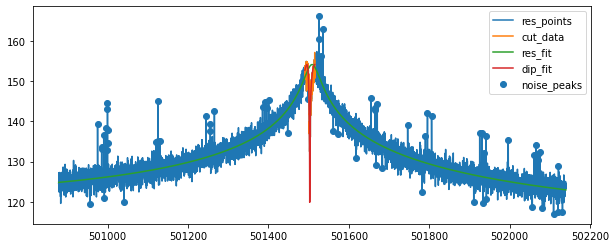

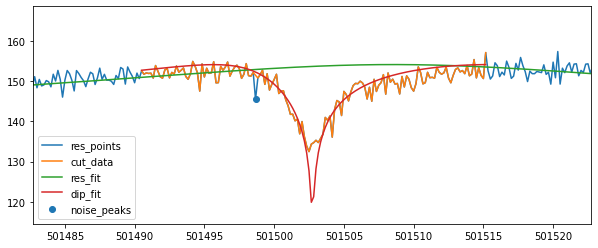

{'A': 2609963542269119.0, 'dA': 9.936685942883937e-11, 'Q': 14528.984786278263, 'dQ': 34.846905275081355, 'nu_res': 501508.57385760685, 'dnu_res': 0.2755444769305623, 'nu_z': 501502.7379522561, 'dnu_z': 0.026251195703465062, 'dip_width': 5.304904809133023, 'ddip_width': 0.2558417935582944, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 2.388063058592879, 'fit_success': True}
cycle3 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.8333333333 445.3333333330229
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


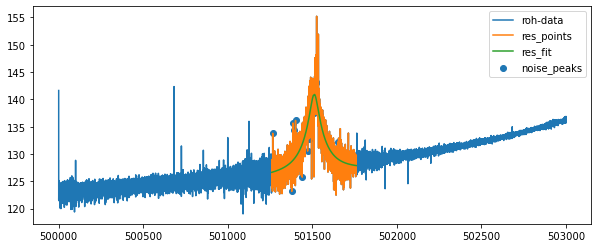

...End fiting resonator
{'A': 119725535130272.64, 'dA': 5.613570847711785e-09, 'off': 4315547415911.553, 'doff': 1.0928238849788998e-07, 'Q': 10868.591481379906, 'dQ': 103.13857297739936, 'th': 0.0003896447345150961, 'dth': 4.3275433563898164e-05, 'nu_res': 501511.1485948505, 'dnu_res': 0.5191622838350562, 'fit_err_chi**2_red': 3.1279107374925545}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


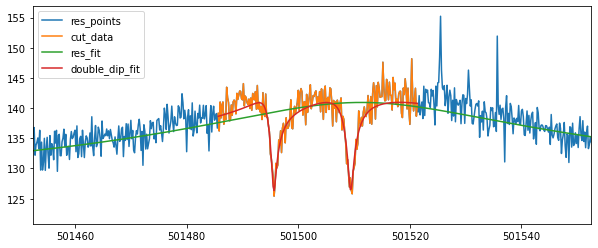

501495.6359964781 0.05644640419915414 501509.4045639407 0.05952121076566447
cycle3 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.1666666667 1245.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



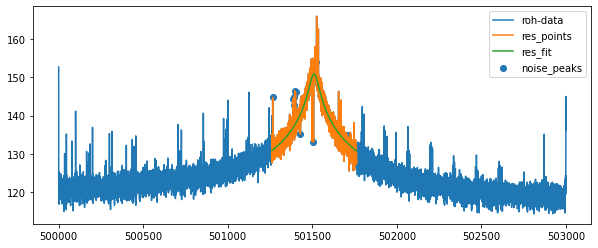

...End fiting resonator
{'A': 1226470962724811.8, 'dA': 2.22689723577511e-10, 'off': 4091.4418128714897, 'doff': 1.1389225974101063e-16, 'Q': 10016.233506000237, 'dQ': 50.144019659997, 'th': 8.266799381211725e-14, 'dth': 5.1404710876379854e-05, 'nu_res': 501509.93214997894, 'dnu_res': 0.5129290383707742, 'fit_err_chi**2_red': 3.1393914052947385}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


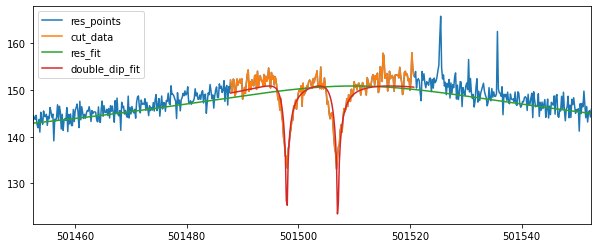

501497.92034902127 0.016095024129249066 501507.06967150857 0.015927357661558627
[501502.5813414856, 501502.7379522561]
503840.97 501502.65964687086 501495.6359964781 501509.4045639407 0.035173353729566655 0.05644640419915414 0.05952121076566447
53273922.2 501502.65964687086 501497.92034902127 501507.06967150857 0.035173353729566655 0.016095024129249066 0.015927357661558627
['cycle3', 'position_1', 3, -0.02, '20211217_195828.168477', 53775424.53037367, 0.04183175033853521, 2338.589086451975, 0.08925321221452008, 501502.65964687086, 0.035173353729566655, 5.304904809133023, 0.2558417935582944, True, 501508.57385760685, 0.2755444769305623]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [866177556325999.8, 5666.813559322034, 124.67217846442875,

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8033095661365635
...End fiting resonator
{'A': 2392406354643748.5, 'dA': 1.1206520676956388e-10, 'Q': 14459.117026931679, 'dQ': 36.155577999439934, 'nu_res': 501508.6333004094, 'dnu_res': 0.28159415022191847, 'fit_err_chi**2_red': 0.8033095661365635}
resonator fit results:  [ 2.392406354644e+15  1.445911702693e+04  5.672791420456e+11
 -2.559197721773e-04  5.015086333004e+05] [1.120652067696e-10 3.615557799944e+01 4.276893687704e-08
 9.016963975185e-06 2.815941502219e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8964600075569482


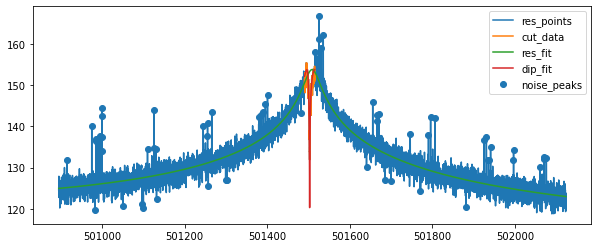

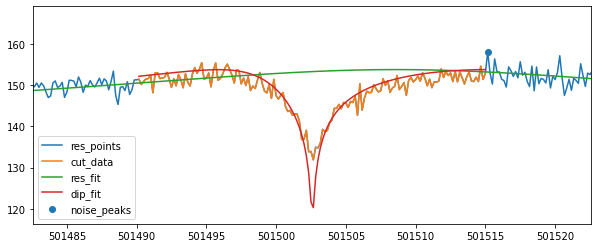

{'A': 2392406354643748.5, 'dA': 1.1206520676956388e-10, 'Q': 14459.117026931679, 'dQ': 36.155577999439934, 'nu_res': 501508.6333004094, 'dnu_res': 0.28159415022191847, 'nu_z': 501502.5948811208, 'dnu_z': 0.024632660120016477, 'dip_width': 4.965930737798952, 'ddip_width': 0.22367477767983712, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.8964600075569482, 'fit_success': True}
cycle3 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [917900980318577.2, 5935.065088757397, 124.41212463378906, -0.0018011414354231683, 501513.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8089292175561239
...End fiting resonator
{'A': 2300028437016914.0, 'dA': 1.0986840300137664e-10, 'Q': 14227.107174201925, 'dQ': 34.63424883302302, 'nu_res': 501508.7898966432, 'dnu_res': 0.27859772640228037, 'fit_err_chi**2_red': 0.8089292175561239}
resonator fit results:  [ 2.300028437017e+15  1.422710717420e+04  5.458514964035e+11
 -2.494191245363e-04  5.015087898966e+05] [1.098684030014e-10 3.463424883302e+01 4.303913005142e-08
 8.474617221285e-06 2.785977264023e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7650141335612777


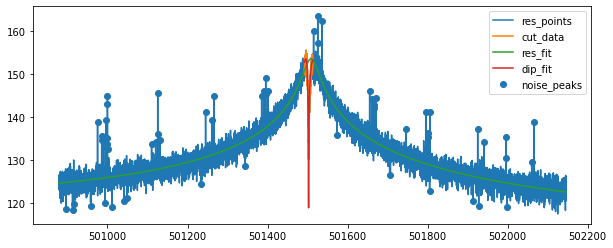

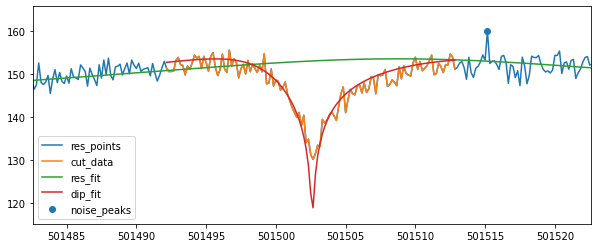

{'A': 2300028437016914.0, 'dA': 1.0986840300137664e-10, 'Q': 14227.107174201925, 'dQ': 34.63424883302302, 'nu_res': 501508.7898966432, 'dnu_res': 0.27859772640228037, 'nu_z': 501502.6140908914, 'dnu_z': 0.024868205256599846, 'dip_width': 5.157454810447398, 'ddip_width': 0.2180984257884584, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.7650141335612777, 'fit_success': True}
cycle3 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.0 442.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



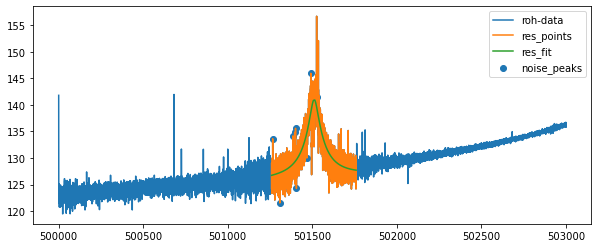

...End fiting resonator
{'A': 122025778477550.4, 'dA': 5.488420847941194e-09, 'off': 4300825466033.0938, 'doff': 1.0967543446093645e-07, 'Q': 11105.85054353717, 'dQ': 100.79233235565272, 'th': 0.000299936905473456, 'dth': 4.12720417821869e-05, 'nu_res': 501510.92365264974, 'dnu_res': 0.48820055252310246, 'fit_err_chi**2_red': 3.0682421568872007}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


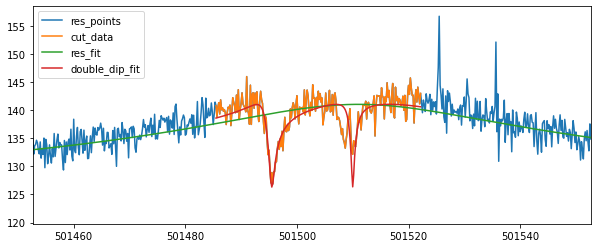

501495.5144021059 0.06768542425693223 501510.0116000637 0.04894592601026787
cycle3 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.8333333333 1241.333333333023
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



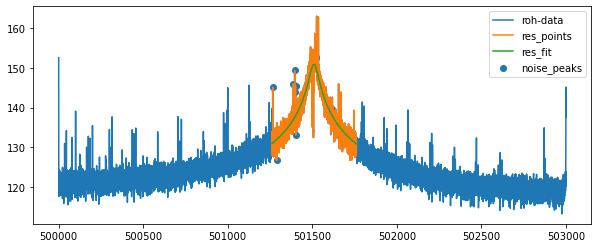

...End fiting resonator
{'A': 1246627568050346.8, 'dA': 2.2022457404807024e-10, 'off': 10184.95870720828, 'doff': 5.573410834401045e-17, 'Q': 10121.436561135222, 'dQ': 49.92597584338493, 'th': 1.7152311108419064e-12, 'dth': 5.0612189561854e-05, 'nu_res': 501509.21508519066, 'dnu_res': 0.5020147750792826, 'fit_err_chi**2_red': 3.0119199439863378}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


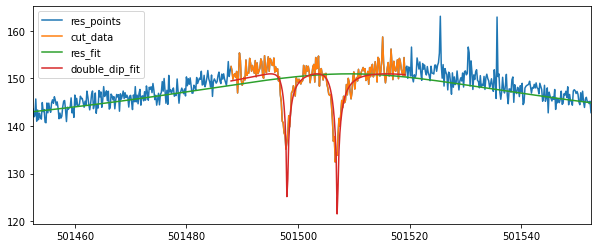

501498.0645255619 0.01705647149090073 501507.0573025704 0.01609332458098927
[501502.5948811208, 501502.6140908914]
503840.97 501502.6044860061 501495.5144021059 501510.0116000637 0.035002793849529076 0.06768542425693223 0.04894592601026787
53273922.2 501502.6044860061 501498.0645255619 501507.0573025704 0.035002793849529076 0.01705647149090073 0.01609332458098927
['cycle3', 'position_1', 3, -0.04, '20211217_200430.478288', 53775424.71734213, 0.04213210050616529, 2338.0484838364646, 0.09056608585511554, 501502.6044860061, 0.035002793849529076, 5.157454810447398, 0.2180984257884584, True, 501508.7898966432, 0.27859772640228037]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [936669467572322.8, 5935.082840236686, 125.04906133342969, -0.001656

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8237212558127045
...End fiting resonator
{'A': 2270587859700934.0, 'dA': 1.0948232738825914e-10, 'Q': 14013.432101561095, 'dQ': 34.58282236264761, 'nu_res': 501508.81417041365, 'dnu_res': 0.2861887415741518, 'fit_err_chi**2_red': 0.8237212558127045}
resonator fit results:  [ 2.270587859701e+15  1.401343210156e+04  4.902856869084e+11
 -2.553925486694e-04  5.015088141704e+05] [1.094823273883e-10 3.458282236265e+01 4.104592297370e-08
 8.861160188133e-06 2.861887415742e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5906683892025983


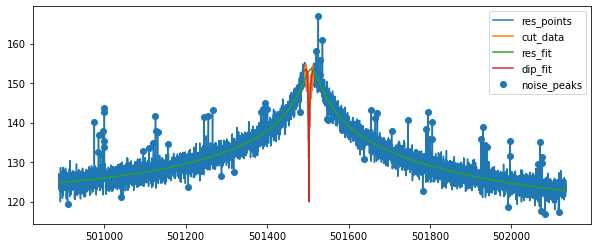

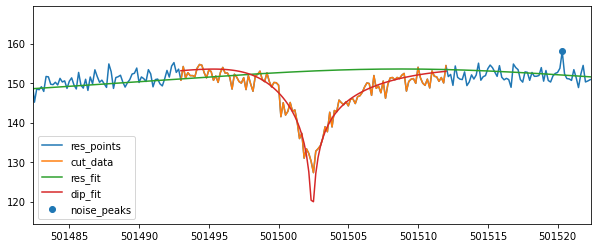

{'A': 2270587859700934.0, 'dA': 1.0948232738825914e-10, 'Q': 14013.432101561095, 'dQ': 34.58282236264761, 'nu_res': 501508.81417041365, 'dnu_res': 0.2861887415741518, 'nu_z': 501502.41960291314, 'dnu_z': 0.022569852769409315, 'dip_width': 5.36487766077721, 'ddip_width': 0.21325596023519355, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.5906683892025983, 'fit_success': True}
cycle3 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [904983387893837.1, 5720.671102660331, 124.81745147705078, -0.001611964823502022, 501512.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8177329757041218
...End fiting resonator
{'A': 2427827083024260.5, 'dA': 1.1193552152446696e-10, 'Q': 14599.504889875081, 'dQ': 36.299168225273974, 'nu_res': 501508.8994130675, 'dnu_res': 0.2781531802675129, 'fit_err_chi**2_red': 0.8177329757041218}
resonator fit results:  [ 2.427827083024e+15  1.459950488988e+04  5.297462901376e+11
 -2.518367340908e-04  5.015088994131e+05] [1.119355215245e-10 3.629916822527e+01 4.213422566378e-08
 9.266342803258e-06 2.781531802675e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6219184701658103


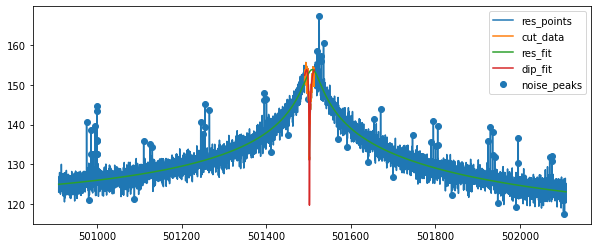

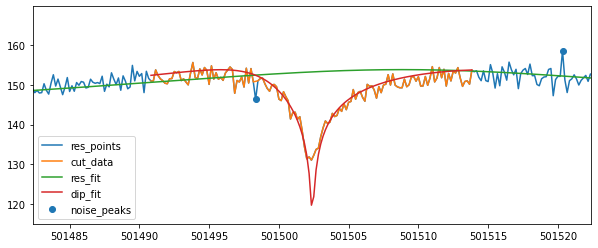

{'A': 2427827083024260.5, 'dA': 1.1193552152446696e-10, 'Q': 14599.504889875081, 'dQ': 36.299168225273974, 'nu_res': 501508.8994130675, 'dnu_res': 0.2781531802675129, 'nu_z': 501502.3977313878, 'dnu_z': 0.02192057668657768, 'dip_width': 5.0080377203770965, 'ddip_width': 0.2049549639337764, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.6219184701658103, 'fit_success': True}
cycle3 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.1666666667 465.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


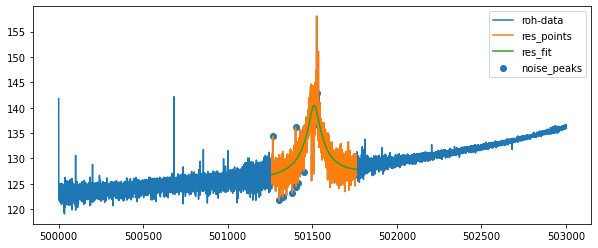

...End fiting resonator
{'A': 108295753864102.92, 'dA': 5.356908882787039e-09, 'off': 4341765900333.3823, 'doff': 9.424616785546743e-08, 'Q': 10105.997106912086, 'dQ': 94.82720579253193, 'th': 0.0003233770565241773, 'dth': 4.2700924113899106e-05, 'nu_res': 501510.46723489434, 'dnu_res': 0.5400300107357341, 'fit_err_chi**2_red': 3.0128752726154664}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


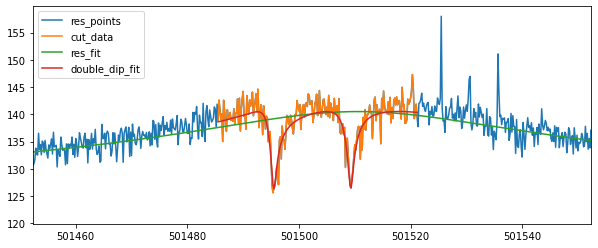

501495.5104292849 0.0642594832154587 501509.2831647949 0.06469380818993534
cycle3 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.1666666667 1232.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



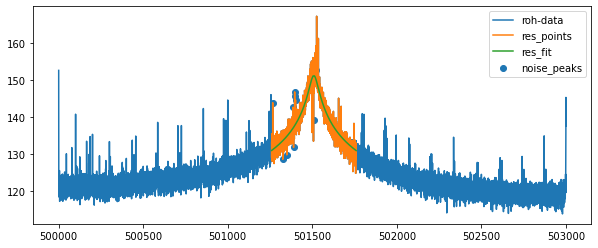

...End fiting resonator
{'A': 1313843633885174.8, 'dA': 2.1228039130329184e-10, 'off': 6985.971533945529, 'doff': 1.3402652781411994e-17, 'Q': 10341.20719943047, 'dQ': 49.73543404047424, 'th': 3.057461817697667e-14, 'dth': 4.928253336222843e-05, 'nu_res': 501508.7377673002, 'dnu_res': 0.4828818394688263, 'fit_err_chi**2_red': 2.909489259945001}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


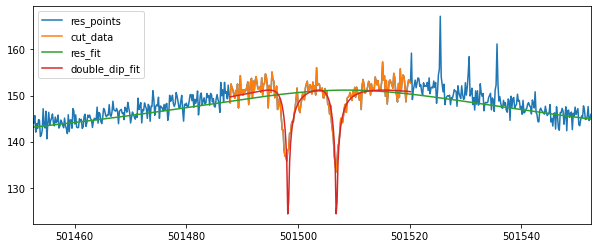

501498.2344339605 0.015934669605843863 501506.90343926515 0.01605905085139117
[501502.41960291314, 501502.3977313878]
503840.97 501502.4086671505 501495.5104292849 501509.2831647949 0.03146283420648792 0.0642594832154587 0.06469380818993534
53273922.2 501502.4086671505 501498.2344339605 501506.90343926515 0.03146283420648792 0.015934669605843863 0.01605905085139117
['cycle3', 'position_1', 3, 0.002, '20211217_192214.386708', 53775424.92920609, 0.03875199021985733, 2338.5850730706006, 0.0964597322074808, 501502.4086671505, 0.03146283420648792, 5.0080377203770965, 0.2049549639337764, True, 501508.8994130675, 0.2781531802675129]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [876062413360115.8, 5731.575238095238, 124.5334243774414, -0.0016549

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7997708976386398
...End fiting resonator
{'A': 2166802805576723.5, 'dA': 1.0613614283239653e-10, 'Q': 13651.475534895042, 'dQ': 32.823475832195676, 'nu_res': 501509.0386262743, 'dnu_res': 0.28352825055719855, 'fit_err_chi**2_red': 0.7997708976386398}
resonator fit results:  [ 2.166802805577e+15  1.365147553490e+04  4.791198886836e+11
 -2.531965325763e-04  5.015090386263e+05] [1.061361428324e-10 3.282347583220e+01 3.816011400163e-08
 8.619960723713e-06 2.835282505572e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.0891612038695144
Fit is NOT GOOD !!!!!


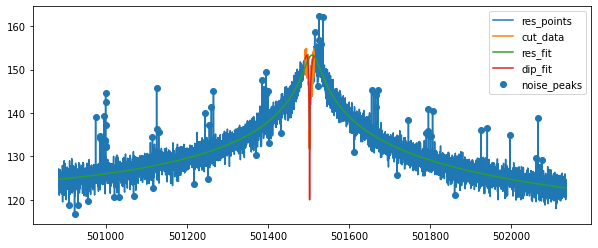

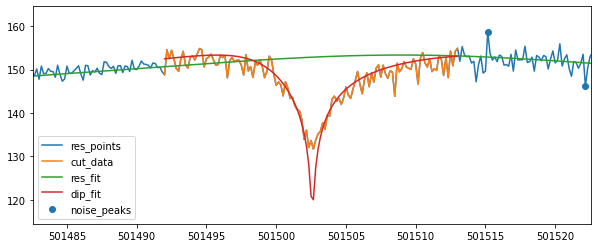

{'A': 2166802805576723.5, 'dA': 1.0613614283239653e-10, 'Q': 13651.475534895042, 'dQ': 32.823475832195676, 'nu_res': 501509.0386262743, 'dnu_res': 0.28352825055719855, 'nu_z': 501502.58986612683, 'dnu_z': 0.024642462190297903, 'dip_width': 4.928369749240637, 'ddip_width': 0.2303703540673652, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.0891612038695144, 'fit_success': True}
cycle3 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [898202143029964.5, 5820.282398451301, 124.70987701416016, -0.001749779062448682, 501514.3333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8060030040769826
...End fiting resonator
{'A': 2192314344214219.8, 'dA': 1.1085405678876934e-10, 'Q': 13855.95220531853, 'dQ': 34.15631078882471, 'nu_res': 501508.8398575299, 'dnu_res': 0.283357260189263, 'fit_err_chi**2_red': 0.8060030040769826}
resonator fit results:  [ 2.192314344214e+15  1.385595220532e+04  5.391730666718e+11
 -2.616094867981e-04  5.015088398575e+05] [1.108540567888e-10 3.415631078882e+01 3.894351088467e-08
 8.959308042622e-06 2.833572601893e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.411334042058772


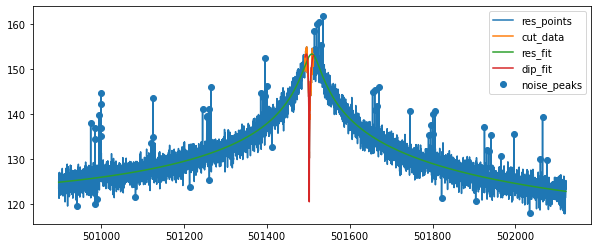

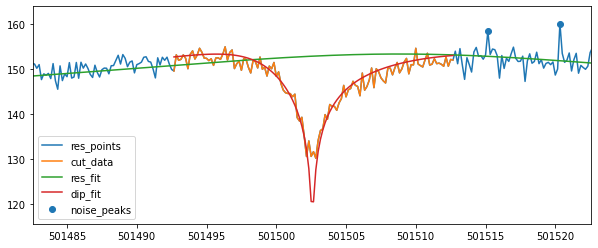

{'A': 2192314344214219.8, 'dA': 1.1085405678876934e-10, 'Q': 13855.95220531853, 'dQ': 34.15631078882471, 'nu_res': 501508.8398575299, 'dnu_res': 0.283357260189263, 'nu_z': 501502.5834319246, 'dnu_z': 0.021042590791443463, 'dip_width': 4.984580212552057, 'ddip_width': 0.19187106115528763, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.411334042058772, 'fit_success': True}
cycle3 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501506.8333333333 440.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



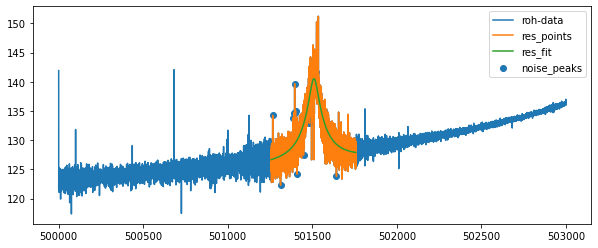

...End fiting resonator
{'A': 109482500661960.42, 'dA': 5.3299309778449425e-09, 'off': 4307525062790.313, 'doff': 9.517509170583833e-08, 'Q': 10197.466123055505, 'dQ': 94.68209481977449, 'th': 0.0003787740675702357, 'dth': 4.2353017592712707e-05, 'nu_res': 501509.50481325475, 'dnu_res': 0.5317040743068904, 'fit_err_chi**2_red': 2.9561841829784252}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


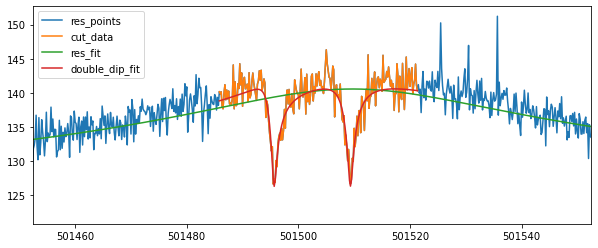

501495.66941657447 0.056942831936783206 501509.3302179898 0.05886404737307619
cycle3 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501508.6666666667 1229.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


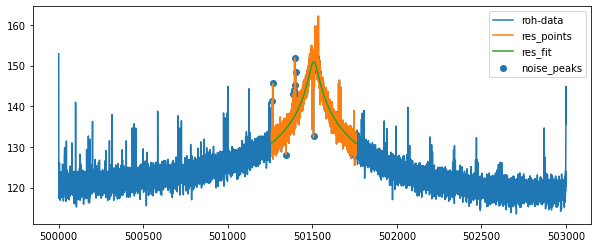

...End fiting resonator
{'A': 1258788769358490.0, 'dA': 2.2182868322792698e-10, 'off': 1167.7561148739187, 'doff': 4.438811968599993e-19, 'Q': 10112.90805974183, 'dQ': 50.81989741661219, 'th': 1.7718288101564395e-16, 'dth': 5.1569485759888416e-05, 'nu_res': 501508.61798051465, 'dnu_res': 0.5117601772367286, 'fit_err_chi**2_red': 2.962662828993775}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


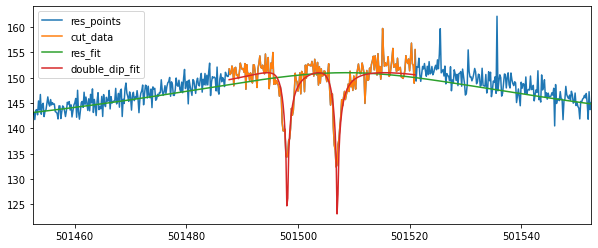

501498.0750119474 0.015727643203074616 501507.0639702068 0.015105461182684157
[501502.58986612683, 501502.5834319246]
503840.97 501502.5866490257 501495.66941657447 501509.3302179898 0.032404344924969596 0.056942831936783206 0.05886404737307619
53273922.2 501502.5866490257 501498.0750119474 501507.0639702068 0.032404344924969596 0.015727643203074616 0.015105461182684157
['cycle3', 'position_1', 3, 0.005, '20211217_201032.724817', 53775424.752333134, 0.039058613496656534, 2338.557014461374, 0.08807669244548695, 501502.5866490257, 0.032404344924969596, 4.984580212552057, 0.19187106115528763, True, 501508.8398575299, 0.283357260189263]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [963936721081299.9, 5900.16862745098, 125.15029403840363, -0.

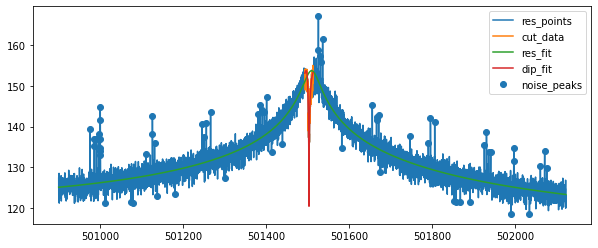

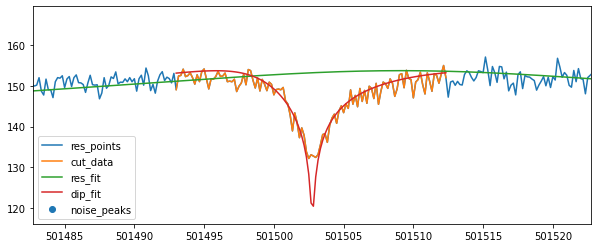

{'A': 2392403216449872.0, 'dA': 1.0515306282437797e-10, 'Q': 14026.590144640753, 'dQ': 34.94059380064963, 'nu_res': 501509.1567584511, 'dnu_res': 0.2851162799526681, 'nu_z': 501502.7566876366, 'dnu_z': 0.025670145008670608, 'dip_width': 5.122950181949823, 'ddip_width': 0.23594745645836515, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.063316459034026, 'fit_success': True}
cycle3 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [897181482518349.8, 5775.568138197068, 124.36476135253906, -0.0016587706903415913, 501511.8333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8215678455418912
...End fiting resonator
{'A': 2329206529637104.0, 'dA': 1.0910800654034397e-10, 'Q': 14228.828370976038, 'dQ': 34.83669849632033, 'nu_res': 501508.6237562134, 'dnu_res': 0.28215599879674824, 'fit_err_chi**2_red': 0.8215678455418912}
resonator fit results:  [ 2.329206529637e+15  1.422882837098e+04  5.121958801615e+11
 -2.460939934909e-04  5.015086237562e+05] [1.091080065403e-10 3.483669849632e+01 4.229086699751e-08
 8.703889914973e-06 2.821559987967e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.124502043629423
Fit is NOT GOOD !!!!!


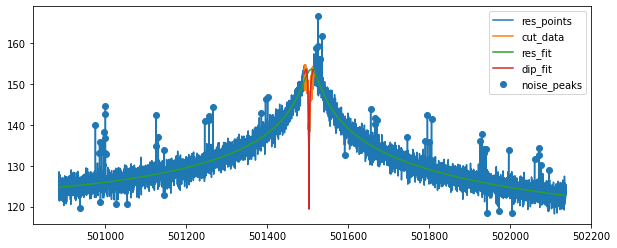

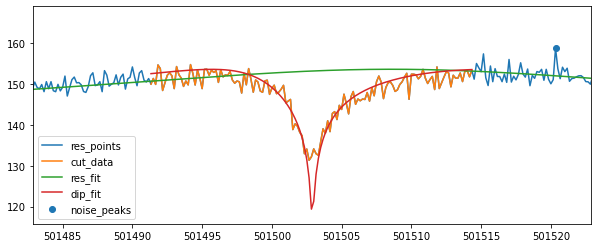

{'A': 2329206529637104.0, 'dA': 1.0910800654034397e-10, 'Q': 14228.828370976038, 'dQ': 34.83669849632033, 'nu_res': 501508.6237562134, 'dnu_res': 0.28215599879674824, 'nu_z': 501502.89880641043, 'dnu_z': 0.026014643555396524, 'dip_width': 5.3037541175682525, 'ddip_width': 0.24160262775318916, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 2.124502043629423, 'fit_success': True}
cycle3 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 448.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



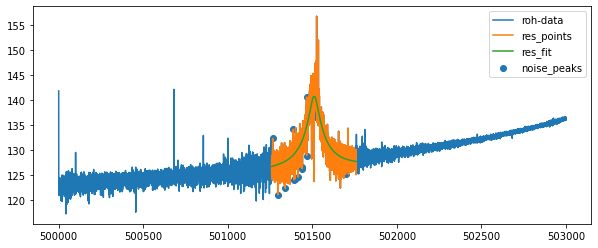

...End fiting resonator
{'A': 115213824254643.22, 'dA': 5.451259505298993e-09, 'off': 4236990159691.0195, 'doff': 1.0269052766245845e-07, 'Q': 10526.353213515767, 'dQ': 99.28432372037851, 'th': 0.00031054382784028296, 'dth': 4.3430534218266604e-05, 'nu_res': 501510.61050989, 'dnu_res': 0.5310856281668964, 'fit_err_chi**2_red': 3.0983652282495946}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


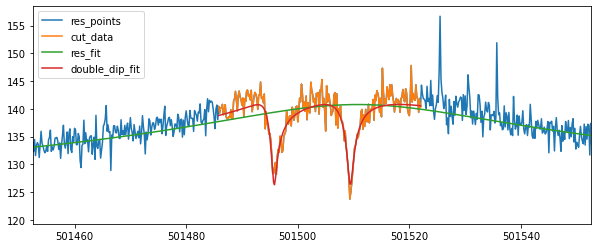

501495.7869739165 0.056843069366909284 501509.4290002207 0.05965664452207719
cycle3 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.5 1232.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


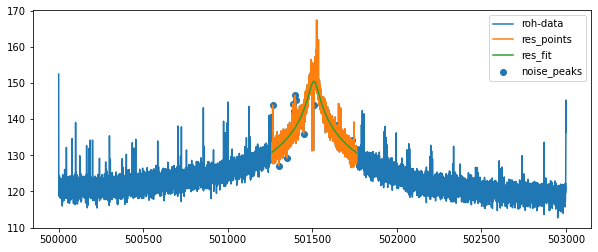

...End fiting resonator
{'A': 1139818703577088.8, 'dA': 2.3126574528454247e-10, 'off': 122084.66677861936, 'doff': 8.654288433962678e-09, 'Q': 9686.24022413976, 'dQ': 49.89161290047746, 'th': 3.1699202208412555e-23, 'dth': 5.300056500830366e-05, 'nu_res': 501509.1399057901, 'dnu_res': 0.5390924092793488, 'fit_err_chi**2_red': 3.2728330445038054}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


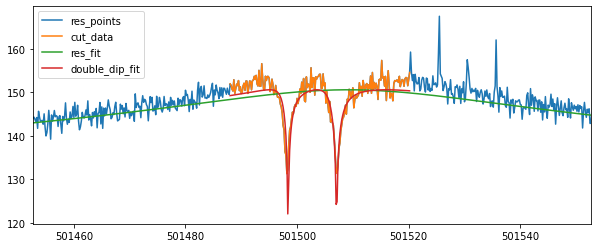

501498.38274907117 0.01363026122147469 501507.0794212124 0.016026773554699867
[501502.7566876366, 501502.89880641043]
503840.97 501502.82774702355 501495.7869739165 501509.4290002207 0.03654747630248237 0.056843069366909284 0.05965664452207719
53273922.2 501502.82774702355 501498.38274907117 501507.0794212124 0.03654747630248237 0.01363026122147469 0.016026773554699867
['cycle3', 'position_1', 3, 0.008, '20211217_194021.284981', 53775424.83442327, 0.042170600133502656, 2338.581772886275, 0.09014304074505837, 501502.82774702355, 0.03654747630248237, 5.3037541175682525, 0.24160262775318916, True, 501508.6237562134, 0.28215599879674824]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [909960127690565.4, 5900.14705882353, 124.56828581735161, -0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8227730211127342
...End fiting resonator
{'A': 2262366068923981.5, 'dA': 1.1017524374725541e-10, 'Q': 14083.043382793661, 'dQ': 34.50701758210777, 'nu_res': 501508.5937753611, 'dnu_res': 0.2825300259778522, 'fit_err_chi**2_red': 0.8227730211127342}
resonator fit results:  [ 2.262366068924e+15  1.408304338279e+04  5.328848658208e+11
 -2.440742725179e-04  5.015085937754e+05] [1.101752437473e-10 3.450701758211e+01 4.201819638812e-08
 8.616669890695e-06 2.825300259779e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8938160848580878


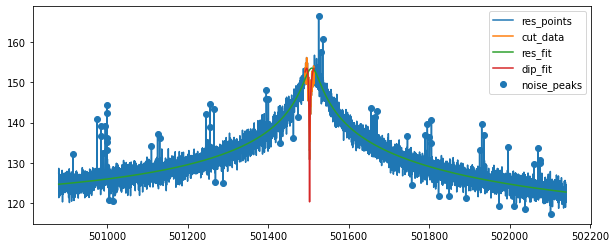

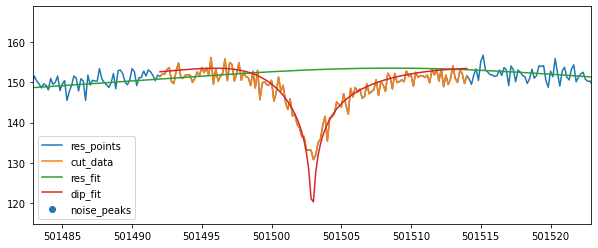

{'A': 2262366068923981.5, 'dA': 1.1017524374725541e-10, 'Q': 14083.043382793661, 'dQ': 34.50701758210777, 'nu_res': 501508.5937753611, 'dnu_res': 0.2825300259778522, 'nu_z': 501502.9231704769, 'dnu_z': 0.024009644541886862, 'dip_width': 4.968479989278487, 'ddip_width': 0.22029630950556991, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 1.8938160848580878, 'fit_success': True}
cycle3 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [861703480428468.9, 5688.2381852539465, 124.83108520507812, -0.001674017437267553, 501513.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8188476533287816
...End fiting resonator
{'A': 2160211408854242.2, 'dA': 1.1479671597914579e-10, 'Q': 13793.941146057534, 'dQ': 34.99681038234965, 'nu_res': 501508.6142230635, 'dnu_res': 0.2909729805576917, 'fit_err_chi**2_red': 0.8188476533287816}
resonator fit results:  [ 2.160211408854e+15  1.379394114606e+04  5.700582085666e+11
 -2.484323524903e-04  5.015086142231e+05] [1.147967159791e-10 3.499681038235e+01 3.930687730963e-08
 9.235946952828e-06 2.909729805577e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7901100098660716


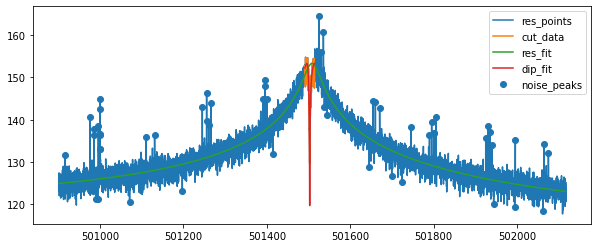

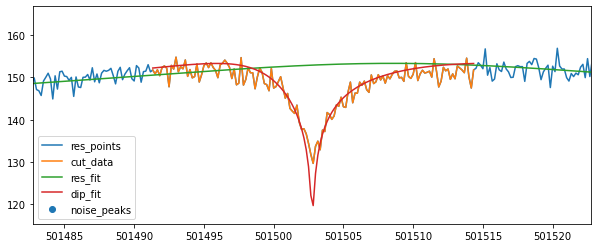

{'A': 2160211408854242.2, 'dA': 1.1479671597914579e-10, 'Q': 13793.941146057534, 'dQ': 34.99681038234965, 'nu_res': 501508.6142230635, 'dnu_res': 0.2909729805576917, 'nu_z': 501502.7711166136, 'dnu_z': 0.024548056457822372, 'dip_width': 4.790143518075013, 'ddip_width': 0.2138471930227727, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.7901100098660716, 'fit_success': True}
cycle3 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501511.1666666667 468.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


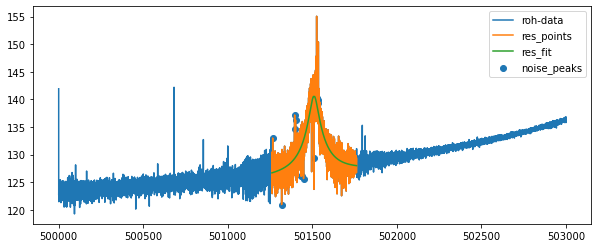

...End fiting resonator
{'A': 110619023360041.27, 'dA': 5.658850517966468e-09, 'off': 4392107689459.306, 'doff': 1.02061343253768e-07, 'Q': 10393.135993992923, 'dQ': 99.65045094422891, 'th': 0.00042179166020751987, 'dth': 4.3118902416892226e-05, 'nu_res': 501509.8809090585, 'dnu_res': 0.5368587351561921, 'fit_err_chi**2_red': 3.0887863143122343}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


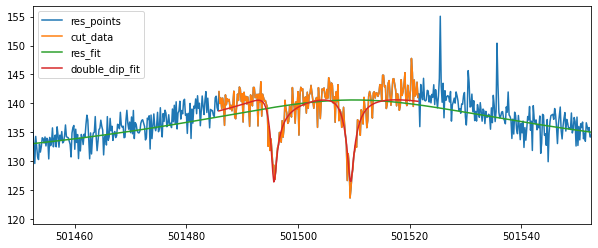

501495.7084822289 0.06059578426021887 501509.4304529503 0.06552884461842884
cycle3 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.5 1244.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


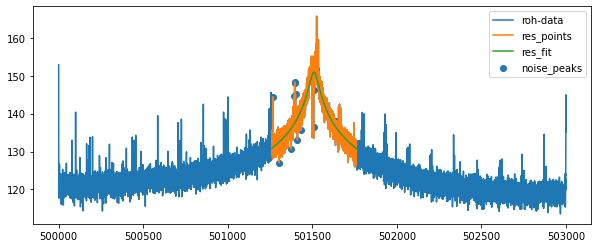

...End fiting resonator
{'A': 1240867775026871.0, 'dA': 2.1953905044727941e-10, 'off': 104.27133551668521, 'doff': 1.3922779052783633e-17, 'Q': 10094.123019173927, 'dQ': 49.66324573366257, 'th': 3.417588773019238e-33, 'dth': 5.049442260371239e-05, 'nu_res': 501509.6318294012, 'dnu_res': 0.5016228058273748, 'fit_err_chi**2_red': 2.8801238680270407}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


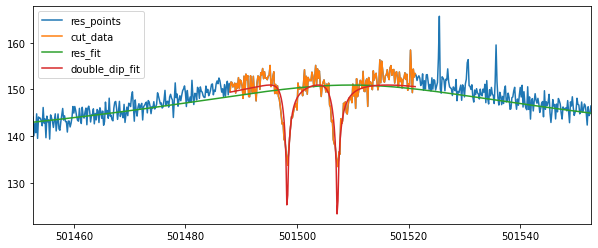

501498.2386707839 0.015577383220299725 501507.23575796623 0.015356418099640279
[501502.9231704769, 501502.7711166136]
503840.97 501502.8471435453 501495.7084822289 501509.4304529503 0.03433759028942177 0.06059578426021887 0.06552884461842884
53273922.2 501502.8471435453 501498.2386707839 501507.23575796623 0.03433759028942177 0.015577383220299725 0.015356418099640279
['cycle3', 'position_1', 3, 0.015, '20211217_192816.684100', 53775424.82728521, 0.040712953119704146, 2338.6782083660364, 0.09562922489501507, 501502.8471435453, 0.03433759028942177, 4.790143518075013, 0.2138471930227727, True, 501508.6142230635, 0.2909729805576917]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [858712854054033.4, 5666.806026365348, 124.77027130126953, -0.0017

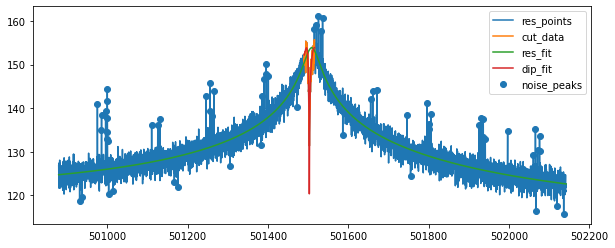

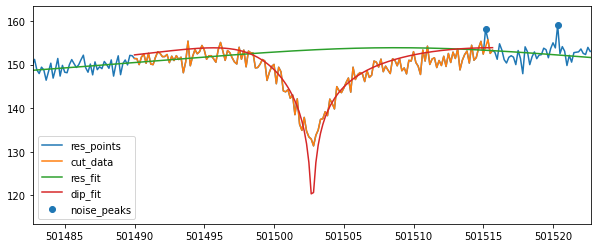

{'A': 2434136063594533.0, 'dA': 1.0838530269737923e-10, 'Q': 14685.907764534682, 'dQ': 35.05871164534449, 'nu_res': 501508.75474703556, 'dnu_res': 0.26880006997857514, 'nu_z': 501502.746667492, 'dnu_z': 0.025343720164748028, 'dip_width': 5.4518311470464855, 'ddip_width': 0.23318999718687203, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.984785982443805, 'fit_success': True}
cycle3 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [868166326779213.5, 5720.6863117858065, 124.99723745860761, -0.0016811183142349585, 501513.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8050099828621862
...End fiting resonator
{'A': 2391805376735714.5, 'dA': 1.1178846657211505e-10, 'Q': 14527.060037968531, 'dQ': 35.880202739624195, 'nu_res': 501508.5544852301, 'dnu_res': 0.2755481192448998, 'fit_err_chi**2_red': 0.8050099828621862}
resonator fit results:  [ 2.391805376736e+15  1.452706003797e+04  6.208925561360e+11
 -2.450628066727e-04  5.015085544852e+05] [1.117884665721e-10 3.588020273962e+01 4.295215916810e-08
 8.758891175848e-06 2.755481192449e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.016205574063078
Fit is NOT GOOD !!!!!


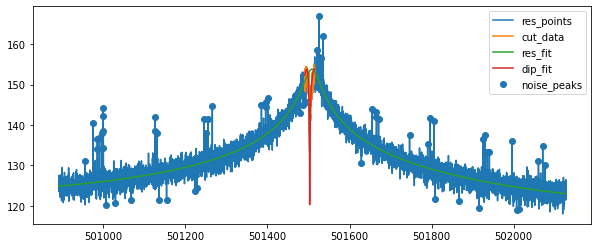

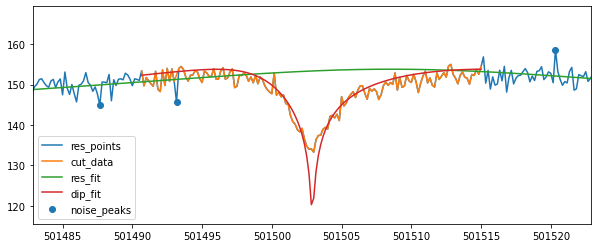

{'A': 2391805376735714.5, 'dA': 1.1178846657211505e-10, 'Q': 14527.060037968531, 'dQ': 35.880202739624195, 'nu_res': 501508.5544852301, 'dnu_res': 0.2755481192448998, 'nu_z': 501502.9018034218, 'dnu_z': 0.025500128012822778, 'dip_width': 4.964083666597021, 'ddip_width': 0.22681629545103293, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 2.016205574063078, 'fit_success': True}
cycle3 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 454.6666666669771
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


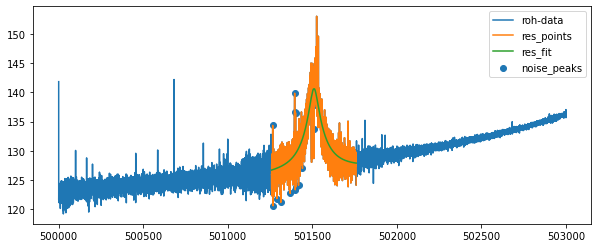

...End fiting resonator
{'A': 112426413691169.94, 'dA': 5.606607786425535e-09, 'off': 4338526867105.164, 'doff': 1.0317216491279363e-07, 'Q': 10494.515987245763, 'dQ': 99.60275339896832, 'th': 0.00037475374594794477, 'dth': 4.295118133528208e-05, 'nu_res': 501509.7548901709, 'dnu_res': 0.5298272754999974, 'fit_err_chi**2_red': 3.072104613652435}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


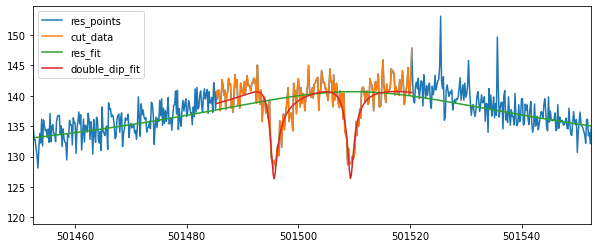

501495.6480429062 0.06246005514024625 501509.36797845806 0.0603210393813698
cycle3 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.5 1218.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


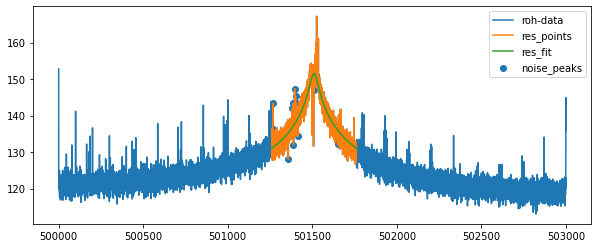

...End fiting resonator
{'A': 1421986352966864.2, 'dA': 2.1322270590903082e-10, 'off': 1570.7709733376396, 'doff': 1.1015588244397664e-16, 'Q': 10573.165466510014, 'dQ': 52.981644617363635, 'th': 3.959269680157982e-30, 'dth': 5.127376202451424e-05, 'nu_res': 501509.733237553, 'dnu_res': 0.49609930536812846, 'fit_err_chi**2_red': 2.9775848592190597}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


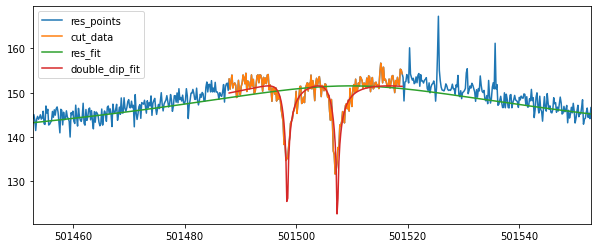

501498.41201806936 0.015957486770617 501507.39906655485 0.015371107154191736
[501502.746667492, 501502.9018034218]
503840.97 501502.8242354569 501495.6480429062 501509.36797845806 0.03595219993907751 0.06246005514024625 0.0603210393813698
53273922.2 501502.8242354569 501498.41201806936 501507.39906655485 0.03595219993907751 0.015957486770617 0.015371107154191736
['cycle3', 'position_1', 3, 0.03, '20211217_193419.053184', 53775425.18684917, 0.04223118515551589, 2338.7782140925992, 0.09398109895415552, 501502.8242354569, 0.03595219993907751, 4.964083666597021, 0.22681629545103293, True, 501508.5544852301, 0.2755481192448998]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle3 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [868878094547118.6, 5709.844402274517, 124.55721282958984, -0.0016837919

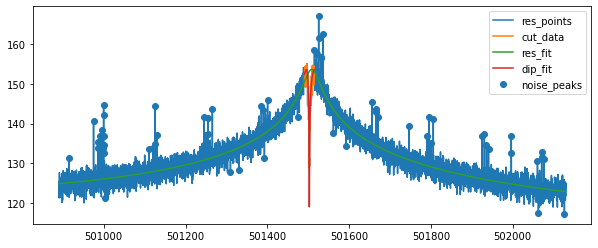

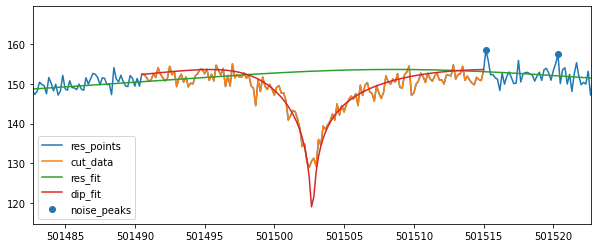

{'A': 2310817373763262.5, 'dA': 1.1031565420030013e-10, 'Q': 14190.845670992303, 'dQ': 35.02485222334904, 'nu_res': 501508.578202901, 'dnu_res': 0.2832130238208763, 'nu_z': 501502.72448399366, 'dnu_z': 0.024147985550799646, 'dip_width': 5.484938873441972, 'ddip_width': 0.21733787030608376, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.6377513482182218, 'fit_success': True}
cycle3 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [874430749869494.5, 5742.499999997449, 124.24547576904297, -0.0017529498650051519, 501511.6666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8081554502184366
...End fiting resonator
{'A': 2241061807686159.5, 'dA': 1.0918274865610744e-10, 'Q': 13989.51582141022, 'dQ': 34.09095096485829, 'nu_res': 501508.49282362015, 'dnu_res': 0.2817526053032822, 'fit_err_chi**2_red': 0.8081554502184366}
resonator fit results:  [ 2.241061807686e+15  1.398951582141e+04  5.338196567630e+11
 -2.502190971219e-04  5.015084928236e+05] [1.091827486561e-10 3.409095096486e+01 4.113564084676e-08
 8.565131052776e-06 2.817526053033e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.239724838967772
Fit is NOT GOOD !!!!!


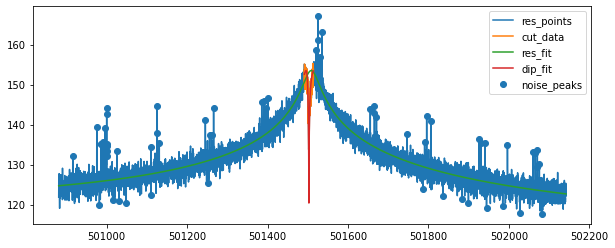

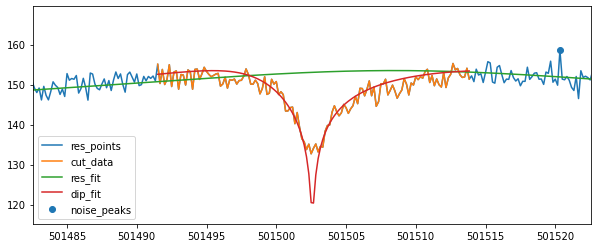

{'A': 2241061807686159.5, 'dA': 1.0918274865610744e-10, 'Q': 13989.51582141022, 'dQ': 34.09095096485829, 'nu_res': 501508.49282362015, 'dnu_res': 0.2817526053032822, 'nu_z': 501502.5838549793, 'dnu_z': 0.0268953358893743, 'dip_width': 5.194401659793008, 'ddip_width': 0.24619935891041644, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.239724838967772, 'fit_success': True}
cycle3 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.8333333333 453.3333333330229
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



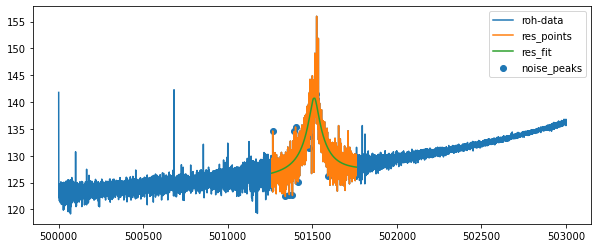

...End fiting resonator
{'A': 116303986180512.42, 'dA': 5.589984853171846e-09, 'off': 4383437376681.242, 'doff': 1.0578709482716931e-07, 'Q': 10745.050136232288, 'dQ': 100.57090936716507, 'th': 0.0003547157663951906, 'dth': 4.221121494838753e-05, 'nu_res': 501510.72811904445, 'dnu_res': 0.5127167495393068, 'fit_err_chi**2_red': 3.0788757481871643}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


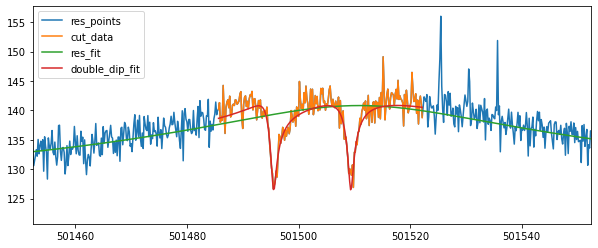

501495.5656532 0.055595334682061306 501509.38278946787 0.054856022346375766
cycle3 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.6666666667 1240.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



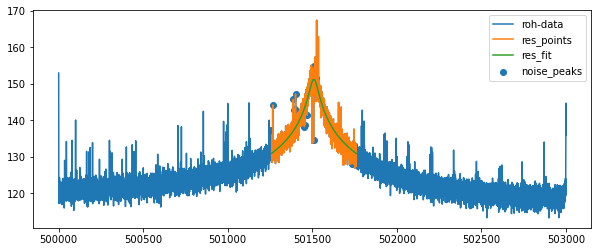

...End fiting resonator
{'A': 1349769448612977.5, 'dA': 2.1432796463450826e-10, 'off': 1377.9098701581825, 'doff': 5.692388512904201e-15, 'Q': 10411.395810378177, 'dQ': 51.27011400334936, 'th': 7.269750467316339e-15, 'dth': 5.0438184325289455e-05, 'nu_res': 501508.9629061293, 'dnu_res': 0.49230718508338217, 'fit_err_chi**2_red': 3.0378661639306337}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


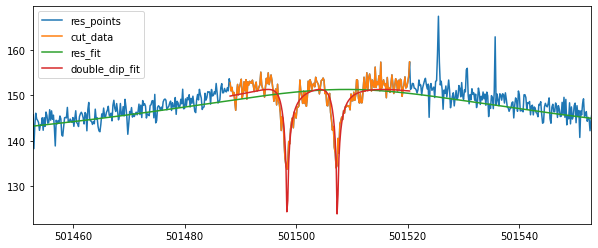

501498.4038084943 0.01575755654063673 501507.39546905906 0.01517596563691133
[501502.72448399366, 501502.5838549793]
503840.97 501502.6541694865 501495.5656532 501509.38278946787 0.03614532194854396 0.055595334682061306 0.054856022346375766
53273922.2 501502.6541694865 501498.4038084943 501507.39546905906 0.03614532194854396 0.01575755654063673 0.01517596563691133
['cycle3', 'position_1', 3, 0.05, '20211217_195225.845216', 53775425.34510808, 0.04225038248238672, 2338.675726818561, 0.08606107555010209, 501502.6541694865, 0.03614532194854396, 5.194401659793008, 0.24619935891041644, True, 501508.49282362015, 0.2817526053032822]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [872776234584710.2, 5775.602687137534, 124.8297119140625, -0.0016923

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8048118370285915
...End fiting resonator
{'A': 2218896749668239.0, 'dA': 1.1095030200572649e-10, 'Q': 13983.663218672817, 'dQ': 34.31256677378815, 'nu_res': 501508.75230925623, 'dnu_res': 0.2837824406765484, 'fit_err_chi**2_red': 0.8048118370285915}
resonator fit results:  [ 2.218896749668e+15  1.398366321867e+04  4.761965264783e+11
 -2.495515189001e-04  5.015087523093e+05] [1.109503020057e-10 3.431256677379e+01 4.057003727564e-08
 8.949330315231e-06 2.837824406765e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.1538303216663928
Fit is NOT GOOD !!!!!


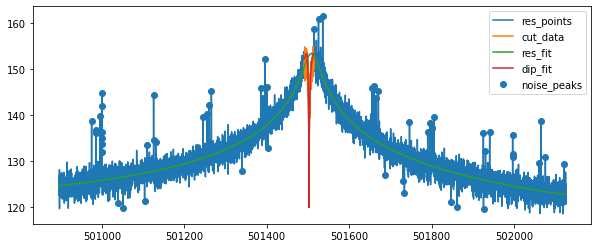

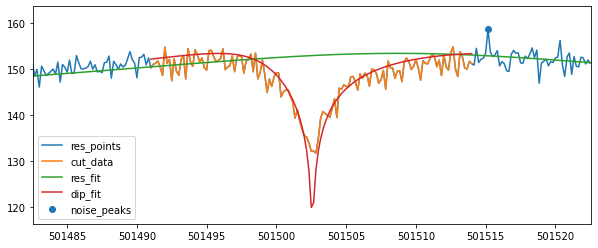

{'A': 2218896749668239.0, 'dA': 1.1095030200572649e-10, 'Q': 13983.663218672817, 'dQ': 34.31256677378815, 'nu_res': 501508.75230925623, 'dnu_res': 0.2837824406765484, 'nu_z': 501502.57405135914, 'dnu_z': 0.02478422006445178, 'dip_width': 4.850322581644002, 'ddip_width': 0.23365242827291427, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.1538303216663928, 'fit_success': True}
cycle4 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [857309496669781.1, 5709.851992411128, 124.8220443725586, -0.0015406399610753774, 501515.3333333333]
Start fiting resonator....
chi_reduziert =  0.7974028040919106
...End fiting resonator
{'A': 2116221272627540.2, 'dA': 1.0990130024193966e-10, 'Q': 13640.46474667218, 'dQ': 33.202391657857305, 'nu_res': 501508.94597203325, 'dnu_res': 0.2841431905293515, 'fit_err_chi**2_red': 0.7974028040919106}
resonator fit results:  [ 2.116221272628e+15  1.364046474667e+04  5.177025534817e+11
 -2.462773664871e-04  5.015089459720e+05] [1.0

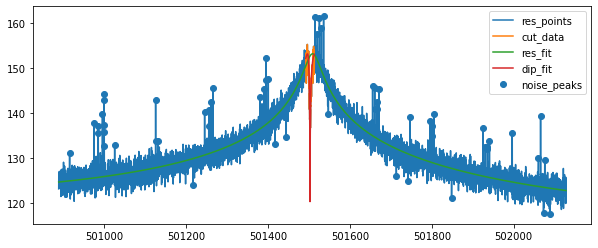

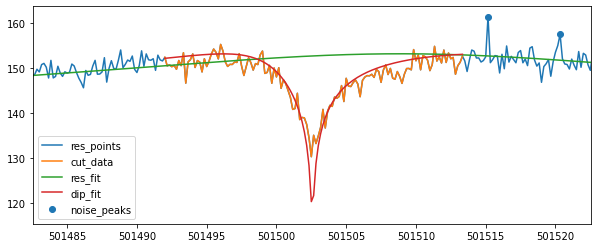

{'A': 2116221272627540.2, 'dA': 1.0990130024193966e-10, 'Q': 13640.46474667218, 'dQ': 33.202391657857305, 'nu_res': 501508.94597203325, 'dnu_res': 0.2841431905293515, 'nu_z': 501502.57199911575, 'dnu_z': 0.023870167893968015, 'dip_width': 4.408987408050716, 'ddip_width': 0.21776369241677204, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.0871799870594585, 'fit_success': True}
cycle4 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501508.8333333333 454.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



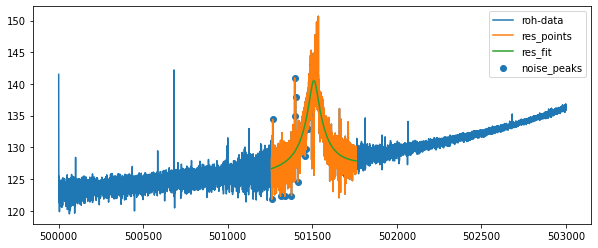

...End fiting resonator
{'A': 109282973358138.55, 'dA': 5.499502840467397e-09, 'off': 4275663864810.189, 'doff': 9.906879300391962e-08, 'Q': 10283.239749524852, 'dQ': 96.76726418755395, 'th': 0.00038367703093979247, 'dth': 4.2824571956478126e-05, 'nu_res': 501509.23036319966, 'dnu_res': 0.5348309369009339, 'fit_err_chi**2_red': 2.9356475354140827}
Start fiting double dip....
Fit is NOT GOOD !!!!!


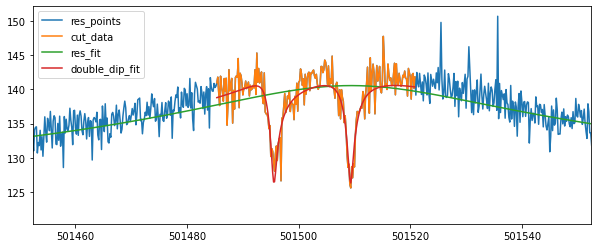

501495.5792207069 0.06388989056502278 501509.3103473669 0.06342888876129503
cycle4 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.3333333333 1232.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



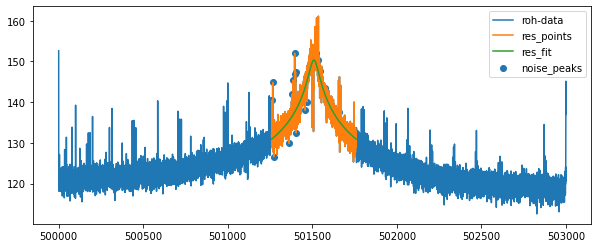

...End fiting resonator
{'A': 1086608448036882.9, 'dA': 2.2329159981670058e-10, 'off': 51486.59301819421, 'doff': 1.8042356039227086e-09, 'Q': 9356.755600649958, 'dQ': 47.38595152538258, 'th': 2.571545513684047e-28, 'dth': 5.224769215463976e-05, 'nu_res': 501509.2555532728, 'dnu_res': 0.5421382677598906, 'fit_err_chi**2_red': 3.0907057774915576}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


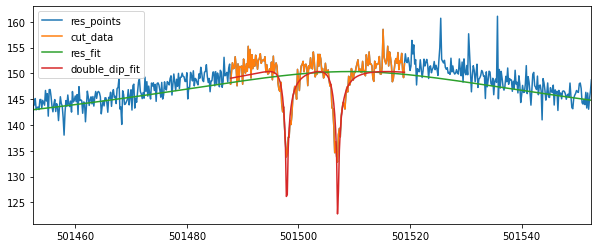

501497.91359286424 0.016249280202614885 501507.0617966643 0.015302364814364802
[501502.57405135914, 501502.57199911575]
503840.97 501502.5730252374 501495.5792207069 501509.3103473669 0.0344099183301762 0.06388989056502278 0.06342888876129503
53273922.2 501502.5730252374 501497.91359286424 501507.0617966643 0.0344099183301762 0.016249280202614885 0.015302364814364802
['cycle4', 'position_1', 3, -0.005, '20211217_204044.433141', 53775424.6023643, 0.04101516738359601, 2338.6534571636003, 0.09638041567347964, 501502.5730252374, 0.0344099183301762, 4.408987408050716, 0.21776369241677204, True, 501508.94597203325, 0.2841431905293515]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [863527420034009.1, 5720.663498097593, 124.84543800152926, -0.001

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8128837465101448
...End fiting resonator
{'A': 2121243344288245.0, 'dA': 1.1144251373317928e-10, 'Q': 13640.452673667949, 'dQ': 33.75746005814617, 'nu_res': 501508.51974887395, 'dnu_res': 0.29047065730771277, 'fit_err_chi**2_red': 0.8128837465101448}
resonator fit results:  [ 2.121243344288e+15  1.364045267367e+04  4.894964376178e+11
 -2.442899487763e-04  5.015085197489e+05] [1.114425137332e-10 3.375746005815e+01 3.921510319037e-08
 8.938478597863e-06 2.904706573077e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.367051587437743


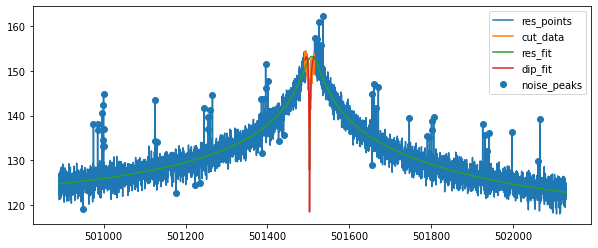

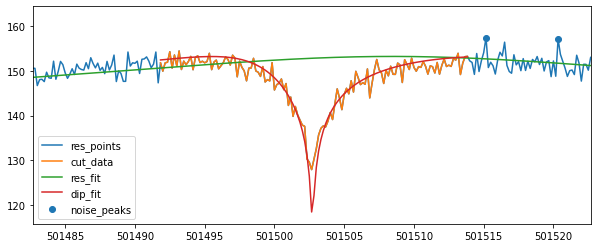

{'A': 2121243344288245.0, 'dA': 1.1144251373317928e-10, 'Q': 13640.452673667949, 'dQ': 33.75746005814617, 'nu_res': 501508.51974887395, 'dnu_res': 0.29047065730771277, 'nu_z': 501502.715905114, 'dnu_z': 0.021586425437208265, 'dip_width': 5.108889706817868, 'ddip_width': 0.1926811031722933, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.367051587437743, 'fit_success': True}
cycle4 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [902698474931219.8, 5764.5114942528735, 124.9037094116211, -0.0016007123366143653, 501512.5]
Start fiting resonator....
chi_reduziert =  0.8012507135823107
...End fiting resonator
{'A': 2508916924815365.0, 'dA': 1.1042107917277284e-10, 'Q': 14858.526970967769, 'dQ': 36.39359296801662, 'nu_res': 501508.6801257453, 'dnu_res': 0.2744549422647783, 'fit_err_chi**2_red': 0.8012507135823107}
resonator fit results:  [ 2.508916924815e+15  1.485852697097e+04  4.752045001883e+11
 -2.580065496568e-04  5.015086801257e+05] [1.1042

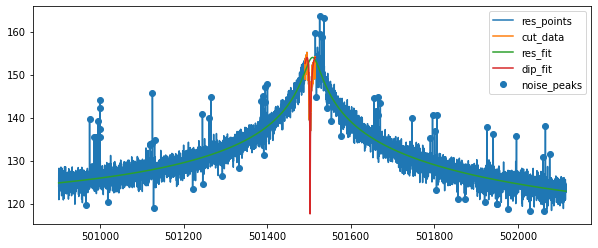

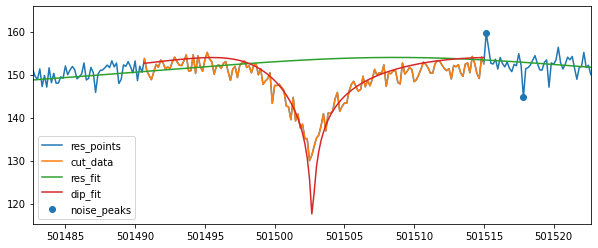

{'A': 2508916924815365.0, 'dA': 1.1042107917277284e-10, 'Q': 14858.526970967769, 'dQ': 36.39359296801662, 'nu_res': 501508.6801257453, 'dnu_res': 0.2744549422647783, 'nu_z': 501502.70189733716, 'dnu_z': 0.02772108434304867, 'dip_width': 5.618834261218149, 'ddip_width': 0.24824309731240804, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 2.0974737583818874, 'fit_success': True}
cycle4 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.1666666667 458.6666666669771
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



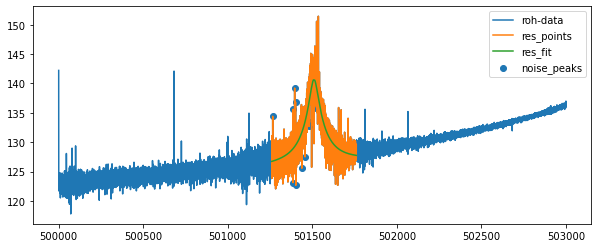

...End fiting resonator
{'A': 113299625569657.64, 'dA': 5.76586059397701e-09, 'off': 4307560776848.8066, 'doff': 1.0824551511918367e-07, 'Q': 10686.230236429561, 'dQ': 101.53283801859844, 'th': 0.0003286036701059989, 'dth': 4.283029668127917e-05, 'nu_res': 501509.81120118155, 'dnu_res': 0.522365260843124, 'fit_err_chi**2_red': 3.167960675114583}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


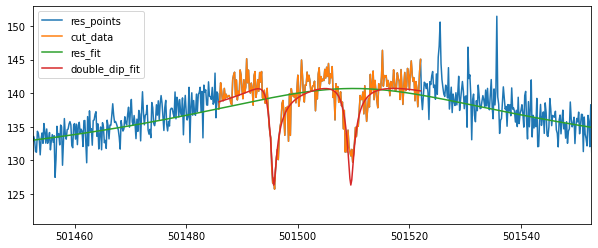

501495.6926933181 0.05654033893881651 501509.51121793664 0.05819595069937393
cycle4 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.5 1226.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


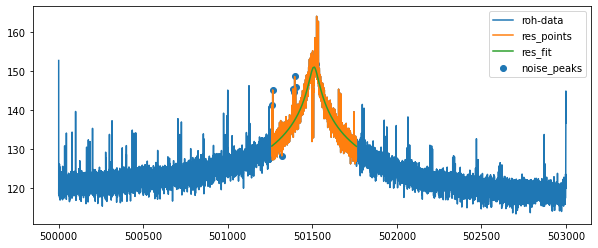

...End fiting resonator
{'A': 1293997879586391.0, 'dA': 2.2440392127086433e-10, 'off': 1497518.3622381687, 'doff': 8.600480837669858e-09, 'Q': 10324.22658673826, 'dQ': 51.85933668826289, 'th': 1.8686301490691675e-11, 'dth': 5.147564961897365e-05, 'nu_res': 501509.50480593584, 'dnu_res': 0.5048419484461556, 'fit_err_chi**2_red': 3.0042306708990254}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


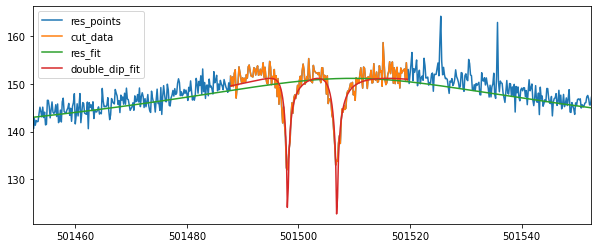

501498.0627099383 0.013632534730272568 501506.8989231593 0.01377413257431354
[501502.715905114, 501502.70189733716]
503840.97 501502.7089012256 501495.6926933181 501509.51121793664 0.03513448847372863 0.05654033893881651 0.05819595069937393
53273922.2 501502.7089012256 501498.0627099383 501506.8989231593 0.03513448847372863 0.013632534730272568 0.01377413257431354
['cycle4', 'position_1', 3, -0.02, '20211217_202839.844464', 53775424.45273187, 0.04012486774629199, 2338.4749899707967, 0.08841951642839256, 501502.7089012256, 0.03513448847372863, 5.618834261218149, 0.24824309731240804, True, 501508.6801257453, 0.2744549422647783]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [891402926598022.8, 5731.6, 125.12995009354245, -0.00178133608886723

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8213259636773377
...End fiting resonator
{'A': 2443264978662532.5, 'dA': 1.1515462178200793e-10, 'Q': 14783.821940284173, 'dQ': 37.11944934128495, 'nu_res': 501509.0933772894, 'dnu_res': 0.27788616405154043, 'fit_err_chi**2_red': 0.8213259636773377}
resonator fit results:  [ 2.443264978663e+15  1.478382194028e+04  5.893681214475e+11
 -2.483941416724e-04  5.015090933773e+05] [1.151546217820e-10 3.711944934128e+01 4.526528920589e-08
 9.040673738782e-06 2.778861640515e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.0883613177337943
Fit is NOT GOOD !!!!!


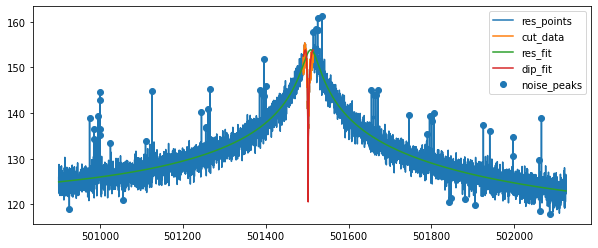

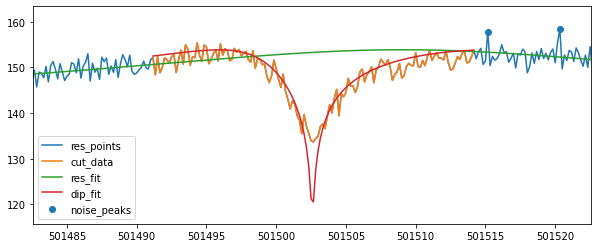

{'A': 2443264978662532.5, 'dA': 1.1515462178200793e-10, 'Q': 14783.821940284173, 'dQ': 37.11944934128495, 'nu_res': 501509.0933772894, 'dnu_res': 0.27788616405154043, 'nu_z': 501502.5889990494, 'dnu_z': 0.026201587781702805, 'dip_width': 5.187456176564332, 'ddip_width': 0.23816097786622115, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.0883613177337943, 'fit_success': True}
cycle4 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [872665447972739.8, 5753.506692159332, 125.05245751566495, -0.0017092408746454512, 501514.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8164066324625681
...End fiting resonator
{'A': 2431579045691464.5, 'dA': 1.1472362836780877e-10, 'Q': 14741.270211876797, 'dQ': 36.906226335838035, 'nu_res': 501508.51573151496, 'dnu_res': 0.2774024530441743, 'fit_err_chi**2_red': 0.8164066324625681}
resonator fit results:  [ 2.431579045691e+15  1.474127021188e+04  5.684201644200e+11
 -2.626127187126e-04  5.015085157315e+05] [1.147236283678e-10 3.690622633584e+01 4.473947136338e-08
 9.087701033762e-06 2.774024530442e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5746121056129616


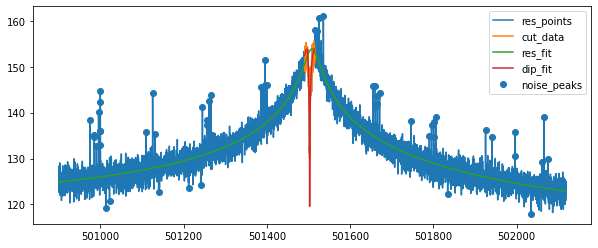

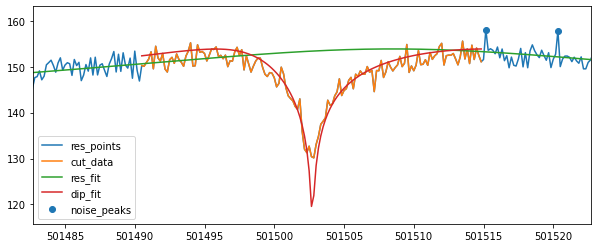

{'A': 2431579045691464.5, 'dA': 1.1472362836780877e-10, 'Q': 14741.270211876797, 'dQ': 36.906226335838035, 'nu_res': 501508.51573151496, 'dnu_res': 0.2774024530441743, 'nu_z': 501502.7278433973, 'dnu_z': 0.022773767832369816, 'dip_width': 5.189215487705554, 'ddip_width': 0.2065681875692146, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.5746121056129616, 'fit_success': True}
cycle4 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501508.5 453.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



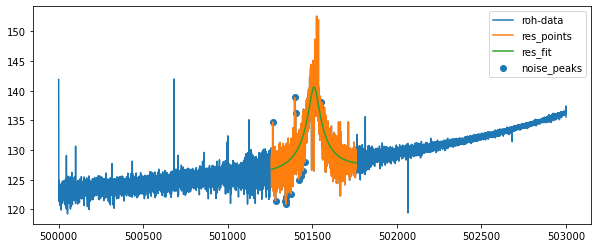

...End fiting resonator
{'A': 112284889536071.55, 'dA': 5.464766700339548e-09, 'off': 4327011356309.658, 'doff': 1.0012871427312396e-07, 'Q': 10424.977565539632, 'dQ': 97.59717110482578, 'th': 0.00035152635376417237, 'dth': 4.2546369241497155e-05, 'nu_res': 501509.76674291736, 'dnu_res': 0.5264995479102784, 'fit_err_chi**2_red': 3.045511458345668}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


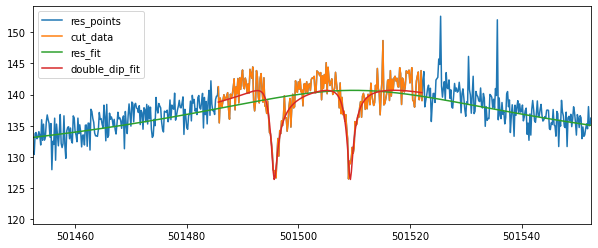

501495.708993544 0.06005888323358351 501509.3098071291 0.05688224500029615
cycle4 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.0 1237.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


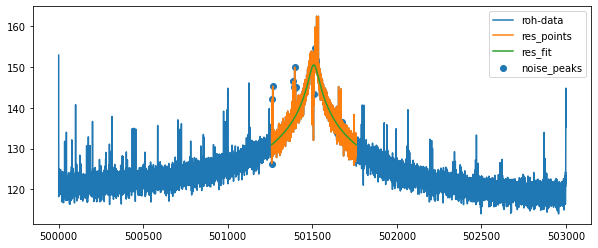

...End fiting resonator
{'A': 1135113101816966.0, 'dA': 2.2105677886139262e-10, 'off': 2189.211990852836, 'doff': 1.06555507190528e-14, 'Q': 9576.209493280205, 'dQ': 47.98823194541965, 'th': 1.686984874947849e-36, 'dth': 5.161519261606024e-05, 'nu_res': 501508.71130442293, 'dnu_res': 0.5284692514393743, 'fit_err_chi**2_red': 3.0805538228943807}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


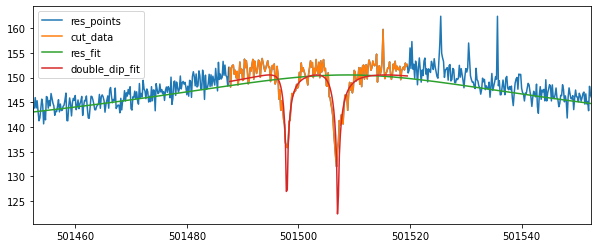

501497.91373070574 0.01669204832423333 501507.064933624 0.015926150871273543
[501502.5889990494, 501502.7278433973]
503840.97 501502.65842122334 501495.708993544 501509.3098071291 0.034715525396642924 0.06005888323358351 0.05688224500029615
53273922.2 501502.65842122334 501497.91373070574 501507.064933624 0.034715525396642924 0.01669204832423333 0.015926150871273543
['cycle4', 'position_1', 3, -0.04, '20211217_203442.116732', 53775424.5202431, 0.041682543857088035, 2338.6096205501817, 0.08970968150151852, 501502.65842122334, 0.034715525396642924, 5.189215487705554, 0.2065681875692146, True, 501508.51573151496, 0.2774024530441743]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [847845144526898.8, 5709.851992407344, 124.46726989746094, -0.00

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8231070640688772
...End fiting resonator
{'A': 2270793293162522.5, 'dA': 1.1490689575769552e-10, 'Q': 14203.059562998546, 'dQ': 35.813862103834495, 'nu_res': 501508.55133604084, 'dnu_res': 0.2880784358489634, 'fit_err_chi**2_red': 0.8231070640688772}
resonator fit results:  [ 2.270793293163e+15  1.420305956300e+04  5.315522207350e+11
 -2.421308348262e-04  5.015085513360e+05] [1.149068957577e-10 3.581386210383e+01 4.318164649054e-08
 9.046145013051e-06 2.880784358490e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.117700861554257
Fit is NOT GOOD !!!!!


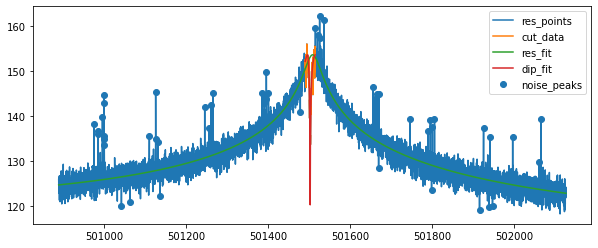

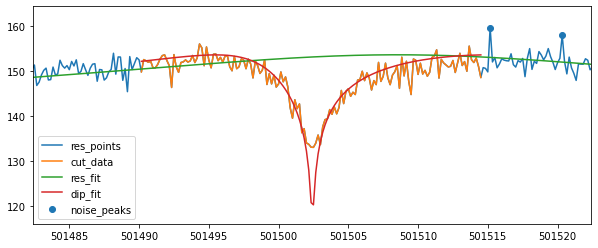

{'A': 2270793293162522.5, 'dA': 1.1490689575769552e-10, 'Q': 14203.059562998546, 'dQ': 35.813862103834495, 'nu_res': 501508.55133604084, 'dnu_res': 0.2880784358489634, 'nu_z': 501502.42054729187, 'dnu_z': 0.026351468849860046, 'dip_width': 5.1380638500197, 'ddip_width': 0.24146043688688854, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.117700861554257, 'fit_success': True}
cycle4 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [908826971661784.8, 5877.099609376336, 125.12637345070087, -0.0018680867353128548, 501512.5]
Start fiting resonator....
chi_reduziert =  0.8222453908791395
...End fiting resonator
{'A': 2243590121471876.0, 'dA': 1.1281999081321833e-10, 'Q': 14078.149704772444, 'dQ': 35.038312868276215, 'nu_res': 501508.7192052025, 'dnu_res': 0.28496371193715875, 'fit_err_chi**2_red': 0.8222453908791395}
resonator fit results:  [ 2.243590121472e+15  1.407814970477e+04  5.529164611300e+11
 -2.563408834508e-04  5.015087192052e+05] [1.1

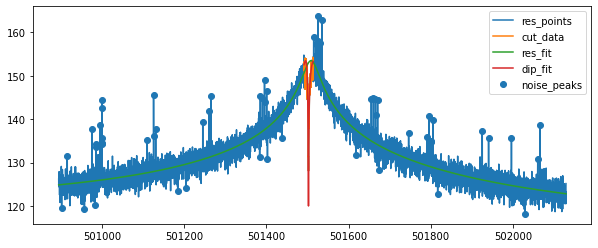

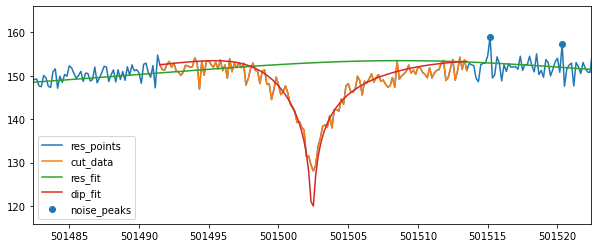

{'A': 2243590121471876.0, 'dA': 1.1281999081321833e-10, 'Q': 14078.149704772444, 'dQ': 35.038312868276215, 'nu_res': 501508.7192052025, 'dnu_res': 0.28496371193715875, 'nu_z': 501502.4253086049, 'dnu_z': 0.021513721787862622, 'dip_width': 5.2634325061921565, 'ddip_width': 0.19399521845783435, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.36548932801412, 'fit_success': True}
cycle4 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501511.0 466.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


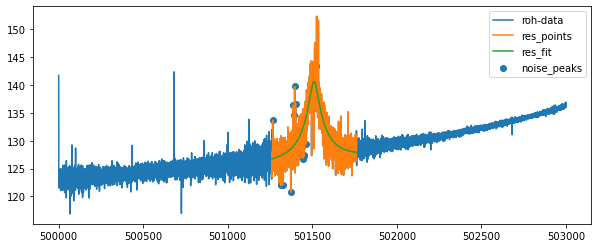

...End fiting resonator
{'A': 112094442444582.34, 'dA': 5.459635518366733e-09, 'off': 4361560097078.561, 'doff': 9.977081303246175e-08, 'Q': 10450.586420416283, 'dQ': 97.04278202088122, 'th': 0.00037421258030263414, 'dth': 4.197684692938674e-05, 'nu_res': 501510.06031067483, 'dnu_res': 0.5195707641694314, 'fit_err_chi**2_red': 2.9675560432644583}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


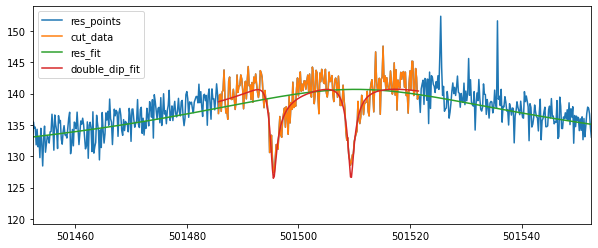

501495.5560415982 0.061270275935638996 501509.42115772044 0.060209493618582605
cycle4 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.1666666667 1246.666666666977
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



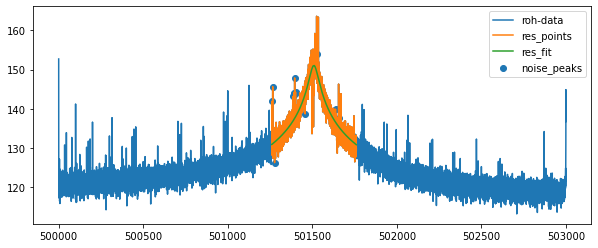

...End fiting resonator
{'A': 1275945241658674.8, 'dA': 2.1662861073254083e-10, 'off': 6370.0494731764775, 'doff': 8.338534205032484e-17, 'Q': 10158.994018527063, 'dQ': 50.09656523716463, 'th': 2.1201088477314875e-14, 'dth': 5.058774329033859e-05, 'nu_res': 501509.12052339886, 'dnu_res': 0.5007149202927739, 'fit_err_chi**2_red': 3.0178068364438415}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


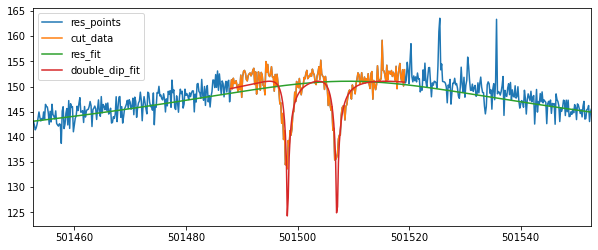

501498.231668602 0.015329574147287434 501507.07646280044 0.015848803536062602
[501502.42054729187, 501502.4253086049]
503840.97 501502.4229279484 501495.5560415982 501509.42115772044 0.03401823240132707 0.061270275935638996 0.060209493618582605
53273922.2 501502.4229279484 501498.231668602 501507.07646280044 0.03401823240132707 0.015329574147287434 0.015848803536062602
['cycle4', 'position_1', 3, 0.002, '20211217_201635.184044', 53775425.085203454, 0.04053912372970823, 2338.4157286297414, 0.09239301905850995, 501502.4229279484, 0.03401823240132707, 5.2634325061921565, 0.19399521845783435, True, 501508.7192052025, 0.28496371193715875]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [880462633518622.5, 5831.562015503876, 124.6532974243164, -0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.790108559700211
...End fiting resonator
{'A': 2231629892880263.5, 'dA': 1.1130107290060691e-10, 'Q': 14074.470087892918, 'dQ': 34.399245806969105, 'nu_res': 501508.8334534389, 'dnu_res': 0.28073452396370396, 'fit_err_chi**2_red': 0.790108559700211}
resonator fit results:  [ 2.231629892880e+15  1.407447008789e+04  5.603967087829e+11
 -2.516762742969e-04  5.015088334534e+05] [1.113010729006e-10 3.439924580697e+01 4.192704307975e-08
 8.570565221999e-06 2.807345239637e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5333348969158442


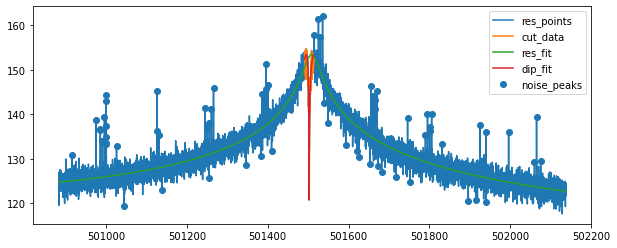

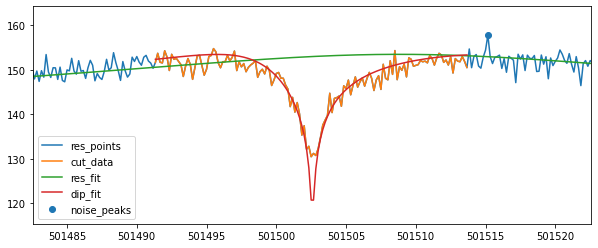

{'A': 2231629892880263.5, 'dA': 1.1130107290060691e-10, 'Q': 14074.470087892918, 'dQ': 34.399245806969105, 'nu_res': 501508.8334534389, 'dnu_res': 0.28073452396370396, 'nu_z': 501502.58295478707, 'dnu_z': 0.022278989602953037, 'dip_width': 5.007105475046918, 'ddip_width': 0.2011730694922456, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.5333348969158442, 'fit_success': True}
cycle4 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [852032565487619.5, 5645.575984988152, 124.65149519206989, -0.0015661183504400375, 501515.3333333333]
Start fiting resonator....
chi_reduziert =  0.8109389460554334
...End fiting resonator
{'A': 2288262314335350.5, 'dA': 1.1016551556707344e-10, 'Q': 14186.392449893605, 'dQ': 34.663994756257374, 'nu_res': 501508.4520883822, 'dnu_res': 0.2832997933712517, 'fit_err_chi**2_red': 0.8109389460554334}
resonator fit results:  [ 2.288262314335e+15  1.418639244989e+04  4.836328432299e+11
 -2.316131773797e-04  5.015084520884e+05] [1.

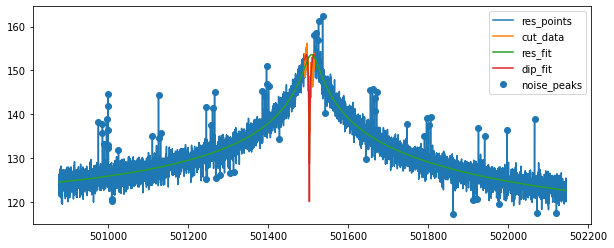

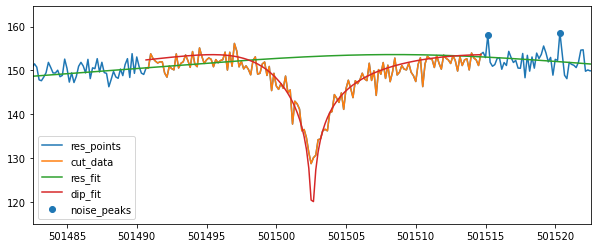

{'A': 2288262314335350.5, 'dA': 1.1016551556707344e-10, 'Q': 14186.392449893605, 'dQ': 34.663994756257374, 'nu_res': 501508.4520883822, 'dnu_res': 0.2832997933712517, 'nu_z': 501502.58589208056, 'dnu_z': 0.022103245271763848, 'dip_width': 5.293660024169723, 'ddip_width': 0.20859985735306596, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.5539615306679277, 'fit_success': True}
cycle4 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.8333333333 453.3333333330229
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



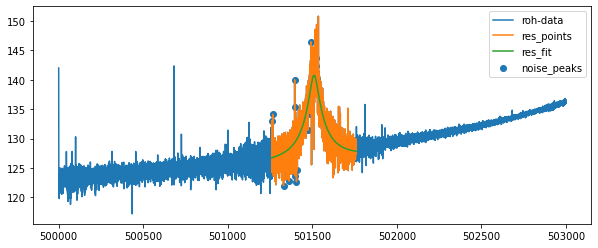

...End fiting resonator
{'A': 115910795449063.36, 'dA': 5.479142790866981e-09, 'off': 4325477890850.9126, 'doff': 1.0346065166569911e-07, 'Q': 10650.496347209642, 'dQ': 99.1599267081244, 'th': 0.00035101884350948067, 'dth': 4.235312098229454e-05, 'nu_res': 501510.1798878048, 'dnu_res': 0.5159606008091878, 'fit_err_chi**2_red': 2.9988957903886155}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


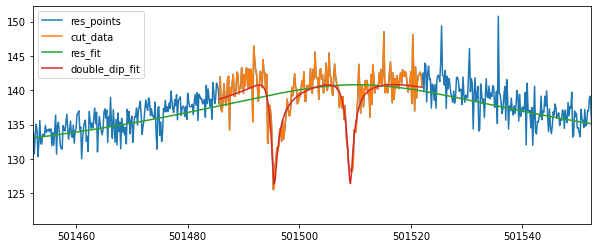

501495.53795480914 0.06067358622366659 501509.1333376676 0.05810146779060829
cycle4 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.8333333333 1237.333333333023
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


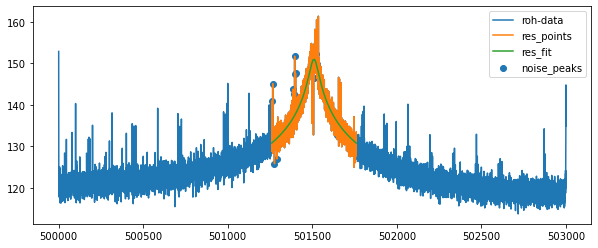

...End fiting resonator
{'A': 1254740283775848.5, 'dA': 2.2344564404162069e-10, 'off': 977751.3035130979, 'doff': 9.080750176630401e-09, 'Q': 10201.504450128095, 'dQ': 50.62127708313139, 'th': 4.772258719995607e-12, 'dth': 5.0892473613284983e-05, 'nu_res': 501509.54039481515, 'dnu_res': 0.50253543946061, 'fit_err_chi**2_red': 2.9572049340153908}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


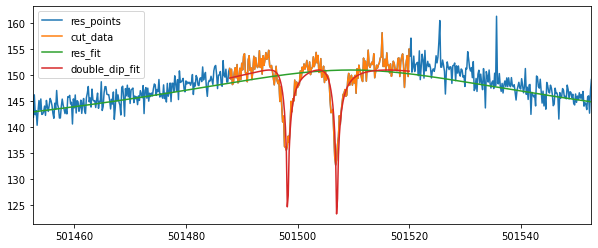

501498.23861557816 0.01602243318848739 501507.0684154542 0.015789091353819316
[501502.58295478707, 501502.58589208056]
503840.97 501502.5844234338 501495.53795480914 501509.1333376676 0.031383225284731975 0.06067358622366659 0.05810146779060829
53273922.2 501502.5844234338 501498.23861557816 501507.0684154542 0.031383225284731975 0.01602243318848739 0.015789091353819316
['cycle4', 'position_1', 3, 0.005, '20211217_205249.053481', 53775424.92260761, 0.03861244100456528, 2338.883130956965, 0.08967703972553977, 501502.5844234338, 0.031383225284731975, 5.293660024169723, 0.20859985735306596, True, 501508.4520883822, 0.2832997933712517]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [881970333678214.6, 5720.692015207859, 124.929443359375, -0.00

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.79602190477265
...End fiting resonator
{'A': 2340592844660531.5, 'dA': 1.0907770785525613e-10, 'Q': 14256.892724630165, 'dQ': 34.913691235559035, 'nu_res': 501509.0290686989, 'dnu_res': 0.2793270844540382, 'fit_err_chi**2_red': 0.79602190477265}
resonator fit results:  [ 2.340592844661e+15  1.425689272463e+04  5.042731844961e+11
 -2.542660313987e-04  5.015090290687e+05] [1.090777078553e-10 3.491369123556e+01 4.131610443080e-08
 8.885229740489e-06 2.793270844540e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9641681683290062


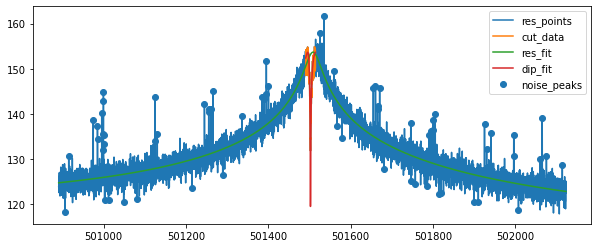

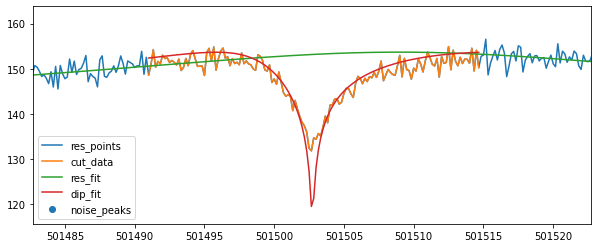

{'A': 2340592844660531.5, 'dA': 1.0907770785525613e-10, 'Q': 14256.892724630165, 'dQ': 34.913691235559035, 'nu_res': 501509.0290686989, 'dnu_res': 0.2793270844540382, 'nu_z': 501502.7338910302, 'dnu_z': 0.02469124372662975, 'dip_width': 5.171849852616326, 'ddip_width': 0.23112468956477195, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.9641681683290062, 'fit_success': True}
cycle4 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [904562821474284.9, 5865.656920077973, 124.88928517776671, -0.0014955053537937073, 501513.6666666667]
Start fiting resonator....
chi_reduziert =  0.7981056414601148
...End fiting resonator
{'A': 2381655508196717.0, 'dA': 1.1241103553756803e-10, 'Q': 14469.214895969346, 'dQ': 36.084586491800366, 'nu_res': 501508.62529151014, 'dnu_res': 0.28184640588841586, 'fit_err_chi**2_red': 0.7981056414601148}
resonator fit results:  [ 2.381655508197e+15  1.446921489597e+04  5.199204442919e+11
 -2.337661925698e-04  5.015086252915

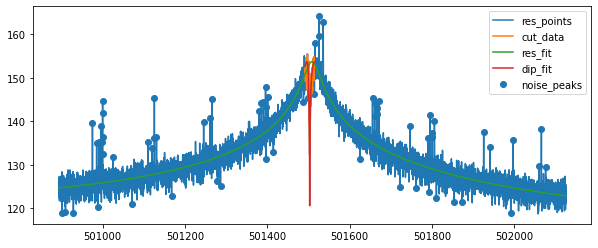

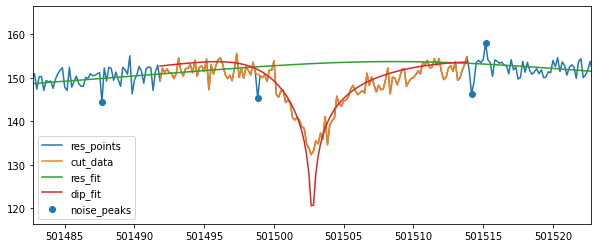

{'A': 2381655508196717.0, 'dA': 1.1241103553756803e-10, 'Q': 14469.214895969346, 'dQ': 36.084586491800366, 'nu_res': 501508.62529151014, 'dnu_res': 0.28184640588841586, 'nu_z': 501502.748375052, 'dnu_z': 0.025909714578167764, 'dip_width': 5.038598815569793, 'ddip_width': 0.2447117492847383, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 2.168733753454145, 'fit_success': True}
cycle4 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501513.8333333333 490.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


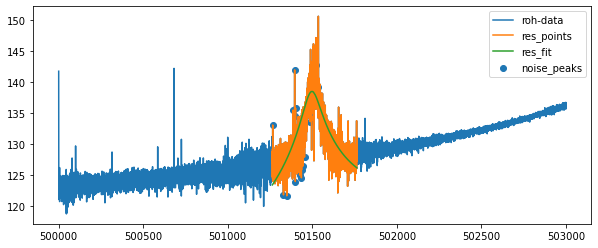

...End fiting resonator
{'A': 70103455402009.164, 'dA': 1.5899171074209081e-09, 'off': 195932051354.28986, 'doff': 1.7459815956704473e-08, 'Q': 5040.772016940749, 'dQ': 36.89587542849993, 'th': 0.001232844280047253, 'dth': 7.27065747481086e-05, 'nu_res': 501495.73271443736, 'dnu_res': 1.11636490025173, 'fit_err_chi**2_red': 5.683272696782413}
Start fiting double dip....
Fit is NOT GOOD !!!!!


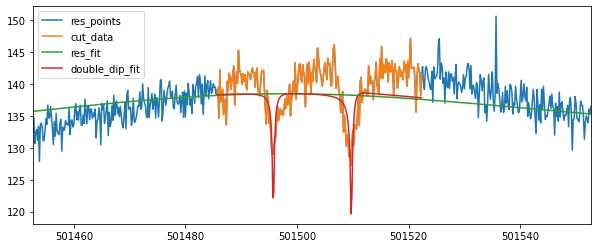

501495.74645414576 0.025658874314390668 501509.7366434049 0.026384672627343123
cycle4 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.5 1249.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


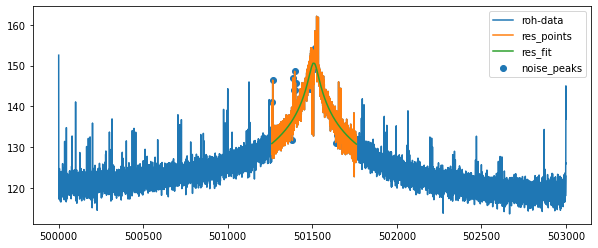

...End fiting resonator
{'A': 1169776032470715.8, 'dA': 2.3011700475991806e-10, 'off': 5333580.572335542, 'doff': 8.785326066503293e-09, 'Q': 9822.156441358267, 'dQ': 50.30832000217282, 'th': 2.890481718622659e-12, 'dth': 5.265687369661041e-05, 'nu_res': 501508.52827495866, 'dnu_res': 0.5313354188354988, 'fit_err_chi**2_red': 3.200137187587058}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


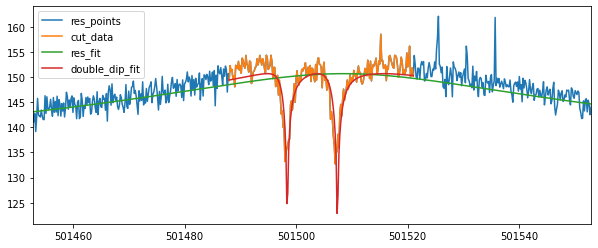

501498.4058591579 0.017661917148720303 501507.39908559824 0.0171655969542328
[501502.7338910302, 501502.748375052]
503840.97 501502.7411330411 501495.74645414576 501509.7366434049 0.03579065277820387 0.025658874314390668 0.026384672627343123
53273922.2 501502.7411330411 501498.4058591579 501507.39908559824 0.03579065277820387 0.017661917148720303 0.0171655969542328
['cycle4', 'position_1', 3, 0.008, '20211217_204646.769812', 53775425.263811715, 0.04344619502848758, 2338.228035490436, 0.05133711724496925, 501502.7411330411, 0.03579065277820387, 5.038598815569793, 0.2447117492847383, True, 501508.62529151014, 0.28184640588841586]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [903168869182474.2, 5842.881553399379, 124.60884094238281, -0.0016

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7944170196922877
...End fiting resonator
{'A': 2380530613673433.0, 'dA': 1.0669561918492605e-10, 'Q': 14361.183952088502, 'dQ': 34.50369825203865, 'nu_res': 501508.5137159418, 'dnu_res': 0.27566798786342245, 'fit_err_chi**2_red': 0.7944170196922877}
resonator fit results:  [ 2.380530613673e+15  1.436118395209e+04  4.698183205777e+11
 -2.527676584957e-04  5.015085137159e+05] [1.066956191849e-10 3.450369825204e+01 4.198453915400e-08
 8.674148690099e-06 2.756679878634e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.0489629771557096
Fit is NOT GOOD !!!!!


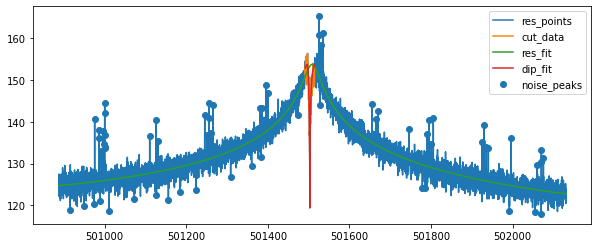

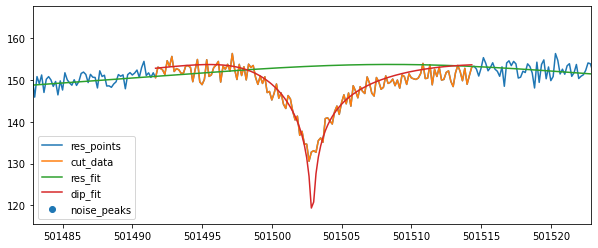

{'A': 2380530613673433.0, 'dA': 1.0669561918492605e-10, 'Q': 14361.183952088502, 'dQ': 34.50369825203865, 'nu_res': 501508.5137159418, 'dnu_res': 0.27566798786342245, 'nu_z': 501502.9033943187, 'dnu_z': 0.02520892871772507, 'dip_width': 5.508205861198219, 'ddip_width': 0.24228812566089755, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 2.0489629771557096, 'fit_success': True}
cycle4 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [879833610999583.2, 5720.680608363753, 124.84172473257719, -0.001581668088415475, 501513.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8049749947552398
...End fiting resonator
{'A': 2341920188848886.5, 'dA': 1.1257770737186454e-10, 'Q': 14398.887462120008, 'dQ': 35.69229117880207, 'nu_res': 501508.959577983, 'dnu_res': 0.2789232744172418, 'fit_err_chi**2_red': 0.8049749947552398}
resonator fit results:  [ 2.341920188849e+15  1.439888746212e+04  5.535708814746e+11
 -2.545430023213e-04  5.015089595780e+05] [1.125777073719e-10 3.569229117880e+01 4.228704447800e-08
 9.002769286451e-06 2.789232744172e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9615576740097278


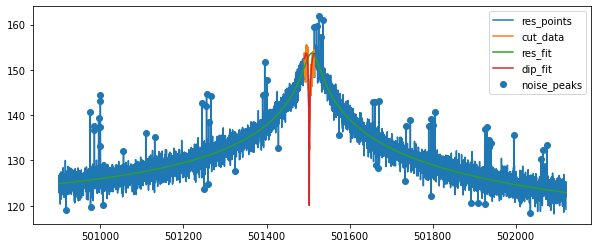

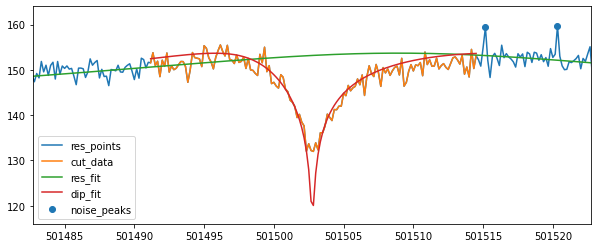

{'A': 2341920188848886.5, 'dA': 1.1257770737186454e-10, 'Q': 14398.887462120008, 'dQ': 35.69229117880207, 'nu_res': 501508.959577983, 'dnu_res': 0.2789232744172418, 'nu_z': 501502.7580903511, 'dnu_z': 0.025645755811697132, 'dip_width': 5.307736373614984, 'ddip_width': 0.23367751691038974, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.9615576740097278, 'fit_success': True}
cycle4 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 453.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


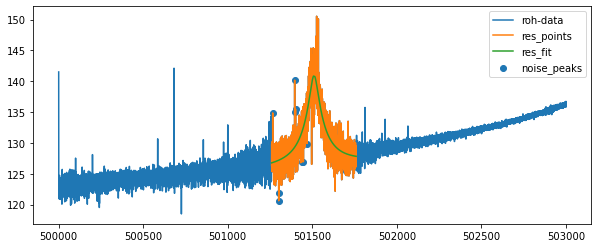

...End fiting resonator
{'A': 119349867980689.45, 'dA': 5.3352564685017425e-09, 'off': 4364208590587.487, 'doff': 1.0320351097465367e-07, 'Q': 10868.0195086029, 'dQ': 97.62353364463074, 'th': 0.00033362314968199966, 'dth': 4.074195445901527e-05, 'nu_res': 501510.11108025967, 'dnu_res': 0.4898253590306402, 'fit_err_chi**2_red': 2.985098082868164}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


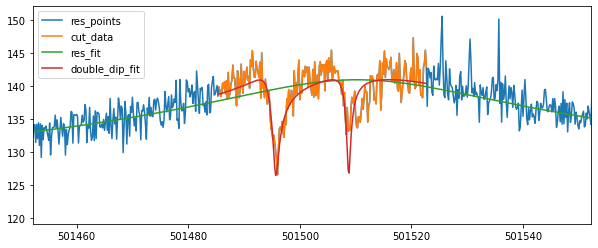

501495.71670848195 0.0733505259529727 501508.7643256072 0.05532544139028296
cycle4 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.8333333333 1228.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



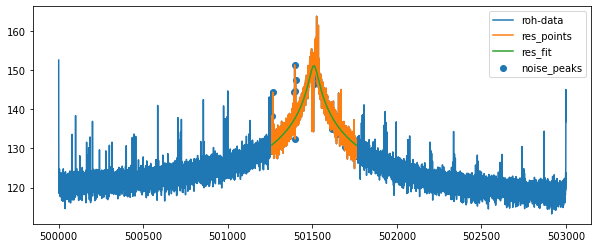

...End fiting resonator
{'A': 1298770653003443.2, 'dA': 2.1413092555842506e-10, 'off': 399.50386908109067, 'doff': 5.515142490322808e-15, 'Q': 10323.220299852961, 'dQ': 49.67230862649685, 'th': 1.3295240369098524e-13, 'dth': 4.9310613226037793e-05, 'nu_res': 501509.0728568129, 'dnu_res': 0.4836352301607896, 'fit_err_chi**2_red': 2.8359222424454313}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


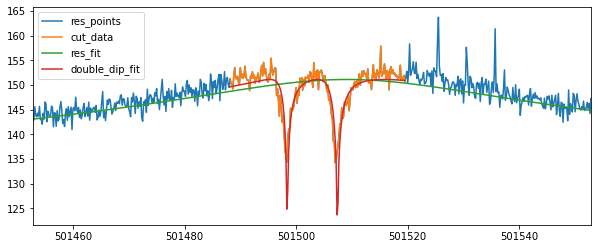

501498.3975781564 0.015281209859485926 501507.4047186169 0.015637543902982103
[501502.9033943187, 501502.7580903511]
503840.97 501502.83074233495 501495.71670848195 501508.7643256072 0.035961018871112936 0.0733505259529727 0.05532544139028296
53273922.2 501502.83074233495 501498.3975781564 501507.4047186169 0.035961018871112936 0.015281209859485926 0.015637543902982103
['cycle4', 'position_1', 3, 0.015, '20211217_210453.651348', 53775425.17155444, 0.04208613824450853, 2339.319708245748, 0.09866305793383812, 501502.83074233495, 0.035961018871112936, 5.307736373614984, 0.23367751691038974, True, 501508.959577983, 0.2789232744172418]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [891610931951293.0, 5797.845857418112, 124.60429382324219, -0.00

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.813284448094907
...End fiting resonator
{'A': 2367818007119831.0, 'dA': 1.1339299923298992e-10, 'Q': 14498.459533771344, 'dQ': 36.10485433489115, 'nu_res': 501509.2335763125, 'dnu_res': 0.2787370044852986, 'fit_err_chi**2_red': 0.813284448094907}
resonator fit results:  [ 2.367818007120e+15  1.449845953377e+04  5.681587280296e+11
 -2.668463848366e-04  5.015092335763e+05] [1.133929992330e-10 3.610485433489e+01 4.341594514202e-08
 8.962365540542e-06 2.787370044853e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6258179422585963


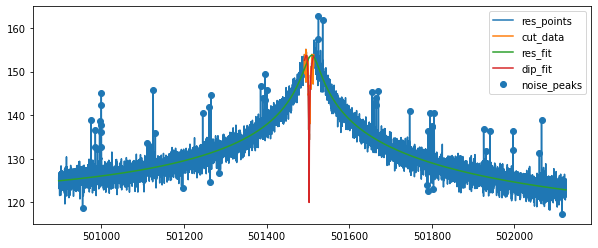

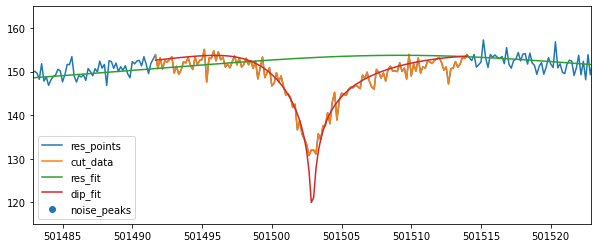

{'A': 2367818007119831.0, 'dA': 1.1339299923298992e-10, 'Q': 14498.459533771344, 'dQ': 36.10485433489115, 'nu_res': 501509.2335763125, 'dnu_res': 0.2787370044852986, 'nu_z': 501502.90517305216, 'dnu_z': 0.02360177712676327, 'dip_width': 5.391795493626666, 'ddip_width': 0.2148115562660737, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.6258179422585963, 'fit_success': True}
cycle4 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [881674991998474.1, 5775.5834932834405, 124.98116302490234, -0.0016707981392967144, 501513.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8005695121996388
...End fiting resonator
{'A': 2275001701624956.0, 'dA': 1.1050598069458081e-10, 'Q': 14190.304301802258, 'dQ': 34.531782812263856, 'nu_res': 501508.91630152205, 'dnu_res': 0.2773870830542795, 'fit_err_chi**2_red': 0.8005695121996388}
resonator fit results:  [ 2.275001701625e+15  1.419030430180e+04  5.491883812176e+11
 -2.520400172371e-04  5.015089163015e+05] [1.105059806946e-10 3.453178281226e+01 4.129899488350e-08
 8.710026488997e-06 2.773870830543e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6168176951455202


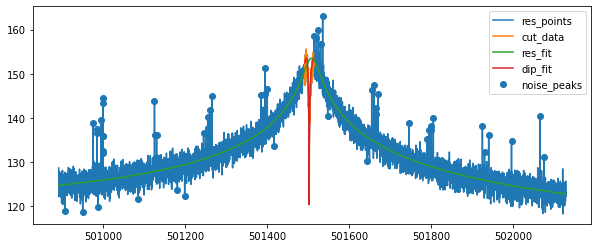

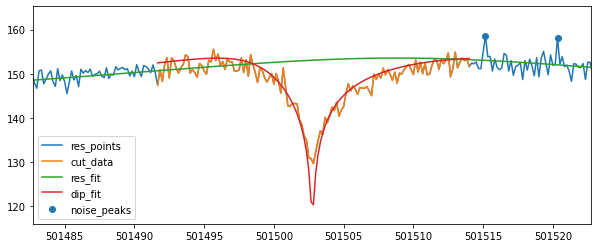

{'A': 2275001701624956.0, 'dA': 1.1050598069458081e-10, 'Q': 14190.304301802258, 'dQ': 34.531782812263856, 'nu_res': 501508.91630152205, 'dnu_res': 0.2773870830542795, 'nu_z': 501502.7550732253, 'dnu_z': 0.02236369825801925, 'dip_width': 5.0068562445920675, 'ddip_width': 0.2038143588523387, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.6168176951455202, 'fit_success': True}
cycle4 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 458.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


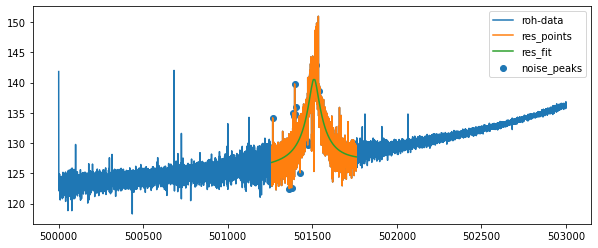

...End fiting resonator
{'A': 110957583322172.78, 'dA': 5.616128243669203e-09, 'off': 4317096195579.4565, 'doff': 1.029121262517876e-07, 'Q': 10484.502222575691, 'dQ': 98.49954710479173, 'th': 0.00028968816564961276, 'dth': 4.240919697297839e-05, 'nu_res': 501510.1342392875, 'dnu_res': 0.5240681510931652, 'fit_err_chi**2_red': 3.119485354506455}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


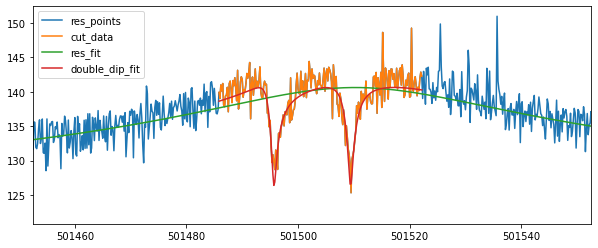

501495.7073412749 0.057367329859734306 501509.41082057485 0.05836057803973078
cycle4 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.6666666667 1241.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



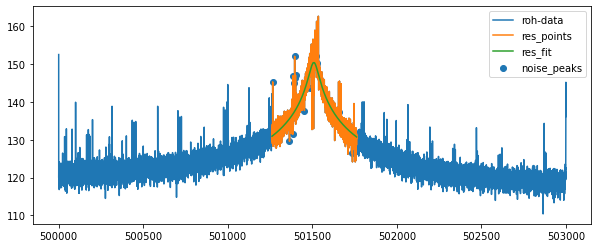

...End fiting resonator
{'A': 1114427850631809.9, 'dA': 2.2818206964206365e-10, 'off': 319759.5682476887, 'doff': 1.1089283259764752e-08, 'Q': 9558.620898460209, 'dQ': 48.71144174683129, 'th': 5.7388307055965724e-31, 'dth': 5.248076497359704e-05, 'nu_res': 501508.80847053125, 'dnu_res': 0.5378849410509898, 'fit_err_chi**2_red': 3.1877282350074627}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


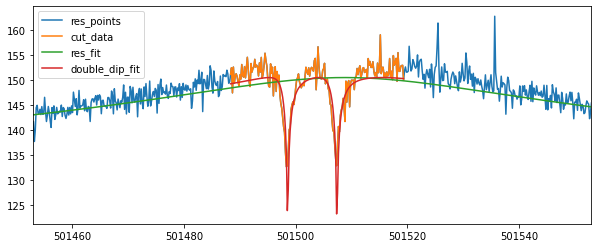

501498.5625971794 0.01622673945931884 501507.3961898557 0.016212401529608234
[501502.90517305216, 501502.7550732253]
503840.97 501502.83012313873 501495.7073412749 501509.41082057485 0.03251428737212519 0.057367329859734306 0.05836057803973078
53273922.2 501502.83012313873 501498.5625971794 501507.3961898557 0.03251428737212519 0.01622673945931884 0.016212401529608234
['cycle4', 'position_1', 3, 0.03, '20211217_202237.468938', 53775425.32866389, 0.03979105326772587, 2338.6819612889667, 0.08805763162658992, 501502.83012313873, 0.03251428737212519, 5.0068562445920675, 0.2038143588523387, True, 501508.91630152205, 0.2773870830542795]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle4 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [861154887593598.1, 5709.850094877922, 124.7196379098895, -0.001

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8028673733287307
...End fiting resonator
{'A': 2368141069074810.0, 'dA': 1.1245025341161233e-10, 'Q': 14576.485290964198, 'dQ': 35.64746615683627, 'nu_res': 501508.9508294314, 'dnu_res': 0.2765302655692735, 'fit_err_chi**2_red': 0.8028673733287307}
resonator fit results:  [ 2.368141069075e+15  1.457648529096e+04  5.435619135471e+11
 -2.476721018096e-04  5.015089508294e+05] [1.124502534116e-10 3.564746615684e+01 4.566148564505e-08
 8.562708782202e-06 2.765302655693e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7126565331988366


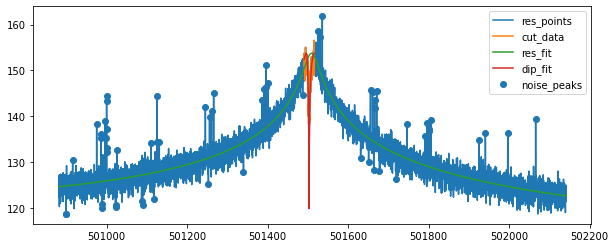

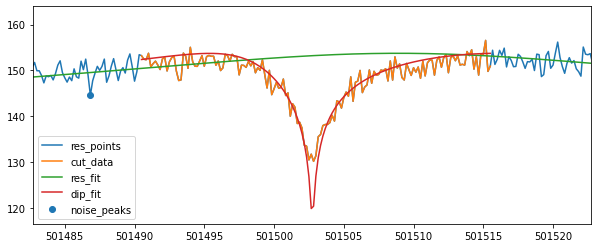

{'A': 2368141069074810.0, 'dA': 1.1245025341161233e-10, 'Q': 14576.485290964198, 'dQ': 35.64746615683627, 'nu_res': 501508.9508294314, 'dnu_res': 0.2765302655692735, 'nu_z': 501502.7444566737, 'dnu_z': 0.024969253611247282, 'dip_width': 5.818759194486129, 'ddip_width': 0.22898113105166112, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 1.7126565331988366, 'fit_success': True}
cycle4 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [898606091620127.2, 5809.0231660205545, 124.59416198730469, -0.0015859515913556985, 501512.3333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.816952546180338
...End fiting resonator
{'A': 2267558410493390.5, 'dA': 1.0636133828487994e-10, 'Q': 14001.962320440696, 'dQ': 33.59684563724406, 'nu_res': 501508.5373000214, 'dnu_res': 0.281185131227828, 'fit_err_chi**2_red': 0.816952546180338}
resonator fit results:  [ 2.267558410493e+15  1.400196232044e+04  4.704292111116e+11
 -2.423663948234e-04  5.015085373000e+05] [1.063613382849e-10 3.359684563724e+01 4.153589807993e-08
 8.427167693502e-06 2.811851312278e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9940785942491939


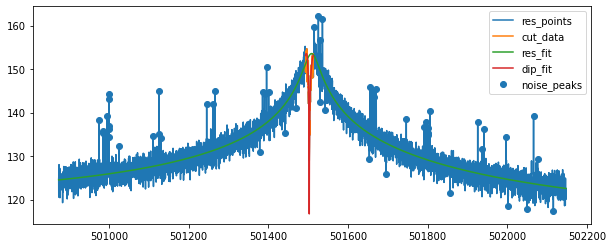

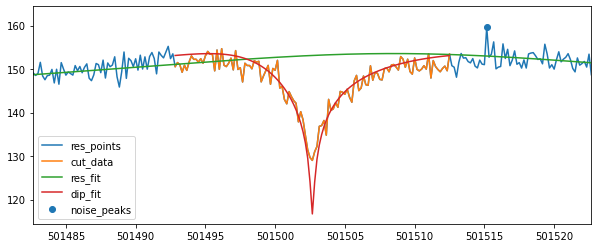

{'A': 2267558410493390.5, 'dA': 1.0636133828487994e-10, 'Q': 14001.962320440696, 'dQ': 33.59684563724406, 'nu_res': 501508.5373000214, 'dnu_res': 0.281185131227828, 'nu_z': 501502.66551863286, 'dnu_z': 0.031093001004734062, 'dip_width': 5.499041324611608, 'ddip_width': 0.23858562325923033, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.9940785942491939, 'fit_success': True}
cycle4 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.8333333333 454.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


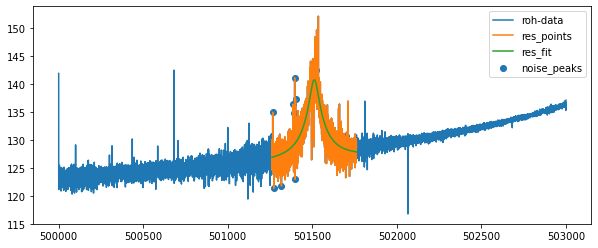

...End fiting resonator
{'A': 114417979856000.27, 'dA': 5.784055382364923e-09, 'off': 4424777206777.118, 'doff': 1.0798936714180555e-07, 'Q': 10714.459024845526, 'dQ': 102.47096147881975, 'th': 0.00030944185917954655, 'dth': 4.276787931427078e-05, 'nu_res': 501511.44180069683, 'dnu_res': 0.522266472419284, 'fit_err_chi**2_red': 3.1666686076690467}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


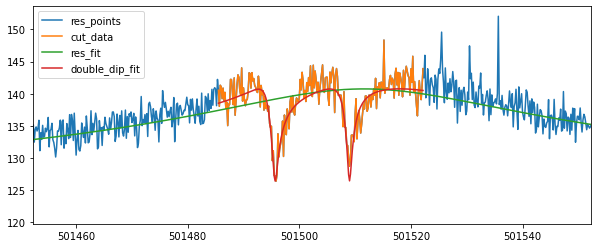

501495.67045677296 0.06531456576852492 501508.9912121097 0.05802366441067276
cycle4 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.0 1250.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



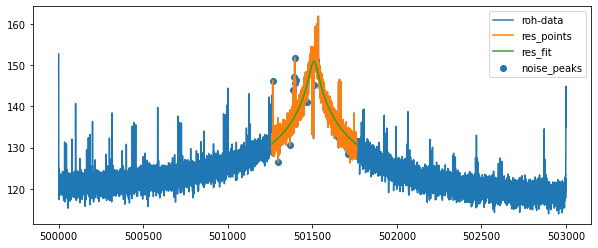

...End fiting resonator
{'A': 1251118231836921.2, 'dA': 2.2276219715980748e-10, 'off': 7967.27482779813, 'doff': 5.617329070236076e-15, 'Q': 10140.46052549046, 'dQ': 50.59640214194877, 'th': 6.478964550347104e-13, 'dth': 5.118877579523879e-05, 'nu_res': 501509.30159069924, 'dnu_res': 0.5071894330436193, 'fit_err_chi**2_red': 3.01456647216609}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


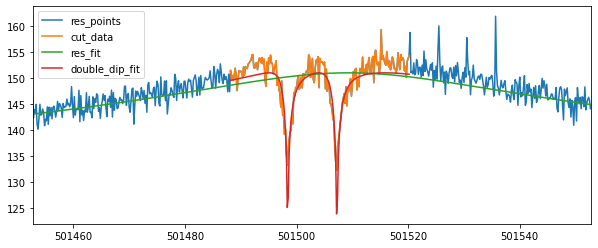

501498.4067543123 0.015651660902713617 501507.2347027013 0.015360691138487563
[501502.7444566737, 501502.66551863286]
503840.97 501502.7049876533 501495.67045677296 501508.9912121097 0.03987779253398035 0.06531456576852492 0.05802366441067276
53273922.2 501502.7049876533 501498.4067543123 501507.2347027013 0.03987779253398035 0.015651660902713617 0.015360691138487563
['cycle4', 'position_1', 3, 0.05, '20211217_205851.348207', 53775425.136469364, 0.04551003909742029, 2339.0133187706233, 0.09603632891024375, 501502.7049876533, 0.03987779253398035, 5.499041324611608, 0.23858562325923033, True, 501508.5373000214, 0.281185131227828]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [885252160016193.6, 5731.586666666666, 124.63943481445312, -0.001

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8025592521553634
...End fiting resonator
{'A': 2438004822859884.5, 'dA': 1.0941911250840263e-10, 'Q': 14621.141926560276, 'dQ': 35.59383189824991, 'nu_res': 501508.4516100213, 'dnu_res': 0.2742363006942914, 'fit_err_chi**2_red': 0.8025592521553634}
resonator fit results:  [ 2.438004822860e+15  1.462114192656e+04  4.918871940430e+11
 -2.398264732272e-04  5.015084516100e+05] [1.094191125084e-10 3.559383189825e+01 4.350529642986e-08
 8.856277369974e-06 2.742363006943e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.2231512997820135
Fit is NOT GOOD !!!!!


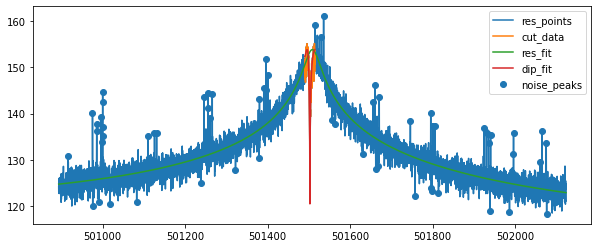

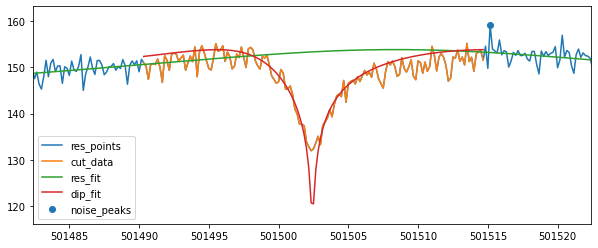

{'A': 2438004822859884.5, 'dA': 1.0941911250840263e-10, 'Q': 14621.141926560276, 'dQ': 35.59383189824991, 'nu_res': 501508.4516100213, 'dnu_res': 0.2742363006942914, 'nu_z': 501502.41817765456, 'dnu_z': 0.025357252131082687, 'dip_width': 5.136267498277956, 'ddip_width': 0.24259949770806097, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.2231512997820135, 'fit_success': True}
cycle5 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [890970446309896.8, 5842.893203880853, 124.7340087890625, -0.0016700326175802048, 501515.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.814763876444233
...End fiting resonator
{'A': 2352279279114674.5, 'dA': 1.122542754903369e-10, 'Q': 14429.065586909423, 'dQ': 35.69647797295792, 'nu_res': 501508.8960944361, 'dnu_res': 0.28127296067016494, 'fit_err_chi**2_red': 0.814763876444233}
resonator fit results:  [ 2.352279279115e+15  1.442906558691e+04  5.378310764391e+11
 -2.546654239247e-04  5.015088960944e+05] [1.122542754903e-10 3.569647797296e+01 4.434040853437e-08
 8.745070990314e-06 2.812729606702e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.4979033476481647


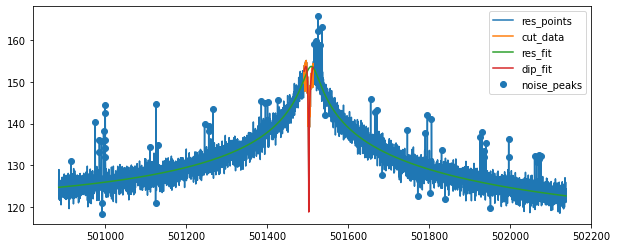

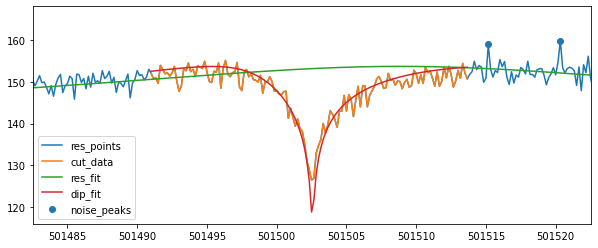

{'A': 2352279279114674.5, 'dA': 1.122542754903369e-10, 'Q': 14429.065586909423, 'dQ': 35.69647797295792, 'nu_res': 501508.8960944361, 'dnu_res': 0.28127296067016494, 'nu_z': 501502.55425891705, 'dnu_z': 0.023439759716299875, 'dip_width': 5.593438225151472, 'ddip_width': 0.21094090764695553, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.4979033476481647, 'fit_success': True}
cycle5 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501507.0 440.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


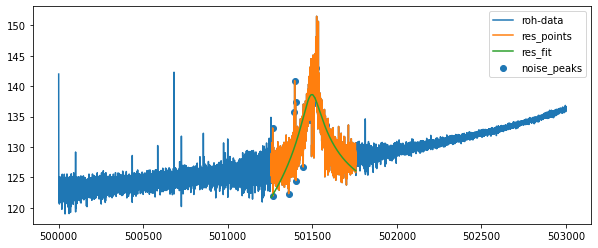

...End fiting resonator
{'A': 72625066392260.22, 'dA': 1.7509744826745896e-09, 'off': 126.99048157018174, 'doff': 9.552651167503363e-14, 'Q': 5431.443107562048, 'dQ': 40.01864014643257, 'th': 0.0016472681415287123, 'dth': 7.660039316790046e-05, 'nu_res': 501495.0121999731, 'dnu_res': 1.1018802640679377, 'fit_err_chi**2_red': 6.727168793114251}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


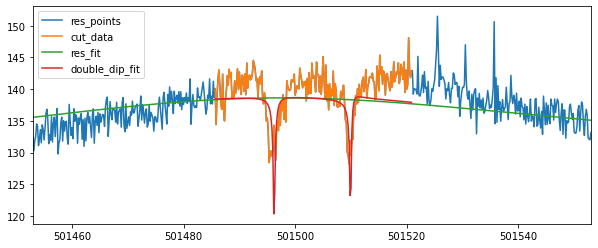

501496.23528703663 0.022543746573634765 501509.91560466983 0.02336130918381973
cycle5 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.3333333333 1254.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



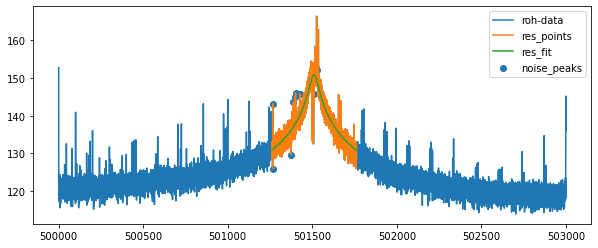

...End fiting resonator
{'A': 1208976356097739.0, 'dA': 2.1725666683412328e-10, 'off': 9848.67503263778, 'doff': 5.4158929075392486e-15, 'Q': 9892.453768320516, 'dQ': 48.771398151169876, 'th': 1.2559534670596624e-12, 'dth': 5.066277679209461e-05, 'nu_res': 501509.6182812155, 'dnu_res': 0.5091319242950103, 'fit_err_chi**2_red': 3.059900795915879}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


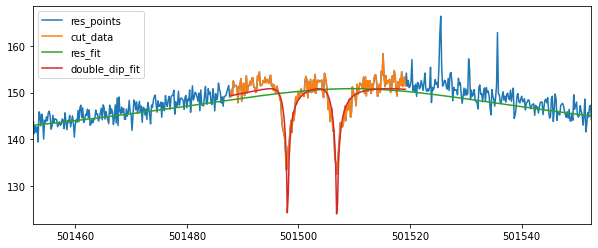

501498.0636667457 0.014581511557206415 501506.90579198947 0.015046533707834682
[501502.41817765456, 501502.55425891705]
503840.97 501502.4862182858 501496.23528703663 501509.91560466983 0.034531327388288624 0.022543746573634765 0.02336130918381973
53273922.2 501502.4862182858 501498.0636667457 501506.90579198947 0.034531327388288624 0.014581511557206415 0.015046533707834682
['cycle5', 'position_1', 3, -0.005, '20211217_211056.119223', 53775424.68324045, 0.040390979526512126, 2337.305326579255, 0.047396031981121176, 501502.4862182858, 0.034531327388288624, 5.593438225151472, 0.21094090764695553, True, 501508.8960944361, 0.28127296067016494]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [835913279993179.1, 5634.985018726592, 124.95822223367

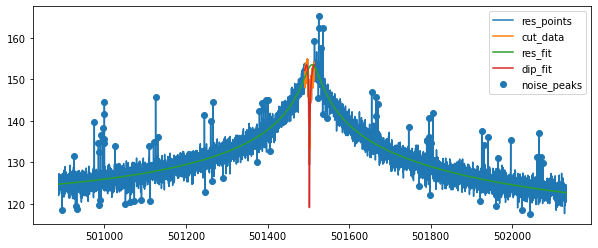

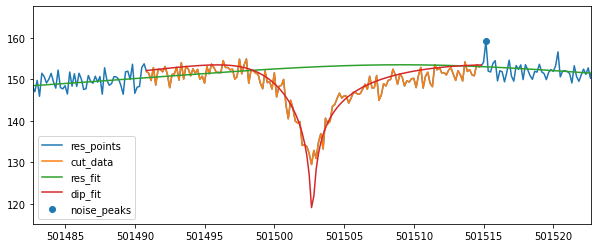

{'A': 2252484581523299.0, 'dA': 1.1116013415932792e-10, 'Q': 14141.448456075741, 'dQ': 34.51558377436031, 'nu_res': 501509.1483098199, 'dnu_res': 0.2800017524287811, 'nu_z': 501502.72397406993, 'dnu_z': 0.02384600630531887, 'dip_width': 5.091001136514461, 'ddip_width': 0.21484714722325887, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.7212115014455065, 'fit_success': True}
cycle5 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [888727704061841.2, 5786.696153848745, 124.5754165649414, -0.0016871366920094984, 501513.6666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8028458707581709
...End fiting resonator
{'A': 2347121704097676.5, 'dA': 1.1204209499871638e-10, 'Q': 14438.233496465295, 'dQ': 35.53505547632731, 'nu_res': 501508.8575241413, 'dnu_res': 0.2807652388473944, 'fit_err_chi**2_red': 0.8028458707581709}
resonator fit results:  [ 2.347121704098e+15  1.443823349647e+04  5.137337567690e+11
 -2.463012628137e-04  5.015088575241e+05] [1.120420949987e-10 3.553505547633e+01 4.509380387651e-08
 8.657071669136e-06 2.807652388474e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.2487934563386505
Fit is NOT GOOD !!!!!


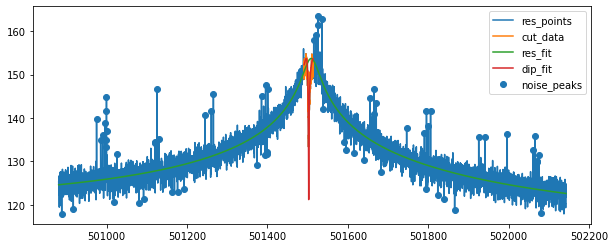

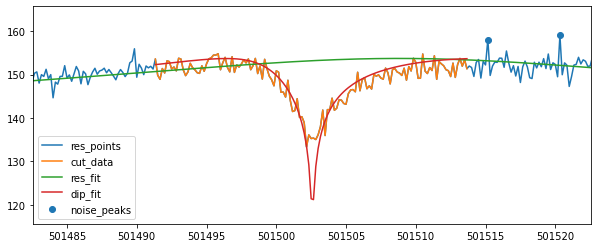

{'A': 2347121704097676.5, 'dA': 1.1204209499871638e-10, 'Q': 14438.233496465295, 'dQ': 35.53505547632731, 'nu_res': 501508.8575241413, 'dnu_res': 0.2807652388473944, 'nu_z': 501502.5843212627, 'dnu_z': 0.02446758032685105, 'dip_width': 4.425886584700659, 'ddip_width': 0.2295015900601212, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.2487934563386505, 'fit_success': True}
cycle5 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 456.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


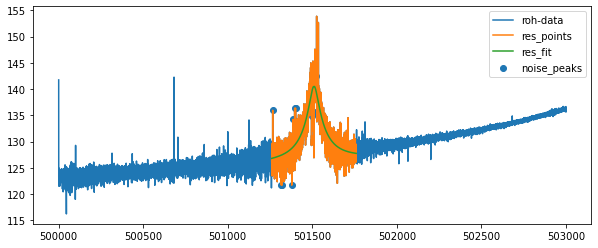

...End fiting resonator
{'A': 109644067682971.75, 'dA': 5.780359694949548e-09, 'off': 4342921274483.6914, 'doff': 1.0487753200271087e-07, 'Q': 10455.996416379443, 'dQ': 100.31756710347162, 'th': 0.00030285440132715827, 'dth': 4.306754028761126e-05, 'nu_res': 501509.8270216023, 'dnu_res': 0.5343975333427555, 'fit_err_chi**2_red': 3.233156497872567}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


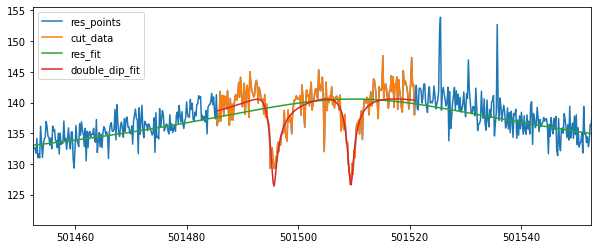

501495.6405136893 0.06508048979633699 501509.42011628416 0.06325582016079495
cycle5 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.5 1218.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



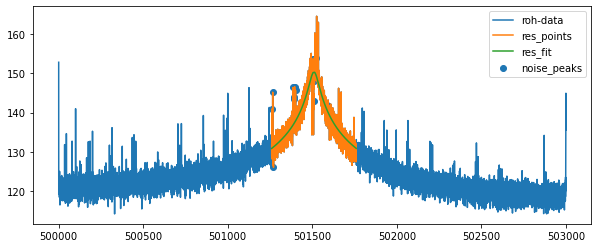

...End fiting resonator
{'A': 1081825045435467.2, 'dA': 2.2982416636161423e-10, 'off': 117579.98970714568, 'doff': 1.0082010305696613e-08, 'Q': 9404.540169324608, 'dQ': 48.33442887677236, 'th': 1.3884946266801788e-17, 'dth': 5.300353380592566e-05, 'nu_res': 501509.76141661155, 'dnu_res': 0.5483681136809371, 'fit_err_chi**2_red': 3.3000372853995854}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


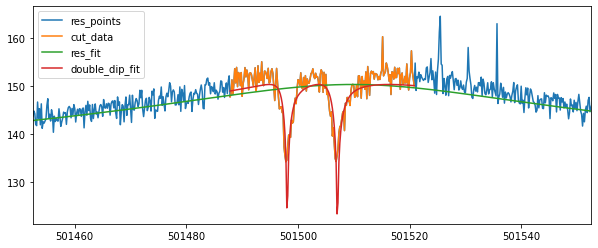

501498.0701786502 0.01841375934647658 501507.07126213296 0.018389810201017934
[501502.72397406993, 501502.5843212627]
503840.97 501502.6541476663 501495.6405136893 501509.42011628416 0.03416569191110017 0.06508048979633699 0.06325582016079495
53273922.2 501502.6541476663 501498.0701786502 501507.07126213296 0.03416569191110017 0.01841375934647658 0.018389810201017934
['cycle5', 'position_1', 3, -0.02, '20211217_214107.591161', 53775424.68729312, 0.042948179894654825, 2338.56351769279, 0.0969745504764532, 501502.6541476663, 0.03416569191110017, 4.425886584700659, 0.2295015900601212, True, 501508.8575241413, 0.2807652388473944]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [883336825749852.5, 5809.025096522486, 124.85008329279633, -0.001782

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7952329690326068
...End fiting resonator
{'A': 2174170908231929.2, 'dA': 1.1187572699413048e-10, 'Q': 13892.214414923828, 'dQ': 34.12024452255713, 'nu_res': 501508.4902700702, 'dnu_res': 0.284970011351713, 'fit_err_chi**2_red': 0.7952329690326068}
resonator fit results:  [ 2.174170908232e+15  1.389221441492e+04  5.187541880184e+11
 -2.507976868138e-04  5.015084902701e+05] [1.118757269941e-10 3.412024452256e+01 4.140955591169e-08
 8.678008565952e-06 2.849700113517e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8315410162254264


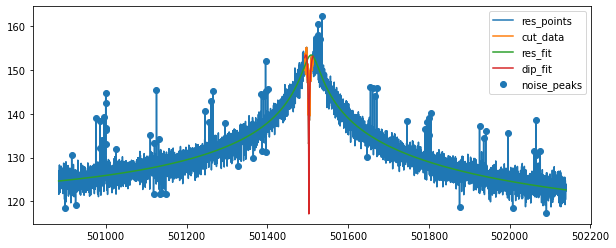

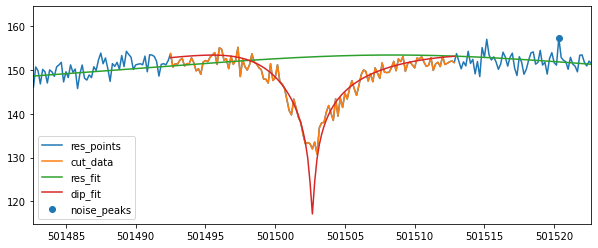

{'A': 2174170908231929.2, 'dA': 1.1187572699413048e-10, 'Q': 13892.214414923828, 'dQ': 34.12024452255713, 'nu_res': 501508.4902700702, 'dnu_res': 0.284970011351713, 'nu_z': 501502.6629073966, 'dnu_z': 0.030568046177219706, 'dip_width': 5.161964243932229, 'ddip_width': 0.22581920271525277, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.8315410162254264, 'fit_success': True}
cycle5 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [891122436110566.0, 5842.879611651806, 124.709228515625, -0.0016523122931399366, 501513.8333333333]
Start fiting resonator....
chi_reduziert =  0.8114379320607288
...End fiting resonator
{'A': 2034981604722684.0, 'dA': 1.0786519023927224e-10, 'Q': 13250.584678077266, 'dQ': 32.26549985181178, 'nu_res': 501509.08854314004, 'dnu_res': 0.29451313536283924, 'fit_err_chi**2_red': 0.8114379320607288}
resonator fit results:  [ 2.034981604723e+15  1.325058467808e+04  4.329219327139e+11
 -2.436186750673e-04  5.015090885431e+05

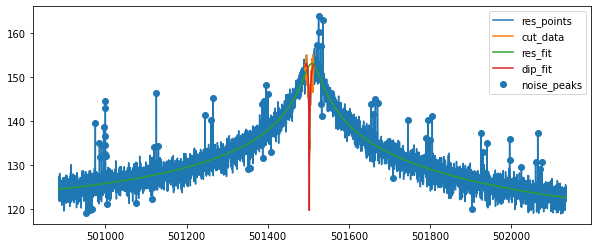

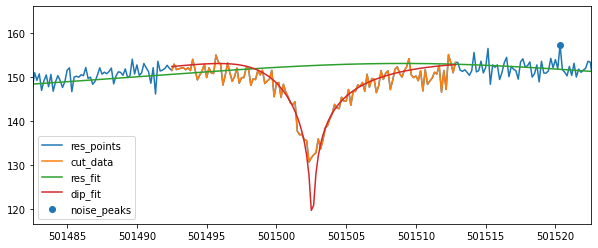

{'A': 2034981604722684.0, 'dA': 1.0786519023927224e-10, 'Q': 13250.584678077266, 'dQ': 32.26549985181178, 'nu_res': 501509.08854314004, 'dnu_res': 0.29451313536283924, 'nu_z': 501502.57373154024, 'dnu_z': 0.023124088898783757, 'dip_width': 4.664956651022953, 'ddip_width': 0.21927688461793055, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.9626184511789413, 'fit_success': True}
cycle5 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.1666666667 456.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


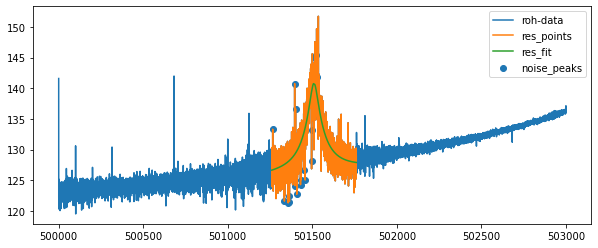

...End fiting resonator
{'A': 116680357902754.72, 'dA': 5.667832847779531e-09, 'off': 4371963868115.9272, 'doff': 1.0886160981855981e-07, 'Q': 10928.23284693822, 'dQ': 100.67577269253549, 'th': 0.0004009051628266428, 'dth': 4.1254753325000045e-05, 'nu_res': 501509.55647340254, 'dnu_res': 0.49640322282702365, 'fit_err_chi**2_red': 2.964284229488404}
Start fiting double dip....
Fit is NOT GOOD !!!!!


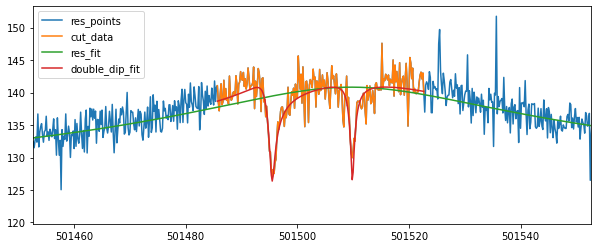

501495.4988751488 0.06010890649358854 501509.87467969593 0.04616372793059386
cycle5 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.3333333333 1258.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



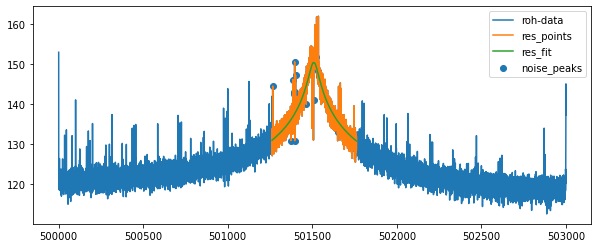

...End fiting resonator
{'A': 1105105147284855.9, 'dA': 2.2284864523993746e-10, 'off': 1225286.4635207378, 'doff': 7.408436127146465e-09, 'Q': 9452.644553461512, 'dQ': 47.65376036951614, 'th': 3.551536190980311e-22, 'dth': 5.195888396596968e-05, 'nu_res': 501508.6378866537, 'dnu_res': 0.5359668367164862, 'fit_err_chi**2_red': 3.121644580575696}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


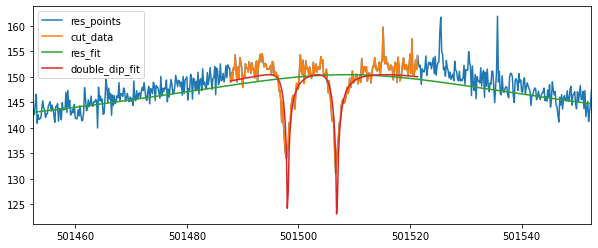

501498.0658290325 0.01646797144162413 501506.8991243507 0.016401455909184015
[501502.6629073966, 501502.57373154024]
503840.97 501502.61831946846 501495.4988751488 501509.87467969593 0.03832921776519174 0.06010890649358854 0.04616372793059386
53273922.2 501502.61831946846 501498.0658290325 501506.8991243507 0.03832921776519174 0.01646797144162413 0.016401455909184015
['cycle5', 'position_1', 3, -0.04, '20211217_215914.623520', 53775424.54663392, 0.04482555938116718, 2338.21476462367, 0.08493114476325132, 501502.61831946846, 0.03832921776519174, 4.664956651022953, 0.21927688461793055, True, 501509.08854314004, 0.29451313536283924]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [870265748344085.6, 5635.0, 124.71883392333984, -0.0017225000874

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8153114505525946
...End fiting resonator
{'A': 2406604149660664.5, 'dA': 1.1280961880409546e-10, 'Q': 14543.097254742132, 'dQ': 36.414630308308446, 'nu_res': 501509.2374853142, 'dnu_res': 0.282933666245177, 'fit_err_chi**2_red': 0.8153114505525946}
resonator fit results:  [ 2.406604149661e+15  1.454309725474e+04  5.092567718316e+11
 -2.514399595905e-04  5.015092374853e+05] [1.128096188041e-10 3.641463030831e+01 4.366989780949e-08
 9.164292104121e-06 2.829336662452e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.2095740237847257
Fit is NOT GOOD !!!!!


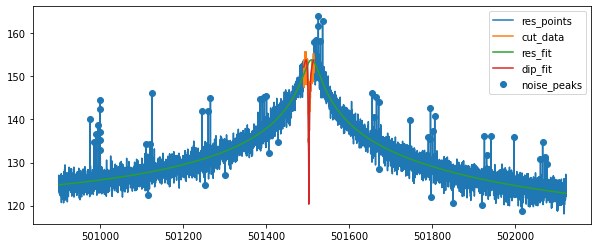

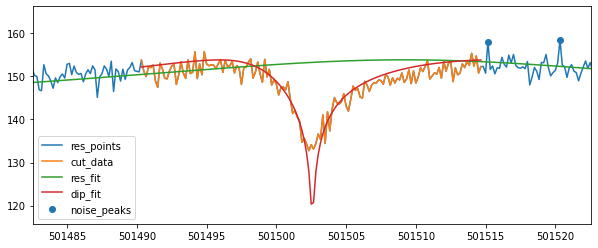

{'A': 2406604149660664.5, 'dA': 1.1280961880409546e-10, 'Q': 14543.097254742132, 'dQ': 36.414630308308446, 'nu_res': 501509.2374853142, 'dnu_res': 0.282933666245177, 'nu_z': 501502.57956510916, 'dnu_z': 0.026102891643029705, 'dip_width': 5.173651283669674, 'ddip_width': 0.24647022710445465, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.2095740237847257, 'fit_success': True}
cycle5 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [860392877486925.6, 5731.628571428571, 124.78621673583984, -0.0017035810387972148, 501517.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8056112695121483
...End fiting resonator
{'A': 2209825577391188.5, 'dA': 1.0865699750555134e-10, 'Q': 13865.312137619308, 'dQ': 33.75450815441914, 'nu_res': 501508.8012669038, 'dnu_res': 0.28466073989905794, 'fit_err_chi**2_red': 0.8056112695121483}
resonator fit results:  [ 2.209825577391e+15  1.386531213762e+04  4.732884053074e+11
 -2.540492496282e-04  5.015088012669e+05] [1.086569975056e-10 3.375450815442e+01 4.010801836741e-08
 8.750260234211e-06 2.846607398991e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6336389411944934


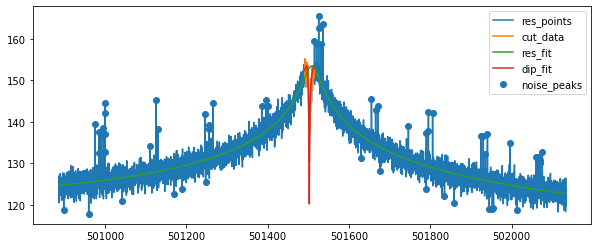

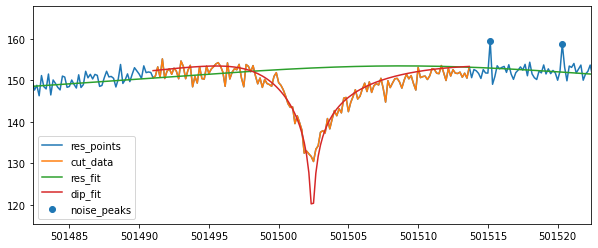

{'A': 2209825577391188.5, 'dA': 1.0865699750555134e-10, 'Q': 13865.312137619308, 'dQ': 33.75450815441914, 'nu_res': 501508.8012669038, 'dnu_res': 0.28466073989905794, 'nu_z': 501502.41489711934, 'dnu_z': 0.022067622000712037, 'dip_width': 5.072958813228089, 'ddip_width': 0.2082374711083296, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.6336389411944934, 'fit_success': True}
cycle5 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.6666666667 453.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



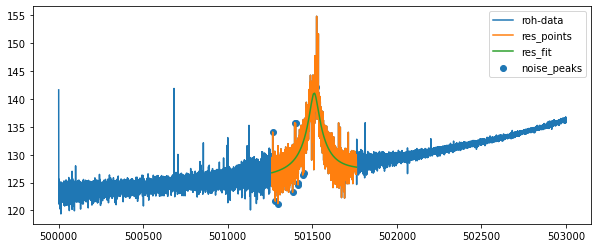

...End fiting resonator
{'A': 123450118479589.28, 'dA': 5.551179522757719e-09, 'off': 4351388389219.009, 'doff': 1.1190005652604806e-07, 'Q': 11238.817677383031, 'dQ': 101.94686762795911, 'th': 0.00032063241926370134, 'dth': 4.098523954349436e-05, 'nu_res': 501510.87891847495, 'dnu_res': 0.481882177628353, 'fit_err_chi**2_red': 3.0901508552576207}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


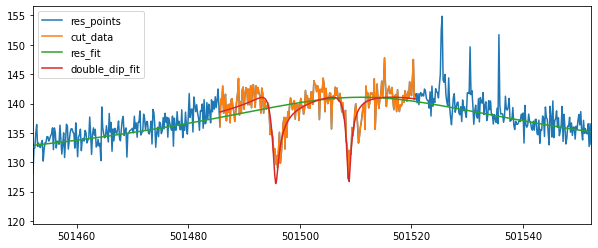

501495.6895154936 0.059149509634276565 501508.7675533444 0.048852547939363423
cycle5 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.0 1216.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



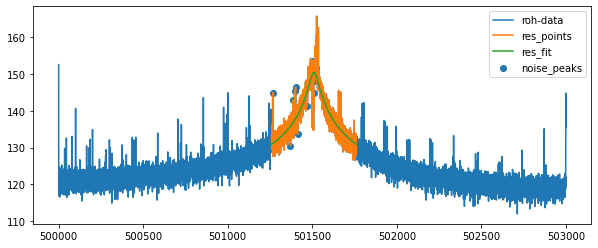

...End fiting resonator
{'A': 1119752388389154.4, 'dA': 2.2462622292849642e-10, 'off': 220.07140788566903, 'doff': 5.3427078648485134e-15, 'Q': 9571.91837575592, 'dQ': 48.12265164206192, 'th': 9.03011485490533e-15, 'dth': 5.1783781184088786e-05, 'nu_res': 501509.7103723395, 'dnu_res': 0.5303319167951934, 'fit_err_chi**2_red': 3.312193532674615}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


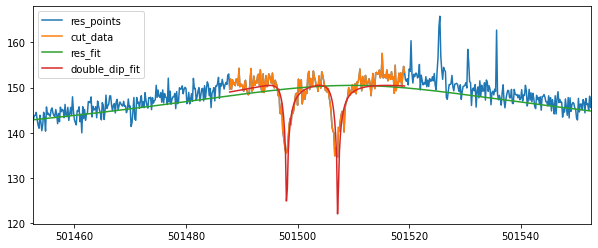

501498.0689406055 0.017292887384745617 501507.22065145324 0.015626452836700767
[501502.57956510916, 501502.41489711934]
503840.97 501502.49723111425 501495.6895154936 501508.7675533444 0.03418100192934753 0.059149509634276565 0.048852547939363423
53273922.2 501502.49723111425 501498.0689406055 501507.22065145324 0.03418100192934753 0.017292887384745617 0.015626452836700767
['cycle5', 'position_1', 3, 0.002, '20211217_214709.999878', 53775424.99236095, 0.04137113577427126, 2339.0101622761576, 0.08398557508904275, 501502.49723111425, 0.03418100192934753, 5.072958813228089, 0.2082374711083296, True, 501508.8012669038, 0.28466073989905794]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [856242838515788.8, 5699.034090909091, 124.61907823904649,

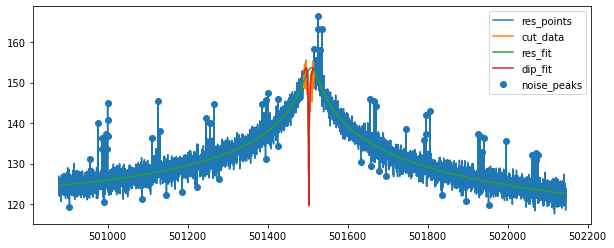

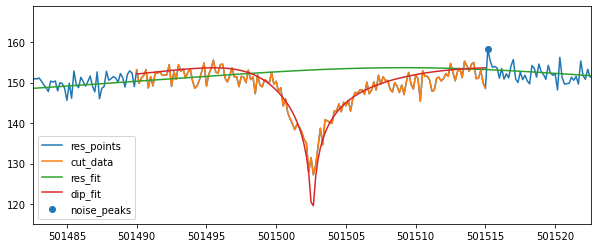

{'A': 2324146286386266.0, 'dA': 1.0864227362286359e-10, 'Q': 14186.764229384467, 'dQ': 34.72528372144842, 'nu_res': 501509.19136194006, 'dnu_res': 0.28466433822478154, 'nu_z': 501502.5907821053, 'dnu_z': 0.023494362765010976, 'dip_width': 5.490027781312235, 'ddip_width': 0.22307420043325205, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.6832149175355189, 'fit_success': True}
cycle5 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [893312355274745.8, 5742.543893131046, 124.82205963134766, -0.0014329450883311275, 501515.5]
Start fiting resonator....
chi_reduziert =  0.8178493507318582
...End fiting resonator
{'A': 2434640279427566.5, 'dA': 1.1371451719160118e-10, 'Q': 14672.11143102782, 'dQ': 36.802698284742284, 'nu_res': 501509.23165351857, 'dnu_res': 0.2794333105224912, 'fit_err_chi**2_red': 0.8178493507318582}
resonator fit results:  [ 2.434640279428e+15  1.467211143103e+04  6.011978669846e+11
 -2.455592429879e-04  5.015092316535e+05] [1.137145171

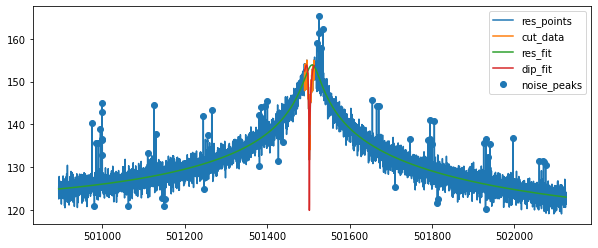

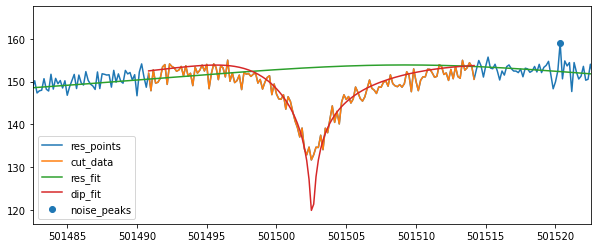

{'A': 2434640279427566.5, 'dA': 1.1371451719160118e-10, 'Q': 14672.11143102782, 'dQ': 36.802698284742284, 'nu_res': 501509.23165351857, 'dnu_res': 0.2794333105224912, 'nu_z': 501502.56827437447, 'dnu_z': 0.02645058244277572, 'dip_width': 5.519166059395384, 'ddip_width': 0.23735139318523643, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.9360522826010504, 'fit_success': True}
cycle5 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501511.1666666667 464.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


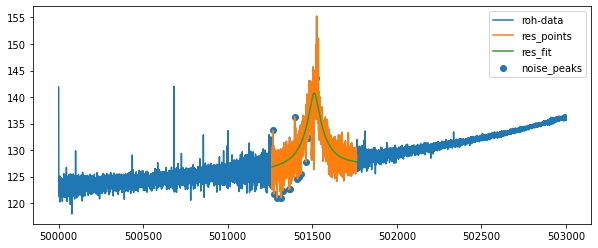

...End fiting resonator
{'A': 115682590125154.8, 'dA': 5.605568519197871e-09, 'off': 4361671388444.3887, 'doff': 1.0508171267045841e-07, 'Q': 10611.661113600909, 'dQ': 101.53324167307196, 'th': 0.00030440536300660654, 'dth': 4.343986845239152e-05, 'nu_res': 501511.05854642624, 'dnu_res': 0.5310066326348446, 'fit_err_chi**2_red': 3.1751875513061485}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


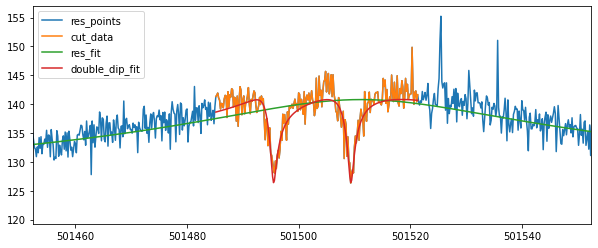

501495.5335156606 0.06540958752608808 501509.37750863 0.06461553949062862
cycle5 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.0 1250.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



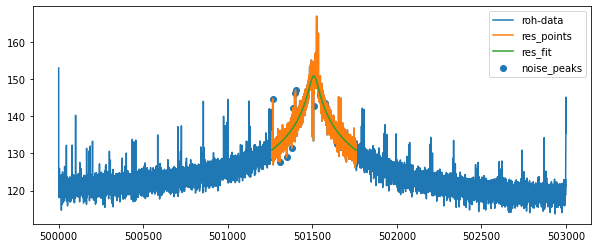

...End fiting resonator
{'A': 1211296895186020.0, 'dA': 2.2263952910316522e-10, 'off': 72412.15031546641, 'doff': 1.3900884946365782e-08, 'Q': 9959.084021225082, 'dQ': 49.771078138794586, 'th': 3.9757144750711474e-19, 'dth': 5.133442584094994e-05, 'nu_res': 501508.692338454, 'dnu_res': 0.5139048779791874, 'fit_err_chi**2_red': 3.2431621363730176}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


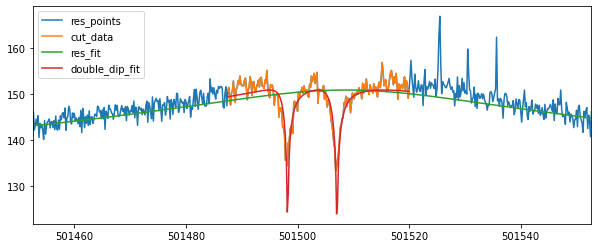

501498.2303328189 0.014541784469443883 501507.07134257356 0.01495890772862041
[501502.5907821053, 501502.56827437447]
503840.97 501502.5795282399 501495.5335156606 501509.37750863 0.03537821919339651 0.06540958752608808 0.06461553949062862
53273922.2 501502.5795282399 501498.2303328189 501507.07134257356 0.03537821919339651 0.014541784469443883 0.01495890772862041
['cycle5', 'position_1', 3, 0.005, '20211217_211658.406499', 53775424.922147155, 0.041071289355036664, 2338.6385039492743, 0.09851497590363595, 501502.5795282399, 0.03537821919339651, 5.519166059395384, 0.23735139318523643, True, 501509.23165351857, 0.2794333105224912]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [901539421796366.2, 5820.2901353952075, 125.05473347805712, -0.00

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8000970569300851
...End fiting resonator
{'A': 2434215362485818.0, 'dA': 1.1165816269922707e-10, 'Q': 14658.965169742696, 'dQ': 36.15731164994334, 'nu_res': 501508.8003733451, 'dnu_res': 0.2743761819033961, 'fit_err_chi**2_red': 0.8000970569300851}
resonator fit results:  [ 2.434215362486e+15  1.465896516974e+04  5.873375911825e+11
 -2.409947492981e-04  5.015088003733e+05] [1.116581626992e-10 3.615731164994e+01 4.386419523345e-08
 8.806606772508e-06 2.743761819034e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6279071662932545


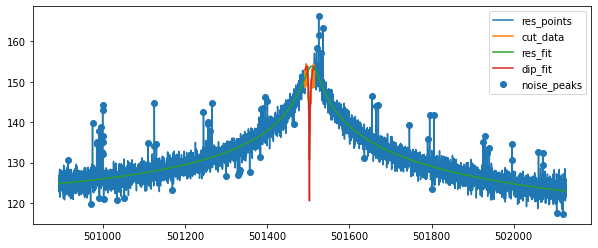

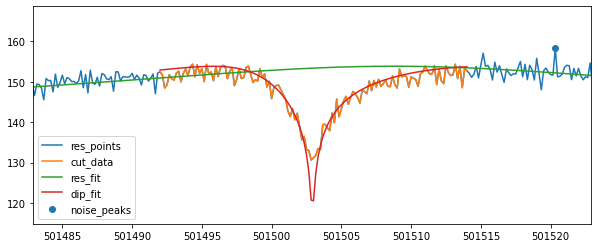

{'A': 2434215362485818.0, 'dA': 1.1165816269922707e-10, 'Q': 14658.965169742696, 'dQ': 36.15731164994334, 'nu_res': 501508.8003733451, 'dnu_res': 0.2743761819033961, 'nu_z': 501502.9181479019, 'dnu_z': 0.023658272437709304, 'dip_width': 5.419983020353579, 'ddip_width': 0.21539630086626282, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 1.6279071662932545, 'fit_success': True}
cycle5 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [879420940660667.4, 5775.6084452949235, 124.6983642578125, -0.0015642848031035324, 501515.3333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7961405115746027
...End fiting resonator
{'A': 2191770716771821.8, 'dA': 1.0950331812026796e-10, 'Q': 13853.903924167413, 'dQ': 33.74352420956663, 'nu_res': 501509.14525170124, 'dnu_res': 0.28172181454034345, 'fit_err_chi**2_red': 0.7961405115746027}
resonator fit results:  [ 2.191770716772e+15  1.385390392417e+04  4.870602176547e+11
 -2.350757483163e-04  5.015091452517e+05] [1.095033181203e-10 3.374352420957e+01 3.856942253431e-08
 8.977414481185e-06 2.817218145403e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7415549548130804


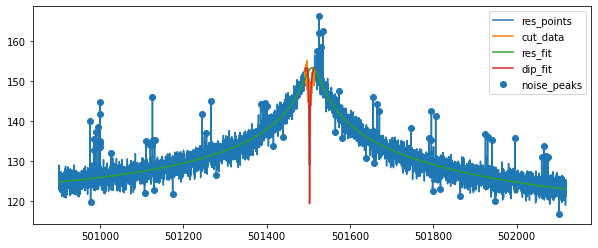

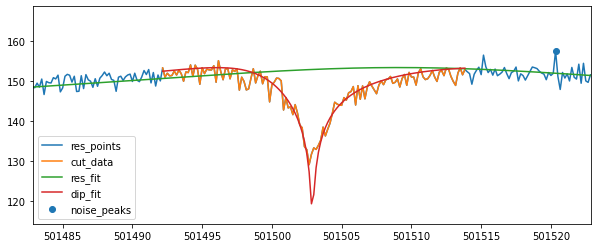

{'A': 2191770716771821.8, 'dA': 1.0950331812026796e-10, 'Q': 13853.903924167413, 'dQ': 33.74352420956663, 'nu_res': 501509.14525170124, 'dnu_res': 0.28172181454034345, 'nu_z': 501502.8964527347, 'dnu_z': 0.022750307406960987, 'dip_width': 4.939960499658339, 'ddip_width': 0.21110779173102076, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 1.7415549548130804, 'fit_success': True}
cycle5 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501508.0 449.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



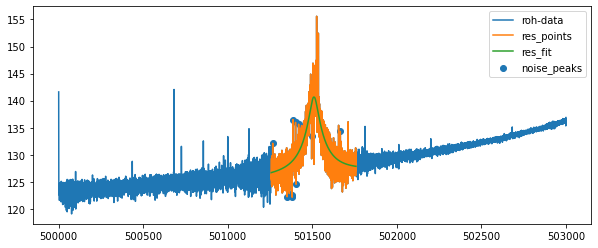

...End fiting resonator
{'A': 113247449323233.31, 'dA': 5.428486103298757e-09, 'off': 4321740675460.4546, 'doff': 1.0001215721194058e-07, 'Q': 10442.266651938657, 'dQ': 97.6905396356254, 'th': 0.0003608088326949522, 'dth': 4.264013553933158e-05, 'nu_res': 501509.55825106666, 'dnu_res': 0.5264429268443018, 'fit_err_chi**2_red': 3.0885568595105344}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


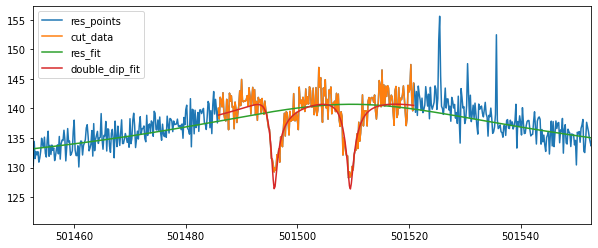

501495.8838913425 0.06096862651052626 501509.47091797047 0.06572686938857805
cycle5 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.6666666667 1209.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!

e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



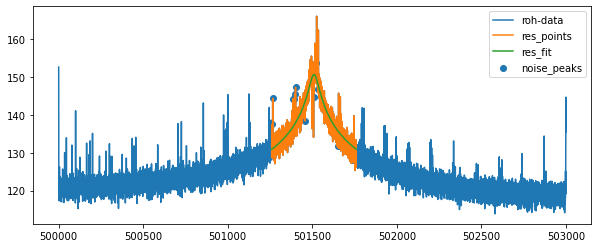

...End fiting resonator
{'A': 1171336997586433.0, 'dA': 2.2150727456299826e-10, 'off': 479470.561451539, 'doff': 7.596445914224552e-09, 'Q': 9736.531664231085, 'dQ': 48.87879781718343, 'th': 1.4890249338676456e-12, 'dth': 5.164836643121219e-05, 'nu_res': 501509.95418962406, 'dnu_res': 0.5237901560189387, 'fit_err_chi**2_red': 3.268626285192514}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


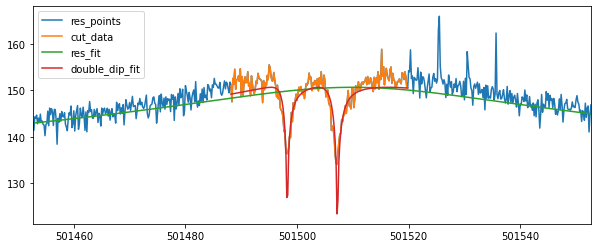

501498.2460852976 0.016443856137936523 501507.23445553624 0.015928465099250715
[501502.9181479019, 501502.8964527347]
503840.97 501502.9073003183 501495.8838913425 501509.47091797047 0.03282210142340218 0.06096862651052626 0.06572686938857805
53273922.2 501502.9073003183 501498.2460852976 501507.23445553624 0.03282210142340218 0.016443856137936523 0.015928465099250715
['cycle5', 'position_1', 3, 0.008, '20211217_212300.715704', 53775424.77324052, 0.04001758047347815, 2338.5224910053657, 0.09546981261137649, 501502.9073003183, 0.03282210142340218, 4.939960499658339, 0.21110779173102076, True, 501509.14525170124, 0.28172181454034345]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



Start Values res:  [904238933845907.2, 5888.5890410945485, 125.00706481933594, -0.0016174557806037707, 501511.5]
Start fiting resonator....
chi_reduziert =  0.7827920760268893
...End fiting resonator
{'A': 2229574964858932.5, 'dA': 1.1218922200505233e-10, 'Q': 14108.221609808206, 'dQ': 34.549229345990675, 'nu_res': 501509.8945781685, 'dnu_res': 0.28006510820939323, 'fit_err_chi**2_red': 0.7827920760268893}
resonator fit results:  [ 2.229574964859e+15  1.410822160981e+04  4.996687912665e+11
 -2.420022899720e-04  5.015098945782e+05] [1.121892220051e-10 3.454922934599e+01 4.036670577235e-08
 9.052648435543e-06 2.800651082094e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.090912030836228
Fit is NOT GOOD !!!!!


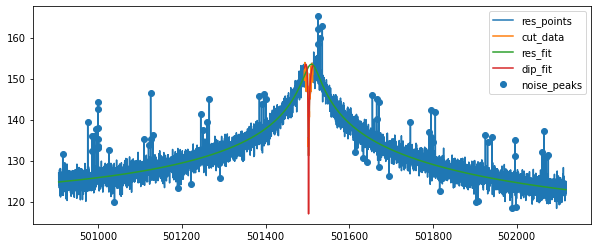

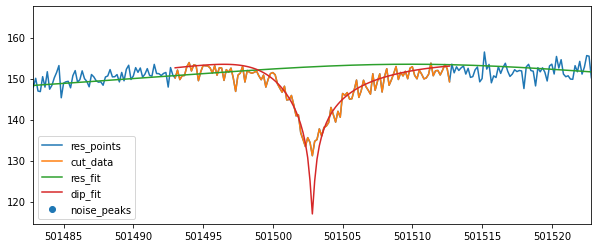

{'A': 2229574964858932.5, 'dA': 1.1218922200505233e-10, 'Q': 14108.221609808206, 'dQ': 34.549229345990675, 'nu_res': 501509.8945781685, 'dnu_res': 0.28006510820939323, 'nu_z': 501502.8311713911, 'dnu_z': 0.031785320366178454, 'dip_width': 4.787667315869679, 'ddip_width': 0.23064513274886592, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 2.090912030836228, 'fit_success': True}
cycle5 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [850249994261008.4, 5720.709125477817, 124.45556810777647, -0.0016302453980586204, 501515.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8023969927316009
...End fiting resonator
{'A': 2294570871241879.0, 'dA': 1.1012668213217252e-10, 'Q': 14263.052674540248, 'dQ': 34.55872488937715, 'nu_res': 501508.81616620073, 'dnu_res': 0.27870910062160975, 'fit_err_chi**2_red': 0.8023969927316009}
resonator fit results:  [ 2.294570871242e+15  1.426305267454e+04  5.309424446884e+11
 -2.479083587729e-04  5.015088161662e+05] [1.101266821322e-10 3.455872488938e+01 4.363218478531e-08
 8.431529704195e-06 2.787091006216e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6292668662273395


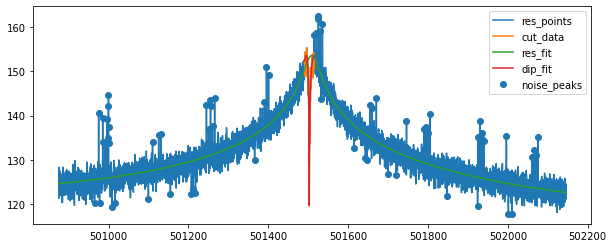

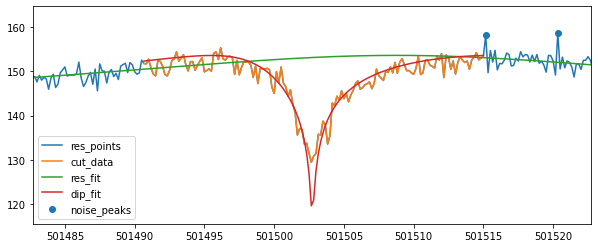

{'A': 2294570871241879.0, 'dA': 1.1012668213217252e-10, 'Q': 14263.052674540248, 'dQ': 34.55872488937715, 'nu_res': 501508.81616620073, 'dnu_res': 0.27870910062160975, 'nu_z': 501502.7368957543, 'dnu_z': 0.023546402198674696, 'dip_width': 5.486261221810994, 'ddip_width': 0.21563555685042562, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.6292668662273395, 'fit_success': True}
cycle5 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 448.0
Start fiting resonator....

e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10




Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


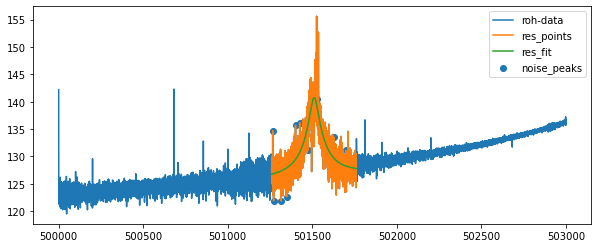

...End fiting resonator
{'A': 115240608959346.36, 'dA': 5.476264074460008e-09, 'off': 4354932068885.5996, 'doff': 1.0319723936814702e-07, 'Q': 10700.47364855602, 'dQ': 98.000222248259, 'th': 0.00033128835406908314, 'dth': 4.135561205205641e-05, 'nu_res': 501510.7632696719, 'dnu_res': 0.50359024426885, 'fit_err_chi**2_red': 3.1374285313526906}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


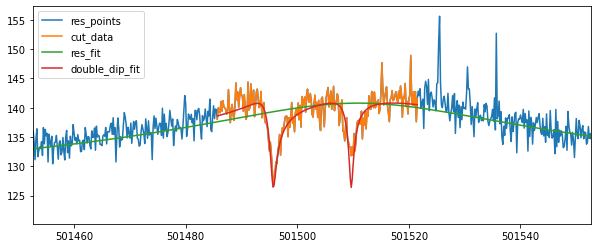

501495.7202719288 0.061618221778494034 501509.66734670685 0.05201284302222347
cycle5 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.1666666667 1232.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



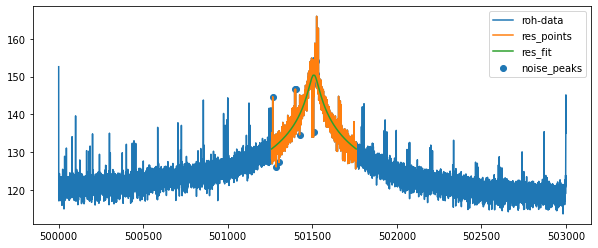

...End fiting resonator
{'A': 1114815082584199.9, 'dA': 2.26399575088532e-10, 'off': 3118.150850534298, 'doff': 7.433892865760594e-17, 'Q': 9547.378939558455, 'dQ': 48.40127665316409, 'th': 4.62778417725401e-37, 'dth': 5.222766946002135e-05, 'nu_res': 501508.97111978347, 'dnu_res': 0.5356685137258357, 'fit_err_chi**2_red': 3.306821417345094}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


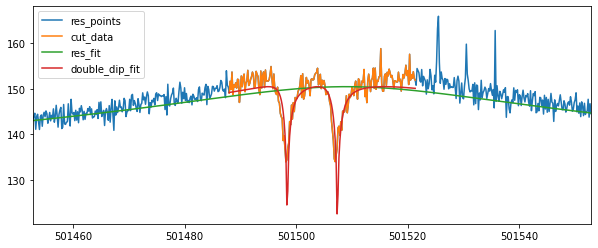

501498.40094613377 0.01854600258111453 501507.39577868494 0.017975247944067664
[501502.8311713911, 501502.7368957543]
503840.97 501502.7840335727 501495.7202719288 501509.66734670685 0.03955679015393376 0.061618221778494034 0.05201284302222347
53273922.2 501502.7840335727 501498.40094613377 501507.39577868494 0.03955679015393376 0.01854600258111453 0.017975247944067664
['cycle5', 'position_1', 3, 0.015, '20211217_212903.002019', 53775425.21269125, 0.047241966488195286, 2338.3664149370743, 0.0898158156544853, 501502.7840335727, 0.03955679015393376, 5.486261221810994, 0.21563555685042562, True, 501508.81616620073, 0.27870910062160975]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [863000039461095.5, 5624.476635512795, 124.52317810058594, -0.

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8029962194352499
...End fiting resonator
{'A': 2431150359319206.0, 'dA': 1.1064567998962402e-10, 'Q': 14596.869813186748, 'dQ': 35.96163137310917, 'nu_res': 501508.78889212094, 'dnu_res': 0.2791527208595691, 'fit_err_chi**2_red': 0.8029962194352499}
resonator fit results:  [ 2.431150359319e+15  1.459686981319e+04  5.265902502387e+11
 -2.397258902571e-04  5.015087888921e+05] [1.106456799896e-10 3.596163137311e+01 4.458691233417e-08
 8.771313730915e-06 2.791527208596e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.522214313831352
Fit is NOT GOOD !!!!!


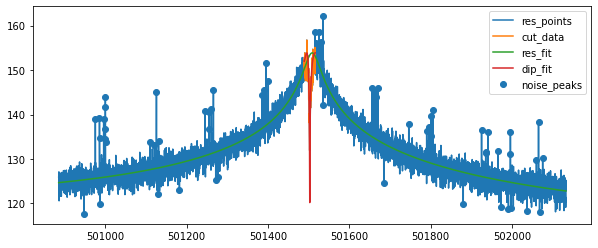

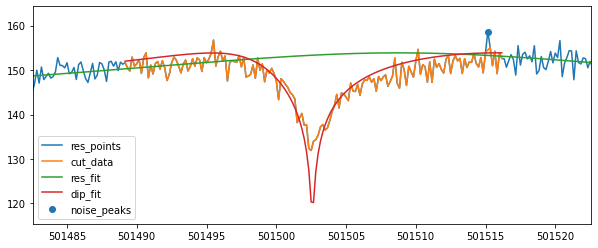

{'A': 2431150359319206.0, 'dA': 1.1064567998962402e-10, 'Q': 14596.869813186748, 'dQ': 35.96163137310917, 'nu_res': 501508.78889212094, 'dnu_res': 0.2791527208595691, 'nu_z': 501502.58433437353, 'dnu_z': 0.029307736429120435, 'dip_width': 5.587512012965266, 'ddip_width': 0.27306587870848265, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.522214313831352, 'fit_success': True}
cycle5 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [889039897674941.6, 5865.676413255361, 124.81706237792969, -0.0015606753937396861, 501515.3333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7941812225869658
...End fiting resonator
{'A': 2246424038139435.0, 'dA': 1.1500616746197305e-10, 'Q': 14210.377014979029, 'dQ': 35.42681978776193, 'nu_res': 501507.8053869634, 'dnu_res': 0.2828055697504374, 'fit_err_chi**2_red': 0.7941812225869658}
resonator fit results:  [ 2.246424038139e+15  1.421037701498e+04  5.253235278555e+11
 -2.340737080793e-04  5.015078053870e+05] [1.150061674620e-10 3.542681978776e+01 4.250985306239e-08
 9.048986544075e-06 2.828055697504e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.3781058984697556


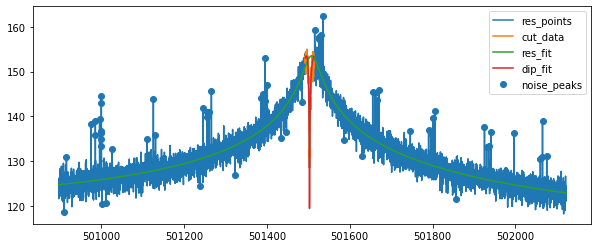

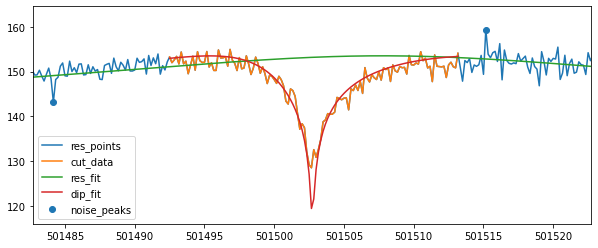

{'A': 2246424038139435.0, 'dA': 1.1500616746197305e-10, 'Q': 14210.377014979029, 'dQ': 35.42681978776193, 'nu_res': 501507.8053869634, 'dnu_res': 0.2828055697504374, 'nu_z': 501502.7301693839, 'dnu_z': 0.021513312947117797, 'dip_width': 5.161738171148237, 'ddip_width': 0.19674455527468546, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.3781058984697556, 'fit_success': True}
cycle5 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.0 446.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


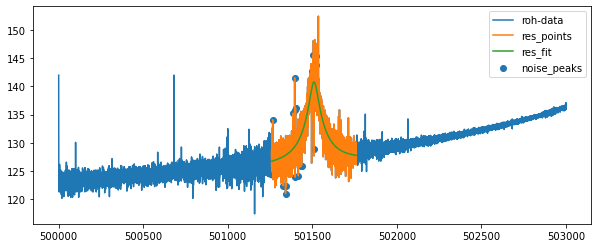

...End fiting resonator
{'A': 115648295764267.9, 'dA': 5.621417163624621e-09, 'off': 4315103083343.6396, 'doff': 1.0640120070803641e-07, 'Q': 10683.02165066123, 'dQ': 101.20423307982551, 'th': 0.00032851462618998026, 'dth': 4.302879444801967e-05, 'nu_res': 501509.91341053555, 'dnu_res': 0.5233869460439285, 'fit_err_chi**2_red': 3.101321601823437}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


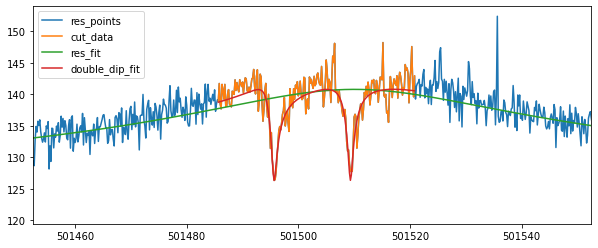

501495.67422659334 0.061637648092888686 501509.34747470065 0.05982064855613407
cycle5 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.8333333333 1229.333333333023
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



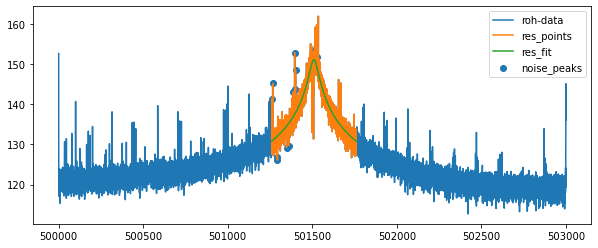

...End fiting resonator
{'A': 1293040799761716.0, 'dA': 2.2622862090944952e-10, 'off': 4594.187683652039, 'doff': 5.7889831580351036e-15, 'Q': 10346.716830899535, 'dQ': 52.138691967146755, 'th': 2.492322451531936e-13, 'dth': 5.1634105640392885e-05, 'nu_res': 501509.1528633175, 'dnu_res': 0.5057694035234414, 'fit_err_chi**2_red': 2.96215645283212}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


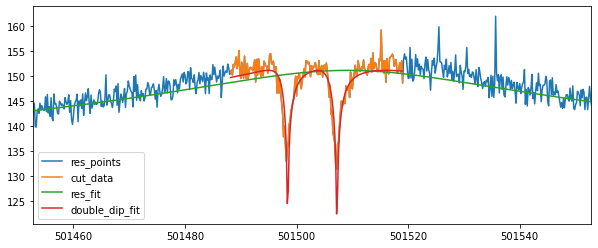

501498.40368065506 0.015400276455467755 501507.23115104024 0.014953748674674671
[501502.58433437353, 501502.7301693839]
503840.97 501502.65725187876 501495.67422659334 501509.34747470065 0.03635610056867237 0.061637648092888686 0.05982064855613407
53273922.2 501502.65725187876 501498.40368065506 501507.23115104024 0.03635610056867237 0.015400276455467755 0.014953748674674671
['cycle5', 'position_1', 3, 0.03, '20211217_215312.321929', 53775425.17757981, 0.042220245888549585, 2338.6055505847326, 0.09327097997050696, 501502.65725187876, 0.03635610056867237, 5.161738171148237, 0.19674455527468546, True, 501507.8053869634, 0.2828055697504374]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle5 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [870075289578066.4, 5720.682509504438, 124.4790267944336,

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8112657478146493
...End fiting resonator
{'A': 2427925455174754.5, 'dA': 1.132144569243409e-10, 'Q': 14688.551898592134, 'dQ': 36.50797428281565, 'nu_res': 501508.7140972543, 'dnu_res': 0.278474725270989, 'fit_err_chi**2_red': 0.8112657478146493}
resonator fit results:  [ 2.427925455175e+15  1.468855189859e+04  5.357748160592e+11
 -2.560547804453e-04  5.015087140973e+05] [1.132144569243e-10 3.650797428282e+01 4.500113955884e-08
 8.959782790851e-06 2.784747252710e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9741465227170754


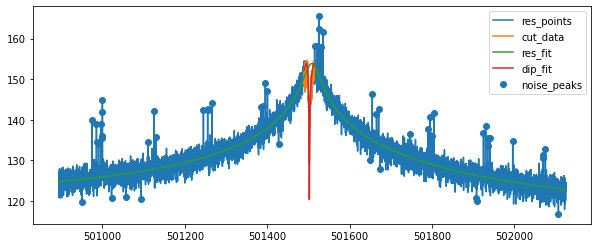

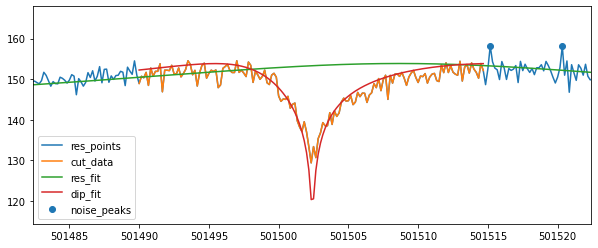

{'A': 2427925455174754.5, 'dA': 1.132144569243409e-10, 'Q': 14688.551898592134, 'dQ': 36.50797428281565, 'nu_res': 501508.7140972543, 'dnu_res': 0.278474725270989, 'nu_z': 501502.4144632632, 'dnu_z': 0.025478524521270973, 'dip_width': 5.405476404167784, 'ddip_width': 0.23727445705800748, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.9741465227170754, 'fit_success': True}
cycle5 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [880812036915822.9, 5797.8400770712915, 124.78274135900271, -0.0016431530085360758, 501513.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7925469108383394
...End fiting resonator
{'A': 2273570936223852.5, 'dA': 1.085862282552562e-10, 'Q': 14148.777638705338, 'dQ': 34.01714753674487, 'nu_res': 501508.8856441483, 'dnu_res': 0.2760759478139291, 'fit_err_chi**2_red': 0.7925469108383394}
resonator fit results:  [ 2.273570936224e+15  1.414877763871e+04  5.236897539628e+11
 -2.468970013650e-04  5.015088856441e+05] [1.085862282553e-10 3.401714753674e+01 4.070451020896e-08
 8.630094829181e-06 2.760759478139e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5454114617114068


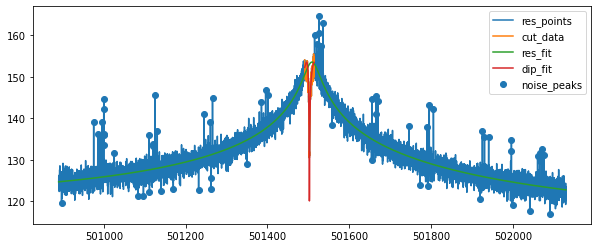

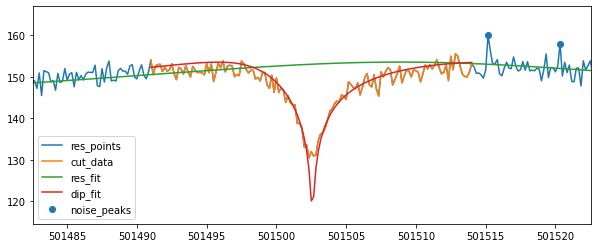

{'A': 2273570936223852.5, 'dA': 1.085862282552562e-10, 'Q': 14148.777638705338, 'dQ': 34.01714753674487, 'nu_res': 501508.8856441483, 'dnu_res': 0.2760759478139291, 'nu_z': 501502.5744455138, 'dnu_z': 0.021428883920157273, 'dip_width': 4.995637861035483, 'ddip_width': 0.19803426821538303, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.5454114617114068, 'fit_success': True}
cycle5 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 441.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



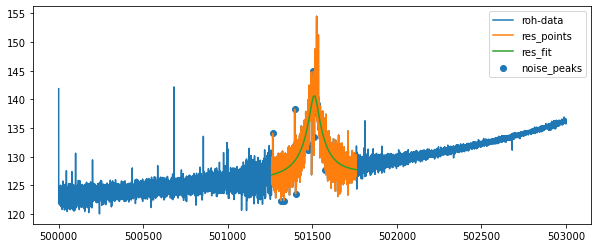

...End fiting resonator
{'A': 112924463948424.7, 'dA': 5.7237157374504765e-09, 'off': 4375176713093.309, 'doff': 1.0646104284325535e-07, 'Q': 10671.778585332926, 'dQ': 100.45292302761607, 'th': 0.0002846106488929956, 'dth': 4.215429894139696e-05, 'nu_res': 501511.13608744374, 'dnu_res': 0.5159944848239981, 'fit_err_chi**2_red': 3.107176380303837}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


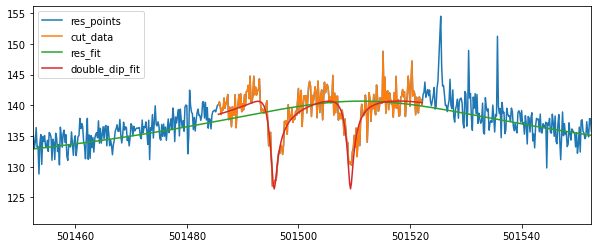

501495.64856684004 0.06241362448200434 501509.3286072493 0.05757101637093441
cycle5 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.6666666667 1229.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


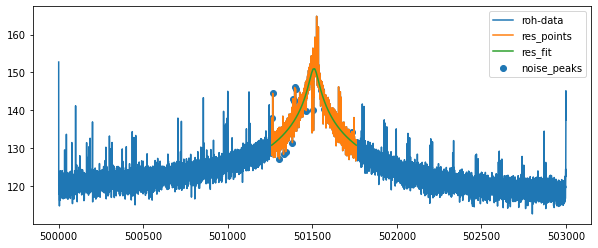

...End fiting resonator
{'A': 1283016689446425.5, 'dA': 2.204830397725997e-10, 'off': 42652.53637521155, 'doff': 1.467783220323138e-13, 'Q': 10251.45967532202, 'dQ': 50.848522799894525, 'th': 9.679785109730327e-14, 'dth': 5.085569202048337e-05, 'nu_res': 501509.67657583754, 'dnu_res': 0.5007753847935537, 'fit_err_chi**2_red': 3.095217998708641}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


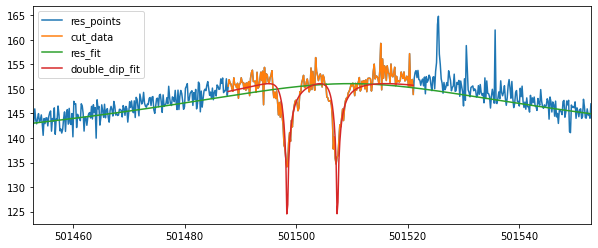

501498.40648621647 0.015613190235810828 501507.4041625314 0.015531873790830883
[501502.4144632632, 501502.5744455138]
503840.97 501502.4944543885 501495.64856684004 501509.3286072493 0.03329192511472686 0.06241362448200434 0.05757101637093441
53273922.2 501502.4944543885 501498.40648621647 501507.4041625314 0.03329192511472686 0.015613190235810828 0.015531873790830883
['cycle5', 'position_1', 3, 0.05, '20211217_213505.324497', 53775425.51619436, 0.039916952421728026, 2338.4872802991304, 0.09120435693982844, 501502.4944543885, 0.03329192511472686, 4.995637861035483, 0.19803426821538303, True, 501508.8856441483, 0.2760759478139291]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [839525335893030.6, 5501.074954298502, 124.90600110755655, -0.0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.806466565772854
...End fiting resonator
{'A': 2607141354294150.5, 'dA': 1.1289939457266507e-10, 'Q': 15239.670768735134, 'dQ': 37.70814773769344, 'nu_res': 501508.6876441063, 'dnu_res': 0.2708713419822667, 'fit_err_chi**2_red': 0.806466565772854}
resonator fit results:  [ 2.607141354294e+15  1.523967076874e+04  5.762009089959e+11
 -2.380746414298e-04  5.015086876441e+05] [1.128993945727e-10 3.770814773769e+01 4.730420050579e-08
 8.924394914911e-06 2.708713419823e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.117952146599293
Fit is NOT GOOD !!!!!


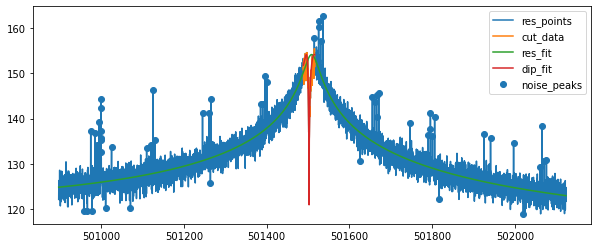

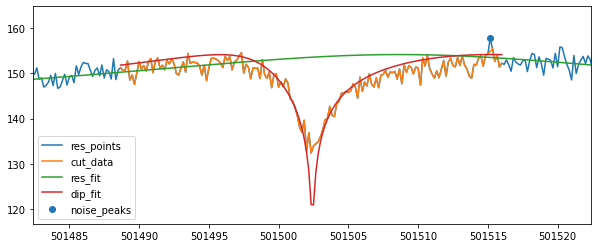

{'A': 2607141354294150.5, 'dA': 1.1289939457266507e-10, 'Q': 15239.670768735134, 'dQ': 37.70814773769344, 'nu_res': 501508.6876441063, 'dnu_res': 0.2708713419822667, 'nu_z': 501502.41645546444, 'dnu_z': 0.0255546789585022, 'dip_width': 5.181715106821188, 'ddip_width': 0.23738797144027532, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.117952146599293, 'fit_success': True}
cycle6 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [866122194481093.8, 5645.560975610989, 124.88457375111152, -0.001805174922075462, 501514.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8017356474222076
...End fiting resonator
{'A': 2571251025898557.5, 'dA': 1.0910646076706932e-10, 'Q': 15003.087035294815, 'dQ': 36.524920846257025, 'nu_res': 501508.5120769575, 'dnu_res': 0.2737407898800153, 'fit_err_chi**2_red': 0.8017356474222076}
resonator fit results:  [ 2.571251025899e+15  1.500308703529e+04  4.924501870151e+11
 -2.559685584296e-04  5.015085120770e+05] [1.091064607671e-10 3.652492084626e+01 4.733805101019e-08
 8.640740231139e-06 2.737407898800e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.767139186436196


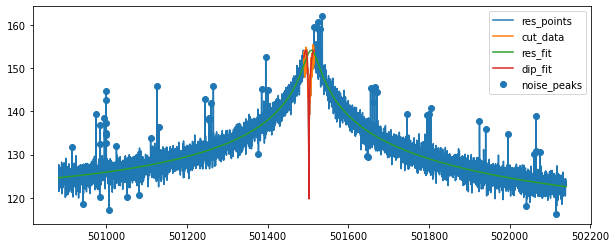

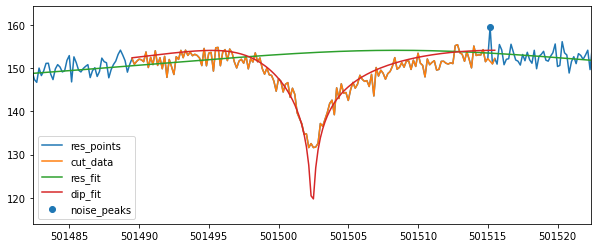

{'A': 2571251025898557.5, 'dA': 1.0910646076706932e-10, 'Q': 15003.087035294815, 'dQ': 36.524920846257025, 'nu_res': 501508.5120769575, 'dnu_res': 0.2737407898800153, 'nu_z': 501502.4227479687, 'dnu_z': 0.024099337092230503, 'dip_width': 5.7639385460012935, 'ddip_width': 0.23201716845289888, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.767139186436196, 'fit_success': True}
cycle6 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501512.3333333333 472.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


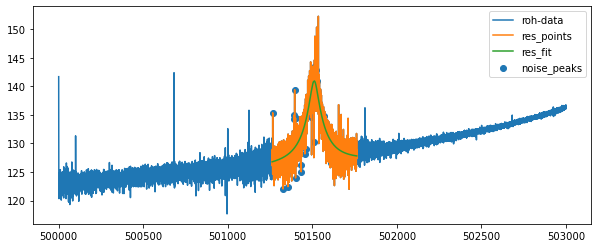

...End fiting resonator
{'A': 120419375423792.61, 'dA': 5.547827887798713e-09, 'off': 4365035255676.3604, 'doff': 1.0794655426929261e-07, 'Q': 10901.207323519257, 'dQ': 102.18075298513598, 'th': 0.000334474271684344, 'dth': 4.2580398853339004e-05, 'nu_res': 501510.9240174562, 'dnu_res': 0.5104997441228012, 'fit_err_chi**2_red': 3.0590902380342637}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


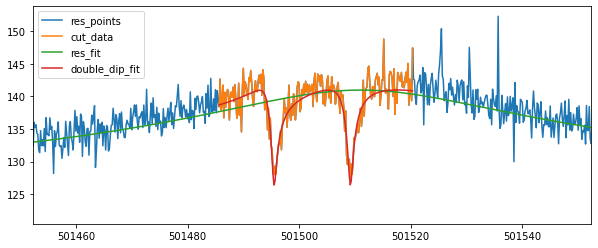

501495.53324197524 0.05894015556971667 501509.19836453005 0.0586097052178361
cycle6 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.8333333333 1273.333333333023
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



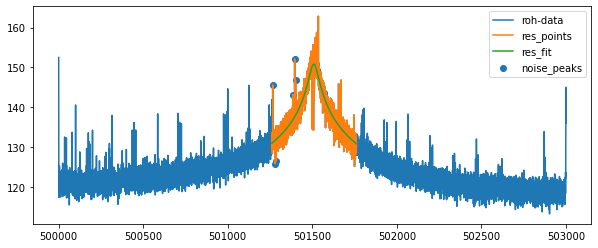

...End fiting resonator
{'A': 1215235856069293.8, 'dA': 2.2044967586962004e-10, 'off': 695956.8152930103, 'doff': 8.59959498819788e-09, 'Q': 9936.751787759022, 'dQ': 49.54226251437586, 'th': 2.1372232384793498e-10, 'dth': 5.121595869298376e-05, 'nu_res': 501508.72441065183, 'dnu_res': 0.5133733538491039, 'fit_err_chi**2_red': 3.104951690241049}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


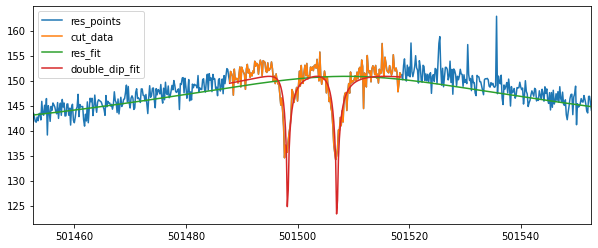

501498.23310994735 0.01655707340592132 501507.06947226153 0.016663025249101338
[501502.41645546444, 501502.4227479687]
503840.97 501502.41960171657 501495.53324197524 501509.19836453005 0.035125769243634676 0.05894015556971667 0.0586097052178361
53273922.2 501502.41960171657 501498.23310994735 501507.06947226153 0.035125769243634676 0.01655707340592132 0.016663025249101338
['cycle6', 'position_1', 3, -0.005, '20211217_225335.375712', 53775425.0829805, 0.04225651139384707, 2338.6579952112515, 0.09023779224505174, 501502.41960171657, 0.035125769243634676, 5.7639385460012935, 0.23201716845289888, True, 501508.5120769575, 0.2737407898800153]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [890427150063246.5, 5709.836812145474, 124.75244140625, 

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7913530482650051
...End fiting resonator
{'A': 2571534652636823.0, 'dA': 1.0891556357405438e-10, 'Q': 14980.087556526187, 'dQ': 36.48990360346914, 'nu_res': 501508.3413281965, 'dnu_res': 0.2699489648338703, 'fit_err_chi**2_red': 0.7913530482650051}
resonator fit results:  [ 2.571534652637e+15  1.498008755653e+04  5.346256117649e+11
 -2.224352544656e-04  5.015083413282e+05] [1.089155635741e-10 3.648990360347e+01 4.412517377147e-08
 8.929058370644e-06 2.699489648339e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.1738249014985493
Fit is NOT GOOD !!!!!


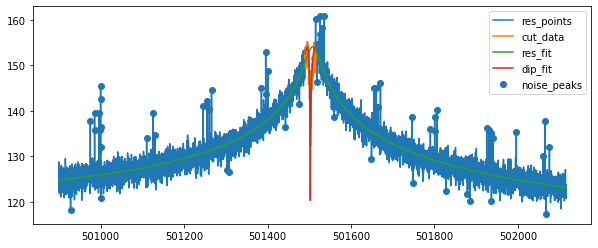

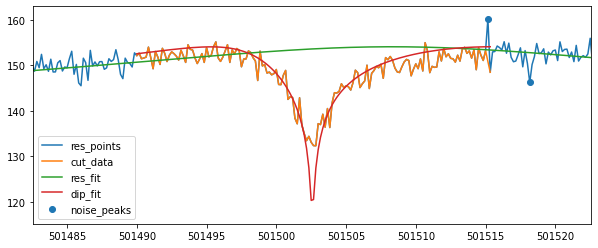

{'A': 2571534652636823.0, 'dA': 1.0891556357405438e-10, 'Q': 14980.087556526187, 'dQ': 36.48990360346914, 'nu_res': 501508.3413281965, 'dnu_res': 0.2699489648338703, 'nu_z': 501502.5811170008, 'dnu_z': 0.026687150072433496, 'dip_width': 5.66149664204681, 'ddip_width': 0.2522879619934221, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.1738249014985493, 'fit_success': True}
cycle6 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [874426001219191.2, 5699.028409090909, 124.4593734741211, -0.0016411297241393308, 501514.5]
Start fiting resonator....
chi_reduziert =  0.8074348216081099
...End fiting resonator
{'A': 2319714181502051.0, 'dA': 1.1048459163653187e-10, 'Q': 14232.571441518332, 'dQ': 35.12462701429998, 'nu_res': 501508.6397541411, 'dnu_res': 0.28463296104985886, 'fit_err_chi**2_red': 0.8074348216081099}
resonator fit results:  [ 2.319714181502e+15  1.423257144152e+04  4.856769229241e+11
 -2.504651678129e-04  5.015086397541e+05] [1.10484

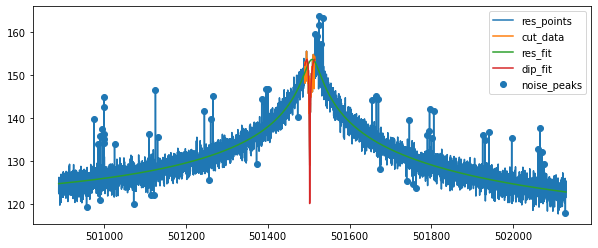

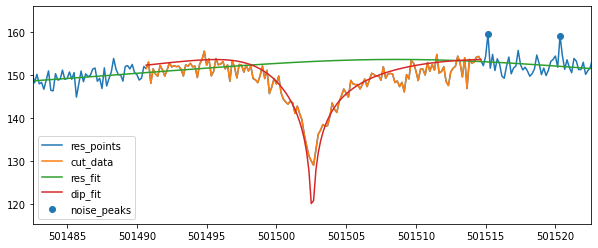

{'A': 2319714181502051.0, 'dA': 1.1048459163653187e-10, 'Q': 14232.571441518332, 'dQ': 35.12462701429998, 'nu_res': 501508.6397541411, 'dnu_res': 0.28463296104985886, 'nu_z': 501502.57692867244, 'dnu_z': 0.022583739427336207, 'dip_width': 5.115169368342044, 'ddip_width': 0.214149392071988, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.6871248399283512, 'fit_success': True}
cycle6 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 448.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



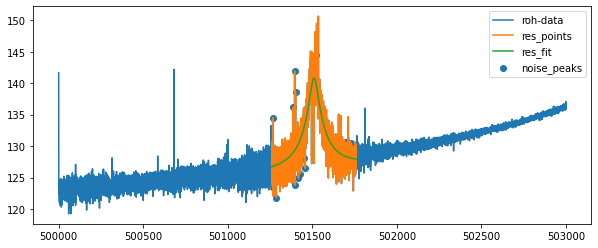

...End fiting resonator
{'A': 117430480547156.4, 'dA': 5.555418560212423e-09, 'off': 4371458062108.056, 'doff': 1.0566810862155358e-07, 'Q': 10739.940689727517, 'dQ': 101.05269905387905, 'th': 0.0003878539943962204, 'dth': 4.264621274385388e-05, 'nu_res': 501509.95356492273, 'dnu_res': 0.5171489031119965, 'fit_err_chi**2_red': 3.0148703527338645}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


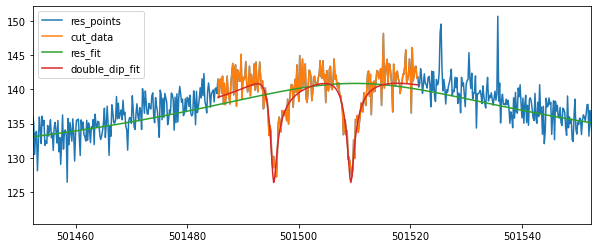

501495.52879249654 0.06091047858579413 501509.32681128447 0.06408729265817391
cycle6 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.1666666667 1252.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



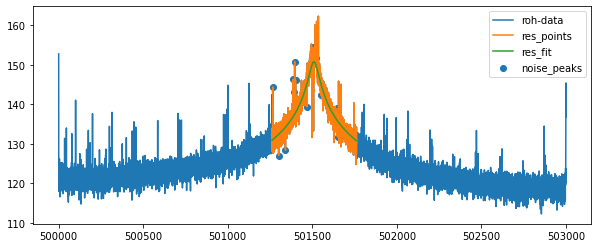

...End fiting resonator
{'A': 1209412054915201.2, 'dA': 2.1858664383012137e-10, 'off': 162.57660207193112, 'doff': 0.0, 'Q': 9944.52903475329, 'dQ': 48.85367313688403, 'th': 2.2484844584074616e-15, 'dth': 5.046438218143164e-05, 'nu_res': 501509.40097934136, 'dnu_res': 0.5056163652476736, 'fit_err_chi**2_red': 2.8955755792187112}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


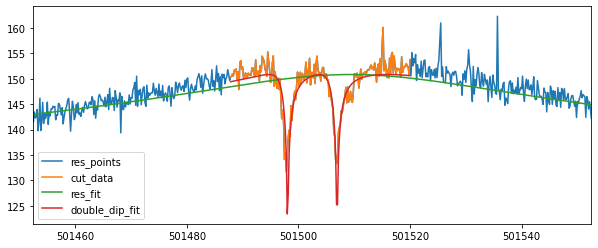

501498.06403467094 0.015598425300620665 501506.91578916693 0.016236619833777558
[501502.5811170008, 501502.57692867244]
503840.97 501502.57902283664 501495.52879249654 501509.32681128447 0.03496039567153677 0.06091047858579413 0.06408729265817391
53273922.2 501502.57902283664 501498.06403467094 501506.91578916693 0.03496039567153677 0.015598425300620665 0.016236619833777558
['cycle6', 'position_1', 3, -0.02, '20211217_222323.808116', 53775424.600801, 0.04158326539602281, 2338.693419055606, 0.09507626805525826, 501502.57902283664, 0.03496039567153677, 5.115169368342044, 0.214149392071988, True, 501508.6397541411, 0.28463296104985886]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [879606573134685.6, 5720.733840302916, 124.67147827148438, -0

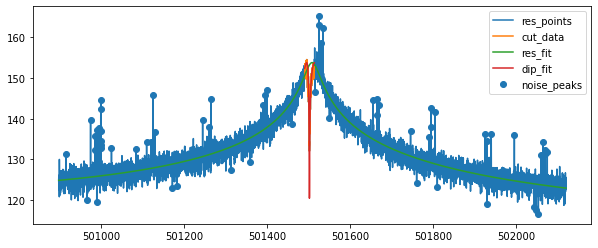

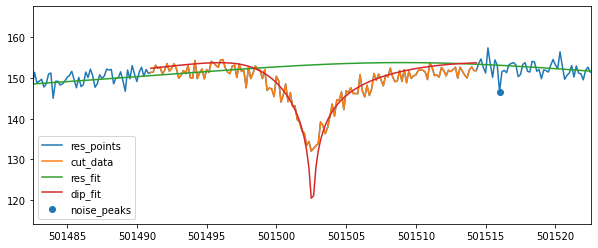

{'A': 2404205389288614.5, 'dA': 1.1440892926056137e-10, 'Q': 14602.06647578172, 'dQ': 36.73815073557207, 'nu_res': 501509.06792050315, 'dnu_res': 0.2816582816375859, 'nu_z': 501502.5772647209, 'dnu_z': 0.02413085349821103, 'dip_width': 5.1155713563718095, 'ddip_width': 0.2224133999394734, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.8033536317325576, 'fit_success': True}
cycle6 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [920141721839562.2, 5854.231517508401, 124.6940689086914, -0.0016693925567376092, 501512.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.798757752071461
...End fiting resonator
{'A': 2235181701853553.0, 'dA': 1.0931642395694164e-10, 'Q': 13970.592470576665, 'dQ': 34.08572025635535, 'nu_res': 501508.8601058449, 'dnu_res': 0.28256581688777754, 'fit_err_chi**2_red': 0.798757752071461}
resonator fit results:  [ 2.235181701854e+15  1.397059247058e+04  4.739032962848e+11
 -2.591861422254e-04  5.015088601058e+05] [1.093164239569e-10 3.408572025636e+01 3.925641057886e-08
 9.017742384657e-06 2.825658168878e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7783364163305264


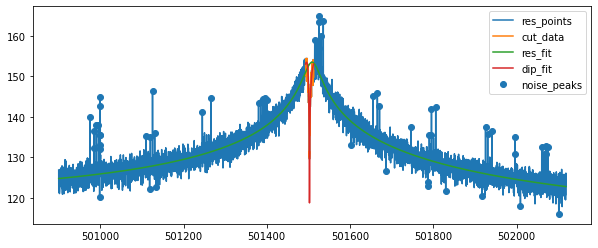

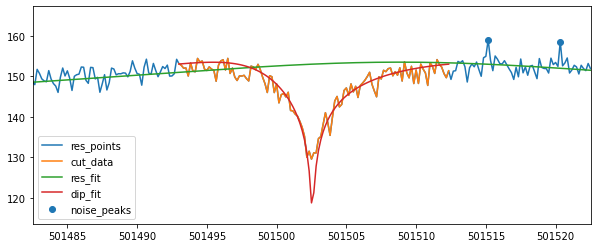

{'A': 2235181701853553.0, 'dA': 1.0931642395694164e-10, 'Q': 13970.592470576665, 'dQ': 34.08572025635535, 'nu_res': 501508.8601058449, 'dnu_res': 0.28256581688777754, 'nu_z': 501502.5603090704, 'dnu_z': 0.023817948298149715, 'dip_width': 5.317672395519674, 'ddip_width': 0.22341150980095753, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.7783364163305264, 'fit_success': True}
cycle6 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 456.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


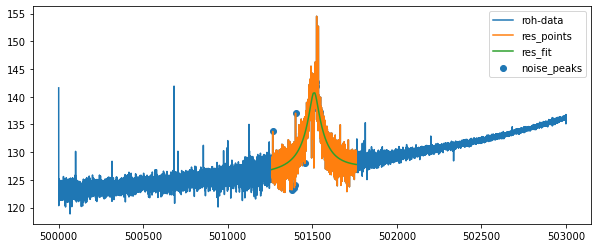

...End fiting resonator
{'A': 115993086015309.06, 'dA': 5.7402418063775995e-09, 'off': 4408664449350.108, 'doff': 1.0838841054735508e-07, 'Q': 10766.266019580497, 'dQ': 102.73764238632978, 'th': 0.0002881898115316505, 'dth': 4.285398528478814e-05, 'nu_res': 501510.46494952205, 'dnu_res': 0.5206829455032087, 'fit_err_chi**2_red': 3.1499985106130994}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


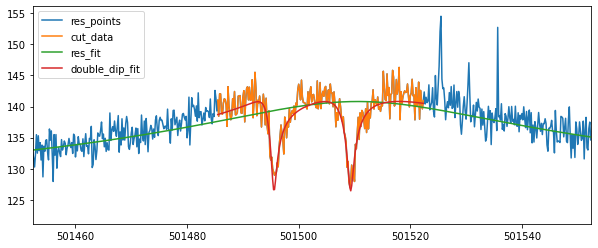

501495.5789413842 0.05803164924809706 501509.31029364094 0.061664593588310244
cycle6 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.0 1249.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



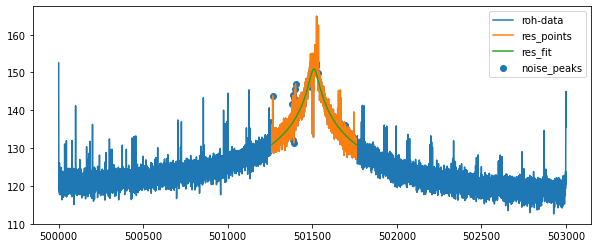

...End fiting resonator
{'A': 1246738238356608.8, 'dA': 2.2167524624019385e-10, 'off': 8771.226910602534, 'doff': 0.0, 'Q': 10030.127671258324, 'dQ': 50.67670516594127, 'th': 2.678259547293613e-14, 'dth': 5.187634036240697e-05, 'nu_res': 501509.4644895754, 'dnu_res': 0.517227534620087, 'fit_err_chi**2_red': 3.0446364834010753}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


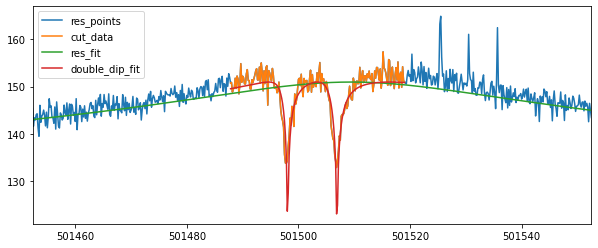

501498.0641533705 0.016106301210133223 501506.9068343875 0.016605930542927645
[501502.5772647209, 501502.5603090704]
503840.97 501502.56878689566 501495.5789413842 501509.31029364094 0.03390564483512231 0.05803164924809706 0.061664593588310244
53273922.2 501502.56878689566 501498.0641533705 501506.9068343875 0.03390564483512231 0.016106301210133223 0.016605930542927645
['cycle6', 'position_1', 3, -0.04, '20211217_222926.133652', 53775424.602200866, 0.04104585995631633, 2338.649551870418, 0.09121286734091355, 501502.56878689566, 0.03390564483512231, 5.317672395519674, 0.22341150980095753, True, 501508.8601058449, 0.28256581688777754]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [936958198251961.1, 5842.873786405125, 125.02015686035156, -0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8043062444856633
...End fiting resonator
{'A': 2542101493470552.5, 'dA': 1.116786954663224e-10, 'Q': 14891.780266584294, 'dQ': 37.206003073507205, 'nu_res': 501509.07609072054, 'dnu_res': 0.2782915423981756, 'fit_err_chi**2_red': 0.8043062444856633}
resonator fit results:  [ 2.542101493471e+15  1.489178026658e+04  4.822395188881e+11
 -2.658764976942e-04  5.015090760907e+05] [1.116786954663e-10 3.720600307351e+01 4.436647278994e-08
 9.353031491361e-06 2.782915423982e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.237727842724692
Fit is NOT GOOD !!!!!


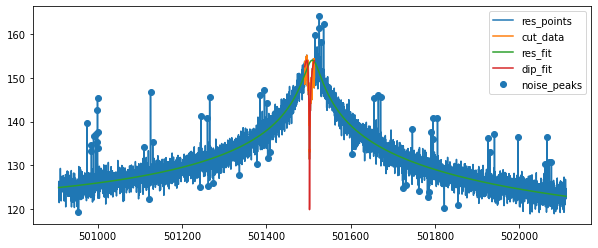

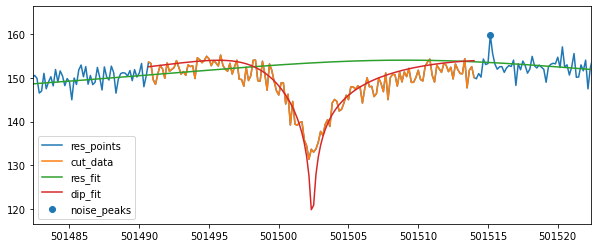

{'A': 2542101493470552.5, 'dA': 1.116786954663224e-10, 'Q': 14891.780266584294, 'dQ': 37.206003073507205, 'nu_res': 501509.07609072054, 'dnu_res': 0.2782915423981756, 'nu_z': 501502.40760864684, 'dnu_z': 0.026072650215299687, 'dip_width': 5.362522889790875, 'ddip_width': 0.25369983254598694, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.237727842724692, 'fit_success': True}
cycle6 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [841219984523254.0, 5531.404411763522, 124.81835821031959, -0.0015918201114070284, 501514.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8113203752476723
...End fiting resonator
{'A': 2268552140725500.0, 'dA': 1.1120189726964965e-10, 'Q': 14104.708461183654, 'dQ': 34.867350848282996, 'nu_res': 501508.8985272278, 'dnu_res': 0.28467335008949984, 'fit_err_chi**2_red': 0.8113203752476723}
resonator fit results:  [ 2.268552140726e+15  1.410470846118e+04  5.529399944574e+11
 -2.324209729883e-04  5.015088985272e+05] [1.112018972696e-10 3.486735084828e+01 4.190745870977e-08
 8.731908870573e-06 2.846733500895e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.1466164558095335
Fit is NOT GOOD !!!!!


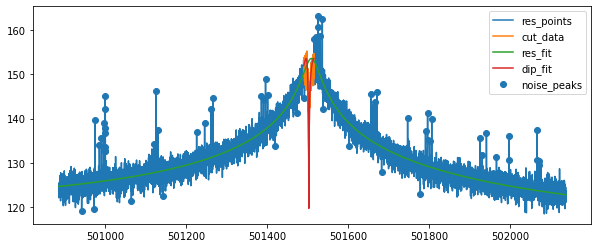

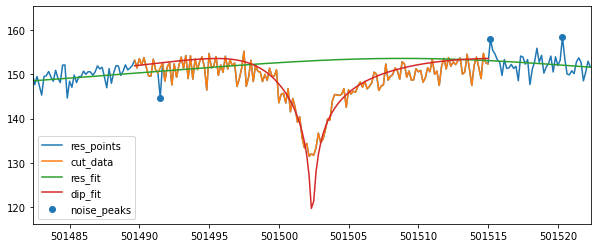

{'A': 2268552140725500.0, 'dA': 1.1120189726964965e-10, 'Q': 14104.708461183654, 'dQ': 34.867350848282996, 'nu_res': 501508.8985272278, 'dnu_res': 0.28467335008949984, 'nu_z': 501502.40127973515, 'dnu_z': 0.026787951694966193, 'dip_width': 5.186751748290865, 'ddip_width': 0.2415656755753126, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.1466164558095335, 'fit_success': True}
cycle6 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.5 452.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



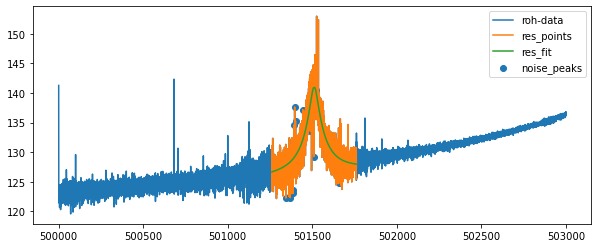

...End fiting resonator
{'A': 122103701662465.23, 'dA': 5.47001081452596e-09, 'off': 4400421169603.267, 'doff': 1.0786644818777483e-07, 'Q': 11058.821106839323, 'dQ': 100.7838269755194, 'th': 0.00041677507956278305, 'dth': 4.11726283297463e-05, 'nu_res': 501510.8973147688, 'dnu_res': 0.4896065825932248, 'fit_err_chi**2_red': 3.0440415777305323}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


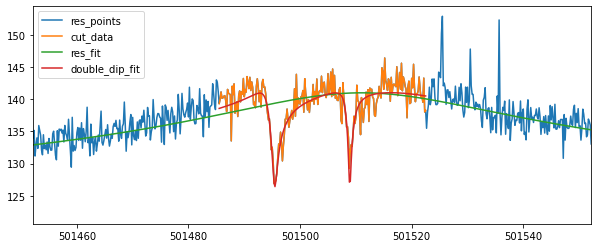

501495.4737479193 0.05930765387729047 501508.91053107 0.04169007226367955
cycle6 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.1666666667 1244.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



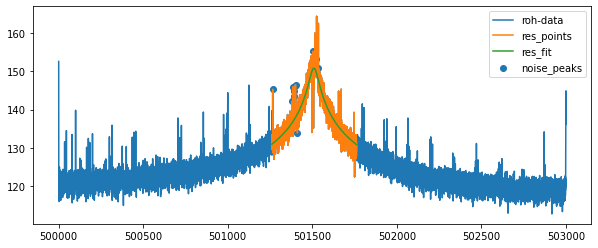

...End fiting resonator
{'A': 1223646193940721.0, 'dA': 2.1873941214500234e-10, 'off': 1924.1203719894984, 'doff': 5.488895847887248e-15, 'Q': 9950.313032977334, 'dQ': 49.436936085230755, 'th': 1.848068952275235e-12, 'dth': 5.1034463833341635e-05, 'nu_res': 501509.29093398707, 'dnu_res': 0.511157220788467, 'fit_err_chi**2_red': 3.0832191287526998}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


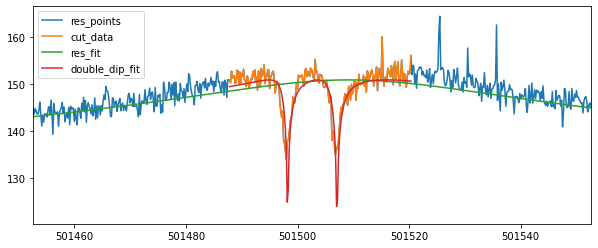

501498.2369619296 0.017122065683797497 501507.075539604 0.01724910340972914
[501502.40760864684, 501502.40127973515]
503840.97 501502.404444191 501495.4737479193 501508.91053107 0.037381512078314985 0.05930765387729047 0.04169007226367955
53273922.2 501502.404444191 501498.2369619296 501507.075539604 0.037381512078314985 0.017122065683797497 0.01724910340972914
['cycle6', 'position_1', 3, 0.002, '20211217_220516.926890', 53775425.10805735, 0.044587825098125325, 2338.990165201656, 0.08156492738328477, 501502.404444191, 0.037381512078314985, 5.186751748290865, 0.2415656755753126, True, 501508.8985272278, 0.28467335008949984]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [913467575036504.6, 5809.027027024416, 124.7987889724566, -0.0018061040

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8193020348188345
...End fiting resonator
{'A': 2352209182789688.5, 'dA': 1.1346239681623122e-10, 'Q': 14358.914138104074, 'dQ': 36.25287018373027, 'nu_res': 501508.44988069765, 'dnu_res': 0.2883125275108751, 'fit_err_chi**2_red': 0.8193020348188345}
resonator fit results:  [ 2.352209182790e+15  1.435891413810e+04  5.220251323107e+11
 -2.564202977433e-04  5.015084498807e+05] [1.134623968162e-10 3.625287018373e+01 4.446171685740e-08
 8.975515701406e-06 2.883125275109e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.3595687684542352


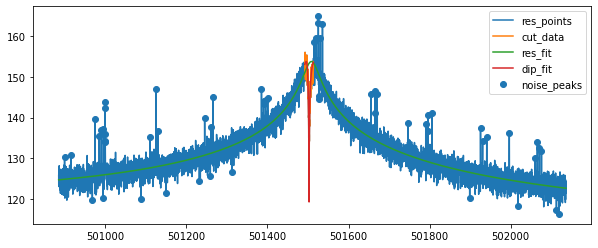

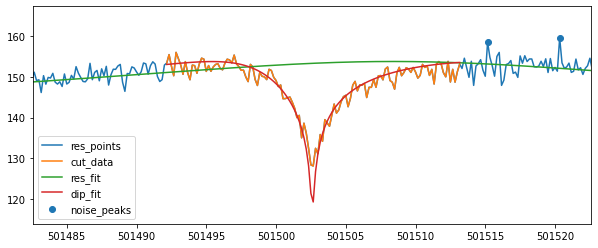

{'A': 2352209182789688.5, 'dA': 1.1346239681623122e-10, 'Q': 14358.914138104074, 'dQ': 36.25287018373027, 'nu_res': 501508.44988069765, 'dnu_res': 0.2883125275108751, 'nu_z': 501502.60230653564, 'dnu_z': 0.021913142366447355, 'dip_width': 5.3645883478692555, 'ddip_width': 0.20104196004026934, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.3595687684542352, 'fit_success': True}
cycle6 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [852163614768059.4, 5572.388888888889, 124.87533569335938, -0.0016249355668621508, 501515.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7919863015745296
...End fiting resonator
{'A': 2431119071201021.5, 'dA': 1.1255106738237735e-10, 'Q': 14693.382990266407, 'dQ': 36.315061380496395, 'nu_res': 501509.0304140154, 'dnu_res': 0.27434890099868575, 'fit_err_chi**2_red': 0.7919863015745296}
resonator fit results:  [ 2.431119071201e+15  1.469338299027e+04  5.937947495981e+11
 -2.533218645551e-04  5.015090304140e+05] [1.125510673824e-10 3.631506138050e+01 4.338269807668e-08
 8.949665928800e-06 2.743489009987e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6673320741359228


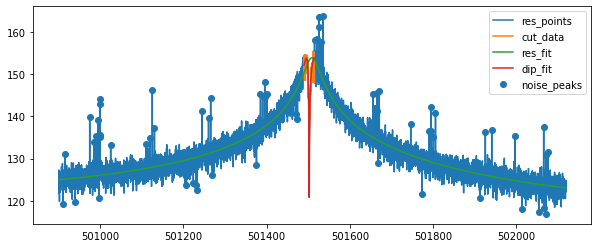

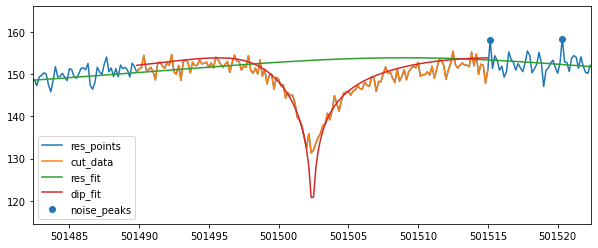

{'A': 2431119071201021.5, 'dA': 1.1255106738237735e-10, 'Q': 14693.382990266407, 'dQ': 36.315061380496395, 'nu_res': 501509.0304140154, 'dnu_res': 0.27434890099868575, 'nu_z': 501502.4156420751, 'dnu_z': 0.023616972911961832, 'dip_width': 5.262368657223867, 'ddip_width': 0.2136555414761333, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.6673320741359228, 'fit_success': True}
cycle6 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.6666666667 456.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


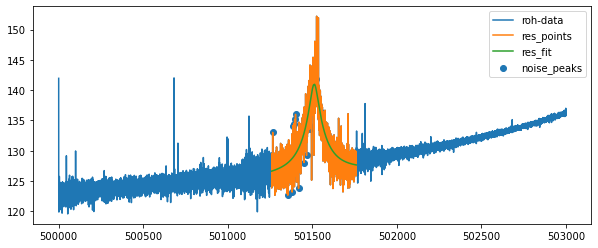

...End fiting resonator
{'A': 121966321145937.03, 'dA': 5.203418088376888e-09, 'off': 4137545750915.6187, 'doff': 1.0325193158098966e-07, 'Q': 10759.979782823686, 'dQ': 98.75145951047199, 'th': 0.00031989228407583355, 'dth': 4.307967252462323e-05, 'nu_res': 501511.0008549523, 'dnu_res': 0.5149031313139205, 'fit_err_chi**2_red': 3.1052799738281855}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


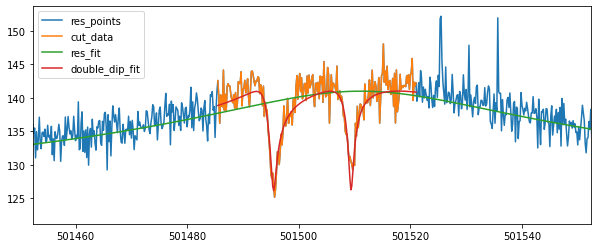

501495.4836225454 0.06369126645871122 501509.377758154 0.05622920513240672
cycle6 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501508.1666666667 1212.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


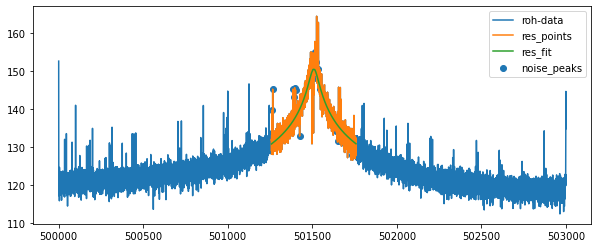

...End fiting resonator
{'A': 1157313035933335.5, 'dA': 2.2517095061641044e-10, 'off': 108961.65470055201, 'doff': 7.2334263653829335e-09, 'Q': 9672.264872819334, 'dQ': 49.38822625743799, 'th': 5.582656404425581e-31, 'dth': 5.2556388120931305e-05, 'nu_res': 501508.8929013091, 'dnu_res': 0.5350274552200985, 'fit_err_chi**2_red': 3.258736258636377}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


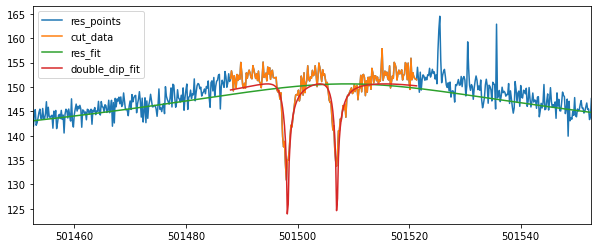

501498.2395920963 0.01668060471204444 501507.0704033542 0.01661332363783923
[501502.60230653564, 501502.4156420751]
503840.97 501502.50897430535 501495.4836225454 501509.377758154 0.03221718823697265 0.06369126645871122 0.05622920513240672
53273922.2 501502.50897430535 501498.2395920963 501507.0704033542 0.03221718823697265 0.01668060471204444 0.01661332363783923
['cycle6', 'position_1', 3, 0.005, '20211217_223528.394862', 53775425.00102115, 0.03990228456807449, 2338.6175936059444, 0.09086389905145693, 501502.50897430535, 0.03221718823697265, 5.262368657223867, 0.2136555414761333, True, 501509.0304140154, 0.27434890099868575]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [922838240159874.4, 5900.180392156863, 124.56163024902344, -0.001394

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8160302994302658
...End fiting resonator
{'A': 2355788502085950.5, 'dA': 1.0712968028076166e-10, 'Q': 14237.562087342085, 'dQ': 34.56208422125179, 'nu_res': 501508.99652420223, 'dnu_res': 0.2781239902843355, 'fit_err_chi**2_red': 0.8160302994302658}
resonator fit results:  [ 2.355788502086e+15  1.423756208734e+04  4.754114541141e+11
 -2.310465175982e-04  5.015089965242e+05] [1.071296802808e-10 3.456208422125e+01 4.053990006843e-08
 8.889418941030e-06 2.781239902843e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.972481564209916


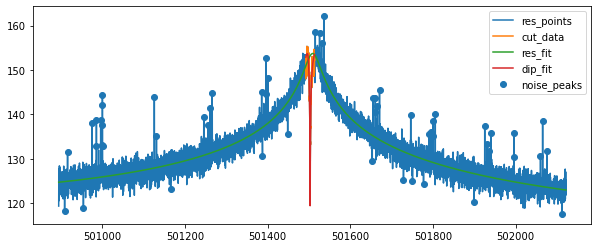

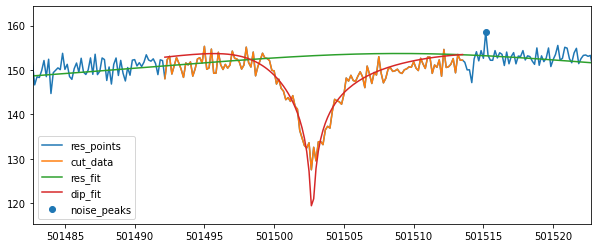

{'A': 2355788502085950.5, 'dA': 1.0712968028076166e-10, 'Q': 14237.562087342085, 'dQ': 34.56208422125179, 'nu_res': 501508.99652420223, 'dnu_res': 0.2781239902843355, 'nu_z': 501502.735748262, 'dnu_z': 0.02426019275275907, 'dip_width': 5.335507464163413, 'ddip_width': 0.23223163517031217, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.972481564209916, 'fit_success': True}
cycle6 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [855240779595628.5, 5656.148496239363, 124.57893371582031, -0.0014753959377980055, 501511.8333333333]
Start fiting resonator....
chi_reduziert =  0.8020059049343657
...End fiting resonator
{'A': 2299420493552873.5, 'dA': 1.0887839159635895e-10, 'Q': 14113.127679092757, 'dQ': 34.57867853683644, 'nu_res': 501508.29983519384, 'dnu_res': 0.2820546076068535, 'fit_err_chi**2_red': 0.8020059049343657}
resonator fit results:  [ 2.299420493553e+15  1.411312767909e+04  4.916166569987e+11
 -2.367551743262e-04  5.015082998352e+05

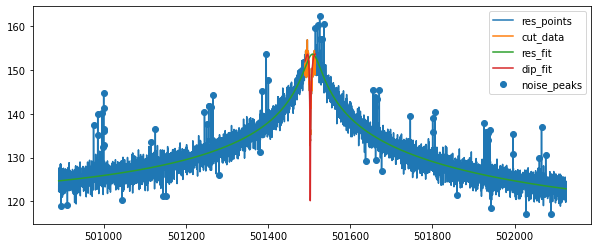

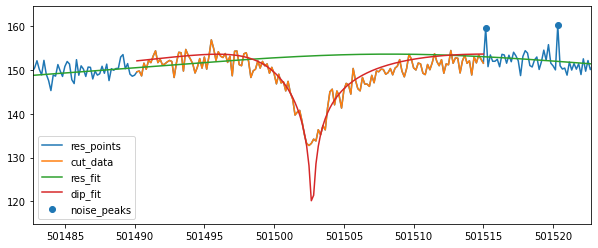

{'A': 2299420493552873.5, 'dA': 1.0887839159635895e-10, 'Q': 14113.127679092757, 'dQ': 34.57867853683644, 'nu_res': 501508.29983519384, 'dnu_res': 0.2820546076068535, 'nu_z': 501502.7394376676, 'dnu_z': 0.02319462774520554, 'dip_width': 4.725516825005298, 'ddip_width': 0.218392663113331, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.9388189620546614, 'fit_success': True}
cycle6 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.3333333333 456.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



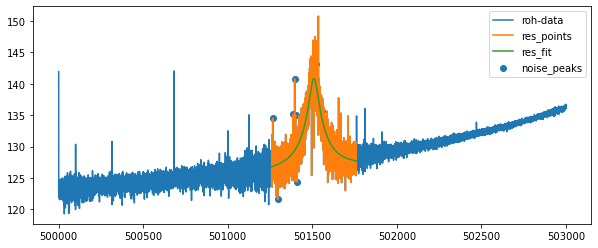

...End fiting resonator
{'A': 118636721439246.31, 'dA': 5.431280778129106e-09, 'off': 4303526210638.4165, 'doff': 1.04301040542738e-07, 'Q': 10712.44953993953, 'dQ': 100.23542713615635, 'th': 0.0002967728947183923, 'dth': 4.290596115546627e-05, 'nu_res': 501509.2945748382, 'dnu_res': 0.5189865744732429, 'fit_err_chi**2_red': 3.1887255482743}
Start fiting double dip....
Fit is NOT GOOD !!!!!


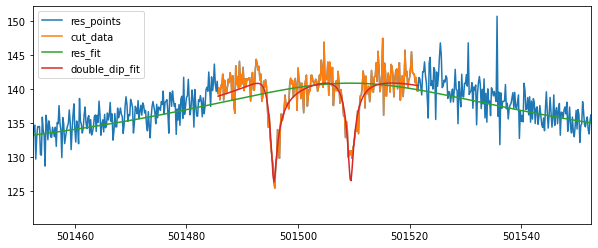

501495.68162094866 0.056787709099909905 501509.43318635726 0.055258910536172205
cycle6 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.5 1274.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


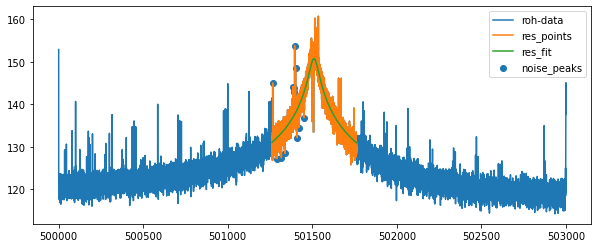

...End fiting resonator
{'A': 1201673367454224.0, 'dA': 2.1366586416578174e-10, 'off': 87567.1175526217, 'doff': 5.476756249085579e-09, 'Q': 9764.990527731406, 'dQ': 48.24076094676806, 'th': 3.7891631548881824e-12, 'dth': 5.080943472003506e-05, 'nu_res': 501509.6567074228, 'dnu_res': 0.5144137522891068, 'fit_err_chi**2_red': 3.0194765746114856}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


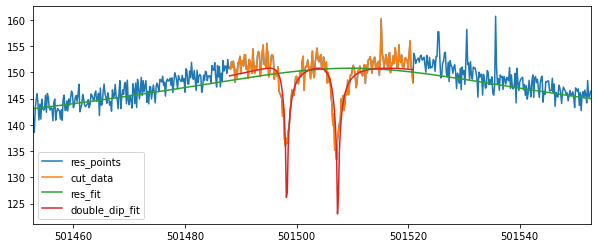

501498.24394771183 0.017278849449428355 501507.3983367203 0.016563786229755306
[501502.735748262, 501502.7394376676]
503840.97 501502.7375929648 501495.68162094866 501509.43318635726 0.03356408361090292 0.056787709099909905 0.055258910536172205
53273922.2 501502.7375929648 501498.24394771183 501507.3983367203 0.03356408361090292 0.017278849449428355 0.016563786229755306
['cycle6', 'position_1', 3, 0.008, '20211217_221721.505885', 53775425.104691476, 0.04122457229857848, 2338.5927856588387, 0.08605195411552462, 501502.7375929648, 0.03356408361090292, 4.725516825005298, 0.218392663113331, True, 501508.29983519384, 0.2820546076068535]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [885013861763651.8, 5720.697718629913, 124.69207000732422, -0.

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8095448333815217
...End fiting resonator
{'A': 2383601874858038.0, 'dA': 1.1167420824029225e-10, 'Q': 14521.926914146956, 'dQ': 35.741893516835155, 'nu_res': 501508.60812405427, 'dnu_res': 0.27679399910130853, 'fit_err_chi**2_red': 0.8095448333815217}
resonator fit results:  [ 2.383601874858e+15  1.452192691415e+04  5.198075885352e+11
 -2.436134828666e-04  5.015086081241e+05] [1.116742082403e-10 3.574189351684e+01 4.235483593964e-08
 9.075665352862e-06 2.767939991013e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5076208553166324


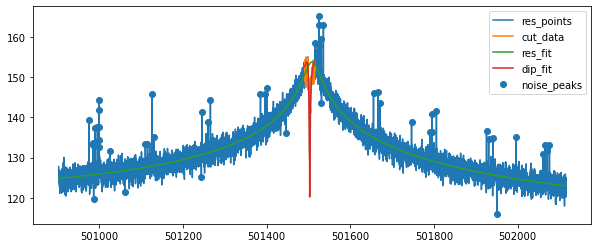

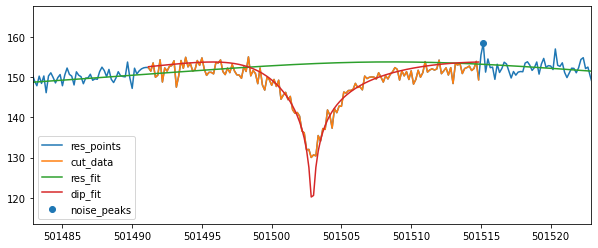

{'A': 2383601874858038.0, 'dA': 1.1167420824029225e-10, 'Q': 14521.926914146956, 'dQ': 35.741893516835155, 'nu_res': 501508.60812405427, 'dnu_res': 0.27679399910130853, 'nu_z': 501502.9126975847, 'dnu_z': 0.021796031437296998, 'dip_width': 5.358447249017076, 'ddip_width': 0.2042070500069264, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 1.5076208553166324, 'fit_success': True}
cycle6 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [907211800379847.6, 5775.587332055034, 124.85555833732366, -0.0015472125846647043, 501513.5]
Start fiting resonator....
chi_reduziert =  0.8080132680617312
...End fiting resonator
{'A': 2380868582028173.0, 'dA': 1.0909749489021346e-10, 'Q': 14410.850675358892, 'dQ': 35.15312480149677, 'nu_res': 501508.10741422256, 'dnu_res': 0.2774369137564393, 'fit_err_chi**2_red': 0.8080132680617312}
resonator fit results:  [ 2.380868582028e+15  1.441085067536e+04  5.038483746647e+11
 -2.408515988687e-04  5.015081074142e+05] [1.090974948

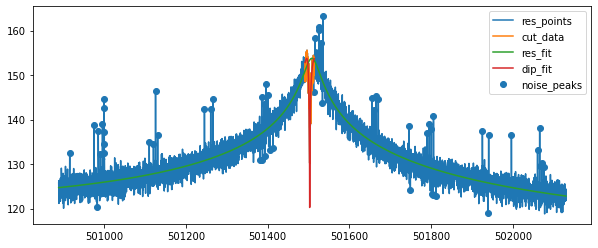

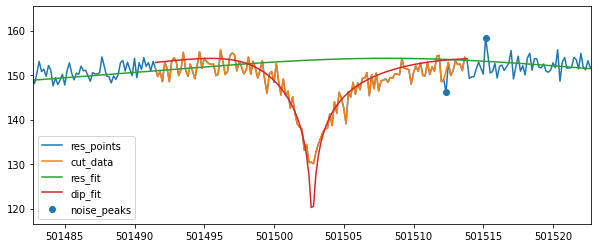

{'A': 2380868582028173.0, 'dA': 1.0909749489021346e-10, 'Q': 14410.850675358892, 'dQ': 35.15312480149677, 'nu_res': 501508.10741422256, 'dnu_res': 0.2774369137564393, 'nu_z': 501502.7472124637, 'dnu_z': 0.024392495133122343, 'dip_width': 5.30302549224068, 'ddip_width': 0.230978010620327, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.9298122451554163, 'fit_success': True}
cycle6 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501508.0 437.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


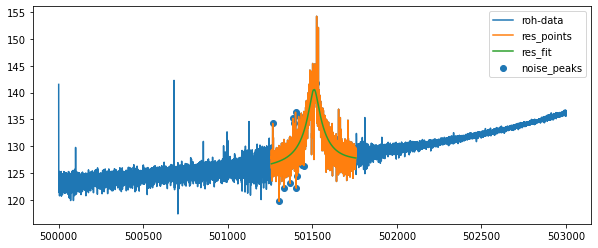

...End fiting resonator
{'A': 111294037626123.66, 'dA': 5.605497345409969e-09, 'off': 4335748820119.2983, 'doff': 1.0265122934604837e-07, 'Q': 10484.253551047812, 'dQ': 98.60527685499177, 'th': 0.0003333355570385542, 'dth': 4.243004779029045e-05, 'nu_res': 501510.1514811925, 'dnu_res': 0.5244663216229335, 'fit_err_chi**2_red': 3.0364754552277002}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


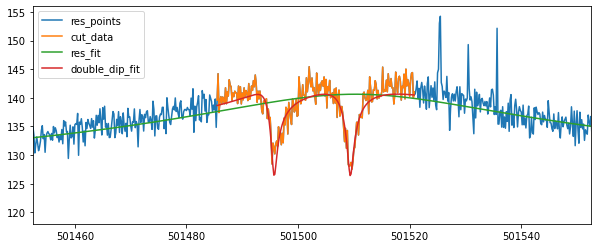

501495.73408917326 0.059544049393231706 501509.3818036019 0.06280780809108902
cycle6 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.1666666667 1232.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


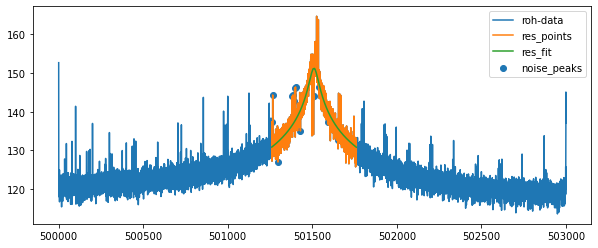

...End fiting resonator
{'A': 1340611484971339.0, 'dA': 2.2051449811553275e-10, 'off': 1798.306204004155, 'doff': 5.761289331871669e-15, 'Q': 10521.663071517563, 'dQ': 51.88946964374784, 'th': 1.2033287986984915e-13, 'dth': 5.0478722004251836e-05, 'nu_res': 501509.5799969092, 'dnu_res': 0.4897631887852025, 'fit_err_chi**2_red': 3.043044299698282}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


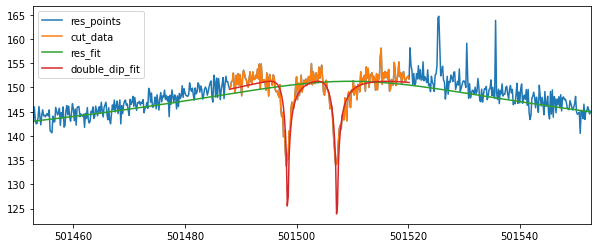

501498.40649065597 0.015190276021404003 501507.24013515783 0.015121504163810863
[501502.9126975847, 501502.7472124637]
503840.97 501502.8299550242 501495.73408917326 501509.3818036019 0.032711783889525746 0.059544049393231706 0.06280780809108902
53273922.2 501502.8299550242 501498.40649065597 501507.24013515783 0.032711783889525746 0.015190276021404003 0.015121504163810863
['cycle6', 'position_1', 3, 0.015, '20211217_224733.085687', 53775425.016670786, 0.0391083773508647, 2338.684062248969, 0.09252229666726676, 501502.8299550242, 0.032711783889525746, 5.30302549224068, 0.230978010620327, True, 501508.10741422256, 0.2774369137564393]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [867709956832886.4, 5656.167293231845, 124.7601089477539, -0.0

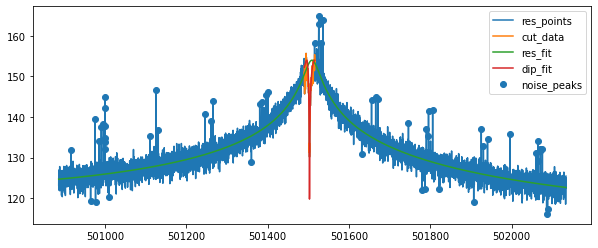

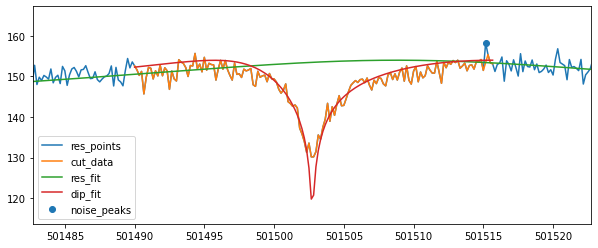

{'A': 2493603242442738.0, 'dA': 1.0891522262536227e-10, 'Q': 14796.848106113977, 'dQ': 35.84236961348177, 'nu_res': 501508.8539427007, 'dnu_res': 0.2744794192841566, 'nu_z': 501502.7411012475, 'dnu_z': 0.02322159081696791, 'dip_width': 5.436914327501377, 'ddip_width': 0.2245980483084781, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.7868268907046272, 'fit_success': True}
cycle6 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [862163497676720.4, 5688.268431004394, 124.45805358886719, -0.0016414208985367374, 501515.6666666667]
Start fiting resonator....
chi_reduziert =  0.8058556185553966
...End fiting resonator
{'A': 2371211188517387.0, 'dA': 1.0699542916737376e-10, 'Q': 14405.403949483987, 'dQ': 34.37115629242905, 'nu_res': 501508.8768856613, 'dnu_res': 0.2745591606961821, 'fit_err_chi**2_red': 0.8058556185553966}
resonator fit results:  [ 2.371211188517e+15  1.440540394948e+04  4.919846369693e+11
 -2.323891832503e-04  5.015088768857e+05] 

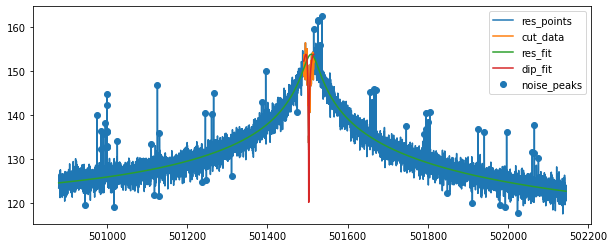

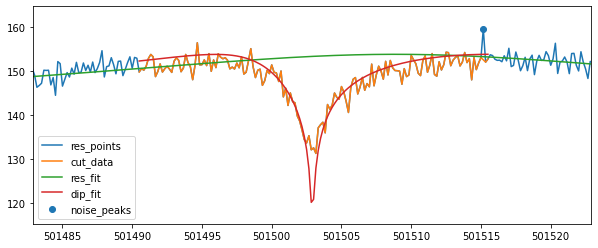

{'A': 2371211188517387.0, 'dA': 1.0699542916737376e-10, 'Q': 14405.403949483987, 'dQ': 34.37115629242905, 'nu_res': 501508.8768856613, 'dnu_res': 0.2745591606961821, 'nu_z': 501502.9104427278, 'dnu_z': 0.025606258872586253, 'dip_width': 5.1482714128111065, 'ddip_width': 0.24310750904785455, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 2.277963747820201, 'fit_success': True}
cycle6 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 449.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


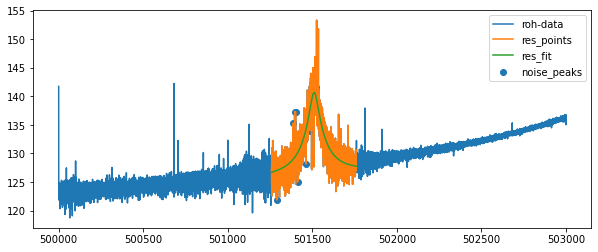

...End fiting resonator
{'A': 112740044650132.73, 'dA': 5.480669367487324e-09, 'off': 4256563950129.299, 'doff': 1.0074797383921531e-07, 'Q': 10347.640589047223, 'dQ': 99.13178071702534, 'th': 0.0003290961835722991, 'dth': 4.406815456988301e-05, 'nu_res': 501510.70546529186, 'dnu_res': 0.5456994305865838, 'fit_err_chi**2_red': 3.286047073125848}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


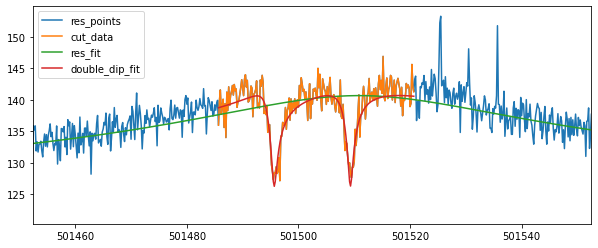

501495.66223558754 0.06225258966004471 501509.31112129556 0.05930840440406883
cycle6 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.3333333333 1228.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


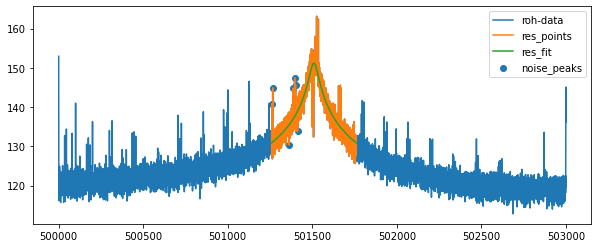

...End fiting resonator
{'A': 1321843160188999.8, 'dA': 2.1818178256678772e-10, 'off': 572194.6356765375, 'doff': 1.0317477758037142e-08, 'Q': 10339.418145610163, 'dQ': 51.43746490375046, 'th': 1.9165430338317108e-20, 'dth': 5.097858379181254e-05, 'nu_res': 501508.9970876544, 'dnu_res': 0.4995496453232157, 'fit_err_chi**2_red': 3.0084677030901745}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


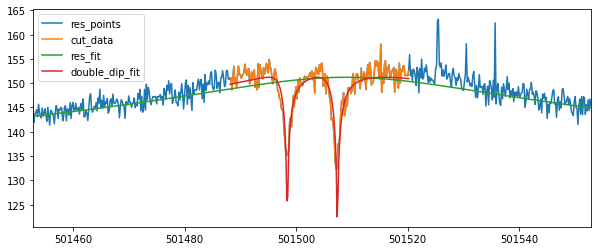

501498.41165459657 0.015098345154851603 501507.39514058875 0.014221859514845791
[501502.7411012475, 501502.9104427278]
503840.97 501502.8257719877 501495.66223558754 501509.31112129556 0.03456765501911564 0.06225258966004471 0.05930840440406883
53273922.2 501502.8257719877 501498.41165459657 501507.39514058875 0.03456765501911564 0.015098345154851603 0.014221859514845791
['cycle6', 'position_1', 3, 0.03, '20211217_224130.721753', 53775425.1810232, 0.0403130758935067, 2338.8224151045433, 0.09267035408294859, 501502.8257719877, 0.03456765501911564, 5.1482714128111065, 0.24310750904785455, True, 501508.8768856613, 0.2745591606961821]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle6 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [912224680317868.8, 5854.264591438363, 124.42845812184922, -0.00

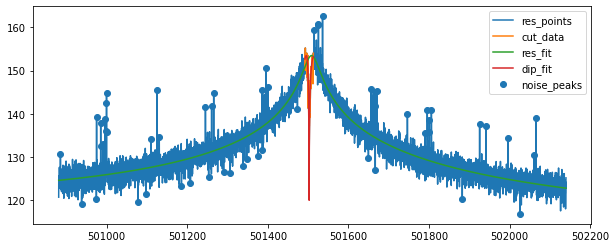

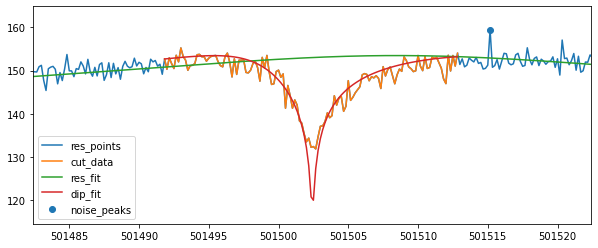

{'A': 2227804309656593.8, 'dA': 1.0806986160657825e-10, 'Q': 13852.488800813153, 'dQ': 33.87074250702815, 'nu_res': 501508.5156237766, 'dnu_res': 0.2850730436665013, 'nu_z': 501502.42309243756, 'dnu_z': 0.025028888458715502, 'dip_width': 5.10621699832571, 'ddip_width': 0.23255584665025386, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.9981014061410702, 'fit_success': True}
cycle6 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [894683423270526.2, 5764.5344827586205, 124.59974991632092, -0.0015000731157400692, 501514.5]
Start fiting resonator....
chi_reduziert = 

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



 0.8059378170194537
...End fiting resonator
{'A': 2469794917978988.5, 'dA': 1.1092583025124447e-10, 'Q': 14705.4419273302, 'dQ': 36.341533154981164, 'nu_res': 501508.4991698757, 'dnu_res': 0.2760625980605827, 'fit_err_chi**2_red': 0.8059378170194537}
resonator fit results:  [ 2.469794917979e+15  1.470544192733e+04  5.602400522916e+11
 -2.290898859425e-04  5.015084991699e+05] [1.109258302512e-10 3.634153315498e+01 4.463087215709e-08
 8.801200990780e-06 2.760625980606e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5371951218967563


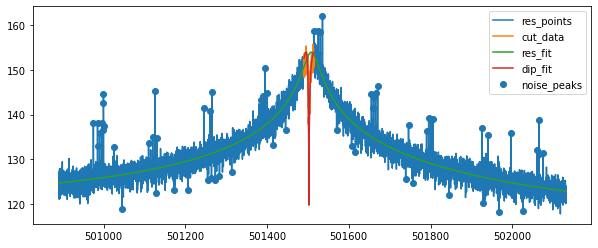

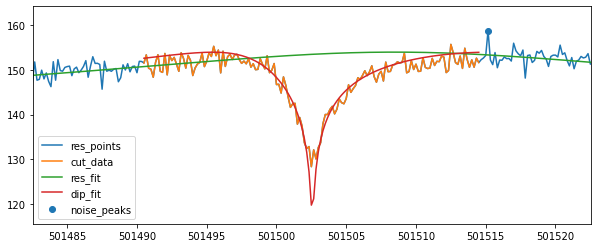

{'A': 2469794917978988.5, 'dA': 1.1092583025124447e-10, 'Q': 14705.4419273302, 'dQ': 36.341533154981164, 'nu_res': 501508.4991698757, 'dnu_res': 0.2760625980605827, 'nu_z': 501502.5694923931, 'dnu_z': 0.02288596760412636, 'dip_width': 5.483283116637524, 'ddip_width': 0.21075354189038847, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.5371951218967563, 'fit_success': True}
cycle6 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501504.0 417.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



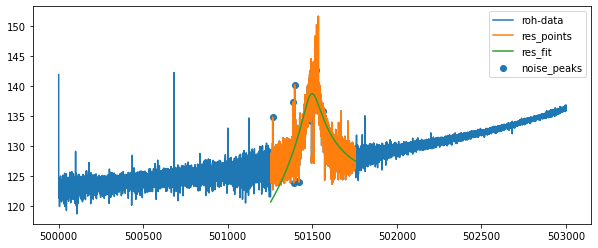

...End fiting resonator
{'A': 74019206805931.28, 'dA': 1.8501780500540266e-09, 'off': 125.98258671788281, 'doff': 1.696473988826492e-13, 'Q': 5354.15604579665, 'dQ': 43.97059636317581, 'th': 0.0023507869407044125, 'dth': 8.354497019616504e-05, 'nu_res': 501494.9600034174, 'dnu_res': 1.2110399740527666, 'fit_err_chi**2_red': 7.867483428875302}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


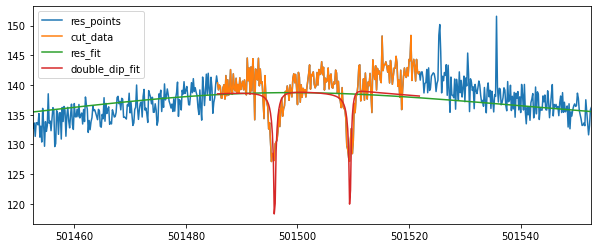

501495.90881596674 0.021400392909219527 501509.4081360277 0.021652533787054055
cycle6 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.8333333333 1257.333333333023
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



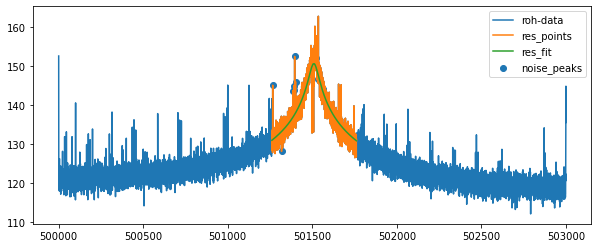

...End fiting resonator
{'A': 1167655672647862.0, 'dA': 2.1973646683946641e-10, 'off': 464.42904462019214, 'doff': 5.390117001180421e-15, 'Q': 9689.187187551299, 'dQ': 48.549149821882544, 'th': 1.456729317830133e-14, 'dth': 5.156123733322855e-05, 'nu_res': 501508.91829524934, 'dnu_res': 0.5243641856562048, 'fit_err_chi**2_red': 3.105695460261845}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


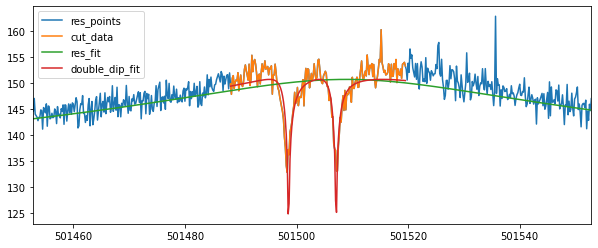

501498.5726746276 0.016697733984804775 501507.0928597545 0.016344102234657314
[501502.42309243756, 501502.5694923931]
503840.97 501502.4962924153 501495.90881596674 501509.4081360277 0.03391478690270578 0.021400392909219527 0.021652533787054055
53273922.2 501502.4962924153 501498.5726746276 501507.0928597545 0.03391478690270578 0.016697733984804775 0.016344102234657314
['cycle6', 'position_1', 3, 0.05, '20211217_221119.220439', 53775425.36924197, 0.04118442386072892, 2338.149340420845, 0.045574354704421595, 501502.4962924153, 0.03391478690270578, 5.483283116637524, 0.21075354189038847, True, 501508.4991698757, 0.2760625980605827]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [900380634693778.1, 5764.521072796934, 124.79653840125559, -0.0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.810799155114476
...End fiting resonator
{'A': 2311892281038986.0, 'dA': 1.116578594319387e-10, 'Q': 14226.053679732338, 'dQ': 35.37289652163576, 'nu_res': 501508.40099423396, 'dnu_res': 0.2835981658258087, 'fit_err_chi**2_red': 0.810799155114476}
resonator fit results:  [ 2.311892281039e+15  1.422605367973e+04  5.266707836715e+11
 -2.329764630336e-04  5.015084009942e+05] [1.116578594319e-10 3.537289652164e+01 4.164532856803e-08
 9.022079597749e-06 2.835981658258e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9561511951529138


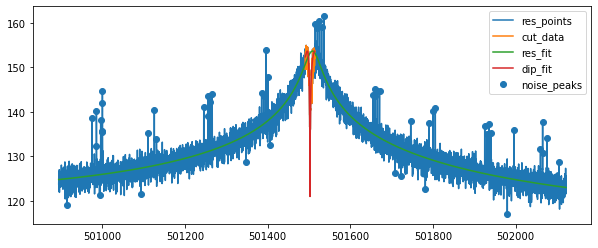

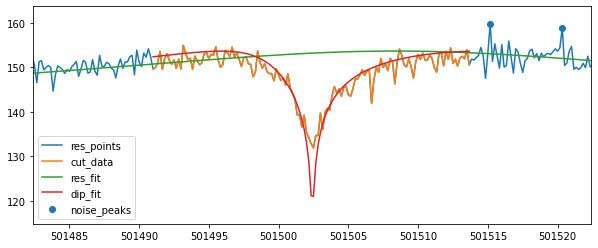

{'A': 2311892281038986.0, 'dA': 1.116578594319387e-10, 'Q': 14226.053679732338, 'dQ': 35.37289652163576, 'nu_res': 501508.40099423396, 'dnu_res': 0.2835981658258087, 'nu_z': 501502.4178791225, 'dnu_z': 0.023503646658164346, 'dip_width': 4.634277560744392, 'ddip_width': 0.21823584569122903, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.9561511951529138, 'fit_success': True}
cycle7 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [887304611964850.4, 5688.247637049788, 124.44878381967561, -0.0016714557944544843, 501513.8333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8052455734246315
...End fiting resonator
{'A': 2612742697527518.0, 'dA': 1.0864398650596423e-10, 'Q': 15082.428681616735, 'dQ': 36.76876384000994, 'nu_res': 501508.32698700513, 'dnu_res': 0.27345923026520896, 'fit_err_chi**2_red': 0.8052455734246315}
resonator fit results:  [ 2.612742697528e+15  1.508242868162e+04  4.974650239438e+11
 -2.591460483600e-04  5.015083269870e+05] [1.086439865060e-10 3.676876384001e+01 4.771120514382e-08
 8.635909364183e-06 2.734592302652e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7081193327571533


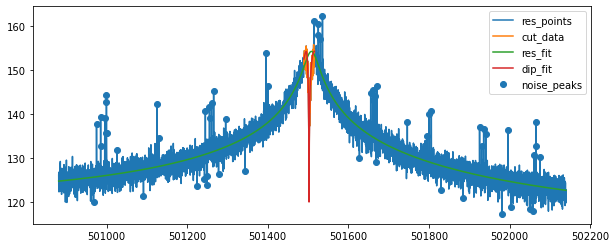

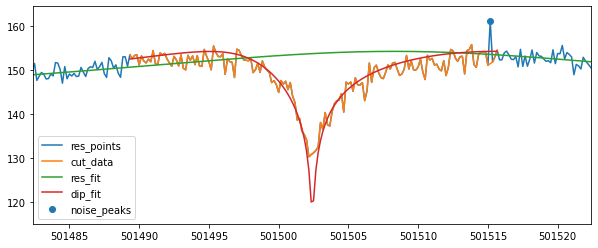

{'A': 2612742697527518.0, 'dA': 1.0864398650596423e-10, 'Q': 15082.428681616735, 'dQ': 36.76876384000994, 'nu_res': 501508.32698700513, 'dnu_res': 0.27345923026520896, 'nu_z': 501502.41371643945, 'dnu_z': 0.023799652591309353, 'dip_width': 5.871840833165553, 'ddip_width': 0.2300683684542518, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.7081193327571533, 'fit_success': True}
cycle7 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.6666666667 461.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



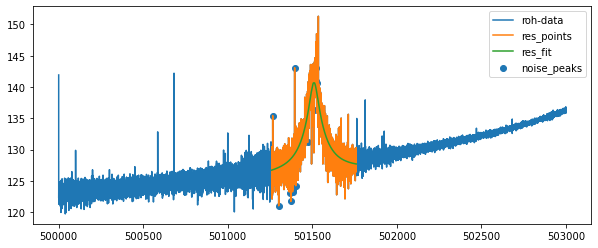

...End fiting resonator
{'A': 114179633235942.48, 'dA': 5.333216386509811e-09, 'off': 4234163461876.609, 'doff': 1.0033435505919667e-07, 'Q': 10559.443511926027, 'dQ': 95.91436574001263, 'th': 0.0003135169705629287, 'dth': 4.161695985251181e-05, 'nu_res': 501509.6380133299, 'dnu_res': 0.5087186754780834, 'fit_err_chi**2_red': 2.9846488854746576}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


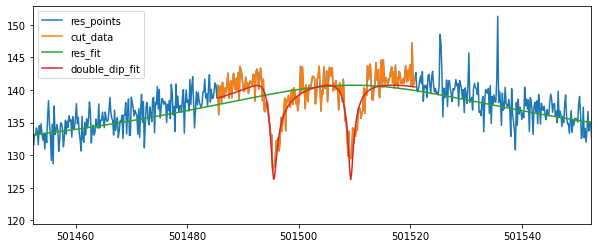

501495.5493854892 0.056486455125632794 501509.3331424785 0.05141473005632267
cycle7 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.8333333333 1232.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



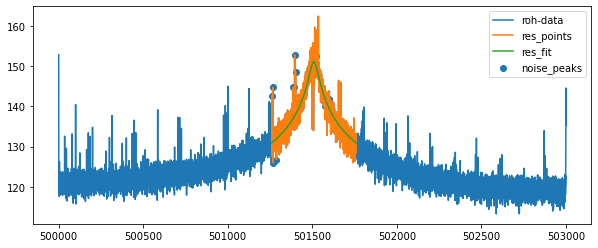

...End fiting resonator
{'A': 1298572939637672.5, 'dA': 2.2338871249142844e-10, 'off': 425.52687721553957, 'doff': 8.505578297054729e-17, 'Q': 10273.223719525586, 'dQ': 52.04224052410994, 'th': 3.346952760067118e-14, 'dth': 5.193087694061795e-05, 'nu_res': 501508.99413151277, 'dnu_res': 0.5107446170508667, 'fit_err_chi**2_red': 3.1058976969218404}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


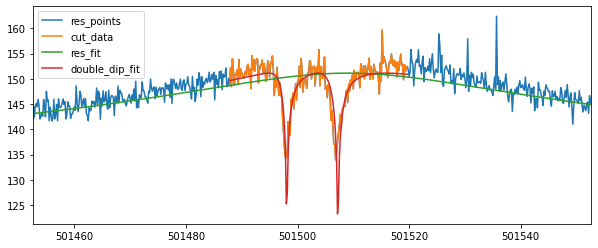

501498.07211843453 0.017594378678682073 501507.23630882934 0.017371351972083386
[501502.4178791225, 501502.41371643945]
503840.97 501502.41579778097 501495.5493854892 501509.3331424785 0.033449138549428416 0.056486455125632794 0.05141473005632267
53273922.2 501502.41579778097 501498.07211843453 501507.23630882934 0.033449138549428416 0.017594378678682073 0.017371351972083386
['cycle7', 'position_1', 3, -0.005, '20211217_234756.162958', 53775425.092629485, 0.0415953230559125, 2338.5032698132563, 0.08338488441632282, 501502.41579778097, 0.033449138549428416, 5.871840833165553, 0.2300683684542518, True, 501508.32698700513, 0.27345923026520896]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [895804356924897.0, 5842.862135919689, 124.7113494873

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8095561762117636
...End fiting resonator
{'A': 2193579587075945.5, 'dA': 1.0512009767268397e-10, 'Q': 13754.88247373982, 'dQ': 32.67593160379019, 'nu_res': 501509.05838823, 'dnu_res': 0.27950663353567473, 'fit_err_chi**2_red': 0.8095561762117636}
resonator fit results:  [ 2.193579587076e+15  1.375488247374e+04  5.079428983739e+11
 -2.616233328875e-04  5.015090583882e+05] [1.051200976727e-10 3.267593160379e+01 3.934753903672e-08
 8.287525908091e-06 2.795066335357e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7136774594290607


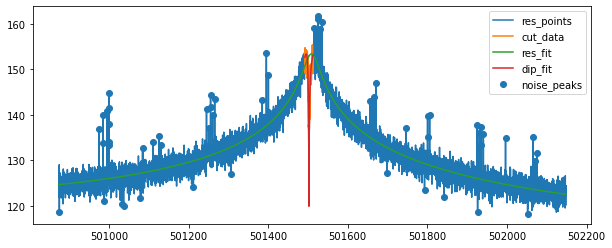

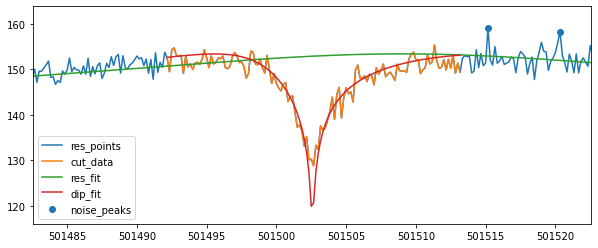

{'A': 2193579587075945.5, 'dA': 1.0512009767268397e-10, 'Q': 13754.88247373982, 'dQ': 32.67593160379019, 'nu_res': 501509.05838823, 'dnu_res': 0.27950663353567473, 'nu_z': 501502.576191068, 'dnu_z': 0.022869394214888452, 'dip_width': 5.182483615354153, 'ddip_width': 0.21153082962074712, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.7136774594290607, 'fit_success': True}
cycle7 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [882965776511523.1, 5797.851637764933, 124.88169148453002, -0.0013786615611602621, 501514.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8099837765525673
...End fiting resonator
{'A': 2248114481691607.5, 'dA': 1.1208466315232019e-10, 'Q': 14055.811679581248, 'dQ': 34.92924456212439, 'nu_res': 501508.89820675354, 'dnu_res': 0.2842794365766315, 'fit_err_chi**2_red': 0.8099837765525673}
resonator fit results:  [ 2.248114481692e+15  1.405581167958e+04  5.496050813587e+11
 -2.322651866548e-04  5.015088982068e+05] [1.120846631523e-10 3.492924456212e+01 4.072965016120e-08
 8.963152687078e-06 2.842794365766e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.510152670329385
Fit is NOT GOOD !!!!!


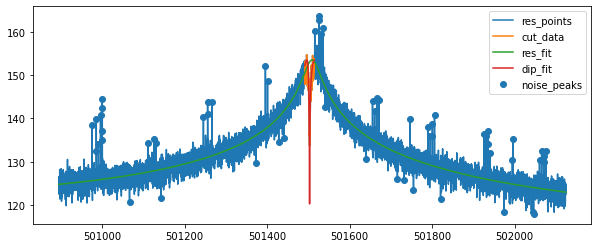

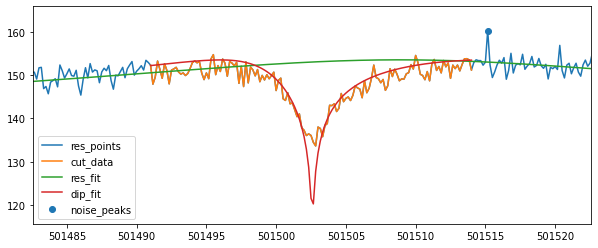

{'A': 2248114481691607.5, 'dA': 1.1208466315232019e-10, 'Q': 14055.811679581248, 'dQ': 34.92924456212439, 'nu_res': 501508.89820675354, 'dnu_res': 0.2842794365766315, 'nu_z': 501502.5939367595, 'dnu_z': 0.027706504165268864, 'dip_width': 4.777557449048618, 'ddip_width': 0.25050678853400793, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.510152670329385, 'fit_success': True}
cycle7 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.6666666667 462.6666666669771
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



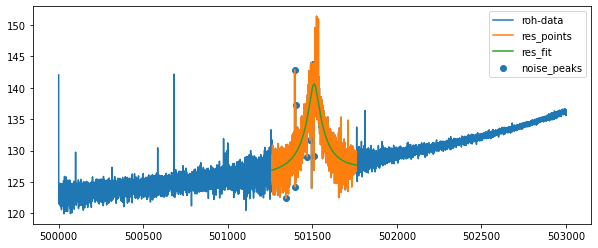

...End fiting resonator
{'A': 111372198547668.88, 'dA': 5.606639886034624e-09, 'off': 4327286947591.4365, 'doff': 1.0250887474352914e-07, 'Q': 10445.461630981368, 'dQ': 99.06742820300431, 'th': 0.00026121228279443455, 'dth': 4.292329929106783e-05, 'nu_res': 501510.2951743336, 'dnu_res': 0.5313126070940122, 'fit_err_chi**2_red': 3.0533251798899337}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


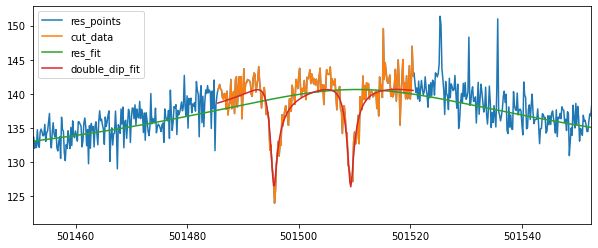

501495.5685979612 0.060150501959964256 501509.3142905515 0.05926104097960077
cycle7 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.3333333333 1237.333333333023
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



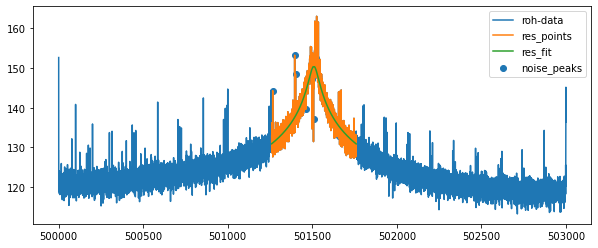

...End fiting resonator
{'A': 1114714420748694.0, 'dA': 2.235941612055252e-10, 'off': 60349.86244609207, 'doff': 7.498888549121187e-09, 'Q': 9492.561373611581, 'dQ': 48.04706847060022, 'th': 1.483427351585873e-26, 'dth': 5.216549295996698e-05, 'nu_res': 501508.881828128, 'dnu_res': 0.5368073075167423, 'fit_err_chi**2_red': 3.2433650163238137}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


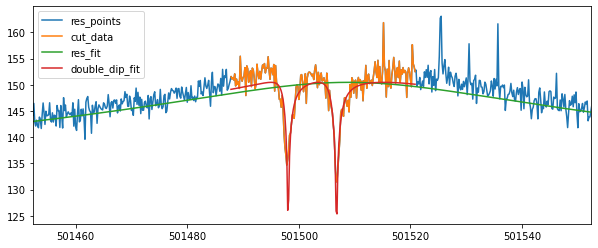

501498.0725287569 0.01658176497097526 501506.7515866365 0.016551495167177094
[501502.576191068, 501502.5939367595]
503840.97 501502.5850639137 501495.5685979612 501509.3142905515 0.035925750720284665 0.060150501959964256 0.05926104097960077
53273922.2 501502.5850639137 501498.0725287569 501506.7515866365 0.035925750720284665 0.01658176497097526 0.016551495167177094
['cycle7', 'position_1', 3, -0.02, '20211217_231744.572890', 53775424.43905149, 0.04289016771519765, 2338.6721754009486, 0.09176390046656484, 501502.5850639137, 0.035925750720284665, 4.777557449048618, 0.25050678853400793, True, 501508.89820675354, 0.2842794365766315]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [932358747795382.1, 5935.092702169625, 124.7698745727539, -0.0017

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.801504086955686
...End fiting resonator
{'A': 2425584049582309.5, 'dA': 1.1176598167264188e-10, 'Q': 14672.27741124013, 'dQ': 36.048736358272976, 'nu_res': 501508.51282907557, 'dnu_res': 0.27569816641780914, 'fit_err_chi**2_red': 0.801504086955686}
resonator fit results:  [ 2.425584049582e+15  1.467227741124e+04  5.407719055452e+11
 -2.540865575120e-04  5.015085128291e+05] [1.117659816726e-10 3.604873635827e+01 4.473026746088e-08
 8.790846024077e-06 2.756981664178e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.7744553660626488


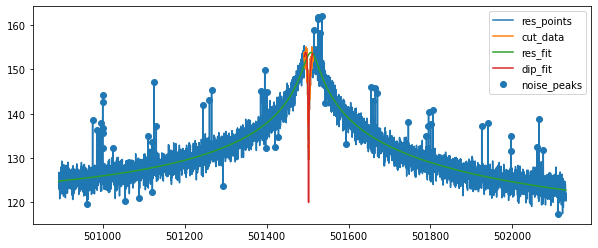

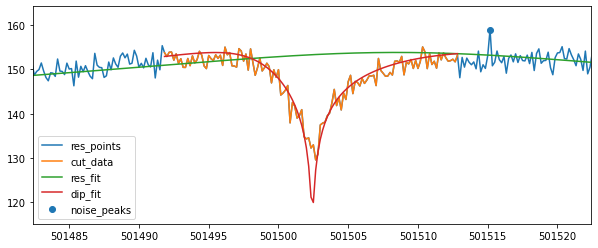

{'A': 2425584049582309.5, 'dA': 1.1176598167264188e-10, 'Q': 14672.27741124013, 'dQ': 36.048736358272976, 'nu_res': 501508.51282907557, 'dnu_res': 0.27569816641780914, 'nu_z': 501502.42713050224, 'dnu_z': 0.024080192551706275, 'dip_width': 5.318479936707933, 'ddip_width': 0.22339106669576056, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.7744553660626488, 'fit_success': True}
cycle7 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [890218614064826.4, 5699.022727272727, 124.62954711914062, -0.0016300196909546374, 501514.0]
Start fiting resonator....
chi_reduziert =  0.8017879166241472
...End fiting resonator
{'A': 2412079248878881.0, 'dA': 1.1358459167312293e-10, 'Q': 14555.059523273689, 'dQ': 36.708546724653935, 'nu_res': 501508.8681211728, 'dnu_res': 0.28273851934830213, 'fit_err_chi**2_red': 0.8017879166241472}
resonator fit results:  [ 2.412079248879e+15  1.455505952327e+04  5.701064548344e+11
 -2.516229254786e-04  5.015088681212e+05] [

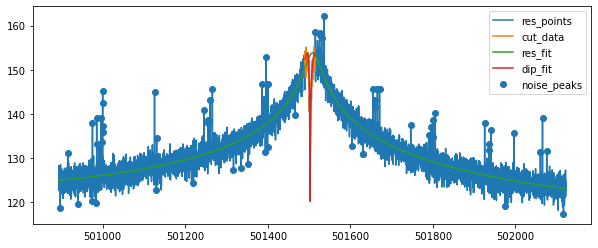

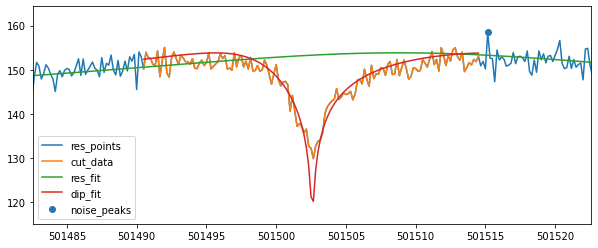

{'A': 2412079248878881.0, 'dA': 1.1358459167312293e-10, 'Q': 14555.059523273689, 'dQ': 36.708546724653935, 'nu_res': 501508.8681211728, 'dnu_res': 0.28273851934830213, 'nu_z': 501502.5928008294, 'dnu_z': 0.024368087674876204, 'dip_width': 5.3308021699628485, 'ddip_width': 0.22140279697553292, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.6882210312939747, 'fit_success': True}
cycle7 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.8333333333 461.3333333330229
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



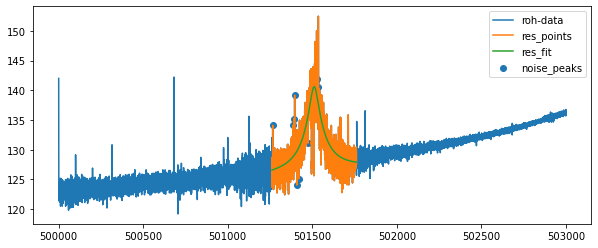

...End fiting resonator
{'A': 111155747425517.28, 'dA': 5.662445651835947e-09, 'off': 4306532620243.5103, 'doff': 1.04093454272412e-07, 'Q': 10507.03212845837, 'dQ': 99.3167336769818, 'th': 0.0004250268856026266, 'dth': 4.267419693684986e-05, 'nu_res': 501510.603574411, 'dnu_res': 0.5264012470022447, 'fit_err_chi**2_red': 3.018689553955261}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


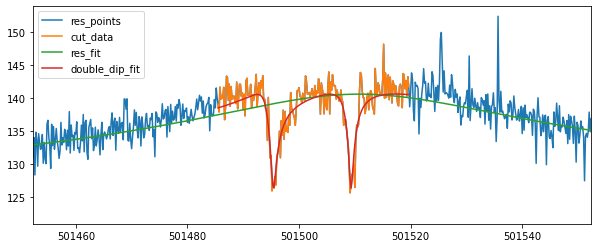

501495.4316408131 0.060607605719633036 501509.33640725707 0.054235615403791
cycle7 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.6666666667 1234.666666666977
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


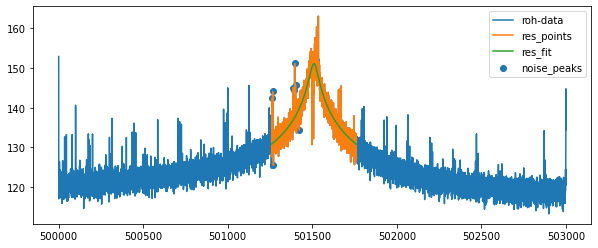

...End fiting resonator
{'A': 1292755405655727.8, 'dA': 2.2730767111143e-10, 'off': 312458151.3423543, 'doff': 9.382633723966985e-09, 'Q': 10330.493568842616, 'dQ': 52.45094535589689, 'th': 2.2797233394303375e-33, 'dth': 5.202968922044671e-05, 'nu_res': 501509.0556497401, 'dnu_res': 0.5101022502673823, 'fit_err_chi**2_red': 3.102556466653067}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


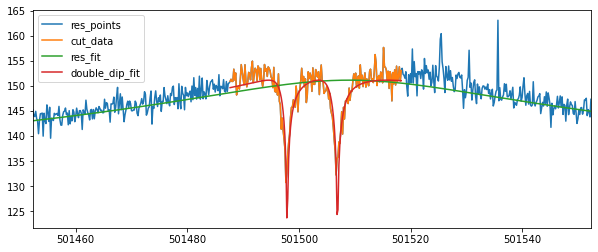

501497.89738556097 0.015376165671932313 501506.91104782885 0.015989942834397485
[501502.42713050224, 501502.5928008294]
503840.97 501502.5099656658 501495.4316408131 501509.33640725707 0.03425871232632225 0.060607605719633036 0.054235615403791
53273922.2 501502.5099656658 501497.89738556097 501506.91104782885 0.03425871232632225 0.015376165671932313 0.015989942834397485
['cycle7', 'position_1', 3, -0.04, '20211217_225937.711402', 53775424.49846773, 0.0408137735681928, 2338.711917595647, 0.08825215702492563, 501502.5099656658, 0.03425871232632225, 5.3308021699628485, 0.22140279697553292, True, 501508.8681211728, 0.28273851934830213]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [930732585676924.4, 5854.2626459130715, 124.83238983154297, -0

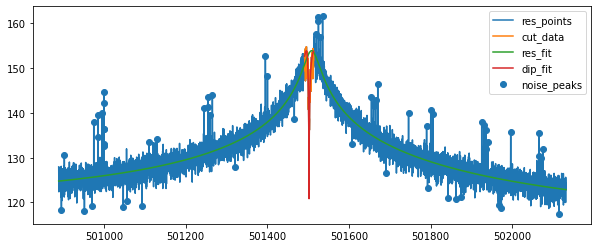

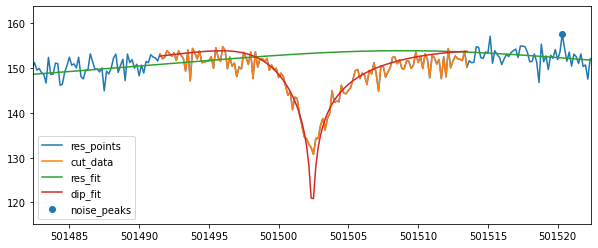

{'A': 2445807958916331.0, 'dA': 1.117678207412837e-10, 'Q': 14642.191997040405, 'dQ': 36.419977591185216, 'nu_res': 501508.8947466906, 'dnu_res': 0.27905976203708494, 'nu_z': 501502.417496808, 'dnu_z': 0.024089282721966473, 'dip_width': 4.979856312848735, 'ddip_width': 0.22395942062270766, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.8895575795974044, 'fit_success': True}
cycle7 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [894136977192688.6, 5742.511450382955, 124.29676055908203, -0.0015281046012788663, 501512.6666666667]
Start fiting resonator....
chi_reduziert =  0.8120041101325792
...End fiting resonator
{'A': 2428991283844755.0, 'dA': 1.1272691957558624e-10, 'Q': 14609.025079229408, 'dQ': 36.55724401949044, 'nu_res': 501508.8002378516, 'dnu_res': 0.2806433050371882, 'fit_err_chi**2_red': 0.8120041101325792}
resonator fit results:  [ 2.428991283845e+15  1.460902507923e+04  5.465211348190e+11
 -2.403239865586e-04  5.015088002379e+05] [1.127

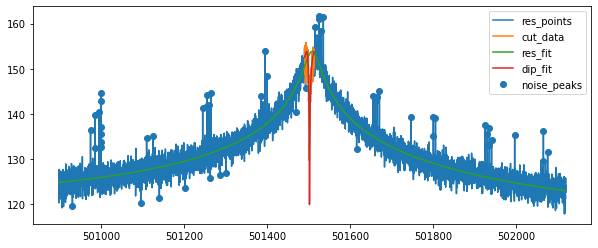

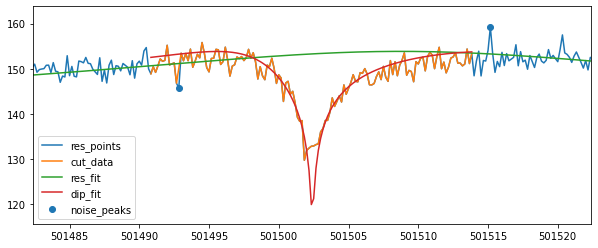

{'A': 2428991283844755.0, 'dA': 1.1272691957558624e-10, 'Q': 14609.025079229408, 'dQ': 36.55724401949044, 'nu_res': 501508.8002378516, 'dnu_res': 0.2806433050371882, 'nu_z': 501502.4043375503, 'dnu_z': 0.025983965768042766, 'dip_width': 5.281922487134391, 'ddip_width': 0.24093082376623087, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.0661232728373626, 'fit_success': True}
cycle7 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501508.6666666667 441.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



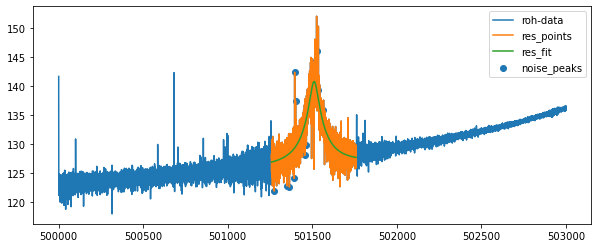

...End fiting resonator
{'A': 116613847387717.03, 'dA': 5.492852980071811e-09, 'off': 4404570539700.856, 'doff': 1.0357797815359832e-07, 'Q': 10706.540814443639, 'dQ': 99.4144365654797, 'th': 0.00024859452940629537, 'dth': 4.1928752232544696e-05, 'nu_res': 501510.64074263093, 'dnu_res': 0.5104225062505516, 'fit_err_chi**2_red': 2.9367553159277677}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


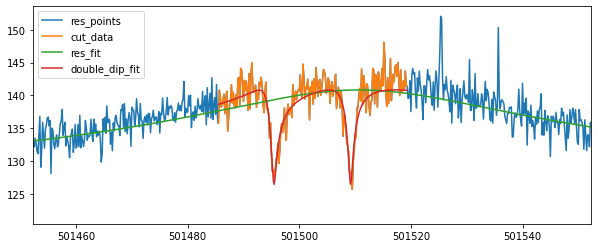

501495.4699194864 0.061690045202091565 501509.19604543864 0.05838012821669309
cycle7 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.1666666667 1245.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



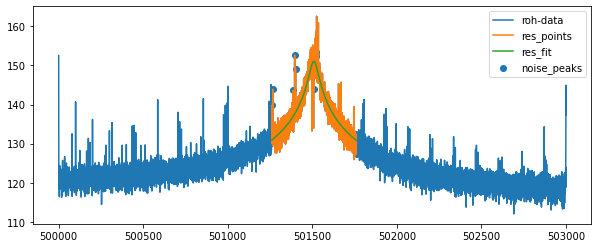

...End fiting resonator
{'A': 1282946529381042.5, 'dA': 2.159485525579553e-10, 'off': 1.0416705843799718, 'doff': 8.236598411593348e-17, 'Q': 10217.396625889462, 'dQ': 49.9512468607292, 'th': 1.2409320408270093e-17, 'dth': 5.013306028515609e-05, 'nu_res': 501508.92595496704, 'dnu_res': 0.49459492740522654, 'fit_err_chi**2_red': 2.894538564168214}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


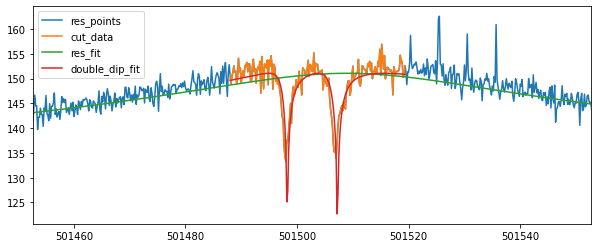

501498.23834651033 0.0184740970446736 501507.22924434155 0.017668262643405076
[501502.417496808, 501502.4043375503]
503840.97 501502.41091717914 501495.4699194864 501509.19604543864 0.0354324712529856 0.061690045202091565 0.05838012821669309
53273922.2 501502.41091717914 501498.23834651033 501507.22924434155 0.0354324712529856 0.0184740970446736 0.017668262643405076
['cycle7', 'position_1', 3, 0.002, '20211217_231142.243153', 53775425.25667368, 0.043691186588899276, 2338.714952254144, 0.09202913161997822, 501502.41091717914, 0.0354324712529856, 5.281922487134391, 0.24093082376623087, True, 501508.8002378516, 0.2806433050371882]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [899191828804072.5, 5854.276264590114, 124.86347246175932, -0.0015

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8096839617746917
...End fiting resonator
{'A': 2201088024492739.2, 'dA': 1.0900341453108929e-10, 'Q': 13876.727824810621, 'dQ': 33.69995663213479, 'nu_res': 501508.9241147733, 'dnu_res': 0.2835418373558707, 'fit_err_chi**2_red': 0.8096839617746917}
resonator fit results:  [ 2.201088024493e+15  1.387672782481e+04  4.728990817460e+11
 -2.451007129589e-04  5.015089241148e+05] [1.090034145311e-10 3.369995663213e+01 4.012232958822e-08
 8.750903508349e-06 2.835418373559e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.0663634552883825
Fit is NOT GOOD !!!!!


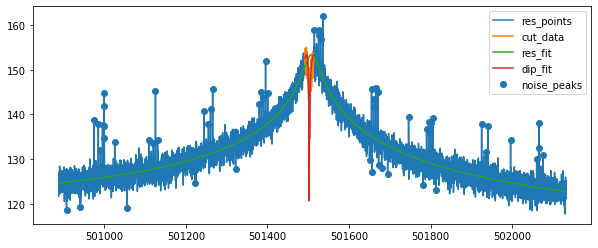

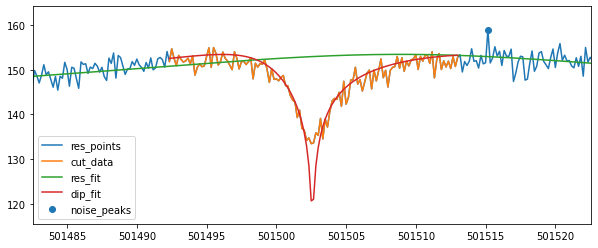

{'A': 2201088024492739.2, 'dA': 1.0900341453108929e-10, 'Q': 13876.727824810621, 'dQ': 33.69995663213479, 'nu_res': 501508.9241147733, 'dnu_res': 0.2835418373558707, 'nu_z': 501502.5799860676, 'dnu_z': 0.023262977560835018, 'dip_width': 4.551124116273047, 'ddip_width': 0.2200797899087048, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.0663634552883825, 'fit_success': True}
cycle7 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [893477756031812.9, 5709.823529409242, 124.63552856445312, -0.0017277293246584064, 501512.8333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8048795034346506
...End fiting resonator
{'A': 2434790689932617.5, 'dA': 1.0977850550287436e-10, 'Q': 14636.03331358652, 'dQ': 35.63337566523172, 'nu_res': 501508.5537865158, 'dnu_res': 0.27444798187686764, 'fit_err_chi**2_red': 0.8048795034346506}
resonator fit results:  [ 2.434790689933e+15  1.463603331359e+04  5.306632996461e+11
 -2.538726437227e-04  5.015085537865e+05] [1.097785055029e-10 3.563337566523e+01 4.426358218774e-08
 8.677672045845e-06 2.744479818769e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.277523333308718
Fit is NOT GOOD !!!!!


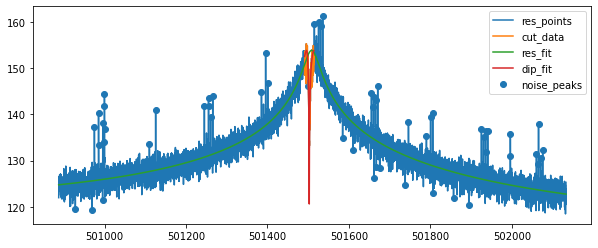

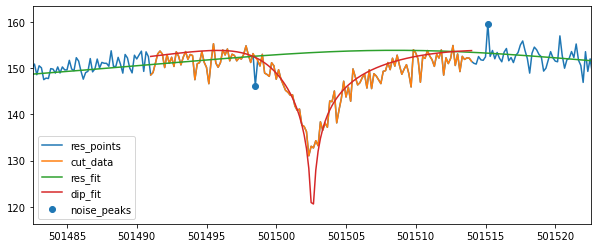

{'A': 2434790689932617.5, 'dA': 1.0977850550287436e-10, 'Q': 14636.03331358652, 'dQ': 35.63337566523172, 'nu_res': 501508.5537865158, 'dnu_res': 0.27444798187686764, 'nu_z': 501502.58550812746, 'dnu_z': 0.025948819613156135, 'dip_width': 5.0477427400651145, 'ddip_width': 0.24431931047925257, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.277523333308718, 'fit_success': True}
cycle7 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 453.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


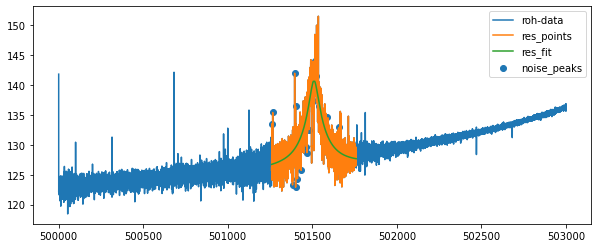

...End fiting resonator
{'A': 114984149850861.78, 'dA': 5.201980917056774e-09, 'off': 4219845881977.2026, 'doff': 9.779541712731775e-08, 'Q': 10485.843144285658, 'dQ': 94.9230570061388, 'th': 0.00029710914609246906, 'dth': 4.1804810830702414e-05, 'nu_res': 501509.97292584745, 'dnu_res': 0.5120321284351294, 'fit_err_chi**2_red': 2.980792784880542}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


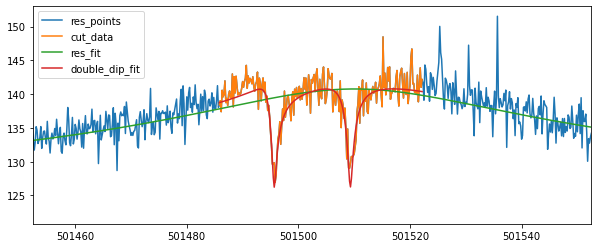

501495.67645668733 0.051609578646609006 501509.31496933836 0.0532851908681576
cycle7 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.5 1240.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



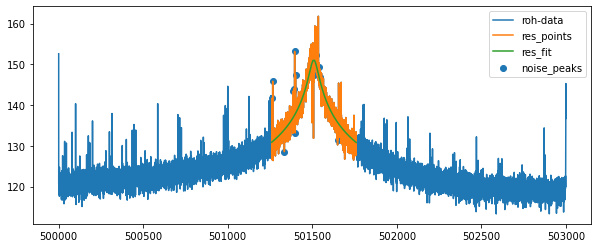

...End fiting resonator
{'A': 1277106875021643.8, 'dA': 2.225833343454203e-10, 'off': 37574.45571735117, 'doff': 1.4078340973278245e-08, 'Q': 10245.433426936988, 'dQ': 51.12373264105897, 'th': 2.871019089548082e-35, 'dth': 5.116168774581097e-05, 'nu_res': 501508.644283313, 'dnu_res': 0.5039564373113123, 'fit_err_chi**2_red': 2.9472584187239512}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


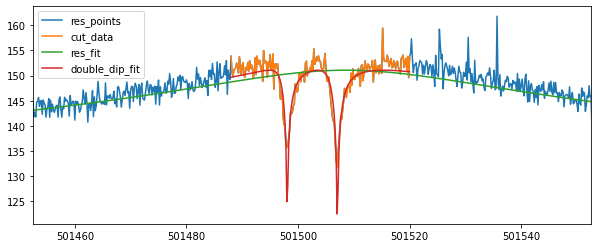

501498.0673584626 0.01393130161072046 501507.0613536478 0.013403623690138474
[501502.5799860676, 501502.58550812746]
503840.97 501502.58274709753 501495.67645668733 501509.31496933836 0.03484978284454625 0.051609578646609006 0.0532851908681576
53273922.2 501502.58274709753 501498.0673584626 501507.0613536478 0.03484978284454625 0.01393130161072046 0.013403623690138474
['cycle7', 'position_1', 3, 0.005, '20211217_233551.434952', 53775424.74596502, 0.03985279986284193, 2338.561321071873, 0.08195954818231087, 501502.58274709753, 0.03484978284454625, 5.0477427400651145, 0.24431931047925257, True, 501508.5537865158, 0.27444798187686764]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [893700126034565.1, 5742.553435115779, 124.7853775024414, -0.0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8084443707793899
...End fiting resonator
{'A': 2537860051462127.5, 'dA': 1.1213239730164026e-10, 'Q': 14994.04206213288, 'dQ': 37.041181089987475, 'nu_res': 501508.39308091166, 'dnu_res': 0.2729798431531059, 'fit_err_chi**2_red': 0.8084443707793899}
resonator fit results:  [ 2.537860051462e+15  1.499404206213e+04  5.695485659965e+11
 -2.474892125713e-04  5.015083930809e+05] [1.121323973016e-10 3.704118108999e+01 4.630724953789e-08
 8.827511568190e-06 2.729798431531e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8885828693234383


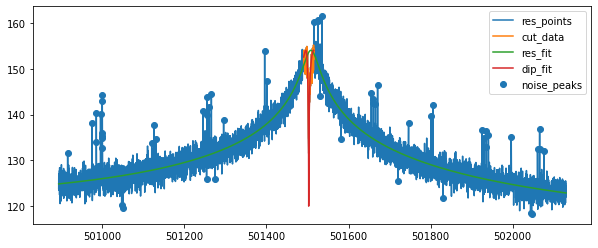

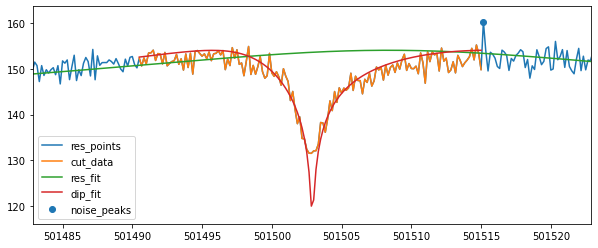

{'A': 2537860051462127.5, 'dA': 1.1213239730164026e-10, 'Q': 14994.04206213288, 'dQ': 37.041181089987475, 'nu_res': 501508.39308091166, 'dnu_res': 0.2729798431531059, 'nu_z': 501502.90360510175, 'dnu_z': 0.025023539840604344, 'dip_width': 5.432789046221366, 'ddip_width': 0.2312860422153503, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.8885828693234383, 'fit_success': True}
cycle7 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [879554179342370.5, 5742.54770992494, 124.62018585205078, -0.0015887119606899506, 501515.8333333333]
Start fiting resonator....
chi_reduziert =  0.813621862891373
...End fiting resonator
{'A': 2327387167649471.5, 'dA': 1.1250355360499331e-10, 'Q': 14343.550175998605, 'dQ': 35.59221957261544, 'nu_res': 501508.778862839, 'dnu_res': 0.28168620088435214, 'fit_err_chi**2_red': 0.813621862891373}
resonator fit results:  [ 2.327387167649e+15  1.434355017600e+04  5.377833983331e+11
 -2.427604615070e-04  5.015087788628e+05]

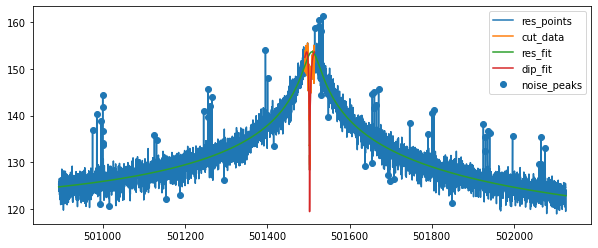

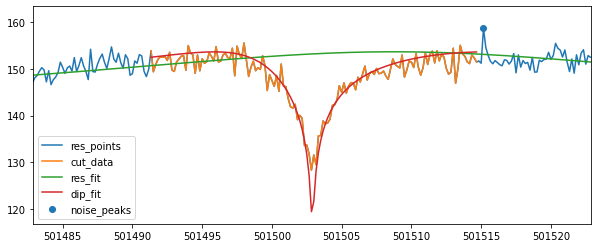

{'A': 2327387167649471.5, 'dA': 1.1250355360499331e-10, 'Q': 14343.550175998605, 'dQ': 35.59221957261544, 'nu_res': 501508.778862839, 'dnu_res': 0.28168620088435214, 'nu_z': 501502.89637758554, 'dnu_z': 0.022681041126523742, 'dip_width': 5.1868704180173735, 'ddip_width': 0.20726970543374934, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 1.5765915150416367, 'fit_success': True}
cycle7 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.5 472.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



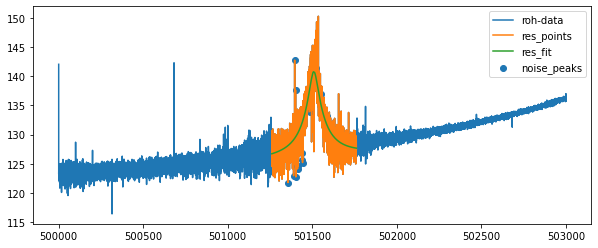

...End fiting resonator
{'A': 116174828691602.25, 'dA': 5.445283624346921e-09, 'off': 4213273909717.8433, 'doff': 1.0346700621533351e-07, 'Q': 10566.881725529931, 'dQ': 99.72551949201664, 'th': 0.000312573170196268, 'dth': 4.3590569747867755e-05, 'nu_res': 501508.78332800465, 'dnu_res': 0.5309318543267875, 'fit_err_chi**2_red': 3.126999778577771}
Start fiting double dip....
Fit is NOT GOOD !!!!!


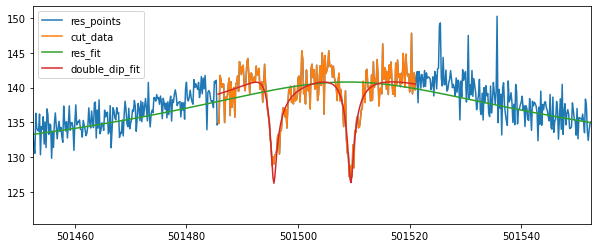

501495.6564112462 0.061114653359360914 501509.4537079657 0.06126122235040293
cycle7 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.5 1240.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



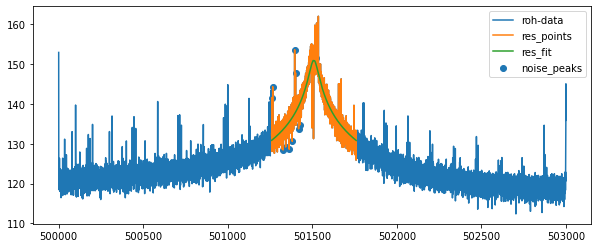

...End fiting resonator
{'A': 1264862459526922.0, 'dA': 2.2523786756329493e-10, 'off': 7750.195074033225, 'doff': 5.722328894581551e-15, 'Q': 10179.974221386374, 'dQ': 51.53816114860157, 'th': 1.3023933491709954e-13, 'dth': 5.19305739402509e-05, 'nu_res': 501508.91637217754, 'dnu_res': 0.5134031953006077, 'fit_err_chi**2_red': 3.0287195550218837}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


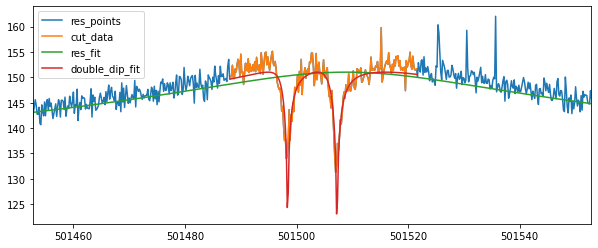

501498.40208414244 0.015910080779763747 501507.23591630644 0.015875202951951505
[501502.90360510175, 501502.89637758554]
503840.97 501502.8999913436 501495.6564112462 501509.4537079657 0.03377287628759763 0.061114653359360914 0.06126122235040293
53273922.2 501502.8999913436 501498.40208414244 501507.23591630644 0.03377287628759763 0.015910080779763747 0.015875202951951505
['cycle7', 'position_1', 3, 0.008, '20211217_234153.831495', 53775424.93800911, 0.04056796657366045, 2338.75987213169, 0.09288996389189591, 501502.8999913436, 0.03377287628759763, 5.1868704180173735, 0.20726970543374934, True, 501508.778862839, 0.28168620088435214]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [882665546732228.4, 5699.041666666667, 124.87491235721266, -0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.786169006519749
...End fiting resonator
{'A': 2390446246089926.5, 'dA': 1.0694055241299325e-10, 'Q': 14376.408153074412, 'dQ': 34.69827595201333, 'nu_res': 501508.3923147612, 'dnu_res': 0.2774418084911957, 'fit_err_chi**2_red': 0.786169006519749}
resonator fit results:  [ 2.390446246090e+15  1.437640815307e+04  5.156843759419e+11
 -2.468162396652e-04  5.015083923148e+05] [1.069405524130e-10 3.469827595201e+01 4.309944874923e-08
 8.467331496093e-06 2.774418084912e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9918430342264417


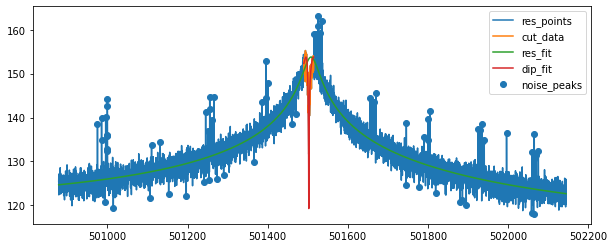

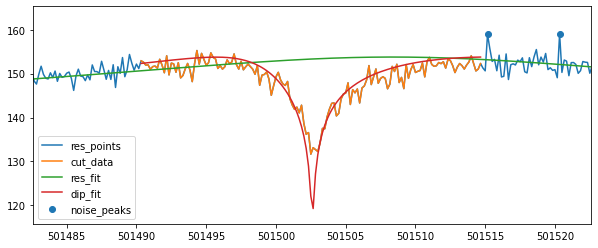

{'A': 2390446246089926.5, 'dA': 1.0694055241299325e-10, 'Q': 14376.408153074412, 'dQ': 34.69827595201333, 'nu_res': 501508.3923147612, 'dnu_res': 0.2774418084911957, 'nu_z': 501502.60722032236, 'dnu_z': 0.025123189162839496, 'dip_width': 5.034596948447832, 'ddip_width': 0.22961796688970243, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.9918430342264417, 'fit_success': True}
cycle7 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [942184917428406.4, 5946.800395258285, 124.66572570800781, -0.0018272852142475337, 501513.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7961093777755743
...End fiting resonator
{'A': 2310240603820374.5, 'dA': 1.0965229658584561e-10, 'Q': 14190.609818131414, 'dQ': 34.80261706838617, 'nu_res': 501508.5521387186, 'dnu_res': 0.2807657561777815, 'fit_err_chi**2_red': 0.7961093777755743}
resonator fit results:  [ 2.310240603820e+15  1.419060981813e+04  5.497318386438e+11
 -2.505388919939e-04  5.015085521387e+05] [1.096522965858e-10 3.480261706839e+01 4.243745216472e-08
 8.583441055613e-06 2.807657561778e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8930961213741864


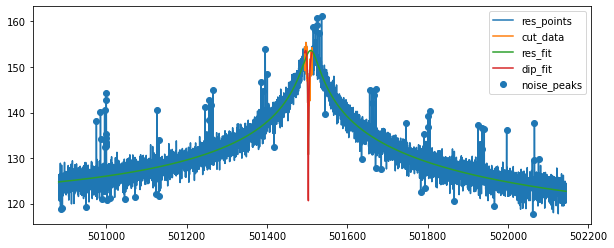

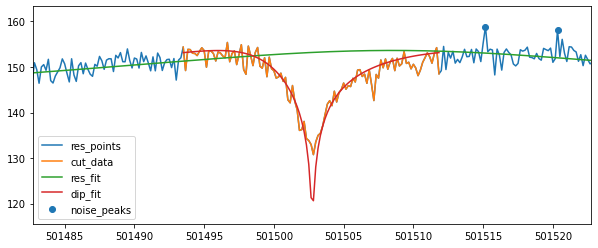

{'A': 2310240603820374.5, 'dA': 1.0965229658584561e-10, 'Q': 14190.609818131414, 'dQ': 34.80261706838617, 'nu_res': 501508.5521387186, 'dnu_res': 0.2807657561777815, 'nu_z': 501502.7552049136, 'dnu_z': 0.02395589706785337, 'dip_width': 4.7961074658948215, 'ddip_width': 0.22078541018125994, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.8930961213741864, 'fit_success': True}
cycle7 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.0 461.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


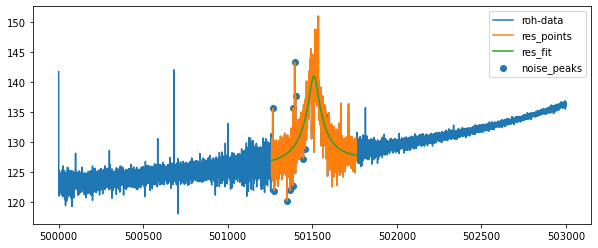

...End fiting resonator
{'A': 122333738364732.55, 'dA': 5.287637088761355e-09, 'off': 4382905461718.2163, 'doff': 1.0331001346947011e-07, 'Q': 10881.438232986367, 'dQ': 99.19113756923718, 'th': 0.0002931863728713252, 'dth': 4.1648214111098675e-05, 'nu_res': 501509.0287630684, 'dnu_res': 0.4989031689678739, 'fit_err_chi**2_red': 2.989960513045148}
Start fiting double dip....
Fit is NOT GOOD !!!!!


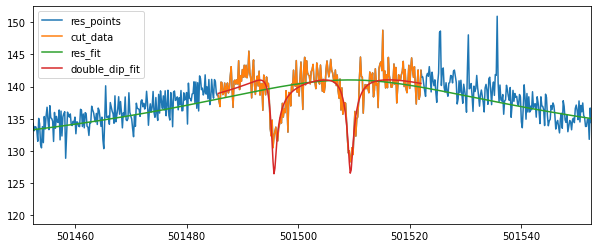

501495.69394544646 0.054109930607181334 501509.3820050144 0.056532812886947115
cycle7 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.0 1246.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


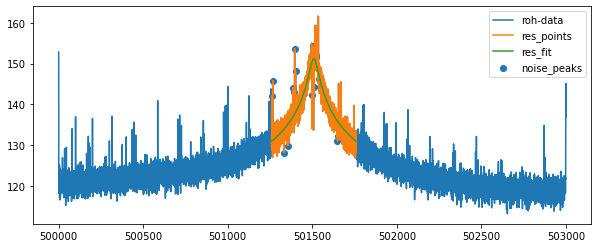

...End fiting resonator
{'A': 1313065564627414.5, 'dA': 2.1906878448157082e-10, 'off': 2507.1470479246345, 'doff': 2.850583999300633e-14, 'Q': 10328.863625689524, 'dQ': 51.35155007278203, 'th': 2.3018413088194814e-14, 'dth': 5.094891219077759e-05, 'nu_res': 501508.78171640413, 'dnu_res': 0.4995488726881095, 'fit_err_chi**2_red': 3.054683595698118}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


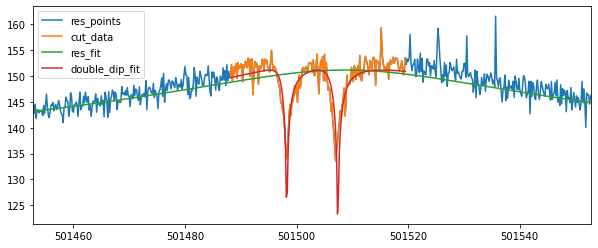

501498.24376498564 0.016406856542159284 501507.3977658039 0.015684681332353262
[501502.60722032236, 501502.7552049136]
503840.97 501502.681212618 501495.69394544646 501509.3820050144 0.034713968917964445 0.054109930607181334 0.056532812886947115
53273922.2 501502.681212618 501498.24376498564 501507.3977658039 0.034713968917964445 0.016406856542159284 0.015684681332353262
['cycle7', 'position_1', 3, 0.015, '20211217_230539.981914', 53775425.16031817, 0.04147594252250173, 2338.57526215713, 0.08560901331788584, 501502.681212618, 0.034713968917964445, 4.7961074658948215, 0.22078541018125994, True, 501508.5521387186, 0.2807657561777815]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [877834904002188.1, 5720.6863117858065, 124.76192966348361, -0.

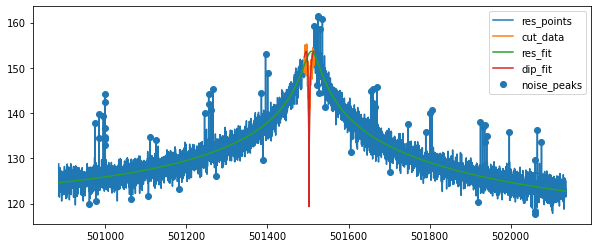

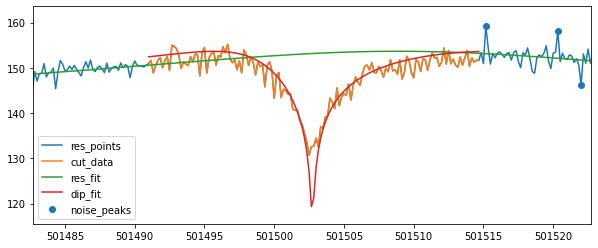

{'A': 2329417849522125.0, 'dA': 1.1005395213603305e-10, 'Q': 14277.687380943882, 'dQ': 35.027424123689954, 'nu_res': 501508.92926902045, 'dnu_res': 0.2830446244861059, 'nu_z': 501502.7328539701, 'dnu_z': 0.02479793495947273, 'dip_width': 5.323040037871969, 'ddip_width': 0.23289339295918535, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.911918030620207, 'fit_success': True}
cycle7 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [878116764770673.5, 5775.612284070388, 124.82850646972656, -0.0016262401716399023, 501515.6666666667]
Start fiting resonator....
chi_reduziert = 

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



 0.8152712881712043
...End fiting resonator
{'A': 2266442324030462.5, 'dA': 1.1196128863281876e-10, 'Q': 14096.592072252812, 'dQ': 35.09132981199921, 'nu_res': 501508.75969171786, 'dnu_res': 0.28654753250484455, 'fit_err_chi**2_red': 0.8152712881712043}
resonator fit results:  [ 2.266442324030e+15  1.409659207225e+04  5.301988068302e+11
 -2.419007393389e-04  5.015087596917e+05] [1.119612886328e-10 3.509132981200e+01 4.248639577481e-08
 8.803079912741e-06 2.865475325048e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.2513839189228233


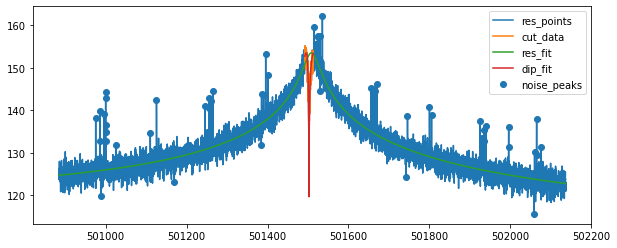

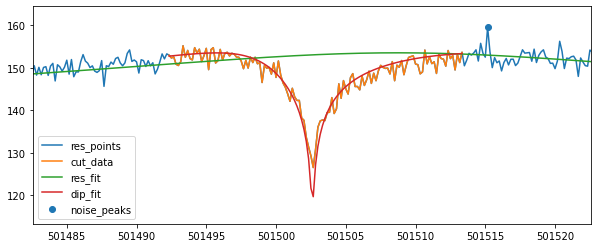

{'A': 2266442324030462.5, 'dA': 1.1196128863281876e-10, 'Q': 14096.592072252812, 'dQ': 35.09132981199921, 'nu_res': 501508.75969171786, 'dnu_res': 0.28654753250484455, 'nu_z': 501502.6005734301, 'dnu_z': 0.020200256190833016, 'dip_width': 5.003709902823911, 'ddip_width': 0.18366067631382266, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.2513839189228233, 'fit_success': True}
cycle7 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 454.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


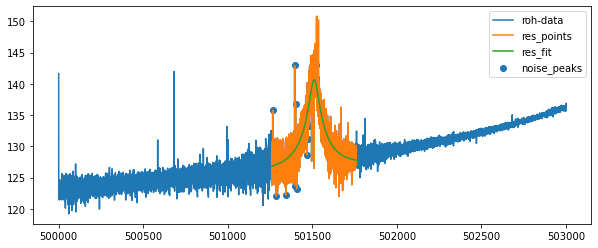

...End fiting resonator
{'A': 113199306142316.88, 'dA': 5.412586894437086e-09, 'off': 4344944828170.01, 'doff': 9.901184230626895e-08, 'Q': 10378.16889868578, 'dQ': 97.90466175616153, 'th': 0.0003014974662788929, 'dth': 4.304931462986846e-05, 'nu_res': 501510.75705201575, 'dnu_res': 0.5336209939038337, 'fit_err_chi**2_red': 3.0438311927195514}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


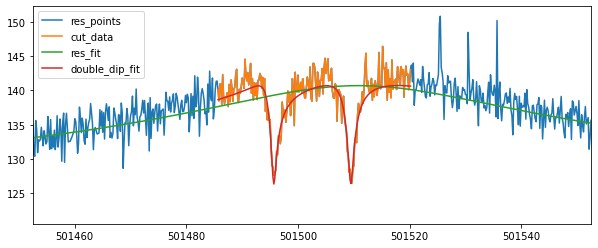

501495.6719383555 0.054758765992083604 501509.4604094615 0.05612753647830935
cycle7 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.8333333333 1234.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


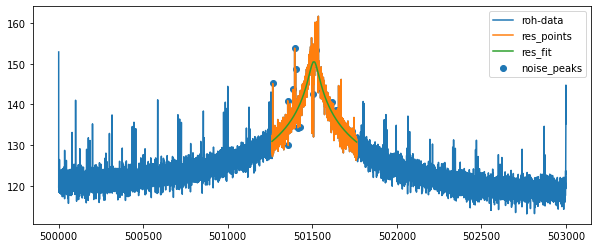

...End fiting resonator
{'A': 1135612029329996.2, 'dA': 2.2131996739831748e-10, 'off': 99256.45541933179, 'doff': 3.9363409379140764e-09, 'Q': 9603.7056251988, 'dQ': 47.94020346689864, 'th': 4.112044632717033e-30, 'dth': 5.139391767384465e-05, 'nu_res': 501509.3027983702, 'dnu_res': 0.5253252059513854, 'fit_err_chi**2_red': 3.0245153750185567}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


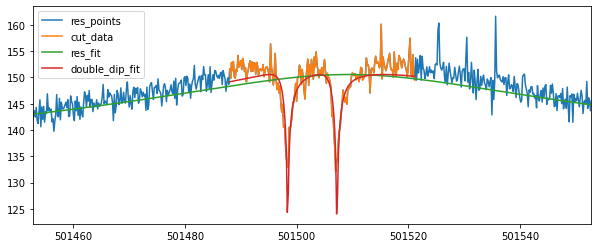

501498.39959285804 0.01543573686626928 501507.2316478738 0.015328979668747049
[501502.7328539701, 501502.6005734301]
503840.97 501502.6667137001 501495.6719383555 501509.4604094615 0.031984182472427326 0.054758765992083604 0.05612753647830935
53273922.2 501502.6667137001 501498.39959285804 501507.2316478738 0.031984182472427326 0.01543573686626928 0.015328979668747049
['cycle7', 'position_1', 3, 0.03, '20211217_232346.857707', 53775425.164527036, 0.03868110027803103, 2338.5043658831273, 0.08468654398739653, 501502.6667137001, 0.031984182472427326, 5.003709902823911, 0.18366067631382266, True, 501508.75969171786, 0.28654753250484455]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle7 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [884271819094504.5, 5688.251417768124, 125.08698729521514, -0.

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7971857589056325
...End fiting resonator
{'A': 2420118148737358.0, 'dA': 1.1103245309456624e-10, 'Q': 14545.917290308082, 'dQ': 36.02662630377704, 'nu_res': 501507.7309854322, 'dnu_res': 0.27876585827072703, 'fit_err_chi**2_red': 0.7971857589056325}
resonator fit results:  [ 2.420118148737e+15  1.454591729031e+04  4.997061137311e+11
 -2.562586082127e-04  5.015077309854e+05] [1.110324530946e-10 3.602662630378e+01 4.282076331670e-08
 9.118750964612e-06 2.787658582707e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9281363715880497


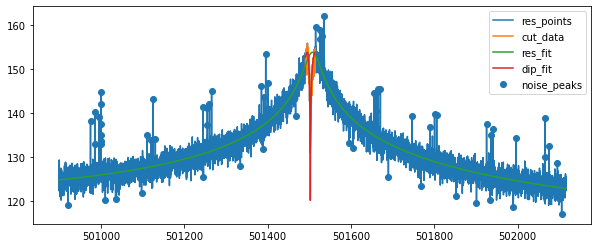

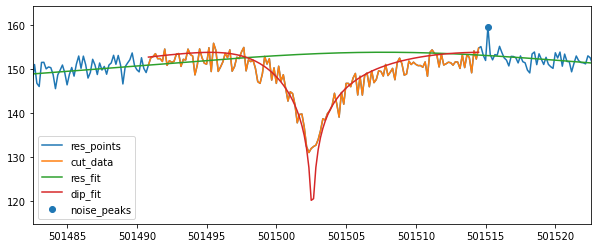

{'A': 2420118148737358.0, 'dA': 1.1103245309456624e-10, 'Q': 14545.917290308082, 'dQ': 36.02662630377704, 'nu_res': 501507.7309854322, 'dnu_res': 0.27876585827072703, 'nu_z': 501502.57969890785, 'dnu_z': 0.024558542741145932, 'dip_width': 5.304798394302174, 'ddip_width': 0.23384338255632744, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.9281363715880497, 'fit_success': True}
cycle7 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [923806706011463.5, 5877.136718751337, 124.71894836425781, -0.0018344298233477357, 501515.6666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.811855484016865
...End fiting resonator
{'A': 2248742765207503.2, 'dA': 1.1149357918126398e-10, 'Q': 14023.60509109771, 'dQ': 34.84589330941017, 'nu_res': 501508.8732083876, 'dnu_res': 0.2864034269893377, 'fit_err_chi**2_red': 0.811855484016865}
resonator fit results:  [ 2.248742765208e+15  1.402360509110e+04  5.242470036164e+11
 -2.619890308719e-04  5.015088732084e+05] [1.114935791813e-10 3.484589330941e+01 4.084023230151e-08
 8.965481786316e-06 2.864034269893e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6007066820482272


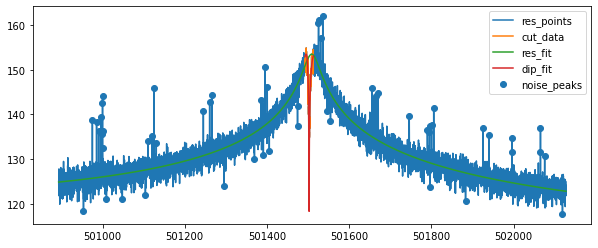

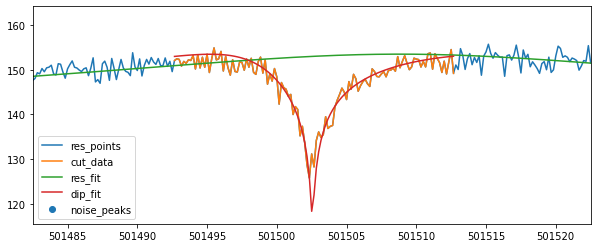

{'A': 2248742765207503.2, 'dA': 1.1149357918126398e-10, 'Q': 14023.60509109771, 'dQ': 34.84589330941017, 'nu_res': 501508.8732083876, 'dnu_res': 0.2864034269893377, 'nu_z': 501502.54589645495, 'dnu_z': 0.02484776032635023, 'dip_width': 5.566214594843739, 'ddip_width': 0.2190886746932255, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.6007066820482272, 'fit_success': True}
cycle7 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.3333333333 457.3333333330229
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


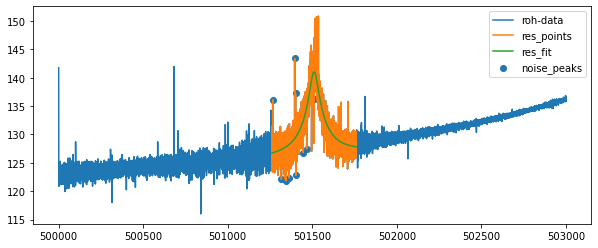

...End fiting resonator
{'A': 124832860847196.25, 'dA': 5.327277547188693e-09, 'off': 4332511058912.2, 'doff': 1.0728251256656465e-07, 'Q': 11119.248891938203, 'dQ': 100.07352602923406, 'th': 0.0003509147528819534, 'dth': 4.114094617985022e-05, 'nu_res': 501510.3344171917, 'dnu_res': 0.4852280761847071, 'fit_err_chi**2_red': 2.9085210566531643}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


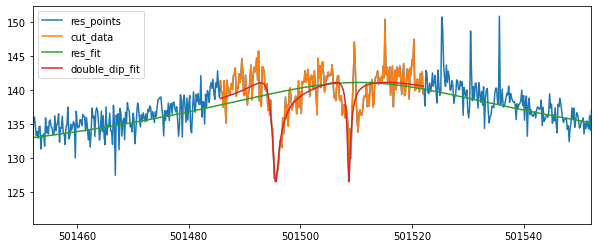

501495.58021638356 0.06845834855914812 501508.69789963757 0.0460852737814063
cycle7 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501508.1666666667 1226.666666666977
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


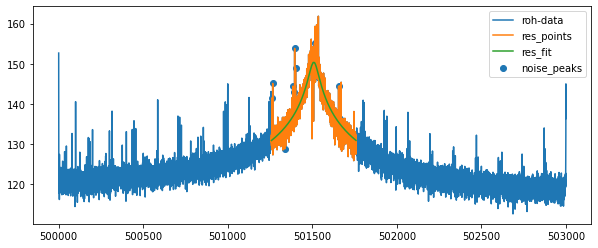

...End fiting resonator
{'A': 1096042725885584.1, 'dA': 2.259493288829242e-10, 'off': 154360.34160950288, 'doff': 9.142183567520137e-09, 'Q': 9415.543221957307, 'dQ': 48.09311119508218, 'th': 2.755014577653515e-20, 'dth': 5.267263144943854e-05, 'nu_res': 501508.6355008855, 'dnu_res': 0.5445762841571071, 'fit_err_chi**2_red': 3.216012093931982}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


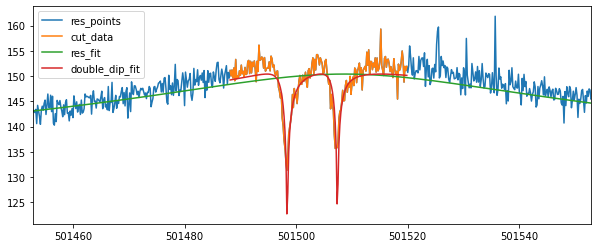

501498.3956285658 0.01558462039038242 501507.39688490226 0.015800615850820474
[501502.57969890785, 501502.54589645495]
503840.97 501502.5627976814 501495.58021638356 501508.69789963757 0.03493613050703292 0.06845834855914812 0.0460852737814063
53273922.2 501502.5627976814 501498.3956285658 501507.39688490226 0.03493613050703292 0.01558462039038242 0.015800615850820474
['cycle7', 'position_1', 3, 0.05, '20211217_232949.142142', 53775425.42971579, 0.041389286884192134, 2339.25468166027, 0.0896154627380645, 501502.5627976814, 0.03493613050703292, 5.566214594843739, 0.2190886746932255, True, 501508.8732083876, 0.2864034269893377]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [849922695540927.8, 5731.613333333334, 124.81454388985865, -0.00176

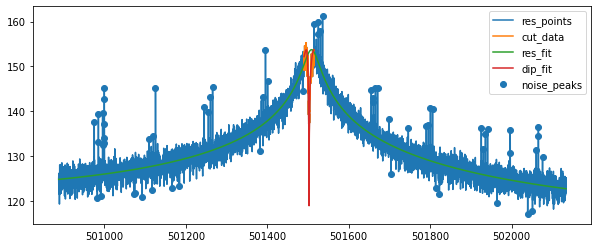

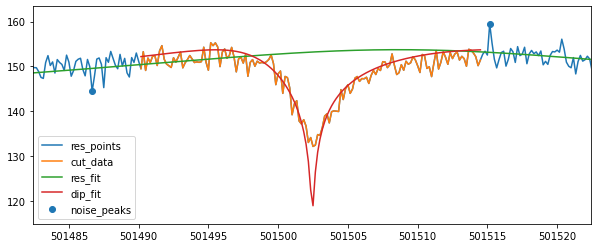

{'A': 2360698588436548.5, 'dA': 1.146432329954233e-10, 'Q': 14592.231319133625, 'dQ': 36.16710129716219, 'nu_res': 501508.6680275534, 'dnu_res': 0.27690120802896984, 'nu_z': 501502.4507197236, 'dnu_z': 0.027450463897870037, 'dip_width': 5.305590442377963, 'ddip_width': 0.23454600654220037, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 1.949852257050323, 'fit_success': True}
cycle8 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [839843913574959.0, 5666.824858757062, 124.75120894560553, -0.0016121132900359975, 501514.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8099290774996023
...End fiting resonator
{'A': 2163766505725469.5, 'dA': 1.1297098914931128e-10, 'Q': 13906.549575164545, 'dQ': 34.24363298879305, 'nu_res': 501507.83318077086, 'dnu_res': 0.2841573107745612, 'fit_err_chi**2_red': 0.8099290774996023}
resonator fit results:  [ 2.163766505725e+15  1.390654957516e+04  5.362045455593e+11
 -2.402595835612e-04  5.015078331808e+05] [1.129709891493e-10 3.424363298879e+01 4.164939906769e-08
 8.674625852267e-06 2.841573107746e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.8528392825549789


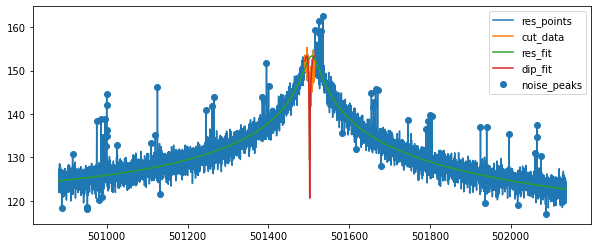

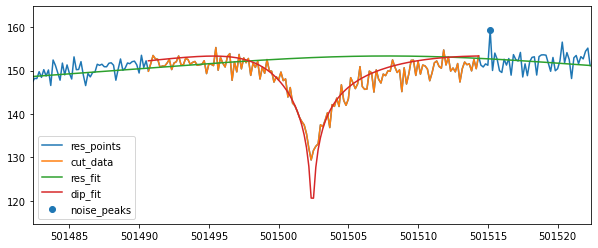

{'A': 2163766505725469.5, 'dA': 1.1297098914931128e-10, 'Q': 13906.549575164545, 'dQ': 34.24363298879305, 'nu_res': 501507.83318077086, 'dnu_res': 0.2841573107745612, 'nu_z': 501502.41638404614, 'dnu_z': 0.024171887041975353, 'dip_width': 4.939670140304209, 'ddip_width': 0.21897448912645345, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.8528392825549789, 'fit_success': True}
cycle8 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501506.6666666667 433.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


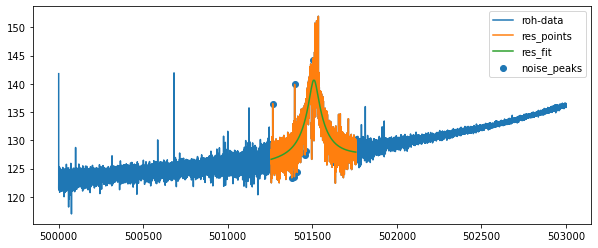

...End fiting resonator
{'A': 113336141602081.5, 'dA': 5.651340331996137e-09, 'off': 4338982773381.9653, 'doff': 1.0483106548238008e-07, 'Q': 10558.935702391438, 'dQ': 100.66639557612703, 'th': 0.00039393598458781383, 'dth': 4.313288687984987e-05, 'nu_res': 501509.3689950302, 'dnu_res': 0.5298501637110066, 'fit_err_chi**2_red': 3.09034275464503}
Start fiting double dip....
Fit is NOT GOOD !!!!!


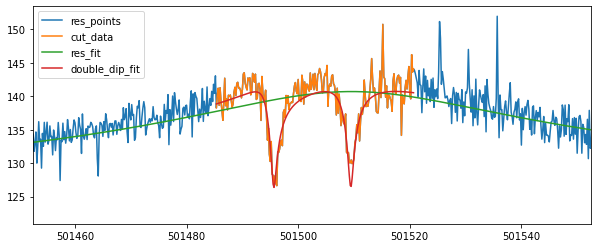

501495.63614058844 0.06637170081636044 501509.42912798695 0.06542722938790313
cycle8 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.1666666667 1250.666666666977
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



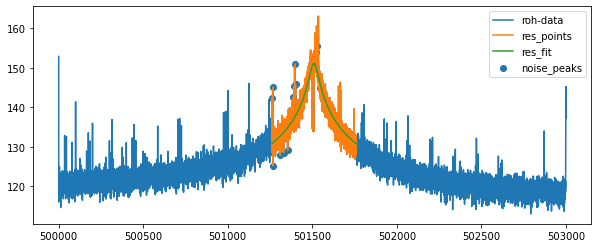

...End fiting resonator
{'A': 1296706751498076.8, 'dA': 2.2385454159034395e-10, 'off': 6577360.161651522, 'doff': 9.178152850906106e-09, 'Q': 10408.437845490775, 'dQ': 51.457092924340444, 'th': 7.406628802134475e-34, 'dth': 5.063638646831262e-05, 'nu_res': 501509.13173367904, 'dnu_res': 0.4943204876294251, 'fit_err_chi**2_red': 2.914532732836775}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


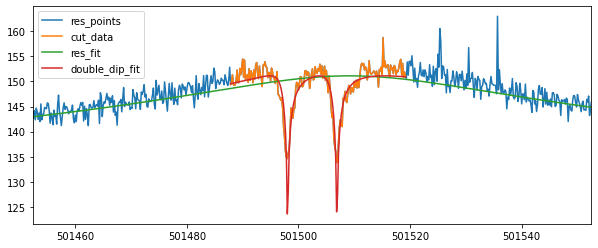

501498.06136999116 0.01327560757588684 501506.90050743025 0.013691155607833308
[501502.4507197236, 501502.41638404614]
503840.97 501502.43355188484 501495.63614058844 501509.42912798695 0.03657605899189089 0.06637170081636044 0.06542722938790313
53273922.2 501502.43355188484 501498.06136999116 501506.90050743025 0.03657605899189089 0.01327560757588684 0.013691155607833308
['cycle8', 'position_1', 3, -0.005, '20211218_002410.139900', 53775424.72832554, 0.04124921320177067, 2338.338283309422, 0.10011859520594583, 501502.43355188484, 0.03657605899189089, 4.939670140304209, 0.21897448912645345, True, 501507.83318077086, 0.2841573107745612]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [869623638792663.1, 5731.601904761905, 124.72047424316406,

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8121258946514581
...End fiting resonator
{'A': 2339917293002843.5, 'dA': 1.1533597573011859e-10, 'Q': 14504.82038202236, 'dQ': 36.28027125576593, 'nu_res': 501508.95266942494, 'dnu_res': 0.2810906758241012, 'fit_err_chi**2_red': 0.8121258946514581}
resonator fit results:  [ 2.339917293003e+15  1.450482038202e+04  5.466009871277e+11
 -2.559394379339e-04  5.015089526694e+05] [1.153359757301e-10 3.628027125577e+01 4.425366672302e-08
 9.035310981777e-06 2.810906758241e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.395176972916776
Fit is NOT GOOD !!!!!


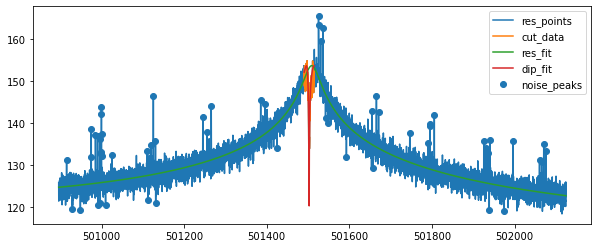

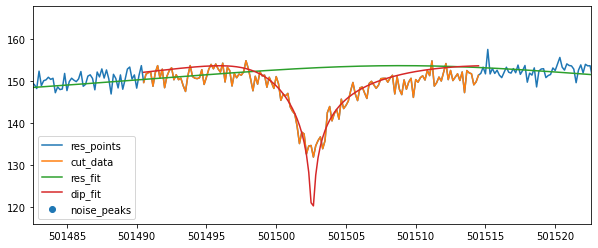

{'A': 2339917293002843.5, 'dA': 1.1533597573011859e-10, 'Q': 14504.82038202236, 'dQ': 36.28027125576593, 'nu_res': 501508.95266942494, 'dnu_res': 0.2810906758241012, 'nu_z': 501502.5893932881, 'dnu_z': 0.02748562169371454, 'dip_width': 5.021666189559346, 'ddip_width': 0.25195395578140495, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.395176972916776, 'fit_success': True}
cycle8 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [913981968354186.9, 5935.094674556213, 124.5670166015625, -0.00167670869187185, 501515.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8017820837052286
...End fiting resonator
{'A': 2347341188317994.0, 'dA': 1.1753973411987812e-10, 'Q': 14602.146718914672, 'dQ': 36.83396655277852, 'nu_res': 501508.75530313776, 'dnu_res': 0.2799974889393952, 'fit_err_chi**2_red': 0.8017820837052286}
resonator fit results:  [ 2.347341188318e+15  1.460214671891e+04  5.667410356876e+11
 -2.621599214177e-04  5.015087553031e+05] [1.175397341199e-10 3.683396655278e+01 4.431722288696e-08
 9.233941826673e-06 2.799974889394e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.4589524026612477


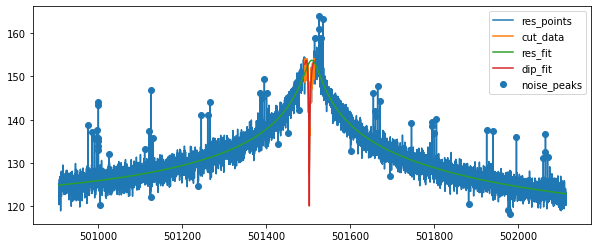

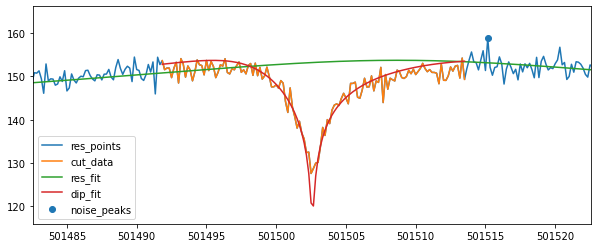

{'A': 2347341188317994.0, 'dA': 1.1753973411987812e-10, 'Q': 14602.146718914672, 'dQ': 36.83396655277852, 'nu_res': 501508.75530313776, 'dnu_res': 0.2799974889393952, 'nu_z': 501502.58966133336, 'dnu_z': 0.02297768720519094, 'dip_width': 5.494453973239412, 'ddip_width': 0.20853142184981074, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.4589524026612477, 'fit_success': True}
cycle8 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.6666666667 450.6666666669771
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


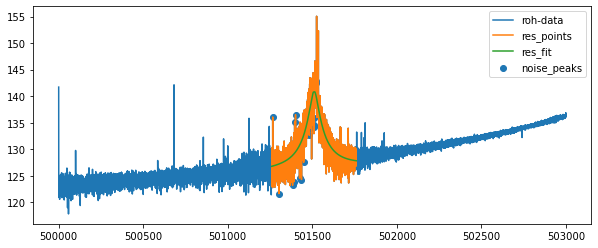

...End fiting resonator
{'A': 119724392032401.33, 'dA': 5.395294481996958e-09, 'off': 4385489777935.4424, 'doff': 1.0441845994097633e-07, 'Q': 10886.769279318152, 'dQ': 98.85391576769632, 'th': 0.00032903117402054464, 'dth': 4.111882788359038e-05, 'nu_res': 501510.7223930648, 'dnu_res': 0.49405736346647117, 'fit_err_chi**2_red': 3.0885955285451776}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


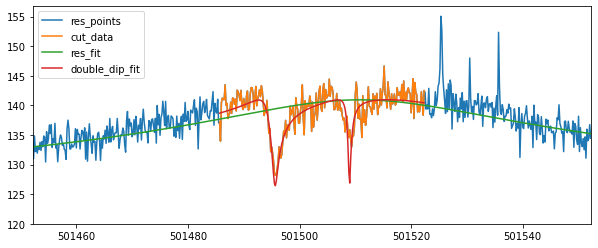

501495.6340765444 0.06588909328166198 501508.9517252467 0.03864383007644522
cycle8 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.5 1240.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



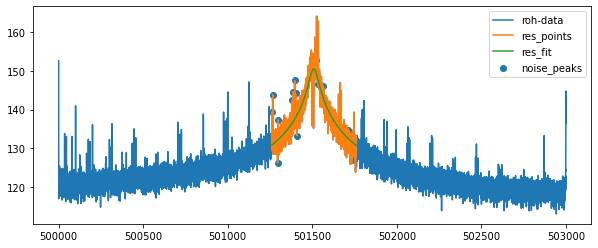

...End fiting resonator
{'A': 1128108313114062.0, 'dA': 2.2687657166521416e-10, 'off': 54703.585809537064, 'doff': 5.875496655738524e-09, 'Q': 9699.030842612301, 'dQ': 48.38435540492496, 'th': 5.693387613880469e-24, 'dth': 5.1330465338424496e-05, 'nu_res': 501508.5835134169, 'dnu_res': 0.5217125529748916, 'fit_err_chi**2_red': 3.238948042887799}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


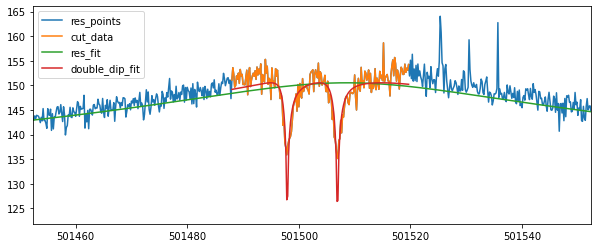

501497.9116089837 0.016351779543177403 501506.9148697859 0.016304498242512247
[501502.5893932881, 501502.58966133336]
503840.97 501502.5895273107 501495.6340765444 501508.9517252467 0.035825040253844614 0.06588909328166198 0.03864383007644522
53273922.2 501502.5895273107 501497.9116089837 501506.9148697859 0.035825040253844614 0.016351779543177403 0.016304498242512247
['cycle8', 'position_1', 3, -0.02, '20211218_003614.721589', 53775424.436951466, 0.04262218748912762, 2338.9737255196087, 0.08436913965216378, 501502.5895273107, 0.035825040253844614, 5.494453973239412, 0.20853142184981074, True, 501508.75530313776, 0.2799974889393952]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [881219706330428.8, 5786.703846152551, 124.72743225097656, -0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8104310145977208
...End fiting resonator
{'A': 2250405253299237.5, 'dA': 1.1419491056992336e-10, 'Q': 14189.464898257207, 'dQ': 35.28034993568132, 'nu_res': 501508.2867160123, 'dnu_res': 0.28047946023768183, 'fit_err_chi**2_red': 0.8104310145977208}
resonator fit results:  [ 2.250405253299e+15  1.418946489826e+04  5.615889004886e+11
 -2.569217843736e-04  5.015082867160e+05] [1.141949105699e-10 3.528034993568e+01 4.113385611997e-08
 9.074700588814e-06 2.804794602377e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.2868842845616892


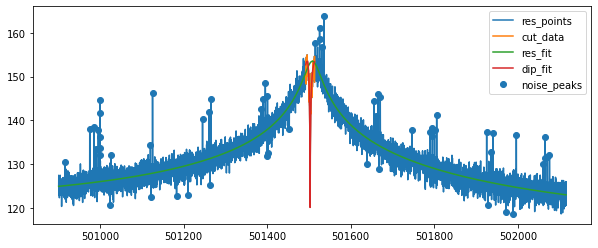

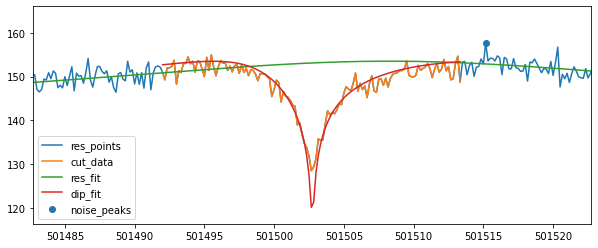

{'A': 2250405253299237.5, 'dA': 1.1419491056992336e-10, 'Q': 14189.464898257207, 'dQ': 35.28034993568132, 'nu_res': 501508.2867160123, 'dnu_res': 0.28047946023768183, 'nu_z': 501502.73863486387, 'dnu_z': 0.020419910564777214, 'dip_width': 5.083263686493618, 'ddip_width': 0.18457415999246907, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.2868842845616892, 'fit_success': True}
cycle8 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [856930821672597.5, 5731.620952380952, 124.637939453125, -0.0016141362620638118, 501516.8333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7988880589277532
...End fiting resonator
{'A': 2363320435460913.5, 'dA': 1.1496759811301181e-10, 'Q': 14617.2788692066, 'dQ': 36.2412931710724, 'nu_res': 501508.37049515394, 'dnu_res': 0.2755134468232012, 'fit_err_chi**2_red': 0.7988880589277532}
resonator fit results:  [ 2.363320435461e+15  1.461727886921e+04  6.170274211862e+11
 -2.566734987011e-04  5.015083704952e+05] [1.149675981130e-10 3.624129317107e+01 4.496738053587e-08
 8.725018830009e-06 2.755134468232e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6524954514377332


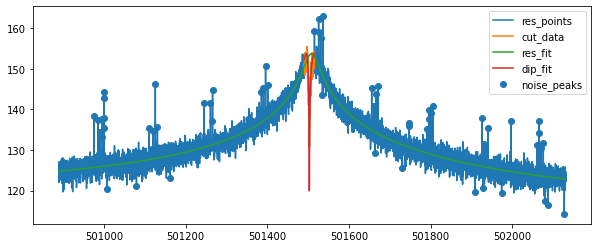

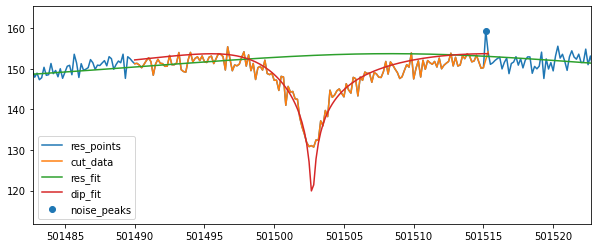

{'A': 2363320435460913.5, 'dA': 1.1496759811301181e-10, 'Q': 14617.2788692066, 'dQ': 36.2412931710724, 'nu_res': 501508.37049515394, 'dnu_res': 0.2755134468232012, 'nu_z': 501502.7343890127, 'dnu_z': 0.024621545225442423, 'dip_width': 5.432456856599086, 'ddip_width': 0.2169455036156691, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.6524954514377332, 'fit_success': True}
cycle8 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501506.6666666667 428.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


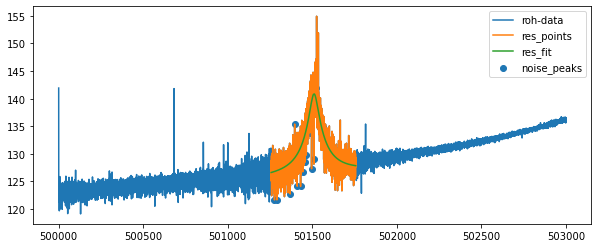

...End fiting resonator
{'A': 118108866199071.05, 'dA': 5.522631650883741e-09, 'off': 4287232705293.1426, 'doff': 1.0644393968629902e-07, 'Q': 10771.701631144779, 'dQ': 100.9218035250255, 'th': 0.00037938335049748684, 'dth': 4.281166751785736e-05, 'nu_res': 501510.06100356166, 'dnu_res': 0.5165515343429974, 'fit_err_chi**2_red': 3.18098554422338}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


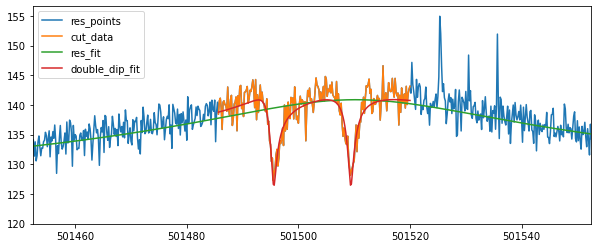

501495.59458881983 0.05723533201835148 501509.39745967643 0.05679851617008373
cycle8 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.0 1244.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


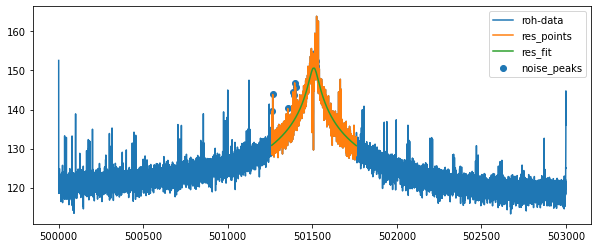

...End fiting resonator
{'A': 1170907931922091.8, 'dA': 2.2812202820656767e-10, 'off': 8902.951644903049, 'doff': 5.792476702057947e-17, 'Q': 9862.880885520899, 'dQ': 49.733431087084035, 'th': 6.358620842887088e-13, 'dth': 5.182889804690813e-05, 'nu_res': 501508.5218087658, 'dnu_res': 0.5217457674296496, 'fit_err_chi**2_red': 3.0995163778001777}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


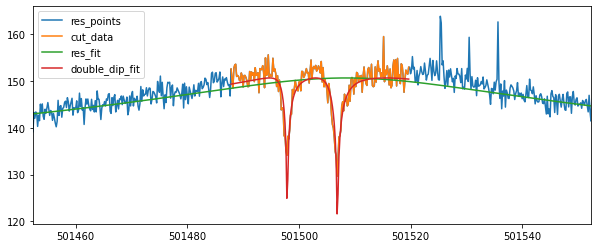

501497.89656860044 0.01474107040167275 501506.89592864906 0.014524778819722767
[501502.73863486387, 501502.7343890127]
503840.97 501502.7365119383 501495.59458881983 501509.39745967643 0.031987391840567536 0.05723533201835148 0.05679851617008373
53273922.2 501502.7365119383 501497.89656860044 501506.89592864906 0.031987391840567536 0.01474107040167275 0.014524778819722767
['cycle8', 'position_1', 3, -0.04, '20211218_001807.809273', 53775424.25598532, 0.03809805235324958, 2338.714463441982, 0.08674761038285837, 501502.7365119383, 0.031987391840567536, 5.432456856599086, 0.2169455036156691, True, 501508.37049515394, 0.2755134468232012]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [900986973373794.2, 5865.639376218323, 125.04975755820413, -

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7970110232849674
...End fiting resonator
{'A': 2414229072401497.5, 'dA': 1.1603805221263343e-10, 'Q': 14817.182282561998, 'dQ': 36.880580515638584, 'nu_res': 501508.6469506869, 'dnu_res': 0.2751667192312962, 'fit_err_chi**2_red': 0.7970110232849674}
resonator fit results:  [ 2.414229072401e+15  1.481718228256e+04  5.907293246063e+11
 -2.572572221226e-04  5.015086469507e+05] [1.160380522126e-10 3.688058051564e+01 4.619364127326e-08
 8.879173246894e-06 2.751667192313e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.160018777511246
Fit is NOT GOOD !!!!!


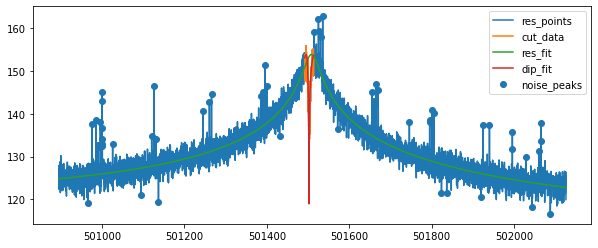

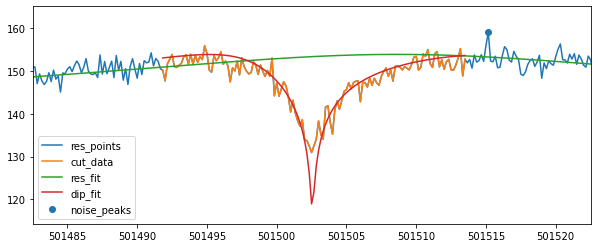

{'A': 2414229072401497.5, 'dA': 1.1603805221263343e-10, 'Q': 14817.182282561998, 'dQ': 36.880580515638584, 'nu_res': 501508.6469506869, 'dnu_res': 0.2751667192312962, 'nu_z': 501502.55291299813, 'dnu_z': 0.02963711646600803, 'dip_width': 5.845867222177514, 'ddip_width': 0.26080661584908316, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.160018777511246, 'fit_success': True}
cycle8 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [880024914063940.0, 5831.554263565892, 124.45052808134514, -0.0017763698561109168, 501513.6666666667]
Start fiting resonator....
chi_reduziert =  0.8009292800142336
...End fiting resonator
{'A': 2331043698021981.5, 'dA': 1.1365003836753161e-10, 'Q': 14493.963198352707, 'dQ': 35.641912541945935, 'nu_res': 501508.75607669144, 'dnu_res': 0.27587427388832486, 'fit_err_chi**2_red': 0.8009292800142336}
resonator fit results:  [ 2.331043698022e+15  1.449396319835e+04  6.004478051910e+11
 -2.748514398459e-04  5.015087560767

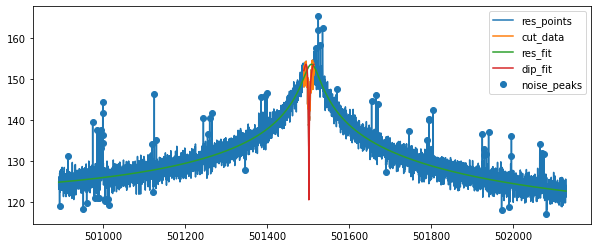

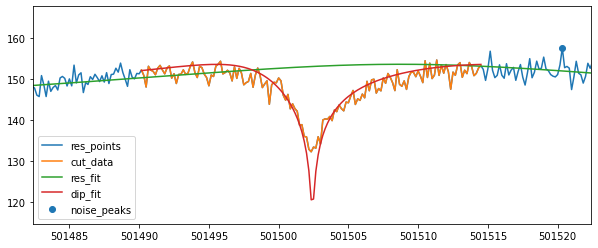

{'A': 2331043698021981.5, 'dA': 1.1365003836753161e-10, 'Q': 14493.963198352707, 'dQ': 35.641912541945935, 'nu_res': 501508.75607669144, 'dnu_res': 0.27587427388832486, 'nu_z': 501502.4143296778, 'dnu_z': 0.026781618557894495, 'dip_width': 5.266007113825266, 'ddip_width': 0.23884166840929416, 'dip_guess': 501502.3333333333, 'fit_err_chi**2_red': 2.1052590955203248, 'fit_success': True}
cycle8 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.6666666667 454.6666666669771
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



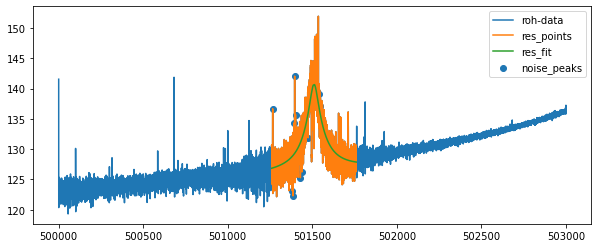

...End fiting resonator
{'A': 113849990204243.11, 'dA': 5.792750760652888e-09, 'off': 4468601361715.942, 'doff': 1.0771956308035584e-07, 'Q': 10753.679739669982, 'dQ': 101.64602464938879, 'th': 0.00032377255295952507, 'dth': 4.193745423354652e-05, 'nu_res': 501509.91903956176, 'dnu_res': 0.512343080214975, 'fit_err_chi**2_red': 3.070112552619456}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


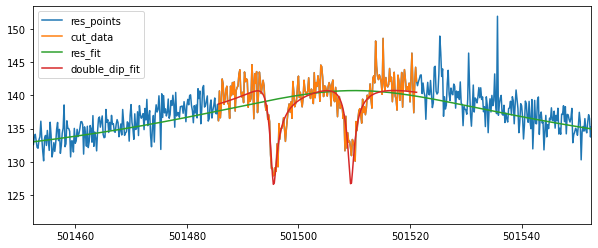

501495.5648881926 0.06428359024226246 501509.4087822765 0.06198906609525551
cycle8 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.5 1233.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



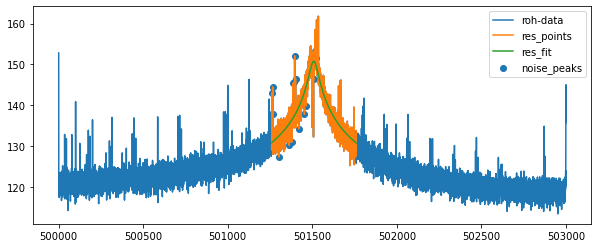

...End fiting resonator
{'A': 1210850968751208.0, 'dA': 2.2944850718050683e-10, 'off': 261.28535416326486, 'doff': 0.0, 'Q': 10013.006600559236, 'dQ': 51.02294755751785, 'th': 2.7346749990700803e-16, 'dth': 5.2324025998593065e-05, 'nu_res': 501508.3334968946, 'dnu_res': 0.5221981101567603, 'fit_err_chi**2_red': 3.039027689815919}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


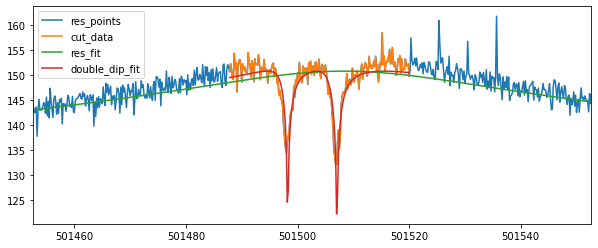

501498.2380851739 0.015972865560223534 501507.06494793785 0.015485166304594735
[501502.55291299813, 501502.4143296778]
503840.97 501502.483621338 501495.5648881926 501509.4087822765 0.03994513443462524 0.06428359024226246 0.06198906609525551
53273922.2 501502.483621338 501498.2380851739 501507.06494793785 0.03994513443462524 0.015972865560223534 0.015485166304594735
['cycle8', 'position_1', 3, 0.002, '20211218_003012.454680', 53775425.01941178, 0.04572238592512659, 2338.4799508688156, 0.09782963791611078, 501502.483621338, 0.03994513443462524, 5.266007113825266, 0.23884166840929416, True, 501508.75607669144, 0.27587427388832486]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [920446258630803.9, 5797.836223506743, 124.95891657044115, -0.001

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8029991426908147
...End fiting resonator
{'A': 2575934299839015.5, 'dA': 1.1179526219612806e-10, 'Q': 15076.756559163674, 'dQ': 37.28756060672578, 'nu_res': 501508.43422464485, 'dnu_res': 0.27273138666954083, 'fit_err_chi**2_red': 0.8029991426908147}
resonator fit results:  [ 2.575934299839e+15  1.507675655916e+04  5.809446375242e+11
 -2.550023896625e-04  5.015084342246e+05] [1.117952621961e-10 3.728756060673e+01 4.679986731217e-08
 8.797582163509e-06 2.727313866695e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5569391962704822


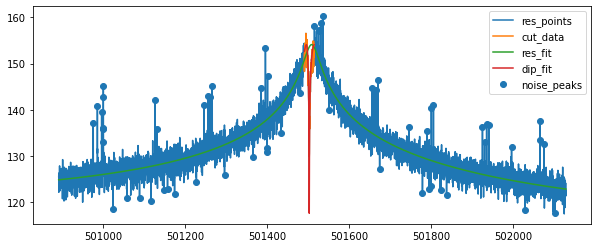

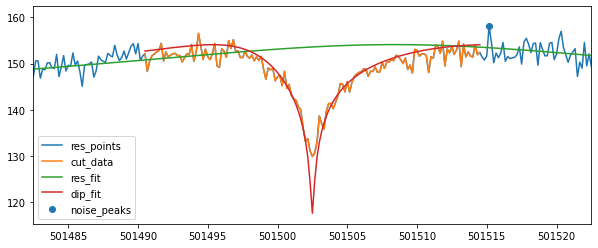

{'A': 2575934299839015.5, 'dA': 1.1179526219612806e-10, 'Q': 15076.756559163674, 'dQ': 37.28756060672578, 'nu_res': 501508.43422464485, 'dnu_res': 0.27273138666954083, 'nu_z': 501502.4953968647, 'dnu_z': 0.028227241330344655, 'dip_width': 5.601246198684372, 'ddip_width': 0.21446779953703832, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.5569391962704822, 'fit_success': True}
cycle8 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [855127537677626.8, 5764.5344827586205, 124.64036560058594, -0.001761119465039231, 501514.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8071479381108316
...End fiting resonator
{'A': 2374888477787200.0, 'dA': 1.1580342312905842e-10, 'Q': 14729.695785929902, 'dQ': 36.43220482169288, 'nu_res': 501508.984129296, 'dnu_res': 0.2762126770895946, 'fit_err_chi**2_red': 0.8071479381108316}
resonator fit results:  [ 2.374888477787e+15  1.472969578593e+04  5.937154274330e+11
 -2.645284268747e-04  5.015089841293e+05] [1.158034231291e-10 3.643220482169e+01 4.640629061332e-08
 8.700050064474e-06 2.762126770896e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6657316012960515


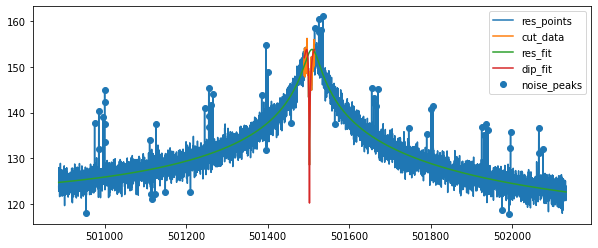

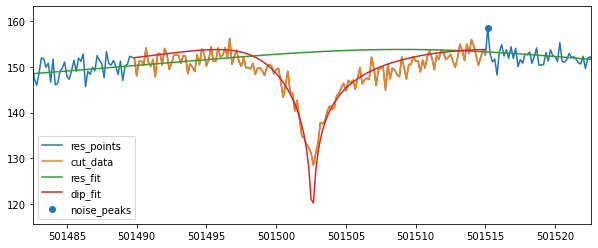

{'A': 2374888477787200.0, 'dA': 1.1580342312905842e-10, 'Q': 14729.695785929902, 'dQ': 36.43220482169288, 'nu_res': 501508.984129296, 'dnu_res': 0.2762126770895946, 'nu_z': 501502.59079363977, 'dnu_z': 0.023988461219538567, 'dip_width': 5.322469369778819, 'ddip_width': 0.2144078541055479, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.6657316012960515, 'fit_success': True}
cycle8 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501511.0 457.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


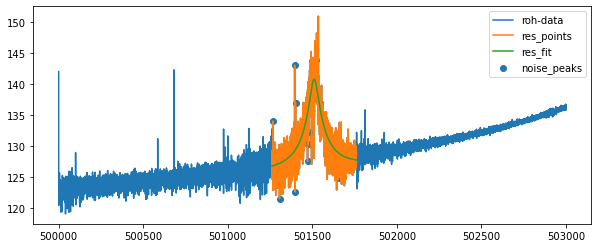

...End fiting resonator
{'A': 116258621169787.56, 'dA': 5.603759607905711e-09, 'off': 4337592988382.652, 'doff': 1.0687939075023793e-07, 'Q': 10793.696423826746, 'dQ': 100.40773600448173, 'th': 0.00031425379775369987, 'dth': 4.201814903767233e-05, 'nu_res': 501510.8372429387, 'dnu_res': 0.5084399246055483, 'fit_err_chi**2_red': 3.0850487469526526}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


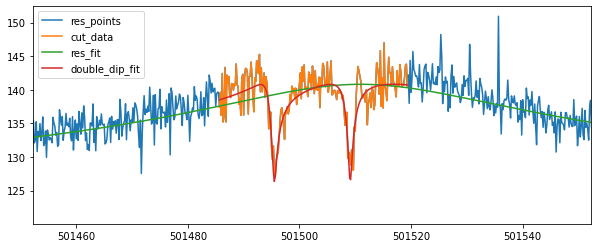

501495.5173376093 0.06337006999066387 501509.09929452045 0.058557838265384965
cycle8 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.6666666667 1240.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



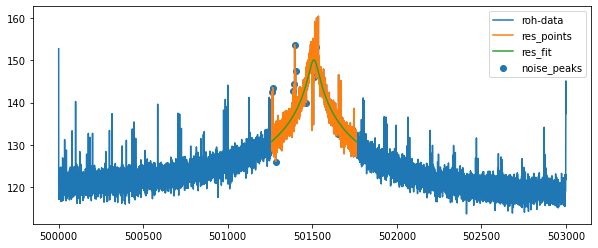

...End fiting resonator
{'A': 1037141291791135.1, 'dA': 2.2707246790845435e-10, 'off': 11.718443896621466, 'doff': 5.159194566088596e-15, 'Q': 9251.918767638583, 'dQ': 46.46496241841764, 'th': 4.144678159118974e-19, 'dth': 5.185366554534153e-05, 'nu_res': 501509.08556138107, 'dnu_res': 0.5415623950869087, 'fit_err_chi**2_red': 3.118025852428036}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


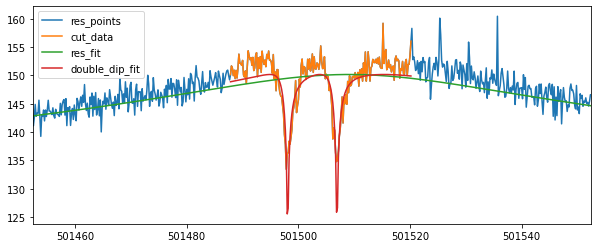

501498.0772256981 0.01718371925779477 501506.9117532694 0.01720649512248404
[501502.4953968647, 501502.59079363977]
503840.97 501502.54309525224 501495.5173376093 501509.09929452045 0.03704353418348232 0.06337006999066387 0.058557838265384965
53273922.2 501502.54309525224 501498.0772256981 501506.9117532694 0.03704353418348232 0.01718371925779477 0.01720649512248404
['cycle8', 'position_1', 3, 0.005, '20211218_000000.924933', 53775424.64588372, 0.04431215529325557, 2338.8964631224517, 0.0938989329957452, 501502.54309525224, 0.03704353418348232, 5.322469369778819, 0.2144078541055479, True, 501508.984129296, 0.2762126770895946]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



Start Values res:  [824524045496509.2, 5699.039772727273, 124.98593171828443, -0.001705013722134312, 501515.5]
Start fiting resonator....
chi_reduziert =  0.799135760143601
...End fiting resonator
{'A': 2182792865591582.8, 'dA': 1.1330212175874432e-10, 'Q': 14009.989015341673, 'dQ': 34.391121236931234, 'nu_res': 501508.79233363963, 'dnu_res': 0.28046100961182024, 'fit_err_chi**2_red': 0.799135760143601}
resonator fit results:  [ 2.182792865592e+15  1.400998901534e+04  5.976812720844e+11
 -2.599964377097e-04  5.015087923336e+05] [1.133021217587e-10 3.439112123693e+01 4.150816287464e-08
 8.597811885111e-06 2.804610096118e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9854790465947338


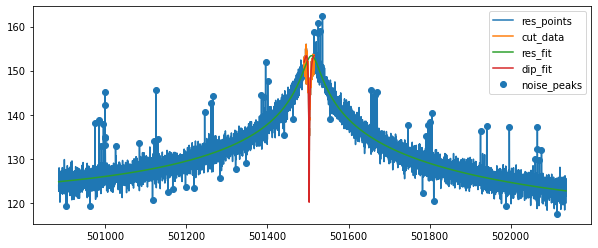

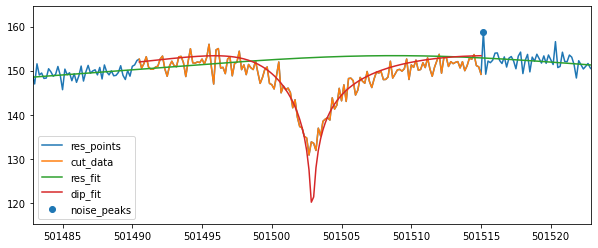

{'A': 2182792865591582.8, 'dA': 1.1330212175874432e-10, 'Q': 14009.989015341673, 'dQ': 34.391121236931234, 'nu_res': 501508.79233363963, 'dnu_res': 0.28046100961182024, 'nu_z': 501502.9048278007, 'dnu_z': 0.025931178785409223, 'dip_width': 5.036291540090806, 'ddip_width': 0.22716506563866257, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.9854790465947338, 'fit_success': True}
cycle8 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [855860393825674.2, 5645.562851783598, 124.77776336669922, -0.001771813913444866, 501514.1666666667]
Start fiting resonator....
chi_reduziert =  0.7935335880635102
...End fiting resonator
{'A': 2505696312657988.0, 'dA': 1.1369586692622722e-10, 'Q': 14985.525200736576, 'dQ': 37.106123526832405, 'nu_res': 501508.8776806745, 'dnu_res': 0.2744094562488791, 'fit_err_chi**2_red': 0.7935335880635102}
resonator fit results:  [ 2.505696312658e+15  1.498552520074e+04  5.380653840441e+11
 -2.736025656200e-04  5.015088776807

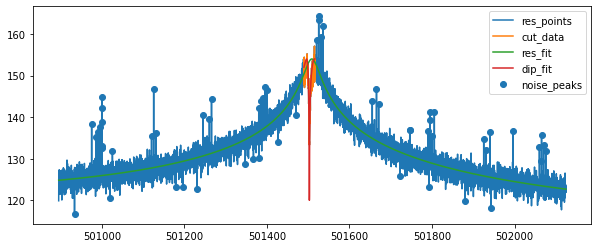

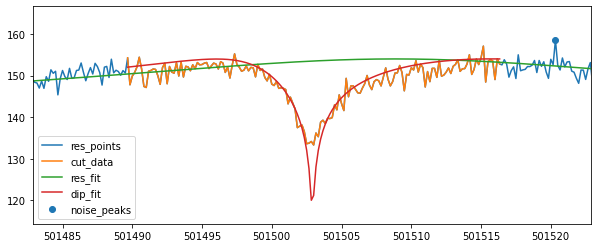

{'A': 2505696312657988.0, 'dA': 1.1369586692622722e-10, 'Q': 14985.525200736576, 'dQ': 37.106123526832405, 'nu_res': 501508.8776806745, 'dnu_res': 0.2744094562488791, 'nu_z': 501502.90589742776, 'dnu_z': 0.026857900405828417, 'dip_width': 5.280129867512361, 'ddip_width': 0.2514480229785573, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 2.258495525661547, 'fit_success': True}
cycle8 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.3333333333 452.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


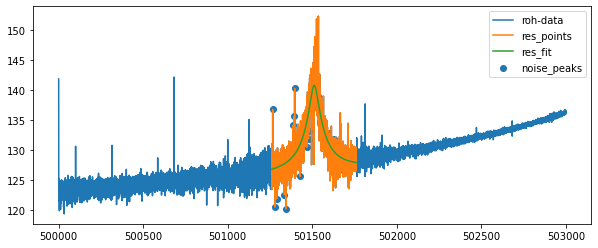

...End fiting resonator
{'A': 115825205714393.83, 'dA': 5.508919478289618e-09, 'off': 4421127825521.265, 'doff': 1.0319212120282413e-07, 'Q': 10678.656211831847, 'dQ': 99.21217595041554, 'th': 0.00035336573806101586, 'dth': 4.183198690586323e-05, 'nu_res': 501510.9653908748, 'dnu_res': 0.5106754891973783, 'fit_err_chi**2_red': 2.9471833558404947}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


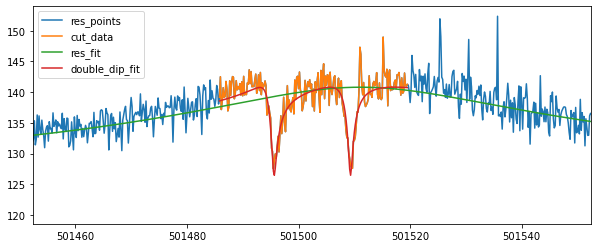

501495.63204882934 0.05910298278106129 501509.31308484485 0.05533262225964783
cycle8 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.1666666667 1213.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



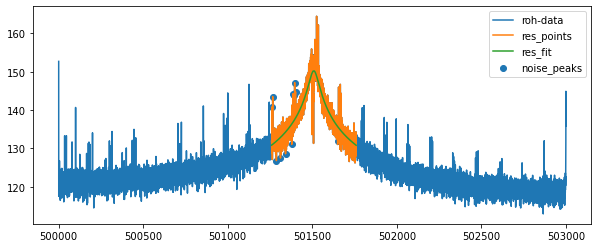

...End fiting resonator
{'A': 1064691647639431.4, 'dA': 2.309447581892815e-10, 'off': 355.820060793194, 'doff': 5.333436417312783e-15, 'Q': 9353.080339058988, 'dQ': 48.038537521624654, 'th': 7.630629684120629e-13, 'dth': 5.2989046277171945e-05, 'nu_res': 501508.6445596016, 'dnu_res': 0.5499556536593414, 'fit_err_chi**2_red': 3.3225744418691394}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


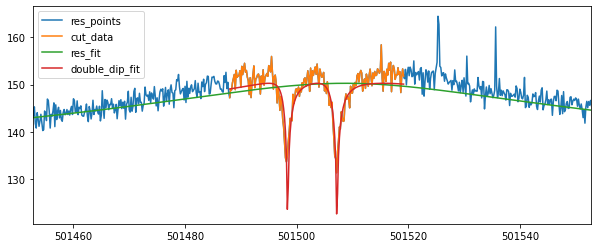

501498.3931229904 0.016144415735695618 501507.22891985567 0.016338732617628412
[501502.9048278007, 501502.90589742776]
503840.97 501502.9053626142 501495.63204882934 501509.31308484485 0.03733326730156705 0.05910298278106129 0.05533262225964783
53273922.2 501502.9053626142 501498.3931229904 501507.22891985567 0.03733326730156705 0.016144415735695618 0.016338732617628412
['cycle8', 'position_1', 3, 0.008, '20211218_000603.181953', 53775424.91668024, 0.04383342549251184, 2338.9302289399784, 0.08915511486817544, 501502.9053626142, 0.03733326730156705, 5.280129867512361, 0.2514480229785573, True, 501508.8776806745, 0.2744094562488791]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [886703921076873.0, 5775.606525912999, 124.75519136311112, -0.0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.809041908083814
...End fiting resonator
{'A': 2297047444915806.0, 'dA': 1.1241415521773266e-10, 'Q': 14296.758059965663, 'dQ': 35.214997717591416, 'nu_res': 501508.3341211061, 'dnu_res': 0.2800302135118978, 'fit_err_chi**2_red': 0.809041908083814}
resonator fit results:  [ 2.297047444916e+15  1.429675805997e+04  5.523074233266e+11
 -2.598765482123e-04  5.015083341211e+05] [1.124141552177e-10 3.521499771759e+01 4.372874292391e-08
 8.640519290856e-06 2.800302135119e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6580394857732021


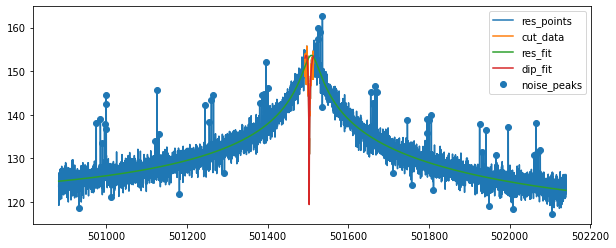

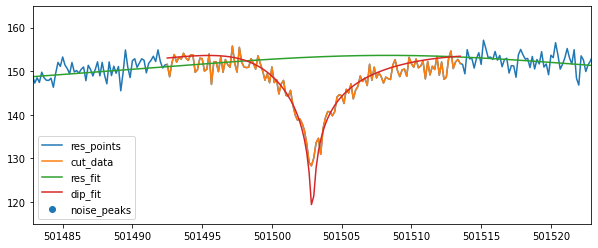

{'A': 2297047444915806.0, 'dA': 1.1241415521773266e-10, 'Q': 14296.758059965663, 'dQ': 35.214997717591416, 'nu_res': 501508.3341211061, 'dnu_res': 0.2800302135118978, 'nu_z': 501502.8970887788, 'dnu_z': 0.024237680769729975, 'dip_width': 5.4535069882680185, 'ddip_width': 0.21920549150164828, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 1.6580394857732021, 'fit_success': True}
cycle8 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [879805338340531.2, 5753.527724667953, 124.20088889361966, -0.0015372971014804072, 501515.8333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7988115492453225
...End fiting resonator
{'A': 2317855836937634.0, 'dA': 1.1368083176749888e-10, 'Q': 14368.108392772952, 'dQ': 35.761518743344105, 'nu_res': 501508.2398055565, 'dnu_res': 0.2828697416820117, 'fit_err_chi**2_red': 0.7988115492453225}
resonator fit results:  [ 2.317855836938e+15  1.436810839277e+04  5.299277650859e+11
 -2.415290680735e-04  5.015082398056e+05] [1.136808317675e-10 3.576151874334e+01 4.469602244344e-08
 8.786227454179e-06 2.828697416820e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.735468494601413


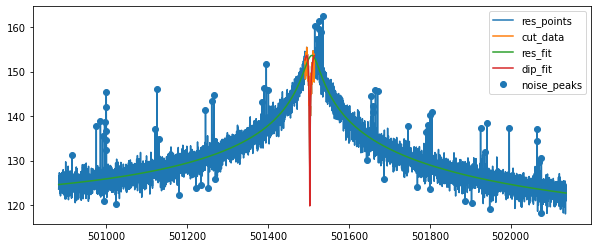

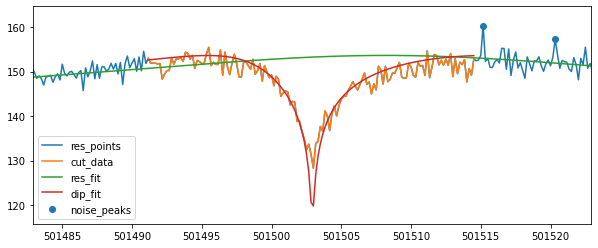

{'A': 2317855836937634.0, 'dA': 1.1368083176749888e-10, 'Q': 14368.108392772952, 'dQ': 35.761518743344105, 'nu_res': 501508.2398055565, 'dnu_res': 0.2828697416820117, 'nu_z': 501502.92434018885, 'dnu_z': 0.024999346475339176, 'dip_width': 5.538134870939354, 'ddip_width': 0.22957424092896972, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.735468494601413, 'fit_success': True}
cycle8 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 452.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



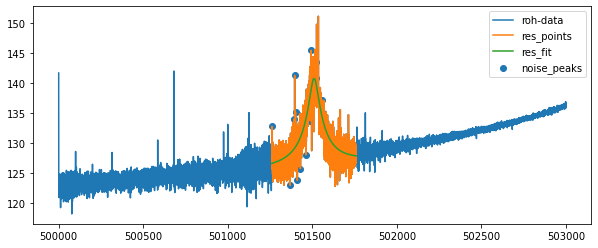

...End fiting resonator
{'A': 118147473406930.25, 'dA': 5.314998913627036e-09, 'off': 4363004712942.0737, 'doff': 1.0281724035775245e-07, 'Q': 10935.034761649658, 'dQ': 95.63548630942863, 'th': 0.0003986745019813765, 'dth': 3.9379016323293097e-05, 'nu_res': 501510.21745547524, 'dnu_res': 0.47265200174199135, 'fit_err_chi**2_red': 2.800257761857543}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


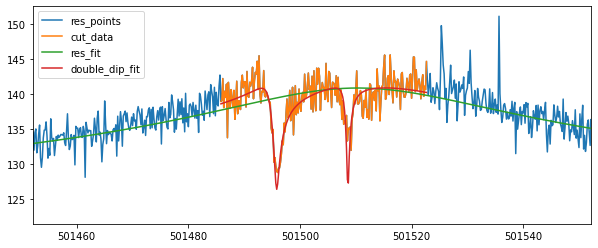

501495.8320848519 0.06487483785787282 501508.5920643048 0.04162029326159223
cycle8 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.0 1260.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



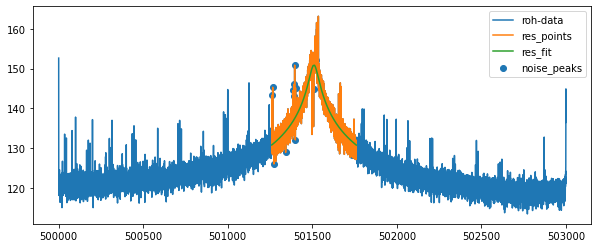

...End fiting resonator
{'A': 1236681717845752.5, 'dA': 2.2602886061213581e-10, 'off': 256.4621482785442, 'doff': 1.1325046948446783e-14, 'Q': 10084.542670169303, 'dQ': 51.0031102003548, 'th': 2.9455664320636724e-14, 'dth': 5.1910233276444564e-05, 'nu_res': 501509.53674911504, 'dnu_res': 0.5159684398356749, 'fit_err_chi**2_red': 3.1504499398177743}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


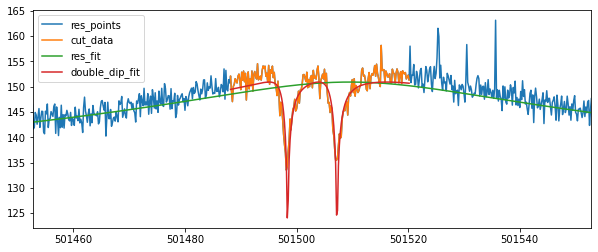

501498.39928058337 0.015121965692091144 501507.2445659449 0.015575859750857244
[501502.8970887788, 501502.92434018885]
503840.97 501502.9107144838 501495.8320848519 501508.5920643048 0.03482000133959491 0.06487483785787282 0.04162029326159223
53273922.2 501502.9107144838 501498.39928058337 501507.2445659449 0.03482000133959491 0.015121965692091144 0.015575859750857244
['cycle8', 'position_1', 3, 0.015, '20211218_001205.515240', 53775424.933132045, 0.04103308112560581, 2339.4565653270693, 0.08457792792186163, 501502.9107144838, 0.03482000133959491, 5.538134870939354, 0.22957424092896972, True, 501508.2398055565, 0.2828697416820117]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [847142219555099.6, 5677.52264150694, 124.82020929293289, -0.001

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7922948676854101
...End fiting resonator
{'A': 2321881115798939.0, 'dA': 1.1377909240675826e-10, 'Q': 14471.100250844718, 'dQ': 35.601945605981236, 'nu_res': 501507.86421521654, 'dnu_res': 0.2779732885183302, 'fit_err_chi**2_red': 0.7922948676854101}
resonator fit results:  [ 2.321881115799e+15  1.447110025084e+04  5.458151138678e+11
 -2.559883446571e-04  5.015078642152e+05] [1.137790924068e-10 3.560194560598e+01 4.458149753089e-08
 8.728645012669e-06 2.779732885183e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5976633452458835


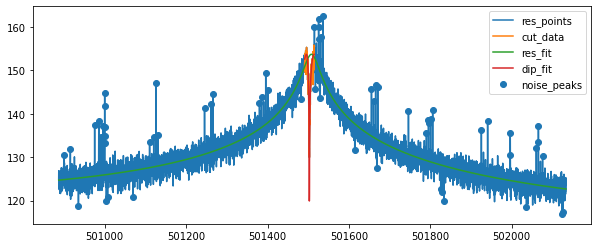

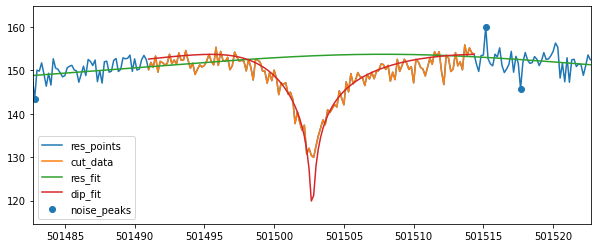

{'A': 2321881115798939.0, 'dA': 1.1377909240675826e-10, 'Q': 14471.100250844718, 'dQ': 35.601945605981236, 'nu_res': 501507.86421521654, 'dnu_res': 0.2779732885183302, 'nu_z': 501502.7378176225, 'dnu_z': 0.02298493539716258, 'dip_width': 5.212444289372555, 'ddip_width': 0.2105422673129576, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.5976633452458835, 'fit_success': True}
cycle8 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [852718712244132.4, 5742.528625955474, 124.50440109806371, -0.0016796276510100644, 501514.1666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8009392994295818
...End fiting resonator
{'A': 2181468681598141.8, 'dA': 1.1048466421915697e-10, 'Q': 13975.232214675423, 'dQ': 33.61853931208515, 'nu_res': 501508.7600108295, 'dnu_res': 0.27890015366778087, 'fit_err_chi**2_red': 0.8009392994295818}
resonator fit results:  [ 2.181468681598e+15  1.397523221468e+04  5.157485960489e+11
 -2.686310744671e-04  5.015087600108e+05] [1.104846642192e-10 3.361853931209e+01 4.187460831653e-08
 8.424654623097e-06 2.789001536678e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.6469487038199224


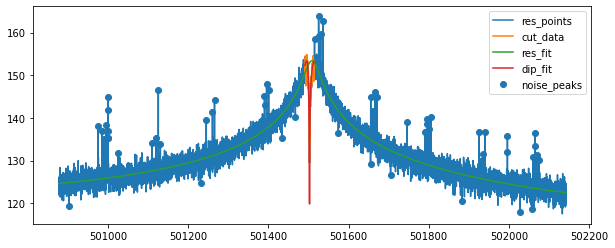

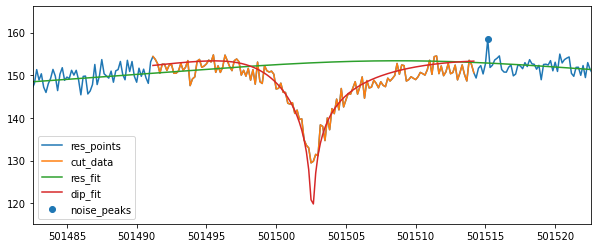

{'A': 2181468681598141.8, 'dA': 1.1048466421915697e-10, 'Q': 13975.232214675423, 'dQ': 33.61853931208515, 'nu_res': 501508.7600108295, 'dnu_res': 0.27890015366778087, 'nu_z': 501502.591767771, 'dnu_z': 0.022920723984904103, 'dip_width': 5.172306496667353, 'ddip_width': 0.2091011626442793, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.6469487038199224, 'fit_success': True}
cycle8 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.3333333333 460.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



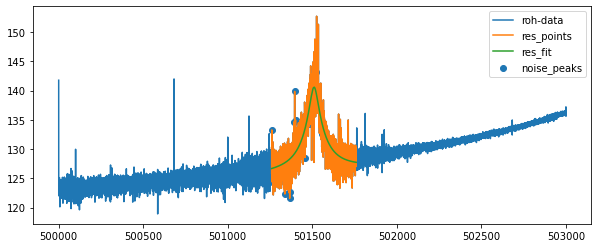

...End fiting resonator
{'A': 110648084134357.0, 'dA': 5.646125070372193e-09, 'off': 4250423830077.858, 'doff': 1.0371424390601146e-07, 'Q': 10440.913991452979, 'dQ': 99.24071850413956, 'th': 0.00033431113782411963, 'dth': 4.321625554613933e-05, 'nu_res': 501510.0787171123, 'dnu_res': 0.5341134125254776, 'fit_err_chi**2_red': 3.216658152676322}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


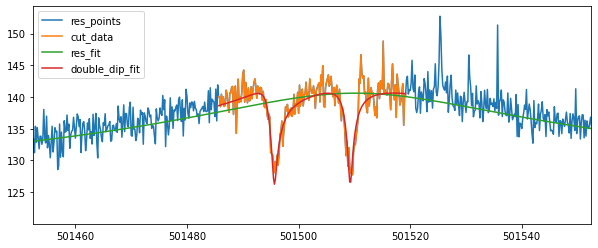

501495.66999718087 0.06141499386720082 501509.2505219134 0.05688271570500413
cycle8 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.5 1233.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



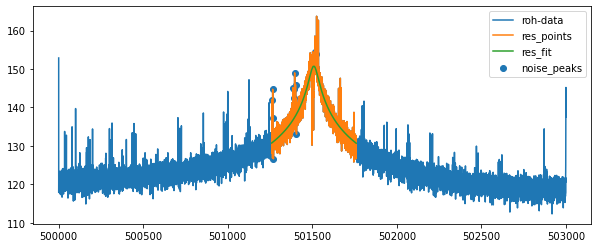

...End fiting resonator
{'A': 1190972722891618.5, 'dA': 2.3554750892209355e-10, 'off': 971154.0668536057, 'doff': 9.619987058397358e-09, 'Q': 10014.686566934817, 'dQ': 51.51161110052564, 'th': 3.298268586740432e-26, 'dth': 5.2817145123710825e-05, 'nu_res': 501508.7295647485, 'dnu_res': 0.5270706982811908, 'fit_err_chi**2_red': 3.1882715091275475}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


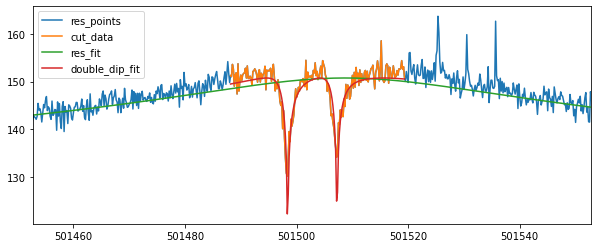

501498.3963941178 0.014170106454389292 501507.2399541351 0.01483268929111423
[501502.7378176225, 501502.591767771]
503840.97 501502.6647926967 501495.66999718087 501509.2505219134 0.032460234798964344 0.06141499386720082 0.05688271570500413
53273922.2 501502.6647926967 501498.3963941178 501507.2399541351 0.032460234798964344 0.014170106454389292 0.01483268929111423
['cycle8', 'position_1', 3, 0.03, '20211218_004217.089200', 53775425.171555564, 0.03839879466518911, 2338.7142736024107, 0.08978369373604839, 501502.6647926967, 0.032460234798964344, 5.172306496667353, 0.2091011626442793, True, 501508.7600108295, 0.27890015366778087]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle8 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [872015125885173.5, 5656.187969923574, 124.74748122819865, -0.00161

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8035798242760854
...End fiting resonator
{'A': 2374272386706327.0, 'dA': 1.1029881747605402e-10, 'Q': 14389.137081699291, 'dQ': 35.49498906138103, 'nu_res': 501508.56488880026, 'dnu_res': 0.280509002499185, 'fit_err_chi**2_red': 0.8035798242760854}
resonator fit results:  [ 2.374272386706e+15  1.438913708170e+04  5.316520506363e+11
 -2.425704332610e-04  5.015085648888e+05] [1.102988174761e-10 3.549498906138e+01 4.268088309512e-08
 8.854057831453e-06 2.805090024992e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9740296678521014


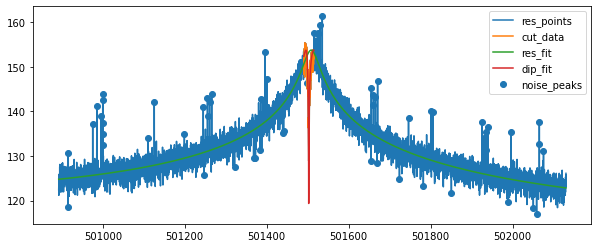

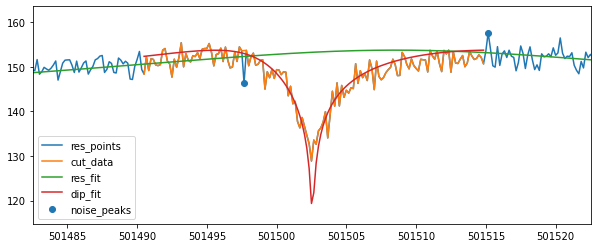

{'A': 2374272386706327.0, 'dA': 1.1029881747605402e-10, 'Q': 14389.137081699291, 'dQ': 35.49498906138103, 'nu_res': 501508.56488880026, 'dnu_res': 0.280509002499185, 'nu_z': 501502.56101647735, 'dnu_z': 0.025253151715943757, 'dip_width': 5.171762094876977, 'ddip_width': 0.23236989958196144, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.9740296678521014, 'fit_success': True}
cycle8 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [879286474293250.0, 5742.543893131046, 124.67721750817101, -0.001487068996004842, 501515.5]
Start fiting resonator....
chi_reduziert =  0.8066616567977105
...End fiting resonator
{'A': 2350279869370894.5, 'dA': 1.1206122682213496e-10, 'Q': 14412.992960604544, 'dQ': 35.64122130680227, 'nu_res': 501508.7590694785, 'dnu_res': 0.28109674279305136, 'fit_err_chi**2_red': 0.8066616567977105}
resonator fit results:  [ 2.350279869371e+15  1.441299296060e+04  5.329802914492e+11
 -2.420780071159e-04  5.015087590695e+05] [1.120

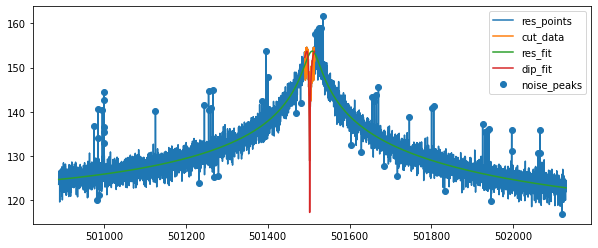

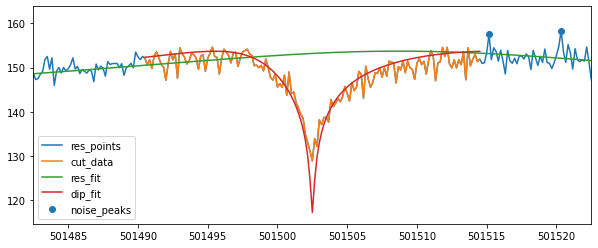

{'A': 2350279869370894.5, 'dA': 1.1206122682213496e-10, 'Q': 14412.992960604544, 'dQ': 35.64122130680227, 'nu_res': 501508.7590694785, 'dnu_res': 0.28109674279305136, 'nu_z': 501502.4985872332, 'dnu_z': 0.03158169590834247, 'dip_width': 5.296680885444763, 'ddip_width': 0.2355453426098269, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.9798949912662975, 'fit_success': True}
cycle8 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 448.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



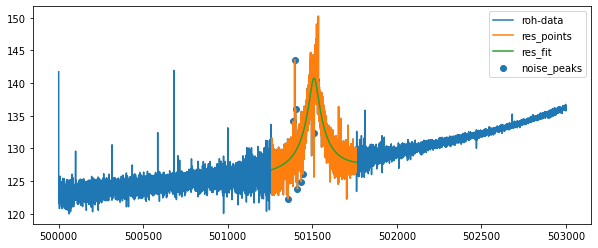

...End fiting resonator
{'A': 115326858598041.67, 'dA': 5.25517989731323e-09, 'off': 4328573234284.2817, 'doff': 9.828931726454166e-08, 'Q': 10551.579599464358, 'dQ': 95.45088507529597, 'th': 0.00036008303709540826, 'dth': 4.1265666446654196e-05, 'nu_res': 501509.9233009147, 'dnu_res': 0.5055186409738394, 'fit_err_chi**2_red': 2.841473569902913}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


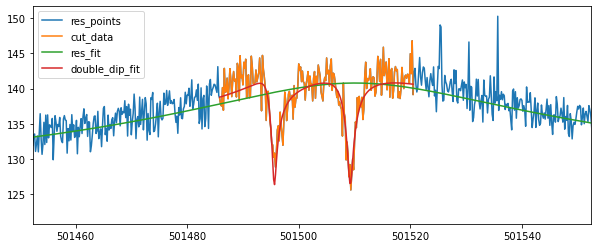

501495.630769489 0.057328504213594735 501509.2419176372 0.062450422943612104
cycle8 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.3333333333 1232.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



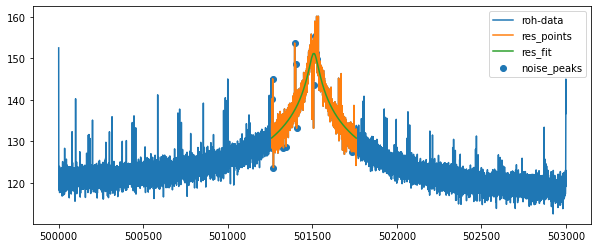

...End fiting resonator
{'A': 1331208674219394.0, 'dA': 2.2314574928080158e-10, 'off': 1311.1493232295616, 'doff': 5.811576234318271e-15, 'Q': 10477.323034523357, 'dQ': 52.34233169901351, 'th': 5.340415606432454e-15, 'dth': 5.114875372663471e-05, 'nu_res': 501508.8575659098, 'dnu_res': 0.49745537323465494, 'fit_err_chi**2_red': 3.0597584623773124}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


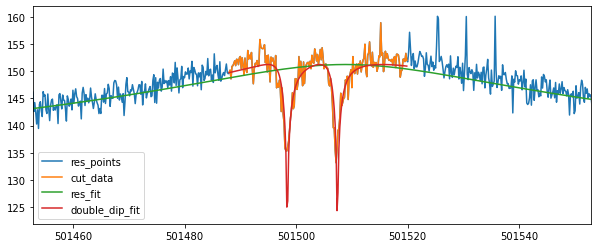

501498.4101769359 0.015722550923006517 501507.3999559232 0.015312412926444948
[501502.56101647735, 501502.4985872332]
503840.97 501502.5298018553 501495.630769489 501509.2419176372 0.04043668121935193 0.057328504213594735 0.062450422943612104
53273922.2 501502.5298018553 501498.4101769359 501507.3999559232 0.04043668121935193 0.015722550923006517 0.015312412926444948
['cycle8', 'position_1', 3, 0.05, '20211217_235358.485252', 53775425.480331, 0.04600862729088948, 2338.627114729141, 0.09392410717829407, 501502.5298018553, 0.04043668121935193, 5.296680885444763, 0.2355453426098269, True, 501508.7590694785, 0.28109674279305136]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle9 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [824896078005165.4, 5624.454205606253, 124.91763621499739, -0.001805

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8023509998691571
...End fiting resonator
{'A': 2186647303237361.0, 'dA': 1.1250550499166891e-10, 'Q': 13980.742033047532, 'dQ': 34.29585394934335, 'nu_res': 501508.6470547109, 'dnu_res': 0.28376901628395, 'fit_err_chi**2_red': 0.8023509998691571}
resonator fit results:  [ 2.186647303237e+15  1.398074203305e+04  5.247236084036e+11
 -2.640508231981e-04  5.015086470547e+05] [1.125055049917e-10 3.429585394934e+01 4.175797657684e-08
 8.700709373318e-06 2.837690162840e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.4340136487031745
Fit is NOT GOOD !!!!!


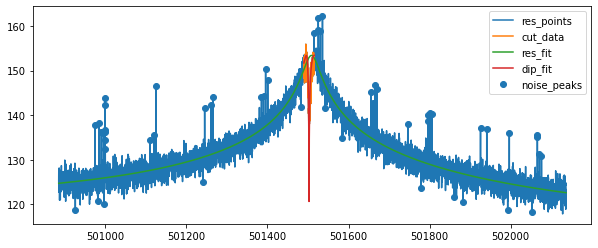

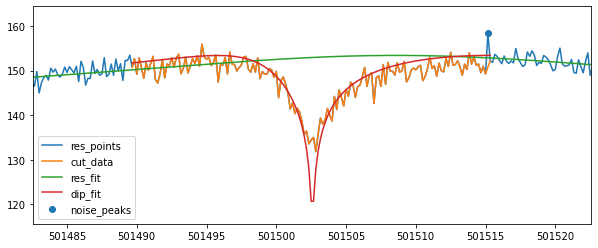

{'A': 2186647303237361.0, 'dA': 1.1250550499166891e-10, 'Q': 13980.742033047532, 'dQ': 34.29585394934335, 'nu_res': 501508.6470547109, 'dnu_res': 0.28376901628395, 'nu_z': 501502.5822376678, 'dnu_z': 0.027193887881992885, 'dip_width': 4.852668406536819, 'ddip_width': 0.2480278623417026, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 2.4340136487031745, 'fit_success': True}
cycle9 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [892760577733425.8, 5786.726923079514, 124.60633087158203, -0.0016265962573579974, 501516.3333333333]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.808612109195444
...End fiting resonator
{'A': 2425012302689058.0, 'dA': 1.1196268980847731e-10, 'Q': 14682.386690841078, 'dQ': 36.06626436887555, 'nu_res': 501508.204610079, 'dnu_res': 0.2737278103895528, 'fit_err_chi**2_red': 0.808612109195444}
resonator fit results:  [ 2.425012302689e+15  1.468238669084e+04  5.584301773265e+11
 -2.557376261997e-04  5.015082046101e+05] [1.119626898085e-10 3.606626436888e+01 4.395131798515e-08
 8.862478026776e-06 2.737278103896e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.768311047522766


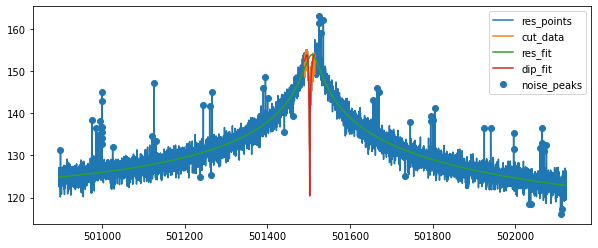

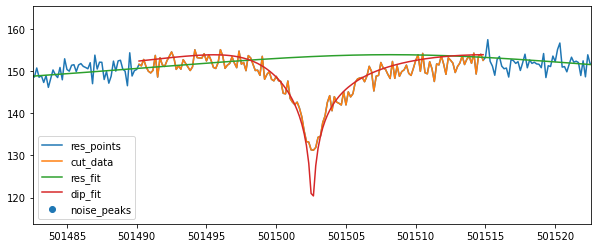

{'A': 2425012302689058.0, 'dA': 1.1196268980847731e-10, 'Q': 14682.386690841078, 'dQ': 36.06626436887555, 'nu_res': 501508.204610079, 'dnu_res': 0.2737278103895528, 'nu_z': 501502.58828434115, 'dnu_z': 0.023708854425387702, 'dip_width': 5.242302441186264, 'ddip_width': 0.21793555826384747, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.768311047522766, 'fit_success': True}
cycle9 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.1666666667 441.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



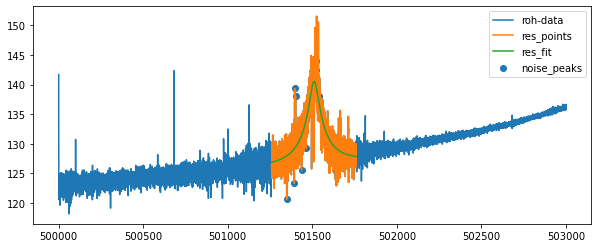

...End fiting resonator
{'A': 110420617505866.66, 'dA': 6.277972864391142e-09, 'off': 4493698802632.18, 'doff': 1.1512582986962551e-07, 'Q': 10788.211447997614, 'dQ': 106.23018037864027, 'th': 0.0003083637851473109, 'dth': 4.299309735540725e-05, 'nu_res': 501510.6706784849, 'dnu_res': 0.5273761092975732, 'fit_err_chi**2_red': 3.125082320378183}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


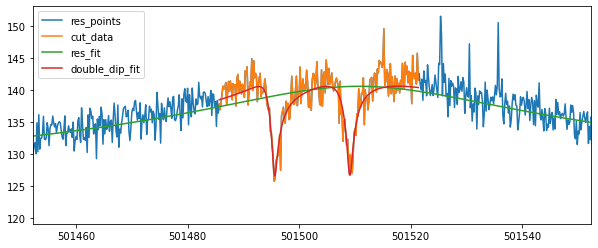

501495.62195693265 0.06703101136734235 501509.0810606587 0.06710195509533716
cycle9 shift_-0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.0 1237.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



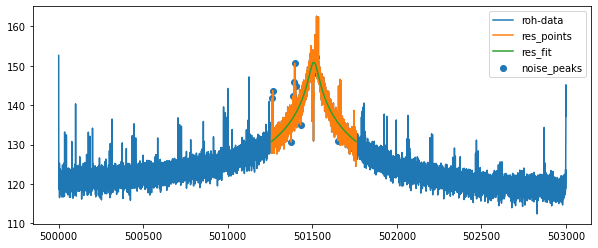

...End fiting resonator
{'A': 1254795097678893.5, 'dA': 2.2201827413915228e-10, 'off': 435.206827399903, 'doff': 1.1152909090988392e-14, 'Q': 10217.533929946067, 'dQ': 50.228083327111676, 'th': 5.026911471459135e-15, 'dth': 5.041275947928087e-05, 'nu_res': 501508.70305786043, 'dnu_res': 0.4973526205957074, 'fit_err_chi**2_red': 2.9903308487777256}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


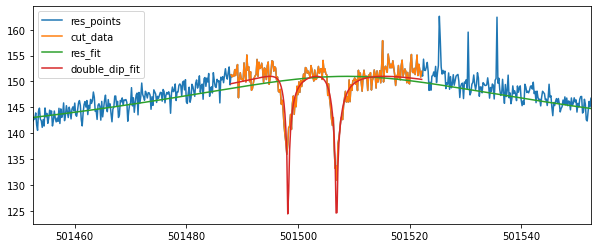

501498.22812083596 0.014350088763523621 501506.9153616502 0.015083045754456398
[501502.5822376678, 501502.58828434115]
503840.97 501502.5852610045 501495.62195693265 501509.0810606587 0.03607793392508259 0.06703101136734235 0.06710195509533716
53273922.2 501502.5852610045 501498.22812083596 501506.9153616502 0.03607793392508259 0.014350088763523621 0.015083045754456398
['cycle9', 'position_1', 3, -0.005, '20211218_010024.040606', 53775424.758221485, 0.0416538189492231, 2338.852243413159, 0.10147633309717123, 501502.5852610045, 0.03607793392508259, 5.242302441186264, 0.21793555826384747, True, 501508.204610079, 0.2737278103895528]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle9 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [889346319092620.9, 5820.234042551881, 124.69985961914062, -0.00

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8159925735324975
...End fiting resonator
{'A': 2182025277767102.0, 'dA': 1.1510917317221555e-10, 'Q': 13928.481260993436, 'dQ': 35.13070598117143, 'nu_res': 501508.5315346463, 'dnu_res': 0.2901918175143851, 'fit_err_chi**2_red': 0.8159925735324975}
resonator fit results:  [ 2.182025277767e+15  1.392848126099e+04  5.464788327724e+11
 -2.682838786034e-04  5.015085315346e+05] [1.151091731722e-10 3.513070598117e+01 4.131671563850e-08
 9.055502974376e-06 2.901918175144e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.316694272669857
Fit is NOT GOOD !!!!!


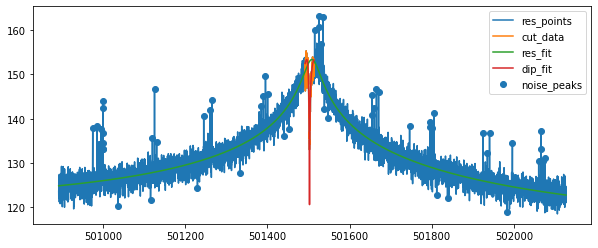

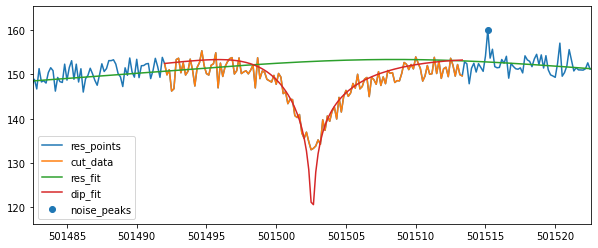

{'A': 2182025277767102.0, 'dA': 1.1510917317221555e-10, 'Q': 13928.481260993436, 'dQ': 35.13070598117143, 'nu_res': 501508.5315346463, 'dnu_res': 0.2901918175143851, 'nu_z': 501502.58759618027, 'dnu_z': 0.026839504829031732, 'dip_width': 4.732116778489793, 'ddip_width': 0.242961040878283, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 2.316694272669857, 'fit_success': True}
cycle9 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [898582771022258.8, 5854.227626461796, 124.6856689453125, -0.0017516617801480586, 501512.1666666667]
Start fiting resonator....
chi_reduziert =  0.7989940881743273
...End fiting resonator
{'A': 2323075382007045.5, 'dA': 1.1083252599260351e-10, 'Q': 14361.86764720547, 'dQ': 34.96191673630302, 'nu_res': 501508.2329275405, 'dnu_res': 0.27696770153120126, 'fit_err_chi**2_red': 0.7989940881743273}
resonator fit results:  [ 2.323075382007e+15  1.436186764721e+04  5.449990506507e+11
 -2.472390926580e-04  5.015082329275e+05] 

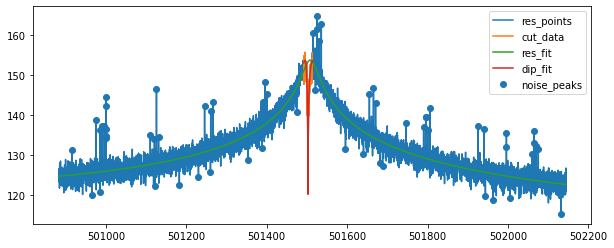

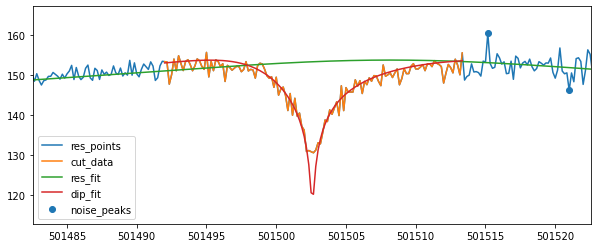

{'A': 2323075382007045.5, 'dA': 1.1083252599260351e-10, 'Q': 14361.86764720547, 'dQ': 34.96191673630302, 'nu_res': 501508.2329275405, 'dnu_res': 0.27696770153120126, 'nu_z': 501502.58651730785, 'dnu_z': 0.022771176209851293, 'dip_width': 5.4468414359595725, 'ddip_width': 0.2089881320851182, 'dip_guess': 501502.6666666667, 'fit_err_chi**2_red': 1.5196444779113936, 'fit_success': True}
cycle9 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.0 449.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


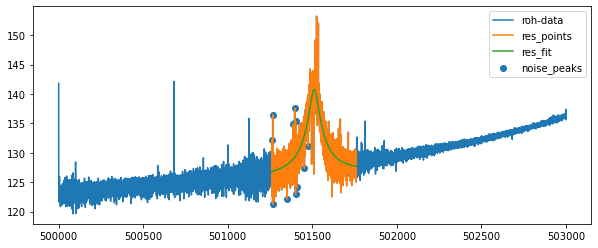

...End fiting resonator
{'A': 117046912645279.28, 'dA': 5.739020645606521e-09, 'off': 4345394367625.521, 'doff': 1.1070865560787483e-07, 'Q': 10926.875274919987, 'dQ': 102.33562128777359, 'th': 0.00028231530350659073, 'dth': 4.2109354369654666e-05, 'nu_res': 501510.8744371157, 'dnu_res': 0.5060412957966144, 'fit_err_chi**2_red': 3.0852551471967926}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


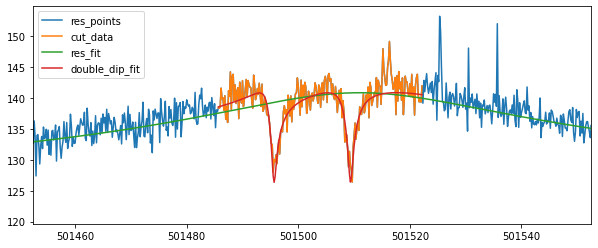

501495.6644141267 0.06056285096665553 501509.3624935593 0.06054954453138158
cycle9 shift_-0.02 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.1666666667 1246.666666666977
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


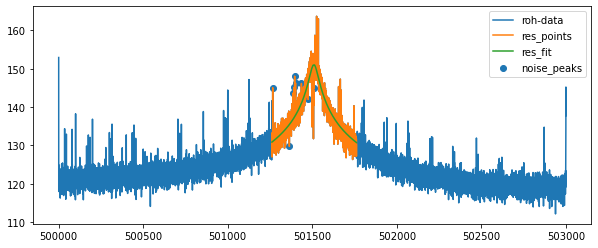

...End fiting resonator
{'A': 1281236422883366.8, 'dA': 2.2611383019889194e-10, 'off': 1403.262214905493, 'doff': 2.8103763215253087e-17, 'Q': 10302.845663800952, 'dQ': 51.83662716222495, 'th': 2.1865975354772153e-35, 'dth': 5.1562019509240976e-05, 'nu_res': 501509.2627506841, 'dnu_res': 0.5062813962575086, 'fit_err_chi**2_red': 3.1060189420839674}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


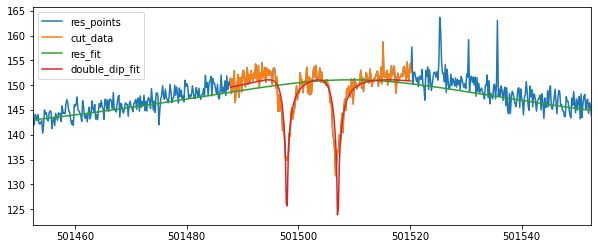

501497.9178119808 0.015818887372963348 501507.0754495058 0.01577610339584302
[501502.58759618027, 501502.58651730785]
503840.97 501502.587056744 501495.6644141267 501509.3624935593 0.03519780512258847 0.06056285096665553 0.06054954453138158
53273922.2 501502.587056744 501497.9178119808 501507.0754495058 0.03519780512258847 0.015818887372963348 0.01577610339584302
['cycle9', 'position_1', 3, -0.02, '20211218_010626.333156', 53775424.60620475, 0.04168942457653432, 2338.530149057973, 0.09259045169786571, 501502.587056744, 0.03519780512258847, 5.4468414359595725, 0.2089881320851182, True, 501508.2329275405, 0.27696770153120126]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle9 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [941460488927972.9, 6657.207964598341, 125.04376220703125, -0.00191145

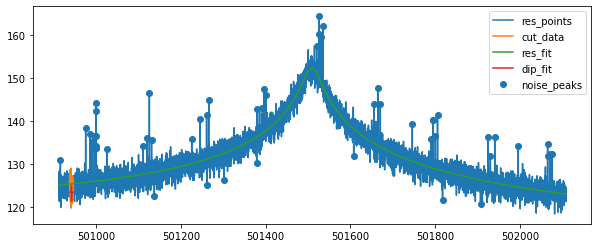

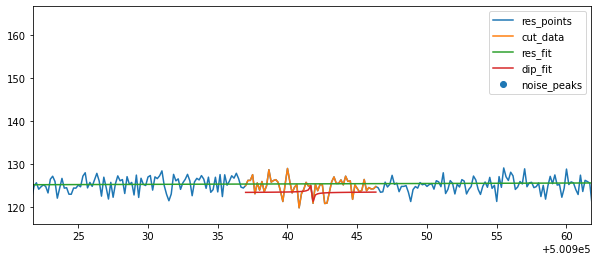

{'A': 1714285341576099.0, 'dA': 1.207458994253229e-10, 'Q': 12510.129604945716, 'dQ': 32.04733066244936, 'nu_res': 501509.1284039886, 'dnu_res': 0.2999646278170364, 'nu_z': 500941.78017314745, 'dnu_z': 0.06489252957159107, 'dip_width': 0.6205224394606871, 'ddip_width': 0.5592922473425417, 'dip_guess': 500941.6666666667, 'fit_err_chi**2_red': 1.5483475980602617, 'fit_success': True}
cycle9 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [926533524270026.8, 6642.523178807947, 125.02294158935547, -0.001995882259936506, 501510.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7977970438148622
...End fiting resonator
{'A': 1671165425238373.0, 'dA': 1.192109839136097e-10, 'Q': 12393.863477287252, 'dQ': 31.138246652412136, 'nu_res': 501509.48224850144, 'dnu_res': 0.29745924638918847, 'fit_err_chi**2_red': 0.7977970438148622}
resonator fit results:  [ 1.671165425238e+15  1.239386347729e+04  6.085774970805e+11
 -2.801662117344e-04  5.015094822485e+05] [1.192109839136e-10 3.113824665241e+01 3.250813665285e-08
 9.073928573990e-06 2.974592463892e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.3177964071012547


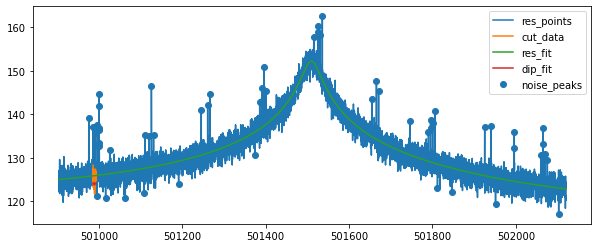

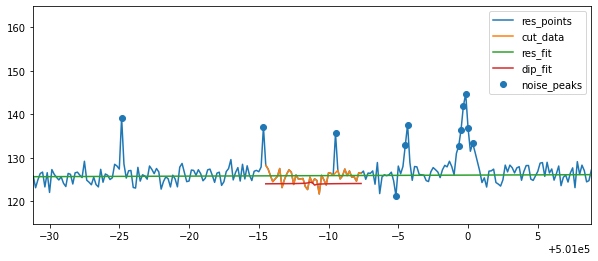

{'A': 1671165425238373.0, 'dA': 1.192109839136097e-10, 'Q': 12393.863477287252, 'dQ': 31.138246652412136, 'nu_res': 501509.48224850144, 'dnu_res': 0.29745924638918847, 'nu_z': 500988.83736517705, 'dnu_z': 0.04211049158144063, 'dip_width': 0.20371624961889534, 'ddip_width': 0.7116638731365068, 'dip_guess': 500988.8333333333, 'fit_err_chi**2_red': 1.3177964071012547, 'fit_success': True}
cycle9 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.8333333333 442.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


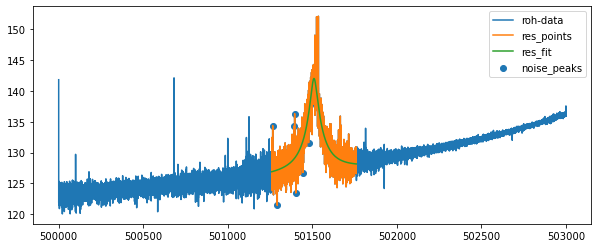

...End fiting resonator
{'A': 154066934548730.5, 'dA': 5.923925035382084e-09, 'off': 4827912942465.514, 'doff': 1.4467105608754067e-07, 'Q': 13678.11953914262, 'dQ': 112.92967265266135, 'th': 0.00040383422316474097, 'dth': 3.5141953807058435e-05, 'nu_res': 501509.80966990534, 'dnu_res': 0.3681489628251217, 'fit_err_chi**2_red': 2.7325925960871857}
Start fiting double dip....
Fit is NOT GOOD !!!!!


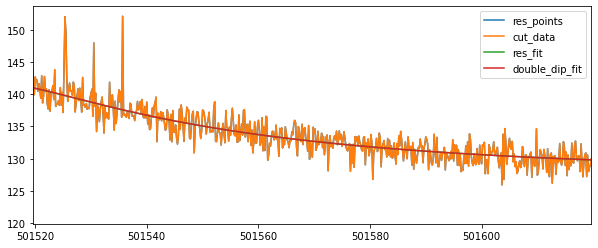

501499.000000309 0.039998268908892305 501640.3298732114 0.3870871883386937
cycle9 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.1666666667 1197.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


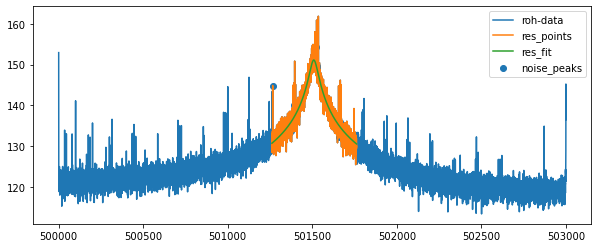

...End fiting resonator
{'A': 1287266004641882.5, 'dA': 1.9035216437826507e-10, 'off': 4590210.06102768, 'doff': 8.295202744462848e-09, 'Q': 10556.659577919016, 'dQ': 42.87787594394888, 'th': 1.8758324928571635e-24, 'dth': 4.15564663563035e-05, 'nu_res': 501508.66925441497, 'dnu_res': 0.40242850873646807, 'fit_err_chi**2_red': 2.9115819230064726}
Start fiting double dip....
fit failed for cycle9 shift_-0.04 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
cycle9 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [943754944039284.9, 6527.238611715315, 124.80449676513672, -0.0018772834055951417, 501509.5]
Start fiting resonator....
chi_reduziert =  0.8031505840766757
...End fiting resonator
{'A': 1719986330852728.2, 'dA': 1.167513056684234e-10, 'Q': 12415.703251319912, 'dQ': 31.346438343675683, 'nu_res': 501509.2302840821, 'dnu_res': 0.3005601315141531, 'fit_err_chi**2_red': 0.8031505840766757}
resonator fit results:  [ 1.719986330853e+15  1.24157

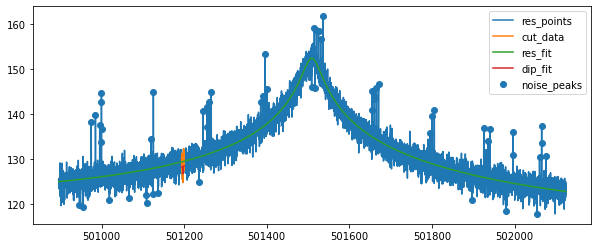

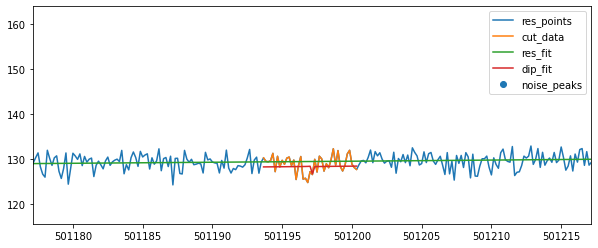

{'A': 1719986330852728.2, 'dA': 1.167513056684234e-10, 'Q': 12415.703251319912, 'dQ': 31.346438343675683, 'nu_res': 501509.2302840821, 'dnu_res': 0.3005601315141531, 'nu_z': 501197.16135836445, 'dnu_z': 0.023610990111276854, 'dip_width': 0.01869052324772208, 'ddip_width': 0.34605552750180785, 'dip_guess': 501197.0, 'fit_err_chi**2_red': 1.1118185968935665, 'fit_success': True}
cycle9 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [946521188317835.8, 6584.382932164624, 124.88346862792969, -0.001671527031739004, 501510.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7936973255849152
...End fiting resonator
{'A': 1698144102136434.2, 'dA': 1.1770436733903976e-10, 'Q': 12381.709769122934, 'dQ': 31.276694489577505, 'nu_res': 501508.97557103704, 'dnu_res': 0.300446135108115, 'fit_err_chi**2_red': 0.7936973255849152}
resonator fit results:  [ 1.698144102136e+15  1.238170976912e+04  5.703742342502e+11
 -2.587554328063e-04  5.015089755710e+05] [1.177043673390e-10 3.127669448958e+01 3.207471029970e-08
 9.263013977069e-06 3.004461351081e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.0552534857363869


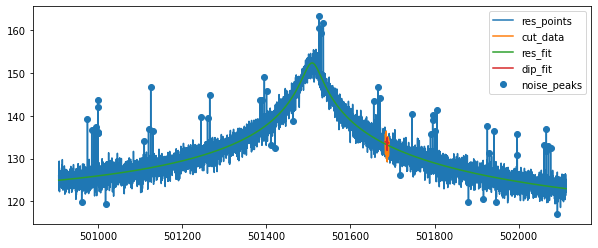

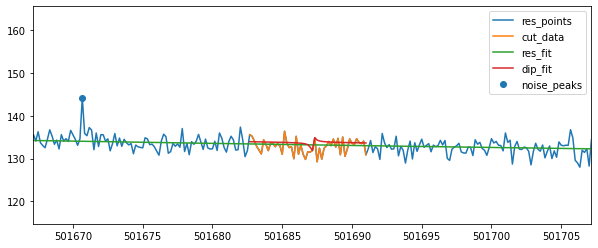

{'A': 1698144102136434.2, 'dA': 1.1770436733903976e-10, 'Q': 12381.709769122934, 'dQ': 31.276694489577505, 'nu_res': 501508.97557103704, 'dnu_res': 0.300446135108115, 'nu_z': 501687.1568424586, 'dnu_z': 0.008699664118285232, 'dip_width': 0.1945615129496768, 'ddip_width': 0.1832833709599804, 'dip_guess': 501686.8333333333, 'fit_err_chi**2_red': 1.0552534857363869, 'fit_success': True}
cycle9 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501507.5 438.66666666651145
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


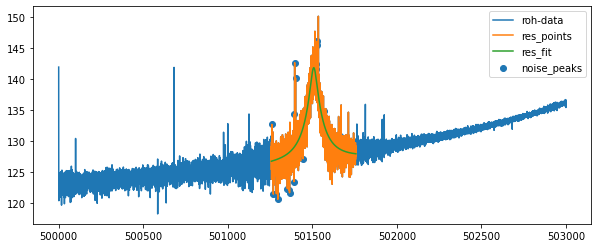

...End fiting resonator
{'A': 149871078500514.22, 'dA': 5.560704937961363e-09, 'off': 4594701038760.981, 'doff': 1.3365336479536111e-07, 'Q': 13133.101641962203, 'dQ': 107.47666079058052, 'th': 0.00038105278933660817, 'dth': 3.5888987696049696e-05, 'nu_res': 501508.4466283148, 'dnu_res': 0.3825868879671682, 'fit_err_chi**2_red': 2.6761654960233026}
Start fiting double dip....
Fit is NOT GOOD !!!!!


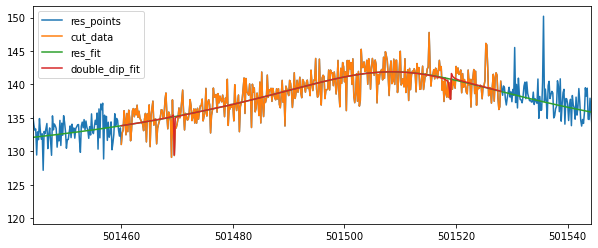

501469.5018821186 0.014413099686437142 501518.96842189267 0.01972977196433536
cycle9 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501510.3333333333 1209.333333333023
cut out doesn't work
fit failed for cycle9 shift_0.002 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
cycle9 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



Start Values res:  [864752610072125.1, 5688.249527412711, 124.56258317214406, -0.0017859409774800626, 501514.0]
Start fiting resonator....
chi_reduziert =  0.80062336425068
...End fiting resonator
{'A': 2456888438049786.0, 'dA': 1.1225635053463428e-10, 'Q': 14887.042737307202, 'dQ': 36.15905889911479, 'nu_res': 501508.5008026782, 'dnu_res': 0.2698996236399318, 'fit_err_chi**2_red': 0.80062336425068}
resonator fit results:  [ 2.456888438050e+15  1.488704273731e+04  6.053601360158e+11
 -2.783282056388e-04  5.015085008027e+05] [1.122563505346e-10 3.615905889911e+01 4.705250344605e-08
 8.380435695764e-06 2.698996236399e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.5930772685138834


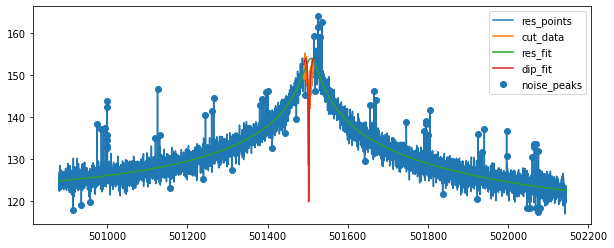

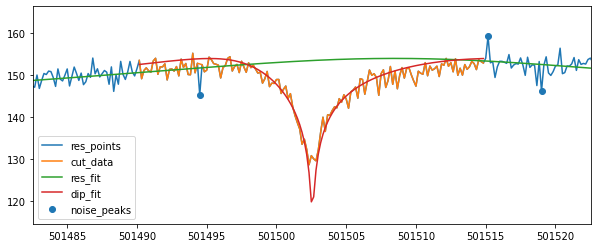

{'A': 2456888438049786.0, 'dA': 1.1225635053463428e-10, 'Q': 14887.042737307202, 'dQ': 36.15905889911479, 'nu_res': 501508.5008026782, 'dnu_res': 0.2698996236399318, 'nu_z': 501502.5704753668, 'dnu_z': 0.024432927788913844, 'dip_width': 5.83629419575698, 'ddip_width': 0.218597413665347, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.5930772685138834, 'fit_success': True}
cycle9 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [831982093522265.8, 5562.094269873004, 124.33685043289485, -0.0017470805658484645, 501515.5]
Start fiting resonator....
chi_reduziert =  0.8055305722022138
...End fiting resonator
{'A': 2458196268711182.5, 'dA': 1.136735217527887e-10, 'Q': 14894.218597581801, 'dQ': 36.61731251344218, 'nu_res': 501508.3869354074, 'dnu_res': 0.2737728095438605, 'fit_err_chi**2_red': 0.8055305722022138}
resonator fit results:  [ 2.458196268711e+15  1.489421859758e+04  5.664842353831e+11
 -2.643823109144e-04  5.015083869354e+05] [1.136735217528e-10

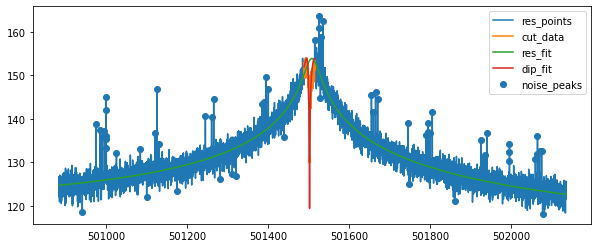

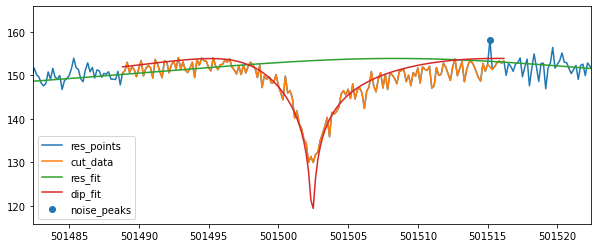

{'A': 2458196268711182.5, 'dA': 1.136735217527887e-10, 'Q': 14894.218597581801, 'dQ': 36.61731251344218, 'nu_res': 501508.3869354074, 'dnu_res': 0.2737728095438605, 'nu_z': 501502.43544367386, 'dnu_z': 0.02572172801927003, 'dip_width': 5.74285366039339, 'ddip_width': 0.2306411289806992, 'dip_guess': 501502.5, 'fit_err_chi**2_red': 1.7770141469756715, 'fit_success': True}
cycle9 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.5 449.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



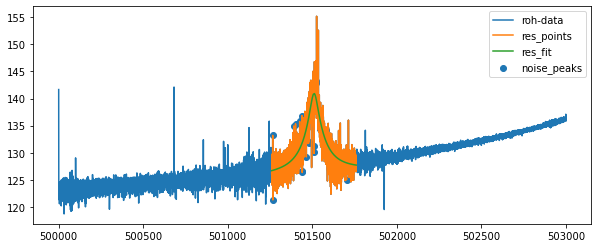

...End fiting resonator
{'A': 119653216830863.83, 'dA': 5.527127394899153e-09, 'off': 4273143122039.337, 'doff': 1.0862514129723035e-07, 'Q': 10946.161225489219, 'dQ': 100.85185742124435, 'th': 0.0003237226672146373, 'dth': 4.201162946839061e-05, 'nu_res': 501510.3360851106, 'dnu_res': 0.5015189317977979, 'fit_err_chi**2_red': 3.153003478248272}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


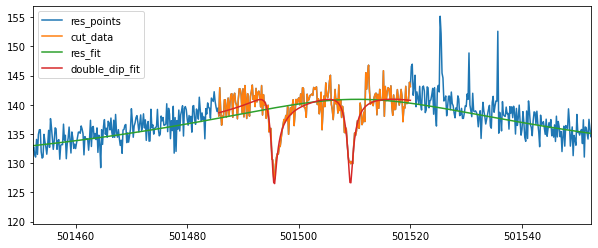

501495.5952999078 0.05205243284296554 501509.2526190624 0.050106227924646946
cycle9 shift_0.005 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.6666666667 1238.666666666977
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


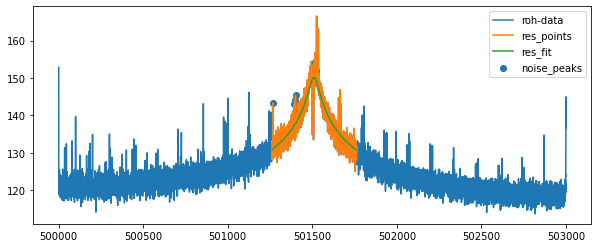

...End fiting resonator
{'A': 1038370199861704.8, 'dA': 2.2840893953146319e-10, 'off': 154570.71238805904, 'doff': 8.330146850508607e-09, 'Q': 9301.438706122075, 'dQ': 46.56735169341589, 'th': 3.843817535137036e-12, 'dth': 5.166005489753691e-05, 'nu_res': 501509.1318629863, 'dnu_res': 0.5378670943843904, 'fit_err_chi**2_red': 3.3116536308193782}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


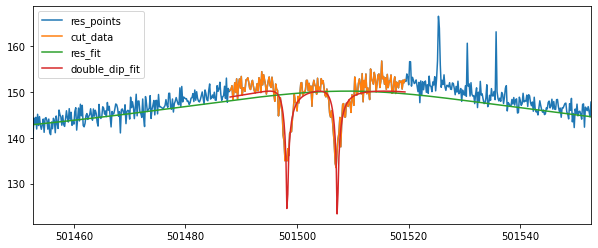

501498.23403014016 0.017636619778580012 501507.2273821989 0.016977650127175944
[501502.5704753668, 501502.43544367386]
503840.97 501502.5029595203 501495.5952999078 501509.2526190624 0.03547640416721485 0.05205243284296554 0.050106227924646946
53273922.2 501502.5029595203 501498.23403014016 501507.2273821989 0.03547640416721485 0.017636619778580012 0.016977650127175944
['cycle9', 'position_1', 3, 0.005, '20211218_004819.443453', 53775425.158452824, 0.04310297221411275, 2338.625040550134, 0.08049015526350839, 501502.5029595203, 0.03547640416721485, 5.74285366039339, 0.2306411289806992, True, 501508.3869354074, 0.2737728095438605]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle9 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [856778518613088.8, 5753.51434034673, 124.83375242005472, -0.0019

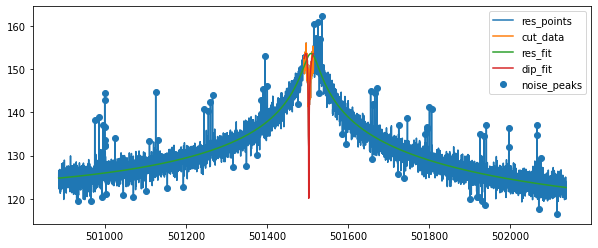

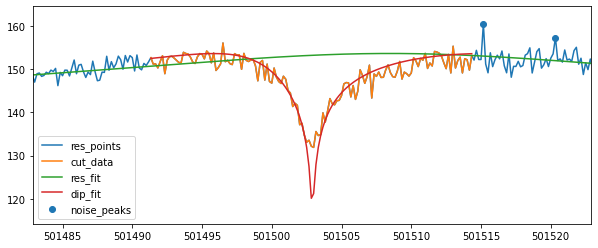

{'A': 2279155494219966.5, 'dA': 1.136437085371368e-10, 'Q': 14370.870070248951, 'dQ': 35.13692231317038, 'nu_res': 501508.52911585616, 'dnu_res': 0.2758476001724262, 'nu_z': 501502.9058874744, 'dnu_z': 0.025046248223080898, 'dip_width': 5.147324141273595, 'ddip_width': 0.22478160880250891, 'dip_guess': 501502.8333333333, 'fit_err_chi**2_red': 1.871374793812471, 'fit_success': True}
cycle9 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [870488940150217.2, 5699.026515151515, 124.6748275756836, -0.001656683486405929, 501514.3333333333]
Start fiting resonator....
chi_reduziert =  0.8128485745737979
...End fiting resonator
{'A': 2423183883295038.5, 'dA': 1.1713253372687894e-10, 'Q': 14720.350009597927, 'dQ': 37.60740561558229, 'nu_res': 501508.29822222696, 'dnu_res': 0.2836840756288712, 'fit_err_chi**2_red': 0.8128485745737979}
resonator fit results:  [ 2.423183883295e+15  1.472035000960e+04  5.877916223152e+11
 -2.614594897847e-04  5.015082982222e+05]

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



Start fiting dip....
shape 2
chi_reduziert =  2.1255618843912627
Fit is NOT GOOD !!!!!


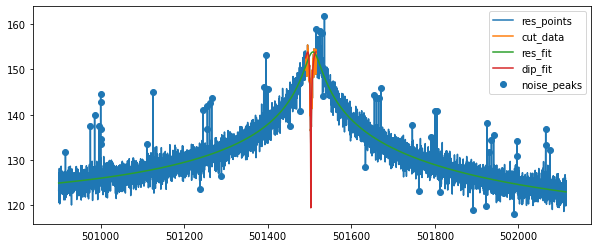

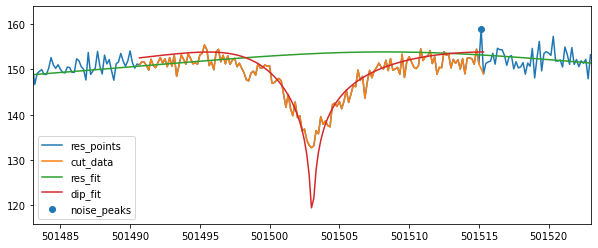

{'A': 2423183883295038.5, 'dA': 1.1713253372687894e-10, 'Q': 14720.350009597927, 'dQ': 37.60740561558229, 'nu_res': 501508.29822222696, 'dnu_res': 0.2836840756288712, 'nu_z': 501503.0619982209, 'dnu_z': 0.028431861887926083, 'dip_width': 5.579042053428995, 'ddip_width': 0.2542899233035525, 'dip_guess': 501503.0, 'fit_err_chi**2_red': 2.1255618843912627, 'fit_success': True}
cycle9 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501509.6666666667 453.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


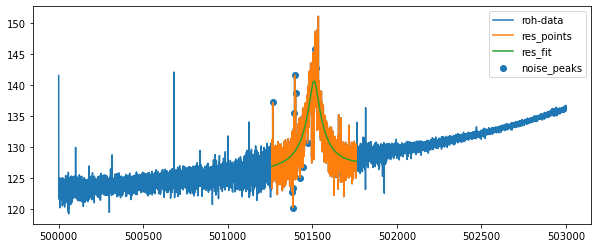

...End fiting resonator
{'A': 112479108551049.42, 'dA': 6.085426426022382e-09, 'off': 4422193375868.627, 'doff': 1.1368161667699709e-07, 'Q': 10831.992321688927, 'dQ': 104.73886358015679, 'th': 0.0002509172822967689, 'dth': 4.2710732203953965e-05, 'nu_res': 501510.1540655389, 'dnu_res': 0.5200364230018371, 'fit_err_chi**2_red': 3.020188569872096}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


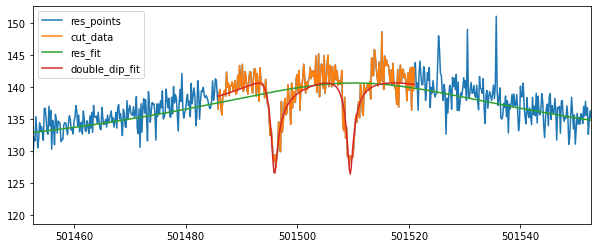

501495.92450103554 0.06516722184810804 501509.4865022056 0.06321102469746931
cycle9 shift_0.008 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.3333333333 1250.6666666665114
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


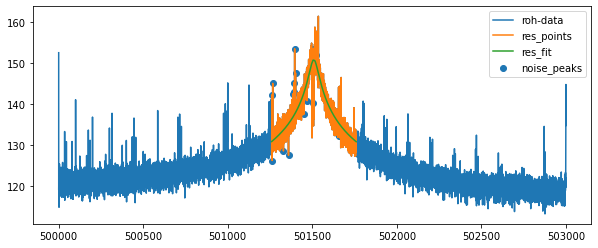

...End fiting resonator
{'A': 1199967644163743.0, 'dA': 2.302588211535674e-10, 'off': 690.5975948218256, 'doff': 1.1309541470371484e-14, 'Q': 9971.931390536283, 'dQ': 50.933477749171644, 'th': 1.2782912444241582e-14, 'dth': 5.246387901420916e-05, 'nu_res': 501508.84378627205, 'dnu_res': 0.5248272776149501, 'fit_err_chi**2_red': 3.026075447636917}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


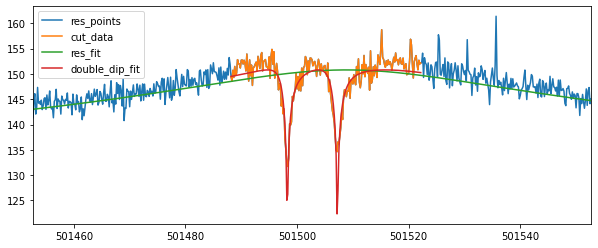

501498.24320083397 0.01491254896801464 501507.22744743334 0.013992012622589721
[501502.9058874744, 501503.0619982209]
503840.97 501502.9839428477 501495.92450103554 501509.4865022056 0.037890438377858424 0.06516722184810804 0.06321102469746931
53273922.2 501502.9839428477 501498.24320083397 501507.22744743334 0.037890438377858424 0.01491254896801464 0.013992012622589721
['cycle9', 'position_1', 3, 0.008, '20211218_005421.735247', 53775424.68670542, 0.043056310274110006, 2338.54293960653, 0.09837726245007478, 501502.9839428477, 0.037890438377858424, 5.579042053428995, 0.2542899233035525, True, 501508.29822222696, 0.2836840756288712]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle9 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [928849154661331.6, 6541.452173911388, 124.8214340209961, -0.0

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8019007532890358
...End fiting resonator
{'A': 1664190644680246.5, 'dA': 1.1573996284845432e-10, 'Q': 12169.323908615224, 'dQ': 30.676515613656882, 'nu_res': 501510.00223383086, 'dnu_res': 0.30662402411603584, 'fit_err_chi**2_red': 0.8019007532890358}
resonator fit results:  [ 1.664190644680e+15  1.216932390862e+04  5.484099095140e+11
 -2.993297706759e-04  5.015100022338e+05] [1.157399628485e-10 3.067651561366e+01 3.206359406287e-08
 9.002775481834e-06 3.066240241160e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.9042303805384466
Fit is NOT GOOD !!!!!


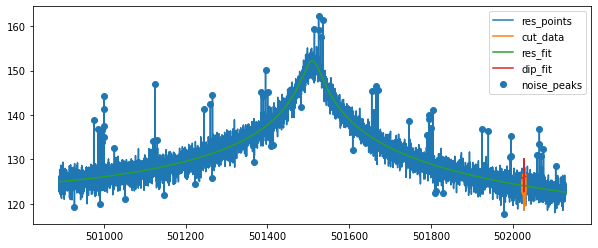

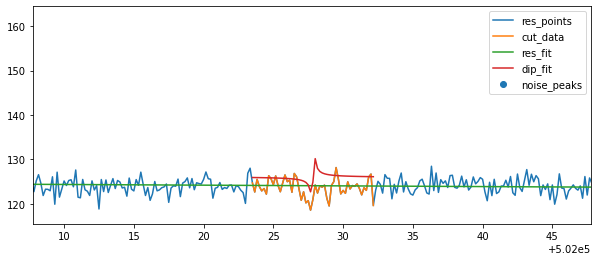

{'A': 1664190644680246.5, 'dA': 1.1573996284845432e-10, 'Q': 12169.323908615224, 'dQ': 30.676515613656882, 'nu_res': 501510.00223383086, 'dnu_res': 0.30662402411603584, 'nu_z': 502027.79374327185, 'dnu_z': 0.022707237648812995, 'dip_width': 2.1666776152191582, 'ddip_width': 1.0004317853612448, 'dip_guess': 502027.8333333333, 'fit_err_chi**2_red': 2.9042303805384466, 'fit_success': True}
cycle9 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [938502146316319.2, 6527.251626894751, 124.75904846191406, -0.0017438256759911544, 501510.5]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7867340369158282
...End fiting resonator
{'A': 1681203634005225.0, 'dA': 1.160685848154277e-10, 'Q': 12312.428910229071, 'dQ': 30.709612322635227, 'nu_res': 501509.37464020733, 'dnu_res': 0.29900964999164037, 'fit_err_chi**2_red': 0.7867340369158282}
resonator fit results:  [ 1.681203634005e+15  1.231242891023e+04  5.533135116892e+11
 -2.782143603293e-04  5.015093746402e+05] [1.160685848154e-10 3.070961232264e+01 3.158687110402e-08
 9.140455364144e-06 2.990096499916e-01]
Start fiting dip....
shape 2
chi_reduziert =  0.7123155185879915


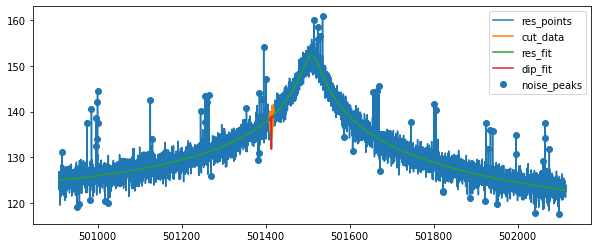

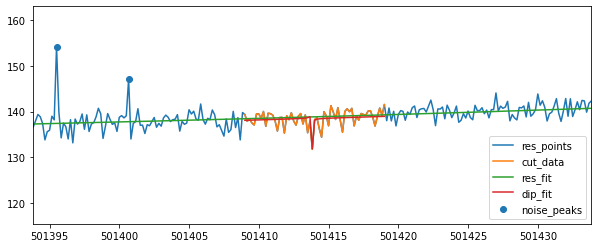

{'A': 1681203634005225.0, 'dA': 1.160685848154277e-10, 'Q': 12312.428910229071, 'dQ': 30.709612322635227, 'nu_res': 501509.37464020733, 'dnu_res': 0.29900964999164037, 'nu_z': 501413.8357829017, 'dnu_z': 0.01139765138142905, 'dip_width': 0.036901103105320306, 'ddip_width': 0.08065181169443973, 'dip_guess': 501414.0, 'fit_err_chi**2_red': 0.7123155185879915, 'fit_success': True}
cycle9 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501507.5 429.33333333348855
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


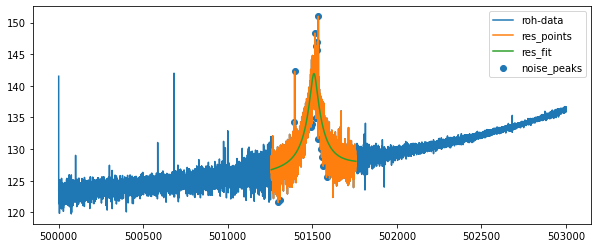

...End fiting resonator
{'A': 151486889009227.03, 'dA': 5.697560339799186e-09, 'off': 4659355905192.525, 'doff': 1.3759100182587415e-07, 'Q': 13257.849899410838, 'dQ': 110.25799135224489, 'th': 0.00041504138149924284, 'dth': 3.624193184695435e-05, 'nu_res': 501509.40401223244, 'dnu_res': 0.38470515274475225, 'fit_err_chi**2_red': 2.6779784518904686}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


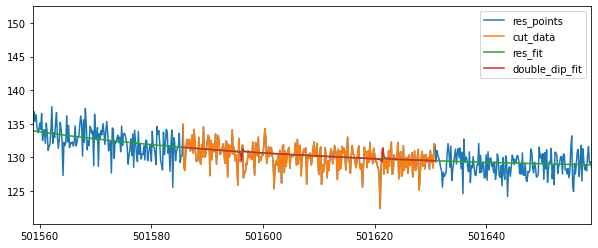

501596.2001012895 0.10168527921883196 501621.48898402293 0.04521856684989244
cycle9 shift_0.015 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501511.3333333333 1225.333333333023
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



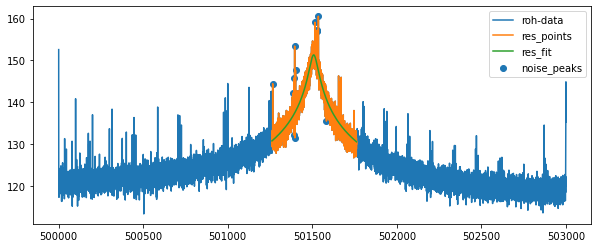

...End fiting resonator
{'A': 1356233218219439.0, 'dA': 1.8992211564244537e-10, 'off': 651926.8075205405, 'doff': 8.08434903269196e-09, 'Q': 10785.952086327812, 'dQ': 44.192971357651885, 'th': 9.0561031404814e-19, 'dth': 4.1857958891529976e-05, 'nu_res': 501508.1179473302, 'dnu_res': 0.4004364343695207, 'fit_err_chi**2_red': 2.633449373065563}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


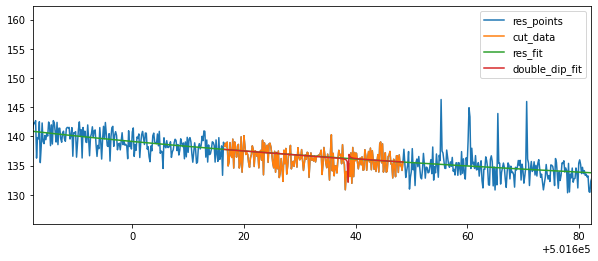

501625.8220287347 0.37866042427817465 501638.6860382736 0.034433803014532915
[502027.79374327185, 501413.8357829017]
503840.97 501720.81476308673 501596.2001012895 501621.48898402293 0.02540718596484589 0.10168527921883196 0.04521856684989244
53273922.2 501720.81476308673 501625.8220287347 501638.6860382736 0.02540718596484589 0.37866042427817465 0.034433803014532915
['cycle9', 'position_1', 3, 0.015, '20211218_013638.001032', 53775465.89330392, 0.3810707661356656, 2344.095677774283, 0.11414963817911239, 501720.81476308673, 0.02540718596484589, 0.036901103105320306, 0.08065181169443973, True, 501509.37464020733, 0.29900964999164037]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle9 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [780287638892832.0, 5431.566787001328, 124.67760467529297, -0.

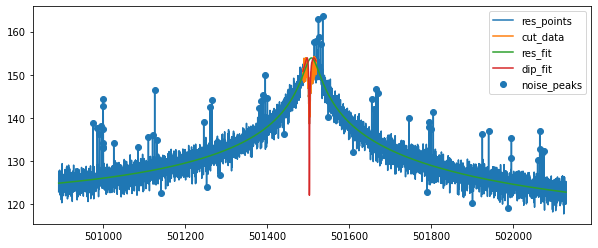

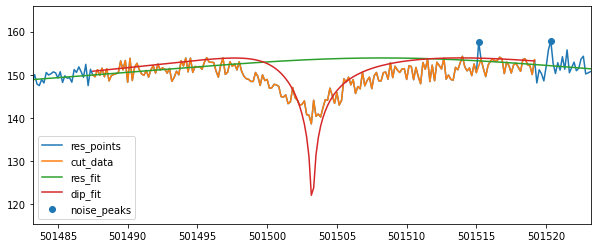

{'A': 2447837365305902.5, 'dA': 1.1447998632589216e-10, 'Q': 14848.911101902555, 'dQ': 36.833379702858366, 'nu_res': 501508.2947360317, 'dnu_res': 0.27767369122019875, 'nu_z': 501503.2379696928, 'dnu_z': 0.027720286114806803, 'dip_width': 3.496546723079556, 'ddip_width': 0.25156207421322857, 'dip_guess': 501503.3333333333, 'fit_err_chi**2_red': 3.547135840322919, 'fit_success': True}
cycle9 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [984799967628428.0, 6671.973392459475, 124.87408579635319, -0.0017651454149909618, 501510.0]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.7877557931687682
...End fiting resonator
{'A': 1745909506109891.0, 'dA': 1.154177445714064e-10, 'Q': 12471.354323317379, 'dQ': 31.30994704903988, 'nu_res': 501508.6921334829, 'dnu_res': 0.29703108769396525, 'fit_err_chi**2_red': 0.7877557931687682}
resonator fit results:  [ 1.745909506110e+15  1.247135432332e+04  5.871648223790e+11
 -2.683634614078e-04  5.015086921335e+05] [1.154177445714e-10 3.130994704904e+01 3.181650793775e-08
 9.195675573739e-06 2.970310876940e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.3319342965483094


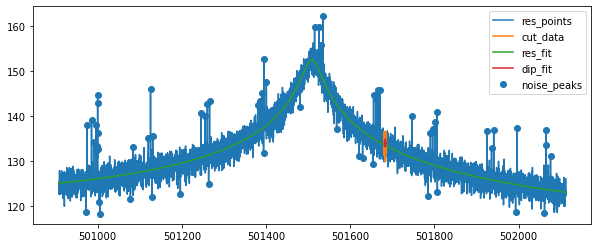

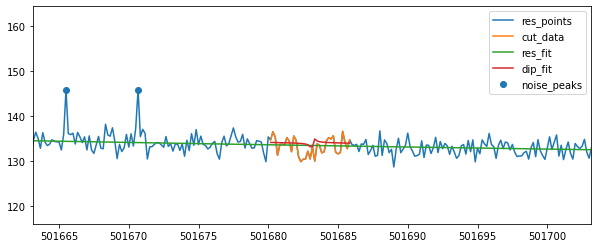

{'A': 1745909506109891.0, 'dA': 1.154177445714064e-10, 'Q': 12471.354323317379, 'dQ': 31.30994704903988, 'nu_res': 501508.6921334829, 'dnu_res': 0.29703108769396525, 'nu_z': 501683.15850684396, 'dnu_z': 0.010895378798947579, 'dip_width': 0.1495568040026736, 'ddip_width': 0.20361337189527073, 'dip_guess': 501683.0, 'fit_err_chi**2_red': 1.3319342965483094, 'fit_success': True}
cycle9 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501508.8333333333 445.3333333330229
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


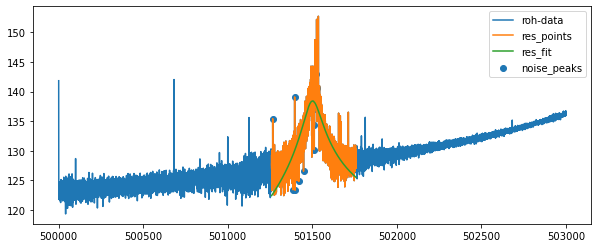

...End fiting resonator
{'A': 69419718561415.3, 'dA': 1.6740178090870535e-09, 'off': 127.05141262138423, 'doff': 4.683614928918255e-14, 'Q': 5251.37397698131, 'dQ': 37.49808998924661, 'th': 0.0011748991549958832, 'dth': 7.585366141606252e-05, 'nu_res': 501499.6741677521, 'dnu_res': 1.1166588355998126, 'fit_err_chi**2_red': 6.51226312899124}
Start fiting double dip....
Fit is NOT GOOD !!!!!


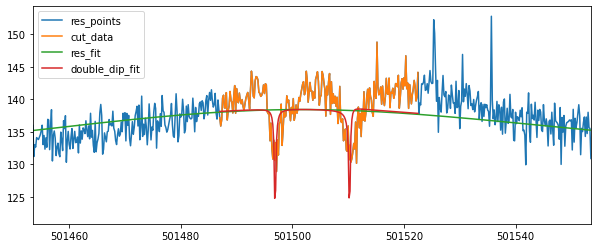

501496.909973968 0.02302232065993766 501510.24839582725 0.022965263874404812
cycle9 shift_0.03 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501509.1666666667 1216.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


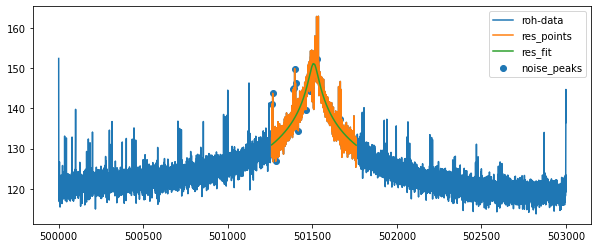

...End fiting resonator
{'A': 1330531860291212.8, 'dA': 2.0198030777139885e-10, 'off': 7147.924592128373, 'doff': 5.293264912956506e-15, 'Q': 10400.00410544603, 'dQ': 47.67528621883934, 'th': 1.4869501723435472e-36, 'dth': 4.695490033346235e-05, 'nu_res': 501507.99188055034, 'dnu_res': 0.45859164834304245, 'fit_err_chi**2_red': 3.0138492895560915}
Start fiting double dip....
Fit is NOT GOOD !!!!!


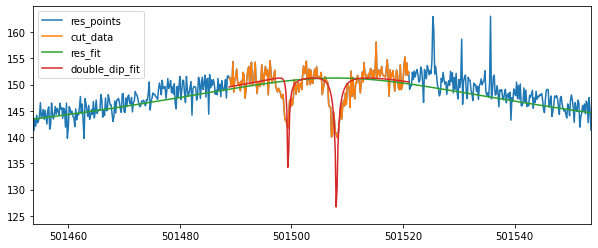

501499.3982002662 0.01688959273735173 501508.06606925884 0.016037314424088484
[501503.2379696928, 501683.15850684396]
503840.97 501593.1982382684 501496.909973968 501510.24839582725 0.02978461920957371 0.02302232065993766 0.022965263874404812
53273922.2 501593.1982382684 501499.3982002662 501508.06606925884 0.02978461920957371 0.01688959273735173 0.016037314424088484
['cycle9', 'position_1', 3, 0.03, '20211218_011830.943018', 53775336.46603126, 0.037809751893261453, 2427.0098684731056, 0.04409709893915179, 501593.1982382684, 0.02978461920957371, 0.1495568040026736, 0.20361337189527073, True, 501508.6921334829, 0.29703108769396525]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')
cycle9 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_0.spec
Start Values res:  [898269760983083.8, 5842.885436894524, 125.09514984274553, -0.00

e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8061688357228576
...End fiting resonator
{'A': 2268542564828965.0, 'dA': 1.1414504817152616e-10, 'Q': 14196.250544288028, 'dQ': 35.54393092424976, 'nu_res': 501508.70720146754, 'dnu_res': 0.2841049537204771, 'fit_err_chi**2_red': 0.8061688357228576}
resonator fit results:  [ 2.268542564829e+15  1.419625054429e+04  5.514446631296e+11
 -2.622740561194e-04  5.015087072015e+05] [1.141450481715e-10 3.554393092425e+01 4.236226459408e-08
 8.993770978999e-06 2.841049537205e-01]
Start fiting dip....
shape 2
chi_reduziert =  2.150222463662684
Fit is NOT GOOD !!!!!


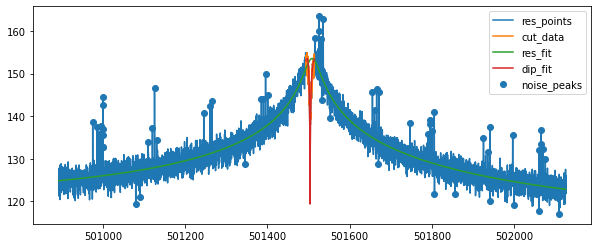

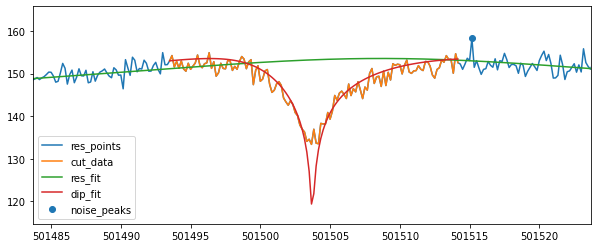

{'A': 2268542564828965.0, 'dA': 1.1414504817152616e-10, 'Q': 14196.250544288028, 'dQ': 35.54393092424976, 'nu_res': 501508.70720146754, 'dnu_res': 0.2841049537204771, 'nu_z': 501503.7268821827, 'dnu_z': 0.027174926031236335, 'dip_width': 5.147396802780688, 'ddip_width': 0.2446594666083228, 'dip_guess': 501503.8333333333, 'fit_err_chi**2_red': 2.150222463662684, 'fit_success': True}
cycle9 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_0_3.spec
Start Values res:  [853814496354960.1, 5753.51434034673, 124.93501936266472, -0.0018771793882332967, 501514.6666666667]
Start fiting resonator....


e:\git_repositories\controlsystem3\repositories\ft-icr_toolkit\fticr_toolkit\fitaxialClass_old.py:105: RuntimeWarning:

invalid value encountered in log10



chi_reduziert =  0.8040525744720486
...End fiting resonator
{'A': 2277063826984646.5, 'dA': 1.151111682505554e-10, 'Q': 14376.92547524202, 'dQ': 35.51383770894138, 'nu_res': 501508.6158172833, 'dnu_res': 0.2742697569891017, 'fit_err_chi**2_red': 0.8040525744720486}
resonator fit results:  [ 2.277063826985e+15  1.437692547524e+04  6.539558525362e+11
 -2.712265449615e-04  5.015086158173e+05] [1.151111682506e-10 3.551383770894e+01 4.338964879369e-08
 8.608817282031e-06 2.742697569891e-01]
Start fiting dip....
shape 2
chi_reduziert =  1.9283867536421906


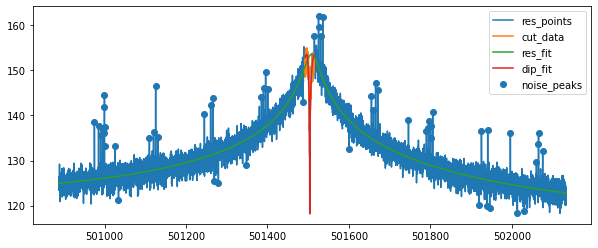

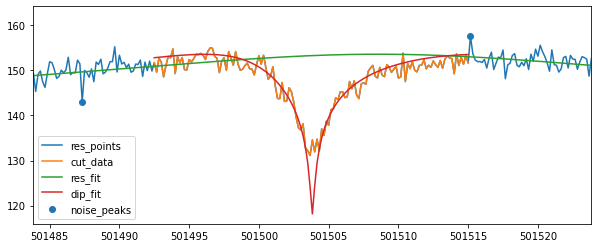

{'A': 2277063826984646.5, 'dA': 1.151111682505554e-10, 'Q': 14376.92547524202, 'dQ': 35.51383770894138, 'nu_res': 501508.6158172833, 'dnu_res': 0.2742697569891017, 'nu_z': 501503.8293031648, 'dnu_z': 0.03193506109454929, 'dip_width': 5.5464871092069545, 'ddip_width': 0.23533619900334585, 'dip_guess': 501503.8333333333, 'fit_err_chi**2_red': 1.9283867536421906, 'fit_success': True}
cycle9 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_1_1.spec
501502.5 500000.0 503000.0
501510.5 456.0
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



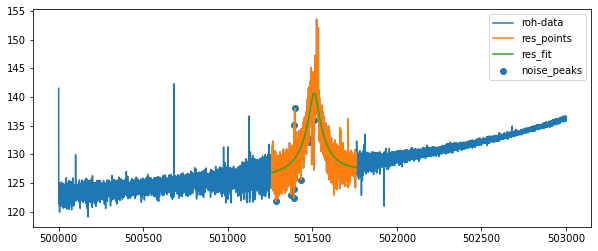

...End fiting resonator
{'A': 114546506212441.64, 'dA': 5.680710600762906e-09, 'off': 4309709466973.1436, 'doff': 1.0758800645038362e-07, 'Q': 10745.03509875486, 'dQ': 100.66908155964403, 'th': 0.00028741232149417527, 'dth': 4.228564531556617e-05, 'nu_res': 501510.46230352105, 'dnu_res': 0.5134943051330215, 'fit_err_chi**2_red': 3.1045134878694567}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


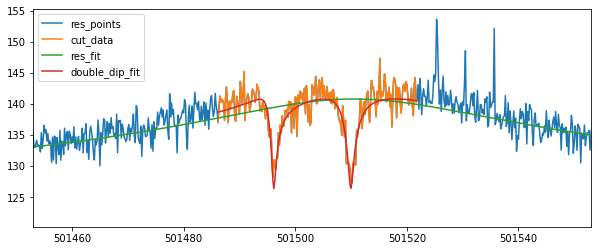

501496.16323519504 0.05293444296729078 501509.9655774989 0.06071086158168767
cycle9 shift_0.05 /dip_measurement/cycle1/position_1/trap3/cidx_2_2.spec
501502.5 500000.0 503000.0
501508.1666666667 1249.3333333334886
Start fiting resonator....
Fit is NOT GOOD!! try again with noisepeaks
Start fiting resonator II....
Fit is NOT GOOD!!


e:\git_repositories\controlsystem3\repositories\trap_control\trap_control\fitaxialClass.py:163: RuntimeWarning:

invalid value encountered in log10



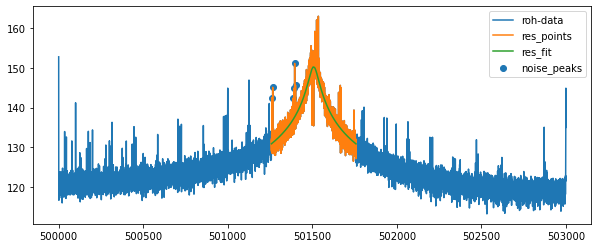

...End fiting resonator
{'A': 1063200378627317.5, 'dA': 2.17932800504394e-10, 'off': 149588.92842264308, 'doff': 3.21848065761036e-09, 'Q': 9270.256986223912, 'dQ': 45.633651765768136, 'th': 7.62006778266925e-21, 'dth': 5.0818427903239365e-05, 'nu_res': 501507.82054071367, 'dnu_res': 0.5301433174027265, 'fit_err_chi**2_red': 3.108398050655654}
double dip detection is not symmetrical to resonator
Start fiting double dip....
Fit is NOT GOOD !!!!!


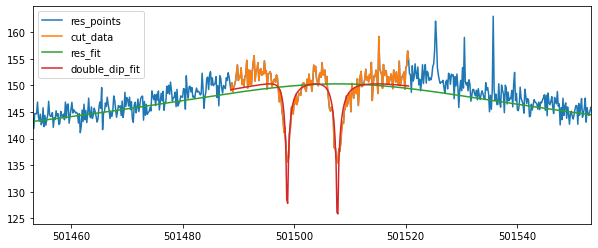

501498.75213774684 0.016106117523907094 501507.75071188336 0.016001495393525612
[501503.7268821827, 501503.8293031648]
503840.97 501503.77809267375 501496.16323519504 501509.9655774989 0.04193238285520824 0.05293444296729078 0.06071086158168767
53273922.2 501503.77809267375 501498.75213774684 501507.75071188336 0.04193238285520824 0.016106117523907094 0.016001495393525612
['cycle9', 'position_1', 3, 0.05, '20211218_011228.650686', 53775424.92475696, 0.04768416517502106, 2338.6192799797864, 0.09080852767314292, 501503.77809267375, 0.04193238285520824, 5.5464871092069545, 0.23533619900334585, True, 501508.6158172833, 0.2742697569891017]
Index(['mcycle', 'position', 'trap', 'shift', 'time', 'nu_p', 'dnu_p', 'nu_m',
       'dnu_m', 'nu_z', 'dnu_z', 'dip_width', 'ddip_width', 'fit_success',
       'nu_res', 'dnu_res'],
      dtype='object')


In [132]:
## NOW FITTING THE DATA

fitdata = pd.DataFrame( columns=["mcycle", "position", "trap", "shift", "time", "nu_p", "dnu_p", "nu_m", "dnu_m", "nu_z", "dnu_z", "dip_width", 
                                           "ddip_width", "fit_success", "nu_res", "dnu_res" ] )



if not settings["reuse_fitdata"]:
    #for mc in mcycles:
    #    for shift in shifts:
    #         path = "/"+str(mc)+"/"+str(shift)+"/dip_measurement/cycle1/"+str(pos)+"/"+str(trap)+"/avggrp"+str(idx)
    
    for mc in mcycles:
        for shift in shifts:
            skip = False
            
            #                       ["time","nu_p","dnu_p","nu_m","dnu_m","nu_z","dnu_z","dip_width","ddip_width","fit_success","nu_res","dnu_res" ]
            cdata = [mc, pos, trap, float(shift[6:]), None,  None,  None,  None,  None, None,  None,  None,  None,  None]
            
            dpaths = data_conversion.get_data_paths( data_root[mc][shift], name_includes= ("cidx", "idx") )

            nuz = []
            dnuz = []
            
            for path in dpaths:
                
                print(mc, shift, path)
                
                try:
                    spec = data_conversion.Spectrum(data_root[mc][shift][path])
                    attrs = data_conversion.attrs_to_dict(data_root[mc][shift][path])
                except:
                    print("load spec error")
                
                x = spec.freqs
                y = spec.amps
                time = attrs["time"]

                try:
                    if len(x) < 10000:
                        # typically at least a resolution of 0.1 Hz (seconds), so at least 1000 kHz span, otherwise, its bad data.
                        raise IndexError("The given spectrum is too small (<10000 points) to be an axial spectrum... ")

                    cidx = spec.attrs["cidx"]

                    if cidx == 0: # dip
                        #fit_obj = fitaxial.AXIAl_FIT()
                        fit_obj = fitaxialClass_old.AXIAl_FIT()
                        popt, perr, data = fit_obj.fit_axial_dip_test_new(x, y)
                        #popt, perr, data = fit_obj.fit_axial_dip(x, y)
                        del fit_obj

                        nuz.append(data["nu_z"])
                        dnuz.append(data["dnu_z"])
                        adata = data.copy()
                    
                    if cidx == 1 or cidx == 2: # double dip
                        print(nu_z_guess, x.min(), x.max())
                        fitconf = fit_opt.copy()
                        fitconf.update({"double_nu_z": nu_z_guess, "plot": True, "q_guess": 12000})
                        fit_obj = fitaxialClass.AXIAl_FIT(fitconf)
                        popt, perr, data = fit_obj.fit_double_dip_new(x, y)
                        #del fit_obj
                        #data, popt, pcov = spec.fit_double_dip(**fit_config)
                        #data, popt, pcov = fit_double_alex(x, y, **fit_config)
                        print(data["nu_l"], data["dnu_l"], data["nu_r"], data["dnu_r"])
                            
                    if cidx == 1: # magnetron
                        #if data["fit_success"]:
                        nulm, dnulm, nurm, dnurm =  data["nu_l"], data["dnu_l"], data["nu_r"], data["dnu_r"]

                    if cidx == 2: # cyclotron
                        #if data["fit_success"]:
                        nulp, dnulp, nurp, dnurp =  data["nu_l"], data["dnu_l"], data["nu_r"], data["dnu_r"]
                
                except:
                    print("fit failed for", mc, shift, path)
                    skip = True
                    
            if skip:
                continue
            
            # nuz
            print(nuz)
            nu_z = np.mean(nuz)
            dnu_z = np.sqrt(np.sum(np.power(dnuz,2)))
            
            # num
            nurf = nu_z_guess + nu_m_guess
            nu_m, dnu_m = calc_nu_m(nurf, nu_z, nulm, nurm, dnu_z, dnulm, dnurm)

            # num
            nurf = nu_p_guess - nu_z_guess
            nu_p, dnu_p = calc_nu_p(nurf, nu_z, nulp, nurp, dnu_z, dnulp, dnurp)
                            
            cdata[4:14] = time, nu_p, dnu_p, nu_m, dnu_m, nu_z, dnu_z, adata["dip_width"], adata["ddip_width"], adata["fit_success"], adata["nu_res"], adata["dnu_res"]
            
            print(cdata)
            print(fitdata.columns)
            dset = pd.Series(data=cdata, index=fitdata.columns)
            
            fitdata = fitdata.append(dset, ignore_index=True)


In [133]:
if not settings["reuse_fitdata"]:
    fitdata["time"] = pd.to_datetime(fitdata['time'], format='%Y%m%d_%H%M%S.%f')
    #display(avg_axial_fitdata)
    display(fitdata)

    fitdata.to_csv(output_folder + "/fitdata.csv", index=False)
else:
    fitdata = pd.read_csv(output_folder + "/fitdata.csv")

,mcycle,position,trap,shift,time,nu_p,dnu_p,nu_m,dnu_m,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res
0,cycle1,position_1,3,-0.005,2021-12-17 17:57:42.143078,5.377542e+07,0.041867,2338.611992,0.093950,501502.503540,0.034258,5.386263,0.240071,True,501508.987638,0.284254
1,cycle1,position_1,3,-0.020,2021-12-17 17:39:35.358528,5.377542e+07,0.041371,2338.670842,0.097586,501502.651123,0.034844,5.276991,0.215752,True,501508.952586,0.286255
2,cycle1,position_1,3,-0.040,2021-12-17 18:15:48.991258,5.377542e+07,0.043363,2338.404955,0.088771,501502.661315,0.035768,5.201397,0.227721,True,501508.792943,0.279533
3,cycle1,position_1,3,0.002,2021-12-17 17:51:39.892809,5.377543e+07,0.041315,2338.655551,0.094524,501502.489811,0.035959,5.325893,0.251618,True,501509.242567,0.277832
4,cycle1,position_1,3,0.005,2021-12-17 18:21:51.252046,5.377543e+07,0.042452,2338.325035,0.091730,501502.574040,0.034205,5.180382,0.224228,True,501508.562546,0.278611
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74,cycle9,position_1,3,0.005,2021-12-18 00:48:19.443453,5.377543e+07,0.043103,2338.625041,0.080490,501502.502960,0.035476,5.742854,0.230641,True,501508.386935,0.273773
75,cycle9,position_1,3,0.008,2021-12-18 00:54:21.735247,5.377542e+07,0.043056,2338.542940,0.098377,501502.983943,0.037890,5.579042,0.254290,True,501508.298222,0.283684
76,cycle9,position_1,3,0.015,2021-12-18 01:36:38.001032,5.377547e+07,0.381071,2344.095678,0.114150,501720.814763,0.025407,0.036901,0.080652,True,501509.374640,0.299010
77,cycle9,position_1,3,0.030,2021-12-18 01:18:30.943018,5.377534e+07,0.037810,2427.009868,0.044097,501593.198238,0.029785,0.149557,0.203613,True,501508.692133,0.297031


In [145]:
fitdata["masked"] = False
fitdata = filtering.minmax_value(fitdata, val="nu_z", min_val=nu_z_guess - 20, max_val=nu_z_guess + 20)
fitdata = filtering.minmax_value(fitdata, val="nu_p", min_val=nu_p_guess - 20, max_val=nu_p_guess + 20)
fitdata = filtering.minmax_value(fitdata, val="nu_m", min_val=nu_m_guess - 20, max_val=nu_m_guess + 20)
        
filtered_data = fitdata[fitdata["masked"] == False]

filtered min max nu_z 2
filtered min max nu_p 1


In [148]:
# nuc

filtered_data["nu_c"], filtered_data["dnu_c"] = frequencies.calc_nu_c_error(filtered_data["nu_p"], filtered_data["nu_z"], filtered_data["nu_m"], filtered_data["dnu_p"], filtered_data["dnu_z"], filtered_data["dnu_m"])


In [150]:
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_data, x="time", y="nu_p", error_y="dnu_p", color="shift", hover_data=['mcycle', 'shift'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_data, x="shift", y="nu_z", error_y="dnu_z", hover_data=['mcycle', 'shift', 'nu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> REDCyc DATA >>> ")
fig = px.scatter(filtered_data, x="shift", y="nu_p", error_y="dnu_p", hover_data=['mcycle', 'shift', 'nu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> MAGNE DATA >>> ")
fig = px.scatter(filtered_data, x="shift", y="nu_m", error_y="dnu_m", hover_data=['mcycle', 'shift', 'nu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> CYCLO DATA >>> ")
fig = px.scatter(filtered_data, x="shift", y="nu_c", error_y="dnu_c", hover_data=['mcycle', 'shift', 'nu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

 >>> AXIAL DATA >>> 


 >>> AXIAL DATA >>> 


 >>> REDCyc DATA >>> 


 >>> MAGNE DATA >>> 


 >>> CYCLO DATA >>> 


In [212]:
# mean
mean_data = statistics.average_subsets(filtered_data, groupby=["shift"], errortype="weighted", columns=["nu_m", "nu_z", "nu_p", "nu_c"], dcolumns=["dnu_m", "dnu_z", "dnu_p", "dnu_c"], masked=True)

# B
ion = meas_config["ion"]
m, dmion = ame.get_ion_mass(ion)
A, el, q = ideal_trap_physics.re_ionstr(ion)

mean_data["B"] = (m*ame.amu)/(q*ame.elc)*mean_data["nu_c"]*2*np.pi
mean_data["dB"] = (m*ame.amu)/(q*ame.elc)*mean_data["dnu_c"]*2*np.pi

In [228]:
# mm shift
mean_data["shiftmm"] = 0.0
trap_settings = meas_config[pos]["traps"]

#for shift, grp in mean_data.groupby("shift"):
for index, row in mean_data.iterrows():
    
    shift = row["shift"]
    trap_settings[trap]["Offset"] = [shift, -shift]
    sim_eval.calc_potential(int(trap), trap_settings)
    xmin2 = sim_eval.fit_potential()
    print(index, "fit minimum  :", xmin2, "µm")
    
    mean_data.at[index, "shiftmm"] = float(xmin2/1000)
    
display(mean_data)

0 fit minimum  : 35.41779717050538 µm
1 fit minimum  : 17.710746906198413 µm
2 fit minimum  : 4.427831170608286 µm
3 fit minimum  : -1.7711357044664395 µm
4 fit minimum  : -4.427831171208799 µm
5 fit minimum  : -7.0845058366561435 µm
6 fit minimum  : -13.283262394313372 µm
7 fit minimum  : -26.56496500224958 µm
8 fit minimum  : -44.26878227521561 µm


,ddip_width,dip_width,dnu_c,dnu_m,dnu_p,dnu_res,dnu_z,fit_success,masked,mcycle,...,nu_p,nu_res,nu_z,position,shift,time,trap,B,dB,shiftmm
0,0.227721,5.201397,0.051943,0.089761,0.052066,0.279533,0.025283,1.0,0.0,cycle1,...,5.377542e+07,501508.792943,501502.628295,position_1,-0.040,2021-12-17 18:15:48.991258,3.0,7.002163,6.763221e-09,0.035418
1,0.215752,5.276991,0.035356,0.051510,0.035378,0.286255,0.017786,1.0,0.0,cycle1,...,5.377542e+07,501508.952586,501502.619706,position_1,-0.020,2021-12-17 17:39:35.358528,3.0,7.002163,4.603605e-09,0.017711
2,0.240071,5.386263,0.059205,0.219447,0.059352,0.284254,0.021942,1.0,0.0,cycle1,...,5.377542e+07,501508.987638,501502.481777,position_1,-0.005,2021-12-17 17:57:42.143078,3.0,7.002163,7.708840e-09,0.004428
3,0.251618,5.325893,0.036180,0.080658,0.036255,0.277832,0.018069,1.0,0.0,cycle1,...,5.377543e+07,501509.242567,501502.454100,position_1,0.002,2021-12-17 17:51:39.892809,3.0,7.002163,4.710848e-09,-0.001771
4,0.224228,5.180382,0.062489,0.058900,0.062564,0.278611,0.012896,1.0,0.0,cycle1,...,5.377542e+07,501508.562546,501502.552595,position_1,0.005,2021-12-17 18:21:51.252046,3.0,7.002163,8.136446e-09,-0.004428
5,0.217044,5.107172,0.060102,0.075792,0.060357,0.284163,0.030285,1.0,0.0,cycle1,...,5.377542e+07,501508.866176,501502.831854,position_1,0.008,2021-12-17 18:03:44.400753,3.0,7.002163,7.825672e-09,-0.007085
6,0.226113,5.237424,0.048121,0.139086,0.048297,0.285754,0.027767,1.0,0.0,cycle1,...,5.377543e+07,501508.703409,501502.819600,position_1,0.015,2021-12-17 18:09:46.699680,3.0,7.002163,6.265595e-09,-0.013283
7,0.236254,4.911715,0.020556,0.036219,0.020431,0.290973,0.028573,1.0,0.0,cycle1,...,5.377543e+07,501509.190161,501502.753248,position_1,0.030,2021-12-17 17:45:37.656355,3.0,7.002163,2.676522e-09,-0.026565
8,0.224904,5.119725,0.063103,0.153878,0.064133,0.279020,0.121842,1.0,0.0,cycle1,...,5.377543e+07,501508.740155,501502.660692,position_1,0.050,2021-12-17 17:33:33.066652,3.0,7.002163,8.216341e-09,-0.044269


In [232]:
print(" >>> CYCLO DATA >>> ")
fig = px.scatter(mean_data, x="shift", y="nu_c", error_y="dnu_c", hover_data=['mcycle', 'shift', 'nu_z'], trendline="ols")
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> CYCLO DATA >>> ")
fig = px.scatter(mean_data, x="shiftmm", y="nu_c", error_y="dnu_c", hover_data=['mcycle', 'shift', 'nu_z'], trendline="ols")
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> B DATA >>> ")
fig = px.scatter(mean_data, x="shiftmm", y="B", error_y="dB", hover_data=['mcycle', 'shift', 'nu_z'], trendline="ols")
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

x = mean_data["shiftmm"].to_numpy()
y = mean_data.B.to_numpy()
dy = mean_data.dB.to_numpy()

popt, pcov = np.polyfit(x, y, 1, w=dy, cov=True)
perr = np.sqrt(np.diag(pcov))
print(popt, perr)

B1, dB1 = popt[0], perr[0]

print("B1 =", ufloat(B1, dB1))

 >>> CYCLO DATA >>> 


 >>> CYCLO DATA >>> 


 >>> B DATA >>> 


[-1.416157969415e-06  7.002162811868e+00] [1.010896456099e-07 2.367740666498e-09]
B1 = (-1.42+/-0.10)e-06


In [ ]:
# linear fit